## --------------------------------------------------------------------------------------------------------------
# Projet 7 | Implémentez un modèle de scoring
##  --------------------------------------------------------------------------------------------------------------

###### Problématique

###### Entreprise « Prêt à dépenser » :

 • Propose des Crédits à la consommation pour des personnes ayant peu d'historique de prêt



# Objectifs


   * Construire un Modèle de scoring de la probabilité de défaut de paiement du client

   * Construire un Dashboard interactif à destination des chargés de relation client

   * Mettre en production le modèle de scoring de prédiction à l’aide d’une API, ainsi que le dashboard interactif qui appelle l’API pour les prédictions.



In [1]:
#pip install --upgrade pip

In [2]:
#pip install phik

In [3]:
#pip install joblib

In [4]:
#pip install xgboost

In [5]:
#pip install xgboost

In [6]:
#pip install lightgbm

In [7]:
import pickle
import sys
import time
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import re
import phik
# Plotly
import plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import gc

## Modelisation

from sklearn.model_selection import train_test_split ,GridSearchCV
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from imblearn.pipeline import Pipeline as imbPipeline
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.dummy import DummyClassifier
from lightgbm import LGBMClassifier

from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE

from sklearn.metrics import   make_scorer ,roc_curve,  classification_report, confusion_matrix
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, roc_auc_score,f1_score, precision_score, recall_score ,average_precision_score
from sklearn.model_selection import StratifiedKFold, cross_val_predict, cross_val_score

from hyperopt import fmin, tpe, hp, STATUS_OK, Trials, space_eval

import shap

# Warnings
#warnings.filterwarnings('ignore')
plotly.offline.init_notebook_mode(connected=True)



In [8]:
#pip install hyperopt

In [9]:
#pip install shap

In [10]:
import matplotlib
import matplotlib.pyplot as plt

print("Matplotlib version:", matplotlib.__version__)


Matplotlib version: 3.9.2


In [11]:
import os
print(os.environ.get("MPLBACKEND"))


module://matplotlib_inline.backend_inline


In [12]:
import os
os.environ.pop("MPLBACKEND", None)  # Supprime la variable d'environnement si elle existe


'module://matplotlib_inline.backend_inline'

In [13]:
import matplotlib
matplotlib.use("agg")  # Ou remplacez "agg" par un autre backend compatible
import matplotlib.pyplot as plt


In [14]:
import sklearn
print(sklearn.__file__)


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\__init__.py


In [15]:
#!pip install scikit-learn

In [16]:
from sklearn.model_selection import train_test_split


In [17]:
# Les différentes Versions utilisées
print('Version des librairies utilisées :')
#print('jyquickhelper         : ' + jyquickhelper.__version__)
print('Python                : ' + sys.version)
print('NumPy                 : ' + np.version.full_version)
print('Pandas                : ' + pd.__version__)

Version des librairies utilisées :
Python                : 3.12.7 | packaged by Anaconda, Inc. | (main, Oct  4 2024, 13:17:27) [MSC v.1929 64 bit (AMD64)]
NumPy                 : 1.26.4
Pandas                : 2.2.2


# Chargement des données


In [18]:
application_train = pd.read_csv("application_train.csv")
application_test = pd.read_csv("application_test.csv")
bureau = pd.read_csv("bureau.csv")
bureau_balance = pd.read_csv("bureau_balance.csv")
credit_card_balance = pd.read_csv("credit_card_balance.csv")
HomeCredit_columns_description = pd.read_csv("HomeCredit_columns_description.csv", encoding = "ISO-8859-1")
installments_payments = pd.read_csv("installments_payments.csv")
POS_CASH_balance = pd.read_csv("POS_CASH_balance.csv")
previous_application = pd.read_csv("previous_application.csv")
sample_submission = pd.read_csv("sample_submission.csv")

In [19]:
# Stocker les datasets dans un dictionnaire
datasets = {
    "application_train": application_train,
    "application_test": application_test,
    "bureau": bureau,
    "bureau_balance": bureau_balance,
    "credit_card_balance": credit_card_balance,
    "HomeCredit_columns_description": HomeCredit_columns_description,
    "installments_payments": installments_payments,
    "POS_CASH_balance": POS_CASH_balance,
    "previous_application": previous_application,
    "sample_submission": sample_submission,
}

# Fonction pour afficher les datasets
def show_datasets(datasets_dict):
    """
    Affiche les noms des datasets et leurs dimensions.

    Args:
    - datasets_dict (dict): Un dictionnaire contenant les datasets.

    """
    print("Voici les datasets chargés :")
    for i, (name, dataset) in enumerate(datasets_dict.items()):
        print(f"{i + 1}. {name} (Shape: {dataset.shape[0]} lignes, {dataset.shape[1]} colonnes)")

# Appeler la fonction
show_datasets(datasets)


Voici les datasets chargés :
1. application_train (Shape: 307511 lignes, 122 colonnes)
2. application_test (Shape: 48744 lignes, 121 colonnes)
3. bureau (Shape: 1716428 lignes, 17 colonnes)
4. bureau_balance (Shape: 27299925 lignes, 3 colonnes)
5. credit_card_balance (Shape: 3840312 lignes, 23 colonnes)
6. HomeCredit_columns_description (Shape: 219 lignes, 5 colonnes)
7. installments_payments (Shape: 13605401 lignes, 8 colonnes)
8. POS_CASH_balance (Shape: 10001358 lignes, 8 colonnes)
9. previous_application (Shape: 1670214 lignes, 37 colonnes)
10. sample_submission (Shape: 48744 lignes, 2 colonnes)


In [20]:
# Fonction pour afficher les datasets avec leurs dimensions et un aperçu
def show_datasets_with_head(datasets_dict, num_rows=5):
    """
    Affiche les noms des datasets, leurs dimensions et un aperçu des données.

    Args:
    - datasets_dict (dict): Un dictionnaire contenant les datasets.
    - num_rows (int): Nombre de lignes à afficher pour chaque dataset (par défaut 5).
    """
    for i, (name, dataset) in enumerate(datasets_dict.items()):
        print(f"\n{i + 1}. {name} (Shape: {dataset.shape[0]} lignes, {dataset.shape[1]} colonnes)")
        print("-" * 80)
        print(dataset.head(num_rows))
        print("=" * 80)

# Stocker les datasets dans un dictionnaire
datasets = {
    "application_train": application_train,
    "application_test": application_test,
    "bureau": bureau,
    "bureau_balance": bureau_balance,
    "credit_card_balance": credit_card_balance,
    "HomeCredit_columns_description": HomeCredit_columns_description,
    "installments_payments": installments_payments,
    "POS_CASH_balance": POS_CASH_balance,
    "previous_application": previous_application,
    "sample_submission": sample_submission,
}

# Appeler la fonction
show_datasets_with_head(datasets, num_rows=5)



1. application_train (Shape: 307511 lignes, 122 colonnes)
--------------------------------------------------------------------------------
   SK_ID_CURR  TARGET NAME_CONTRACT_TYPE CODE_GENDER FLAG_OWN_CAR  \
0      100002       1         Cash loans           M            N   
1      100003       0         Cash loans           F            N   
2      100004       0    Revolving loans           M            Y   
3      100006       0         Cash loans           F            N   
4      100007       0         Cash loans           M            N   

  FLAG_OWN_REALTY  CNT_CHILDREN  AMT_INCOME_TOTAL  AMT_CREDIT  AMT_ANNUITY  \
0               Y             0          202500.0    406597.5      24700.5   
1               N             0          270000.0   1293502.5      35698.5   
2               Y             0           67500.0    135000.0       6750.0   
3               Y             0          135000.0    312682.5      29686.5   
4               Y             0          121500.0    51

In [21]:
def describe_datasets(datasets_dict):
    """
    Affiche la description statistique pour chaque dataset.

    Args:
    - datasets_dict (dict): Un dictionnaire contenant les datasets (clé: nom, valeur: DataFrame).
    """
    print("Description statistique des datasets :\n")
    for i, (name, dataset) in enumerate(datasets_dict.items()):
        print(f"{i + 1}. {name} (Shape: {dataset.shape[0]} lignes, {dataset.shape[1]} colonnes)")
        print("Description statistique :")
        print(dataset.describe(include='all'))
        print("-" * 80)

datasets = {
    "application_train": application_train,
    "application_test": application_test,
    "bureau": bureau,
    "bureau_balance": bureau_balance,
    "credit_card_balance": credit_card_balance,
    "HomeCredit_columns_description": HomeCredit_columns_description,
    "installments_payments": installments_payments,
    "POS_CASH_balance": POS_CASH_balance,
    "previous_application": previous_application,
    "sample_submission": sample_submission,
}

describe_datasets(datasets)


Description statistique des datasets :

1. application_train (Shape: 307511 lignes, 122 colonnes)
Description statistique :
           SK_ID_CURR         TARGET NAME_CONTRACT_TYPE CODE_GENDER  \
count   307511.000000  307511.000000             307511      307511   
unique            NaN            NaN                  2           3   
top               NaN            NaN         Cash loans           F   
freq              NaN            NaN             278232      202448   
mean    278180.518577       0.080729                NaN         NaN   
std     102790.175348       0.272419                NaN         NaN   
min     100002.000000       0.000000                NaN         NaN   
25%     189145.500000       0.000000                NaN         NaN   
50%     278202.000000       0.000000                NaN         NaN   
75%     367142.500000       0.000000                NaN         NaN   
max     456255.000000       1.000000                NaN         NaN   

       FLAG_OWN_CAR FLA

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def analyze_missing_duplicates(datasets_dict):
    """
    Analyse les valeurs manquantes et doublons dans plusieurs datasets et présente les résultats graphiquement.

    Args:
    - datasets_dict (dict): Un dictionnaire où les clés sont les noms des datasets et les valeurs sont les DataFrames.
    """
    results = []

    # Calcul des valeurs manquantes et doublons pour chaque dataset
    for name, dataset in datasets_dict.items():
        missing_values = dataset.isnull().sum().sum()
        duplicate_rows = dataset.duplicated().sum()
        total_values = dataset.size
        results.append({
            "Dataset": name,
            "Missing (%)": (missing_values / total_values) * 100,
            "Duplicates": duplicate_rows,
            "Total Rows": dataset.shape[0],
            "Total Columns": dataset.shape[1]
        })

    # Créer un DataFrame avec les résultats
    results_df = pd.DataFrame(results)

    # Afficher le tableau des résultats
    print("Analyse des valeurs manquantes et doublons :\n")
    print(results_df)

    # Graphique des valeurs manquantes
    plt.figure(figsize=(12, 6))
    sns.barplot(data=results_df, x="Dataset", y="Missing (%)", palette="viridis")
    plt.xticks(rotation=45, fontsize=12)
    plt.title("Pourcentage de valeurs manquantes par dataset", fontsize=16)
    plt.ylabel("Valeurs manquantes (%)", fontsize=14)
    plt.xlabel("Datasets", fontsize=14)
    plt.tight_layout()
    plt.show()


In [23]:
analyze_missing_duplicates(datasets)

Analyse des valeurs manquantes et doublons :

                          Dataset  Missing (%)  Duplicates  Total Rows  \
0               application_train    24.395942           0      307511   
1                application_test    23.811687           0       48744   
2                          bureau    13.502552           0     1716428   
3                  bureau_balance     0.000000           0    27299925   
4             credit_card_balance     6.654074           0     3840312   
5  HomeCredit_columns_description    12.146119           0         219   
6           installments_payments     0.005338           0    13605401   
7                POS_CASH_balance     0.065189           0    10001358   
8            previous_application    17.976877           0     1670214   
9               sample_submission     0.000000           0       48744   

   Total Columns  
0            122  
1            121  
2             17  
3              3  
4             23  
5              5  
6     

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\2865032624.py:36: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\2865032624.py:42: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



In [24]:
import seaborn as sns

In [25]:
%matplotlib inline

## Observations 
* On constate que les jeux de données "application_train" et "application_test" possèdent les pourcentages de valeurs manquantes les plus élevés, avoisinant les 25 %. À l'inverse, les jeux de données "POS_CASH_balance" et "sample_submission" présentent presque 0 % de valeurs manquantes.

## Étape 1 : Dimensions des datasets
* Affichage du nombre de lignes et colonnes des datasets application_train et application_test.

In [26]:
# Dimensions des datasets
print("### Dimensions des datasets ###")
print(f"application_train : {application_train.shape[0]} lignes, {application_train.shape[1]} colonnes")
print(f"application_test : {application_test.shape[0]} lignes, {application_test.shape[1]} colonnes")

### Dimensions des datasets ###
application_train : 307511 lignes, 122 colonnes
application_test : 48744 lignes, 121 colonnes


In [27]:
application_train.columns.values

array(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN',
       'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE',
       'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE',
       'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'OCCUPATION_TYPE',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'WEEKDAY_APPR_PROCESS_START',
       'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION',
       'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'EXT_SOURCE_1',
       'EXT_SOURCE_2', 'EXT_SOURCE_3',

In [28]:
application_test.columns.values

array(['SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR',
       'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       'OWN_CAR_AGE', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE',
       'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'OCCUPATION_TYPE',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'WEEKDAY_APPR_PROCESS_START',
       'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION',
       'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'EXT_SOURCE_1',
       'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG'

# Étape 2 : Aperçu des datasets

* Affichage des premières lignes pour comprendre la structure et les données initiales.

In [29]:
# Aperçu des 5 premières lignes
print("### Aperçu des 5 premières lignes ###")
print("application_train :")
application_train.head()

### Aperçu des 5 premières lignes ###
application_train :


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [30]:
print("\napplication_test :")
application_test.head()


application_test :


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


## Étape 3 : Types de colonnes et informations générales

* Afficher les types de colonnes, les valeurs non nulles et une synthèse.

In [31]:
# Informations sur les datasets
print("### Informations générales ###")
print("application_train :")
application_train.info()
print("\napplication_test :")
print(application_test.info())

### Informations générales ###
application_train :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB

application_test :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40), object(16)
memory usage: 45.0+ MB
None


## Étape 4 : Analyse des valeurs manquantes
* Calcul des pourcentages de valeurs manquantes.
* Visualisation des colonnes ayant des valeurs manquantes significatives.

### Pourcentage de valeurs manquantes (application_train) ###
COMMONAREA_MEDI             69.872297
COMMONAREA_AVG              69.872297
COMMONAREA_MODE             69.872297
NONLIVINGAPARTMENTS_MEDI    69.432963
NONLIVINGAPARTMENTS_MODE    69.432963
                              ...    
EXT_SOURCE_2                 0.214626
AMT_GOODS_PRICE              0.090403
AMT_ANNUITY                  0.003902
CNT_FAM_MEMBERS              0.000650
DAYS_LAST_PHONE_CHANGE       0.000325
Length: 67, dtype: float64

### Pourcentage de valeurs manquantes (application_test) ###
COMMONAREA_MODE             68.716150
COMMONAREA_MEDI             68.716150
COMMONAREA_AVG              68.716150
NONLIVINGAPARTMENTS_MEDI    68.412523
NONLIVINGAPARTMENTS_AVG     68.412523
                              ...    
OBS_60_CNT_SOCIAL_CIRCLE     0.059495
DEF_30_CNT_SOCIAL_CIRCLE     0.059495
OBS_30_CNT_SOCIAL_CIRCLE     0.059495
AMT_ANNUITY                  0.049237
EXT_SOURCE_2                 0.016412
Length: 64, d

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3259840268.py:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




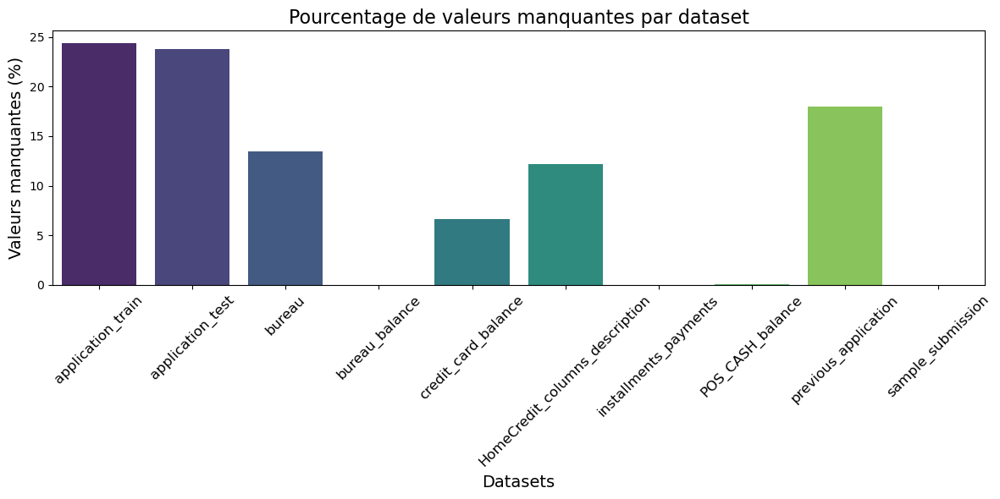

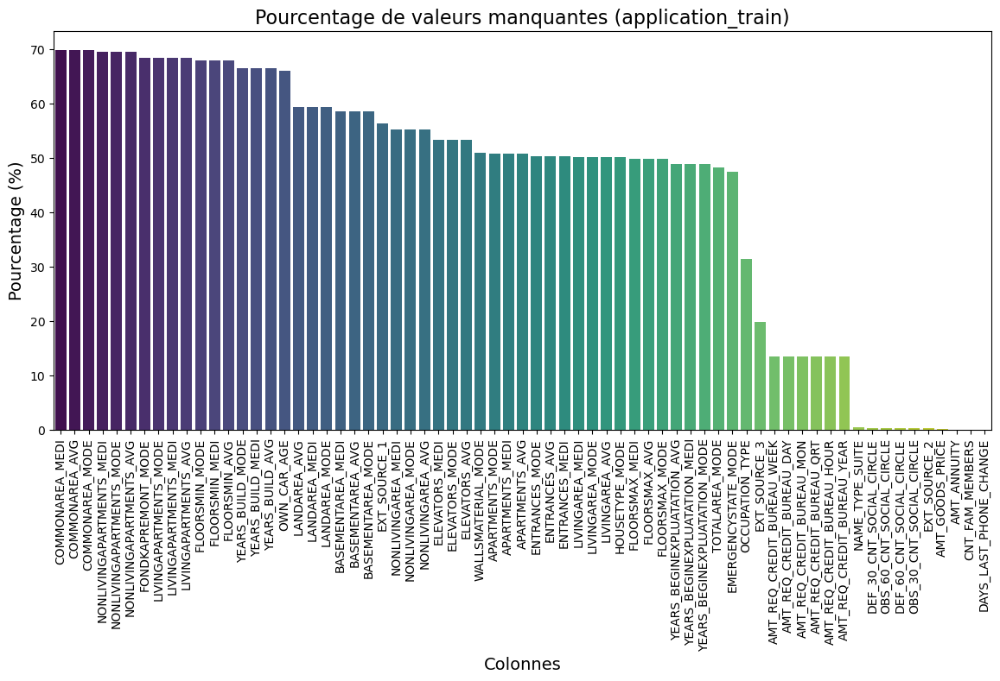

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3259840268.py:24: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




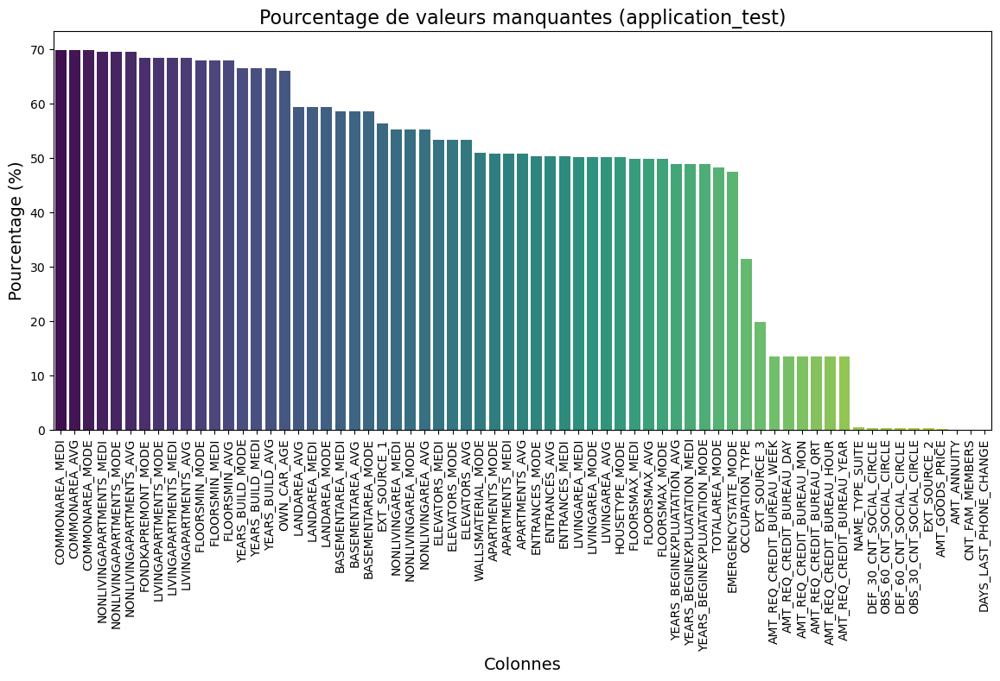

In [32]:
# Calcul des valeurs manquantes
missing_train = (application_train.isnull().sum() / application_train.shape[0]) * 100
missing_test = (application_test.isnull().sum() / application_test.shape[0]) * 100

# Filtrer uniquement les colonnes avec des valeurs manquantes
missing_train = missing_train[missing_train > 0].sort_values(ascending=False)
missing_test = missing_test[missing_test > 0].sort_values(ascending=False)

# Affichage
print("### Pourcentage de valeurs manquantes (application_train) ###")
print(missing_train)
print("\n### Pourcentage de valeurs manquantes (application_test) ###")
print(missing_test)

# Visualisation
plt.figure(figsize=(14, 6))
sns.barplot(x=missing_train.index, y=missing_train.values, palette="viridis")
plt.xticks(rotation=90)
plt.title("Pourcentage de valeurs manquantes (application_train)", fontsize=16)
plt.ylabel("Pourcentage (%)", fontsize=14)
plt.xlabel("Colonnes", fontsize=14)
plt.show()
plt.figure(figsize=(14, 6))
sns.barplot(x=missing_train.index, y=missing_train.values, palette="viridis")
plt.xticks(rotation=90)
plt.title("Pourcentage de valeurs manquantes (application_test)", fontsize=16)
plt.ylabel("Pourcentage (%)", fontsize=14)
plt.xlabel("Colonnes", fontsize=14)
plt.show()

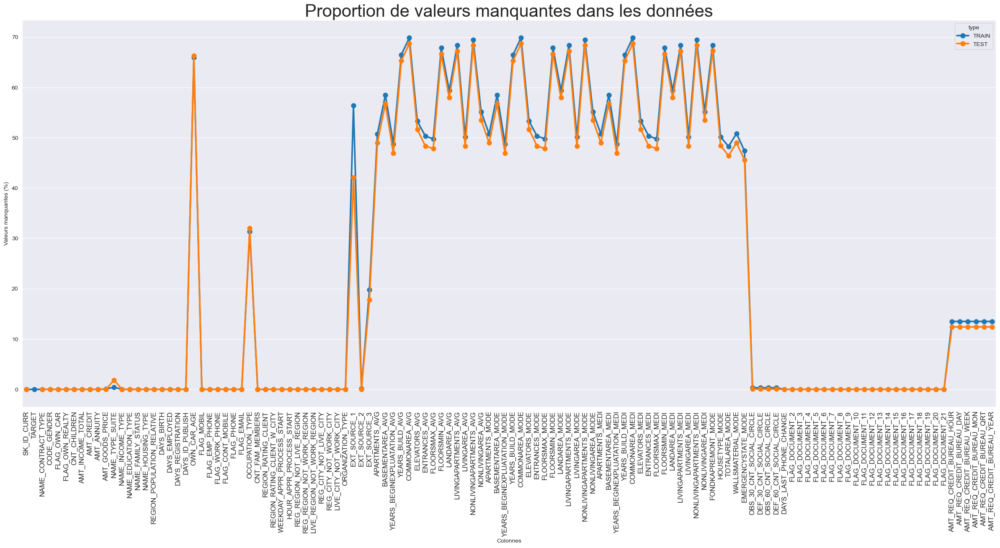

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Utilisation d'un style valide de seaborn
sns.set_style('darkgrid')  # Exemple de style valide

# Calcul des valeurs manquantes dans les deux datasets
miss_train = pd.DataFrame((application_train.isnull().sum()) * 100 / application_train.shape[0]).reset_index()
miss_test = pd.DataFrame((application_test.isnull().sum()) * 100 / application_test.shape[0]).reset_index()

# Ajouter une colonne pour distinguer les types de données
miss_train["type"] = "TRAIN"
miss_test["type"] = "TEST"

# Fusionner les deux DataFrames
missing = pd.concat([miss_train, miss_test], axis=0)

# Tracer le graphique
fig = plt.figure(figsize=(30, 12))
ax = sns.pointplot(x="index", y=0, data=missing, hue="type")
plt.xticks(rotation=90, fontsize=12)
plt.title("Proportion de valeurs manquantes dans les données", fontsize=30)
plt.ylabel("Valeurs manquantes (%)")
plt.xlabel("Colonnes")
plt.show()


In [38]:
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    return pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])

In [35]:
missing_data(application_train).head(10)

,Total,Percent
COMMONAREA_MEDI,214865,69.872297
COMMONAREA_AVG,214865,69.872297
COMMONAREA_MODE,214865,69.872297
NONLIVINGAPARTMENTS_MODE,213514,69.432963
NONLIVINGAPARTMENTS_AVG,213514,69.432963
NONLIVINGAPARTMENTS_MEDI,213514,69.432963
FONDKAPREMONT_MODE,210295,68.386172
LIVINGAPARTMENTS_MODE,210199,68.354953
LIVINGAPARTMENTS_AVG,210199,68.354953
LIVINGAPARTMENTS_MEDI,210199,68.354953


In [36]:
missing_data(application_test).head(10)

,Total,Percent
COMMONAREA_AVG,33495,68.716150
COMMONAREA_MODE,33495,68.716150
COMMONAREA_MEDI,33495,68.716150
NONLIVINGAPARTMENTS_AVG,33347,68.412523
NONLIVINGAPARTMENTS_MODE,33347,68.412523
NONLIVINGAPARTMENTS_MEDI,33347,68.412523
FONDKAPREMONT_MODE,32797,67.284179
LIVINGAPARTMENTS_AVG,32780,67.249302
LIVINGAPARTMENTS_MODE,32780,67.249302
LIVINGAPARTMENTS_MEDI,32780,67.249302


## Observations 
L'analyse des valeurs manquantes du jeu de données "application_train" révèle des colonnes avec des pourcentages de valeurs manquantes significatifs. Les colonnes avec les pourcentages les plus élevés (environ 70%) incluent :

    COMMONAREA_MEDI

    COMMONAREA_AVG

    COMMONAREA_MODE

À l'inverse, des colonnes telles que :

    DAYS_LAST_PHONE_CHANGE

    CNT_FAM_MEMBERS

    AMT_GOODS_PRICE

présentent un pourcentage proche de 0%.

* Dans application_train.csv, 67 colonnes sur 122 ont des valeurs manquantes.
* La suppression de ces colonnes serait trop coûteuse en termes d'information.
* Certaines colonnes, comme celles liées aux appartements"NONLIVINGAPARTMENT" , ont jusqu'à 70 % de valeurs manquantes, probablement en raison de données non enregistrées ou facultatives.
* Il est crucial de trouver des techniques adaptées pour gérer ces valeurs manquantes de manière optimale.

* Dans le jeu de données de test, 64 colonnes présentent des valeurs manquantes, soit un nombre similaire à celui de application_train.
* Les pourcentages de valeurs manquantes sont également comparables entre les deux ensembles.
* Cela signifie que les ensembles d'entraînement et de test ont une distribution similaire, ce qui est important pour que le modèle formé sur l'ensemble d'entraînement puisse bien se généraliser au jeu de données de test.

## Étape 5 : Distribution des variables numériques
 * Visualisation des histogrammes des colonnes numériques.

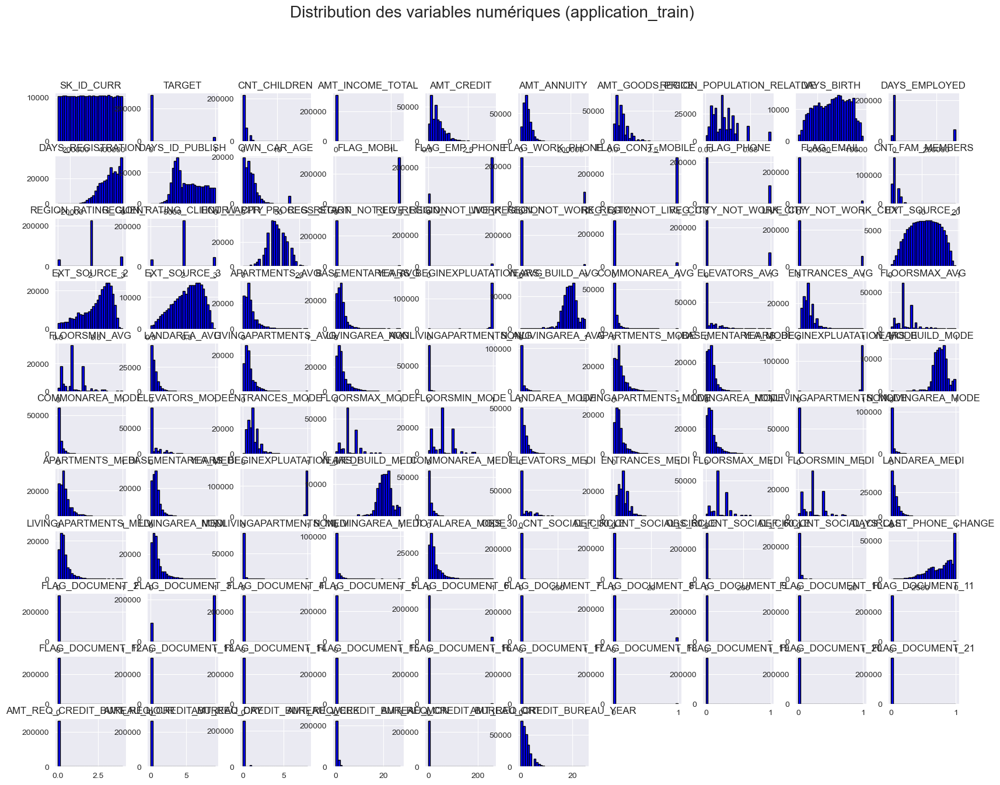

In [37]:
# Sélection des colonnes numériques
numeric_cols = application_train.select_dtypes(include=["float64", "int64"]).columns

# Visualisation des histogrammes
application_train[numeric_cols].hist(figsize=(20, 15), bins=30, color="blue", edgecolor="black")
plt.suptitle("Distribution des variables numériques (application_train)", fontsize=20)
plt.show()

### Observations 

Les histogrammes fournis dans l'image montrent la distribution des différentes variables numériques du jeu de données "application_train". Voici une analyse plus détaillée de certaines de ces distributions 

   * SK_ID_CURR :

        Observation : La variable SK_ID_CURR représente probablement un identifiant unique pour chaque entrée. L'histogramme montre une distribution uniforme, ce qui est attendu pour une variable de type identifiant.

        Implication : Cette variable n'est pas informative pour les modèles prédictifs car elle n'a pas de relation directe avec les autres variables.

   * DAYS_BIRTH :

        Observation : La variable DAYS_BIRTH montre une distribution relativement uniforme avec une concentration des valeurs autour de 20,000 jours (environ 55 ans).

        Implication : Les variations de l'âge peuvent être significatives pour l'analyse. Il pourrait être utile de transformer cette variable en années pour une meilleure interprétation.

   * FLAG_MOBIL :

        Observation : La variable FLAG_MOBIL est binaire et presque toutes les valeurs sont 1, indiquant que presque tous les clients possèdent un téléphone mobile.

        Implication : Cette variable est peu informative pour des analyses prédictives car il y a peu de variation.

   * AMT_CREDIT :

        Observation : La distribution est asymétrique vers la droite, indiquant que la plupart des crédits accordés sont de montants inférieurs, avec quelques crédits exceptionnellement élevés.

        Implication : Les valeurs extrêmes peuvent avoir un impact significatif sur les analyses. Une transformation logarithmique pourrait être envisagée pour normaliser la distribution.

   * EXT_SOURCE_2 et EXT_SOURCE_3 :

        Observation : Ces variables montrent des distributions plus normales, avec des valeurs concentrées autour de la moyenne.

        Implication : Ces variables sont probablement des scores externes utilisés dans l'évaluation du crédit et sont importantes pour la modélisation prédictive. Elles peuvent être utilisées directement sans transformation.

   * AMT_ANNUITY :

        Observation : La distribution est également asymétrique vers la droite, similaire à AMT_CREDIT.

        Implication : Des transformations similaires à celles de AMT_CREDIT peuvent être envisagées pour normaliser cette variable.

   * CNT_CHILDREN :

        Observation : La plupart des valeurs sont concentrées autour de 0 à 2 enfants, avec quelques valeurs extrêmes plus élevées.

        Implication : Cette variable peut être utilisée telle quelle, mais les valeurs extrêmes doivent être examinées pour déterminer leur impact sur l'analyse.

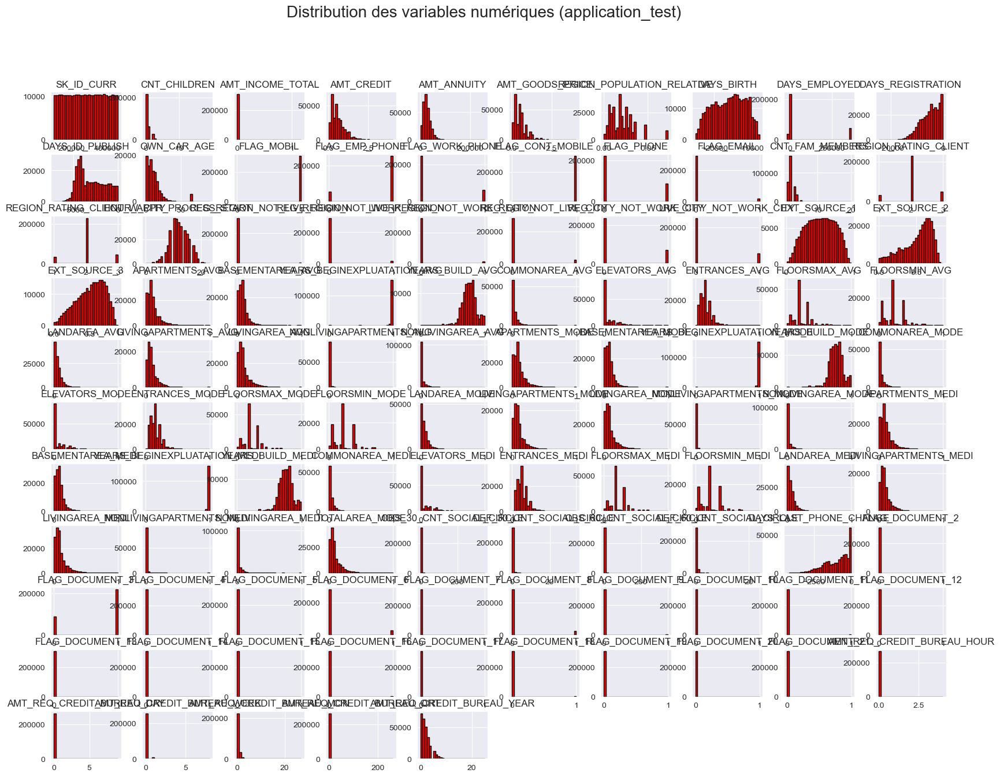

In [38]:
# Sélection des colonnes numériques
numeric_cols = application_test.select_dtypes(include=["float64", "int64"]).columns

# Visualisation des histogrammes
application_train[numeric_cols].hist(figsize=(20, 15), bins=30, color="red", edgecolor="black")
plt.suptitle("Distribution des variables numériques (application_test)", fontsize=20)
plt.show()

## Observation 
 * SK_ID_CURR :

    Observation : Cette variable represente  un identifiant unique pour chaque entrée. L'histogramme montre une distribution uniforme, ce qui est attendu pour une variable de type identifiant.

    Implication : Cette variable n'est pas informative pour les modèles prédictifs car elle n'a pas de relation directe avec les autres variables.

* CNT_CHILDREN :

    Observation : La plupart des valeurs sont concentrées autour de 0 à 2 enfants, avec quelques valeurs extrêmes plus élevées.

    Implication : Cette variable peut être utilisée telle quelle, mais les valeurs extrêmes doivent être examinées pour déterminer leur impact sur l'analyse.

* AMT_INCOME_TOTAL :

    Observation : La distribution est asymétrique vers la droite, suggérant que la plupart des revenus totaux sont inférieurs, avec quelques valeurs exceptionnellement élevées.

    Implication : Les valeurs extrêmes peuvent avoir un impact significatif sur les analyses. Une transformation logarithmique pourrait être envisagée pour normaliser la distribution.

* AMT_CREDIT :

    Observation : La distribution est également asymétrique vers la droite, indiquant que la majorité des crédits accordés sont de montants inférieurs, avec quelques crédits exceptionnellement élevés.

    Implication : Les valeurs extrêmes peuvent influencer les résultats des modèles prédictifs. Une transformation logarithmique peut être utile.

* DAYS_BIRTH :

    Observation : Cette variable montre une distribution relativement uniforme avec une concentration des valeurs autour de 20,000 jours (environ 55 ans).

    Implication : Convertir cette variable en années peut rendre les données plus interprétables pour l'analyse.

* DAYS_EMPLOYED :

    Observation : Cette variable montre une distribution intéressante où certaines valeurs sont négatives, indiquant le nombre de jours depuis le dernier emploi.

    Implication : Il peut être utile de traiter les valeurs négatives et de convertir les jours en années pour une meilleure interprétation.

* EXT_SOURCE_1, EXT_SOURCE_2, et EXT_SOURCE_3 :

    Observation : Ces variables montrent des distributions plus normales, avec des valeurs concentrées autour de la moyenne.

    Implication : Ces variables sont probablement des scores externes utilisés dans l'évaluation du crédit et peuvent être utilisées directement dans les modèles prédictifs sans transformation.

* FLAG_DOCUMENT_2 à FLAG_DOCUMENT_21 :

    Observation : Ces variables binaires montrent une distribution concentrée sur les valeurs 0 et 1.

    Implication : Ces variables indiquent la présence ou l'absence de documents spécifiques et peuvent être utilisées telles quelles dans les modèles.

## Étape 6 : Matrice de corrélation
* Calcul et affichage de la matrice de corrélation.

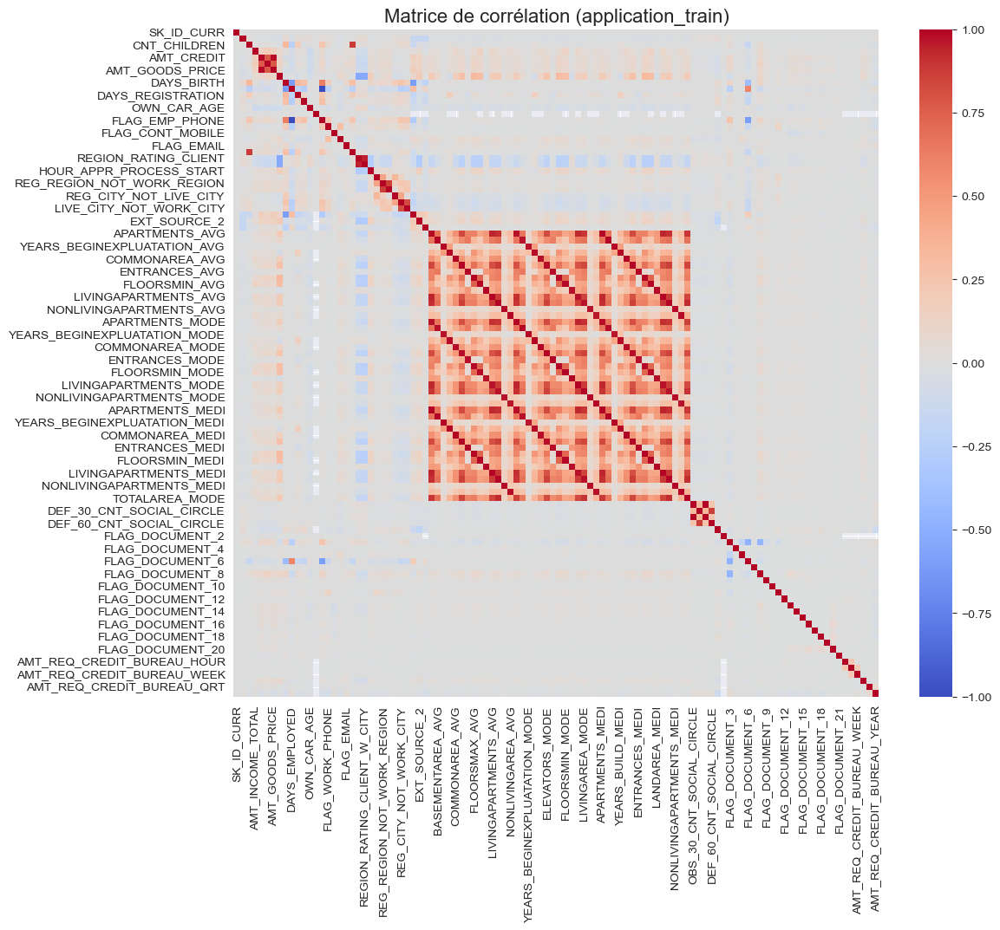

In [39]:
# Calcul de la corrélation uniquement pour les colonnes numériques
numeric_cols = application_train.select_dtypes(include=["float64", "int64"]).columns
train_numeric = application_train[numeric_cols]

# Matrice de corrélation
corr = train_numeric.corr()

# Visualisation
plt.figure(figsize=(12, 10))
sns.heatmap(corr, cmap="coolwarm", vmin=-1, vmax=1, annot=False)
plt.title("Matrice de corrélation (application_train)", fontsize=16)
plt.show()


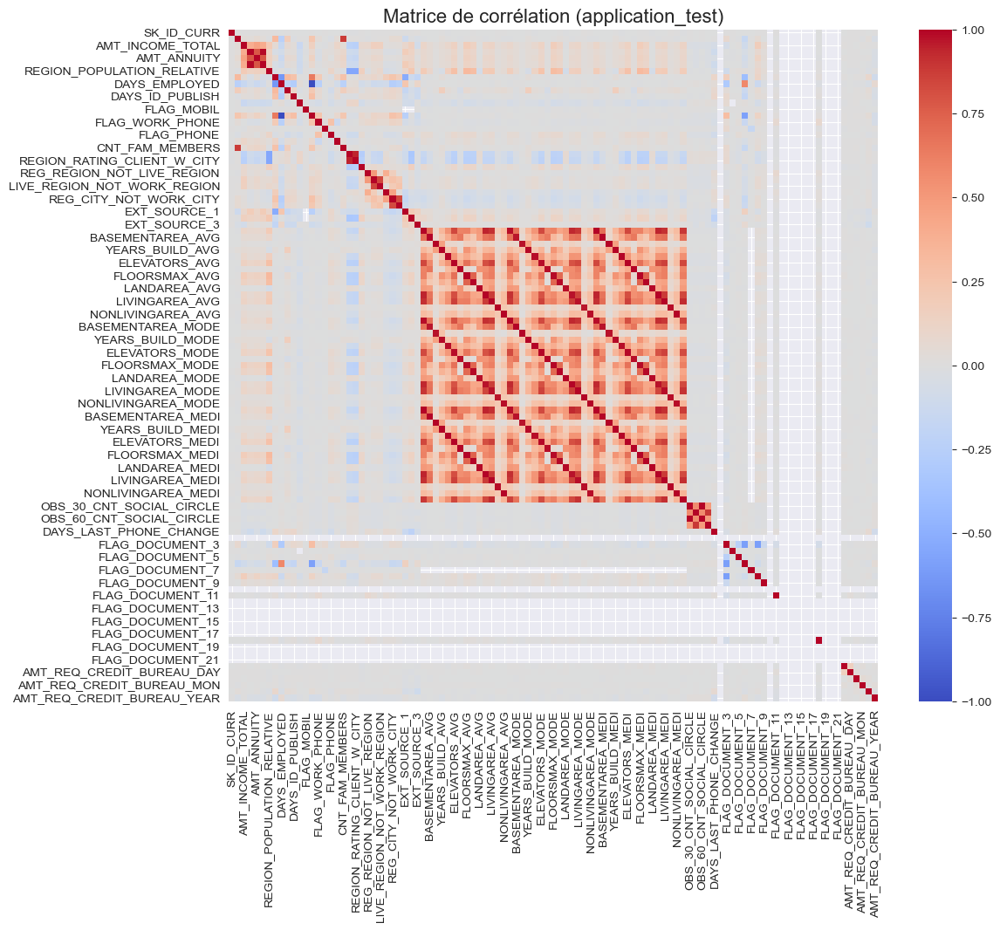

In [40]:
# Calcul de la corrélation uniquement pour les colonnes numériques
numeric_cols = application_test.select_dtypes(include=["float64", "int64"]).columns
train_numeric = application_test[numeric_cols]

# Matrice de corrélation
corr = train_numeric.corr()

# Visualisation
plt.figure(figsize=(12, 10))
sns.heatmap(corr, cmap="coolwarm", vmin=-1, vmax=1, annot=False)
plt.title("Matrice de corrélation (application_test)", fontsize=16)
plt.show()


Remarques

   - AMT_CREDIT et AMT_ANNUITY :

        La corrélation positive élevée suggère que les montants de crédit plus élevés entraînent des annuités plus élevées. Cela est logique car un crédit plus élevé nécessite des paiements mensuels plus importants.
        

   - DAYS_BIRTH et AMT_CREDIT :

        La corrélation négative faible indique que les clients plus âgés ont tendance à recevoir des crédits moins élevés, possiblement en raison de critères de risque de crédit ou de la durée restante pour rembourser le crédit.
        

   - EXT_SOURCE_1 et EXT_SOURCE_2 :

        Les scores externes sont utilisés pour évaluer le risque de crédit. Leur corrélation significative suggère qu'ils mesurent des aspects similaires de la solvabilité des clients.

   - EXT_SOURCE_2 et EXT_SOURCE_3 :

        Les scores externes 2 et 3 étant corrélés, ils peuvent offrir des informations redondantes. Il pourrait être utile d'examiner s'ils apportent des informations distinctes ou si l'un peut être privilégié.

   - DAYS_EMPLOYED et AMT_CREDIT :

        La corrélation faible indique que la durée d'emploi a peu d'influence sur le montant du crédit accordé. Cependant, elle peut encore avoir des implications pour l'analyse des risques.

   - CNT_CHILDREN et AMT_INCOME_TOTAL :

        La corrélation très faible montre que le nombre d'enfants n'a pas un impact significatif sur le revenu total déclaré par les clients. D'autres facteurs peuvent être plus déterminants pour le revenu.

## Étape 7 : Relation entre TARGET et variables numériques
* Boxplots pour explorer les relations entre TARGET et les variables numériques.

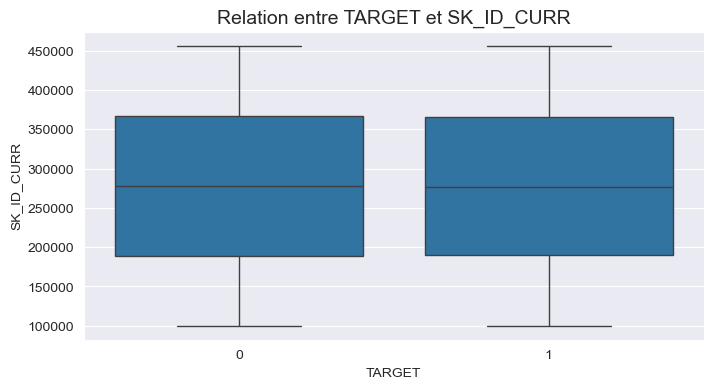

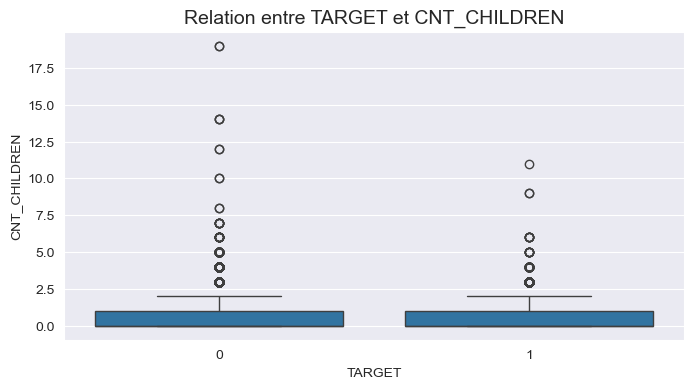

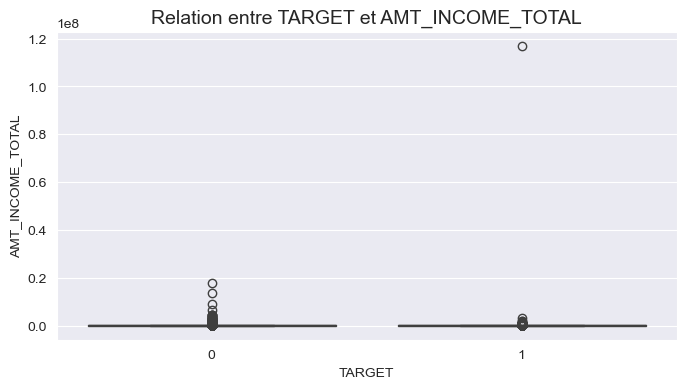

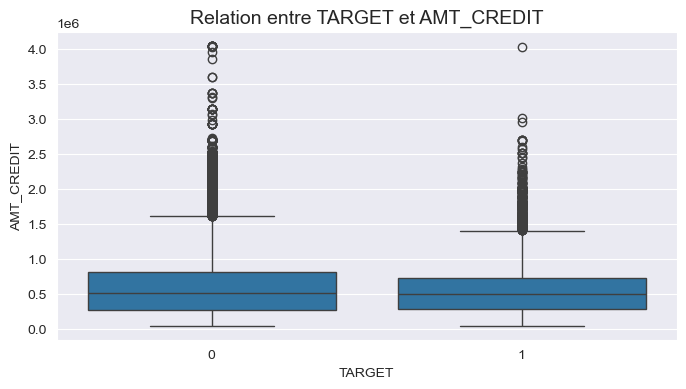

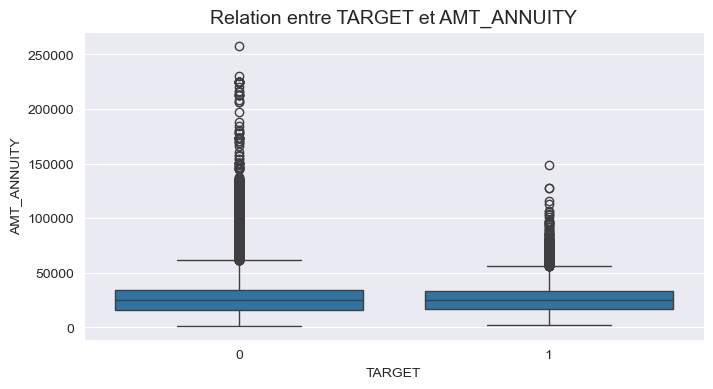

...

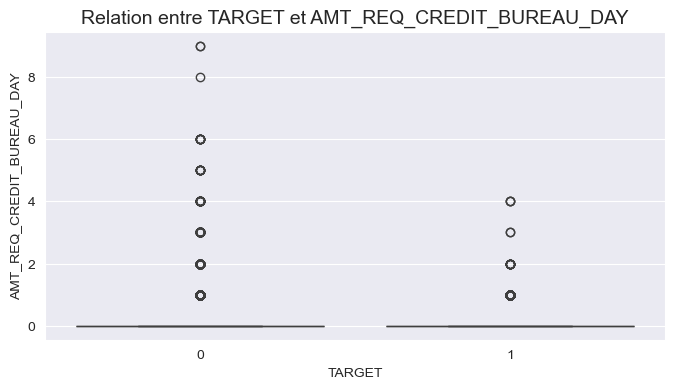

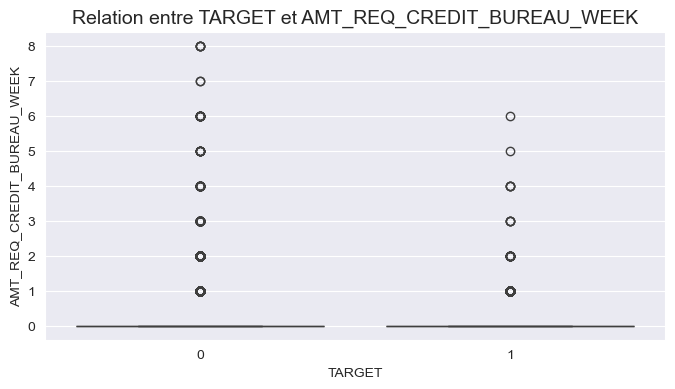

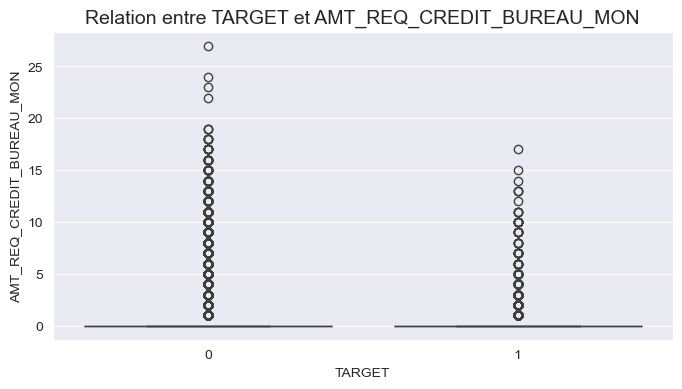

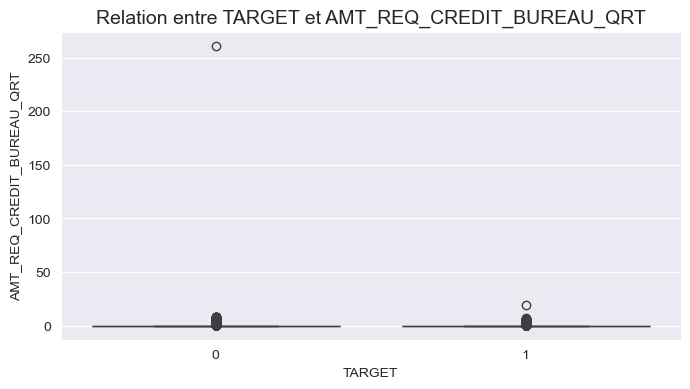

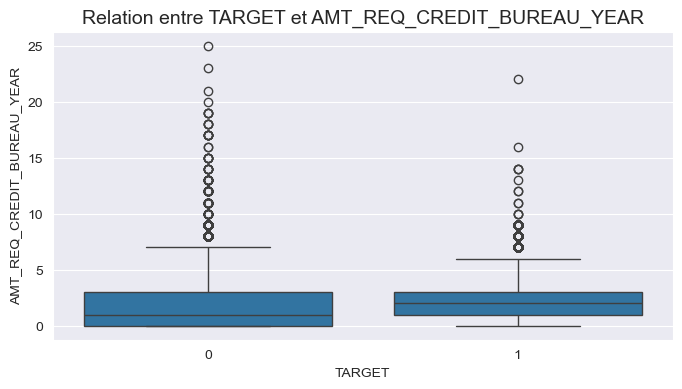

In [41]:
# Vérification que TARGET est présent
if "TARGET" in application_train.columns:
    # Visualisation des relations
    for col in numeric_cols:
        if col != "TARGET":
            plt.figure(figsize=(8, 4))
            sns.boxplot(x=application_train["TARGET"], y=application_train[col])
            plt.title(f"Relation entre TARGET et {col}", fontsize=14)
            plt.xlabel("TARGET")
            plt.ylabel(col)
            plt.show()


## Observations 

* SK_ID_CURR :

    Relation : Aucune relation significative avec TARGET.

    Conclusion : SK_ID_CURR n'est pas utile pour la modélisation prédictive.

* CNT_CHILDREN :

    Relation : Distribution similaire du nombre d'enfants pour TARGET = 0 et TARGET = 1.

    Conclusion : Le nombre d'enfants n'a pas de relation significative avec TARGET.

* AMT_INCOME_TOTAL :

    Relation : Médiane légèrement plus élevée pour TARGET = 0.

    Conclusion : Les clients avec des revenus plus élevés sont légèrement moins susceptibles de faire défaut.

* AMT_CREDIT :

    Relation : Médiane des crédits légèrement plus élevée pour TARGET = 0.

    Conclusion : Les clients avec des crédits plus élevés sont légèrement moins susceptibles de faire défaut.

* AMT_ANNUITY :

    Relation : Médiane des annuités légèrement plus élevée pour TARGET = 0.

    Conclusion : Les clients avec des annuités plus élevées sont légèrement moins susceptibles de faire défaut.

* AMT_GOODS_PRICE :

    Relation : Distribution similaire des montants des biens pour TARGET = 0 et TARGET = 1.

    Conclusion : Le montant des biens financés n'a pas de relation significative avec TARGET.

* REGION_POPULATION_RELATIVE :

    Relation : Distribution similaire de la population relative de la région pour TARGET = 0 et TARGET = 1.

    Conclusion : La population relative de la région n'a pas de relation significative avec TARGET.

* DAYS_BIRTH :

    Relation : Distribution similaire de l'âge (en jours) pour TARGET = 0 et TARGET = 1.

    Conclusion : L'âge n'a pas de relation significative avec TARGET.

* DAYS_EMPLOYED :

    Relation : Distribution similaire de la durée d'emploi pour TARGET = 0 et TARGET = 1.

    Conclusion : La durée d'emploi n'a pas de relation significative avec TARGET.

* DAYS_REGISTRATION :

    Relation : Distribution similaire de la durée d'enregistrement pour TARGET = 0 et TARGET = 1.

    Conclusion : La durée d'enregistrement n'a pas de relation significative avec TARGET.

* DAYS_ID_PUBLISH :

    Relation : Distribution similaire des jours de publication des documents pour TARGET = 0 et TARGET = 1.

    Conclusion : Les jours de publication des documents n'ont pas de relation significative avec TARGET.

* OWN_CAR_AGE :

    Relation : Distribution similaire de l'âge des voitures pour TARGET = 0 et TARGET = 1.

    Conclusion : L'âge de la voiture possédée n'a pas de relation significative avec TARGET.

* FLAG_PHONE :

    Relation : Tous les individus de TARGET = 0 ont un téléphone, alors qu'aucun individu de TARGET = 1 n'en a.

    Conclusion : La présence de téléphone peut être un prédicteur significatif de la solvabilité des individus.
    

* CNT_FAM_MEMBERS :

    Relation : Distribution similaire du nombre de membres de la famille pour TARGET = 0 et TARGET = 1.

    Conclusion : Le nombre de membres de la famille n'a pas de relation significative avec TARGET.
    

* HOUR_APPR_PROCESS_START :

    Relation : Médiane des heures de début légèrement plus élevée pour TARGET = 1.

    Conclusion : L'heure de début du processus d'approbation n'a pas de relation significative avec TARGET.

* AMT_REQ_CREDIT_BUREAU_YEAR :

    Relation : Médiane des requêtes de crédit par an plus élevée pour TARGET = 0.

    Conclusion : Le nombre de requêtes de crédit par an peut être un prédicteur significatif de la solvabilité des individus.

* TOTALAREA_MODE :

    Relation : Distribution des valeurs similaire pour les deux catégories de TARGET.

    Conclusion : La variable TOTALAREA_MODE n'a pas de relation significative avec TARGET.

* NONLIVINGAREA_MEDI :

    Relation : Distribution similaire de l'aire non habitée médiane pour TARGET = 0 et TARGET = 1.

    Conclusion : L'aire non habitée médiane n'a pas de relation significative avec TARGET.

* FLOORSMIN_MEDI :

    Relation : Distribution similaire de la valeur médiane des étages minimum pour TARGET = 0 et TARGET = 1.

    Conclusion : La valeur médiane des étages minimum n'a pas de relation significative avec TARGET.

## Étape 8 : Comparaison entre application_train et application_test
* Comparaison des distributions des variables numériques communes entre les deux datasets.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




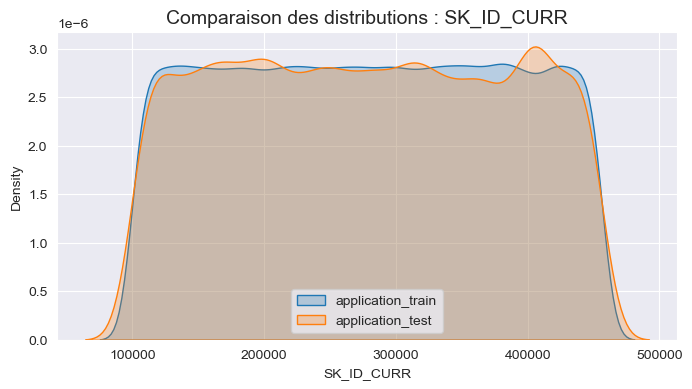

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




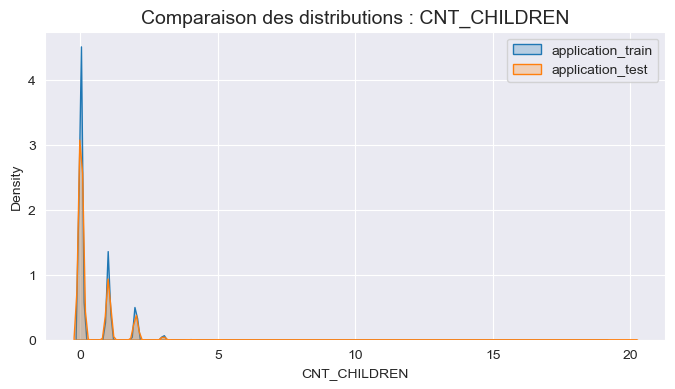

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




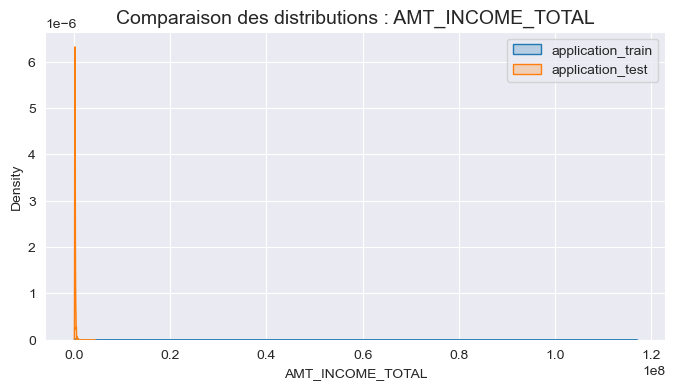

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




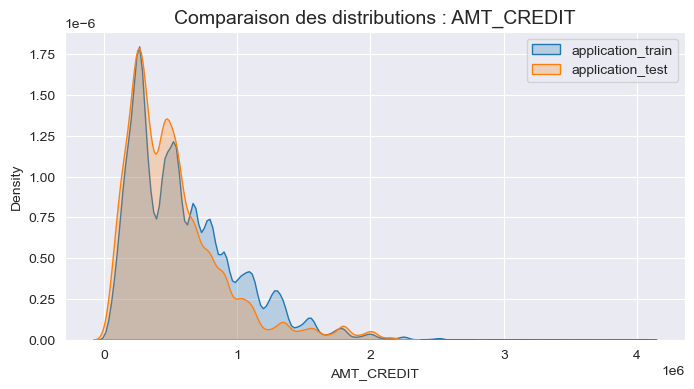

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




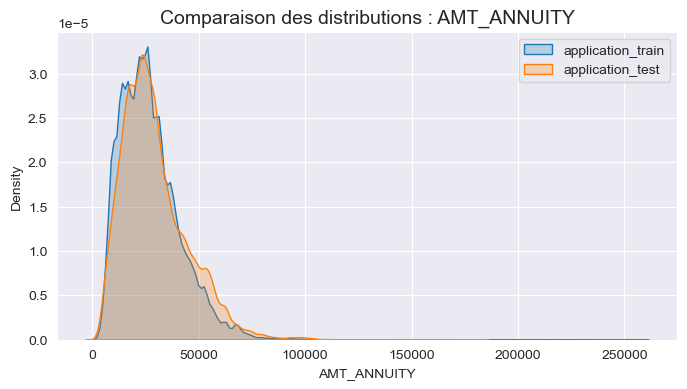

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




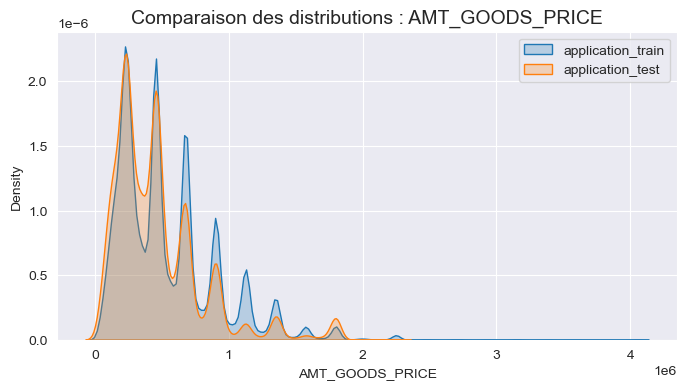

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




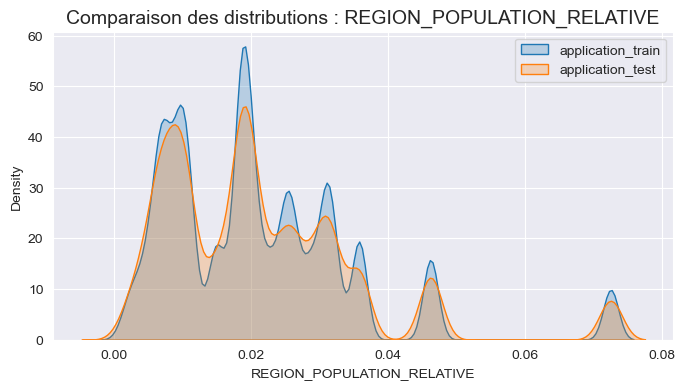

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




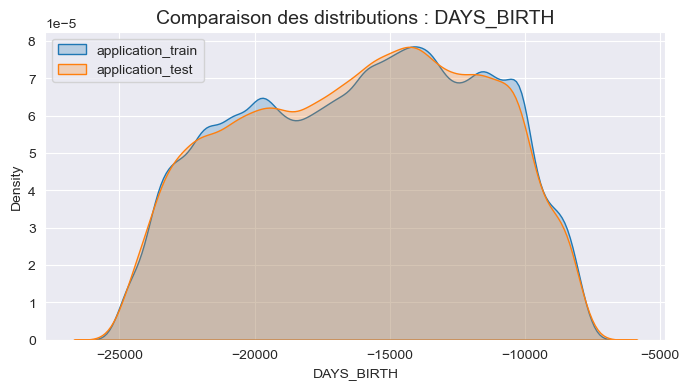

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




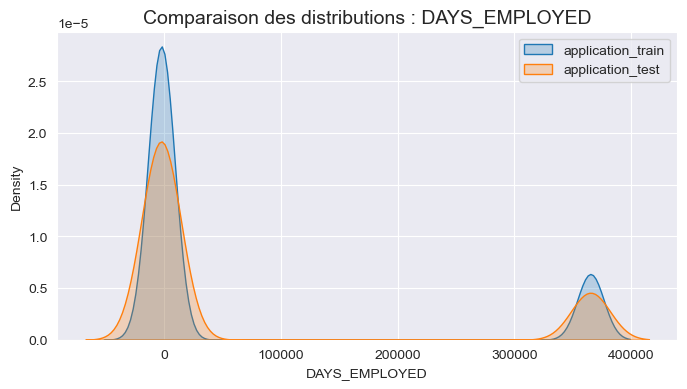

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




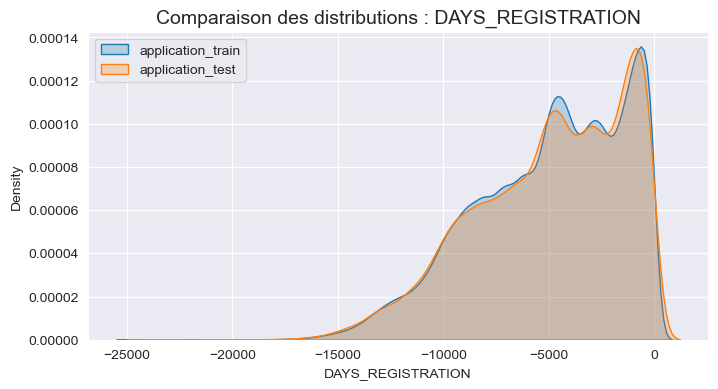

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




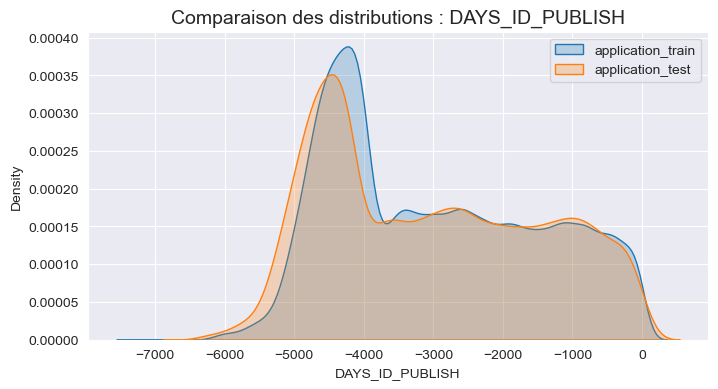

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




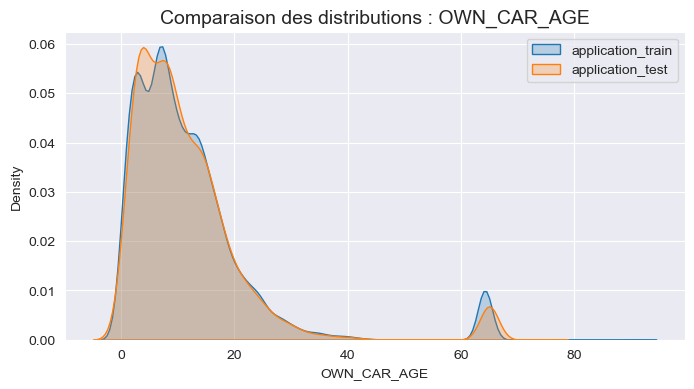

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




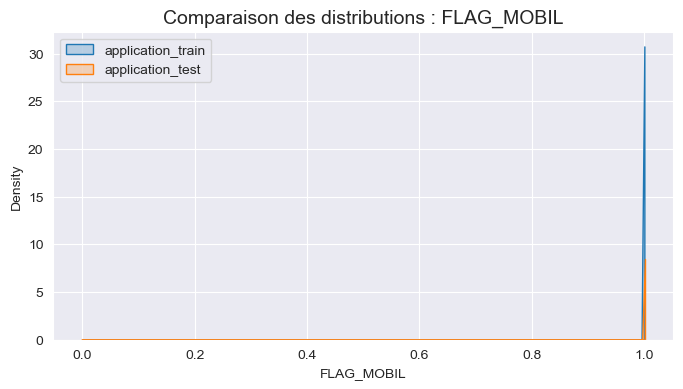

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




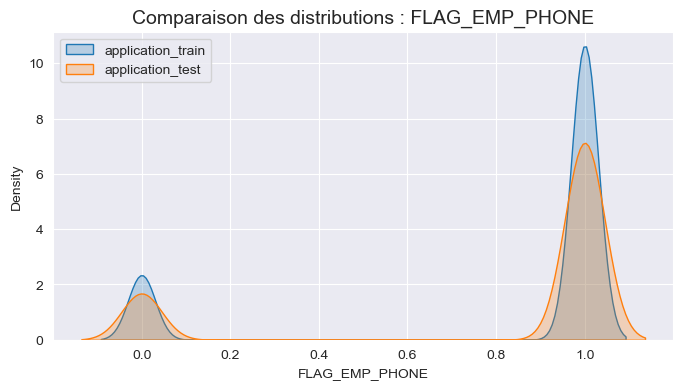

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




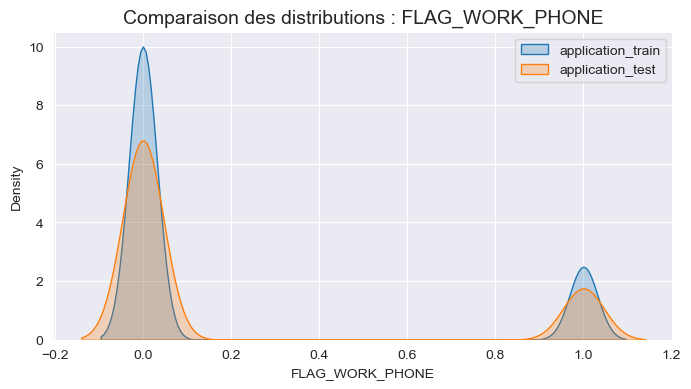

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




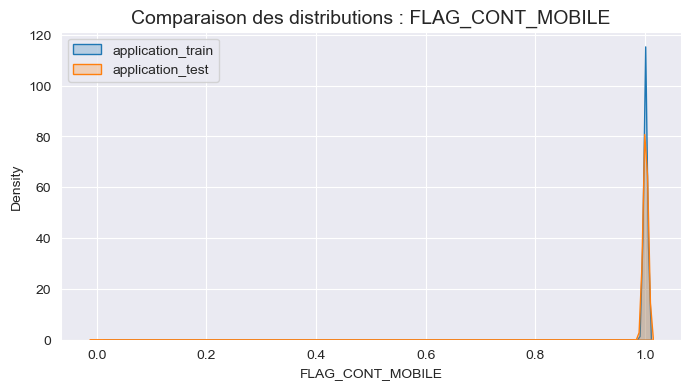

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




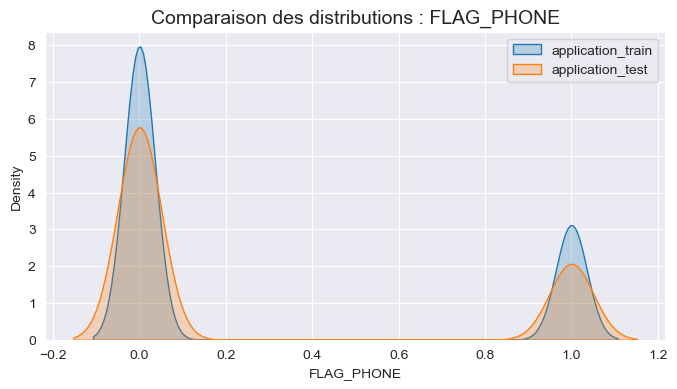

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




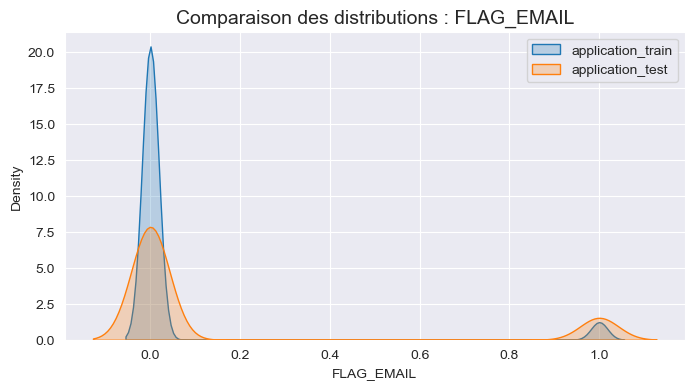

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




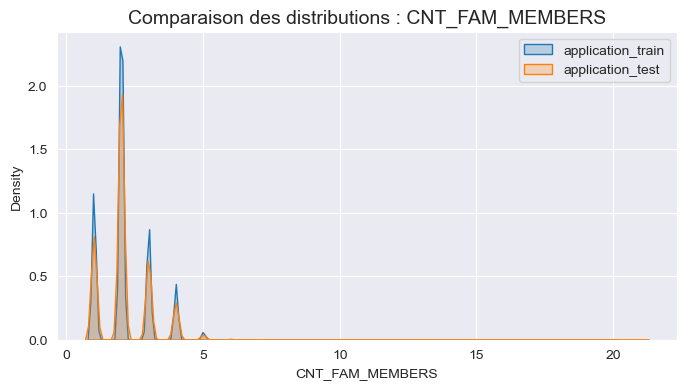

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




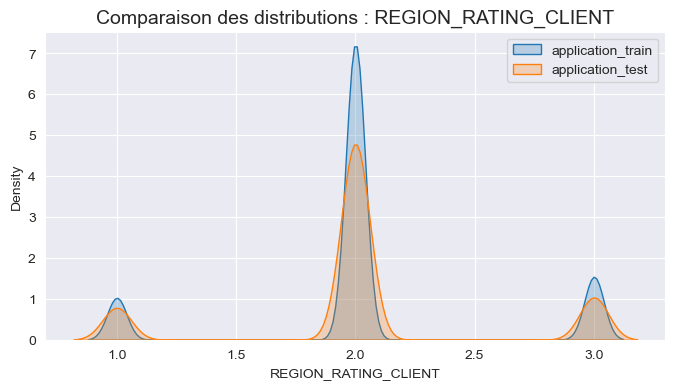

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




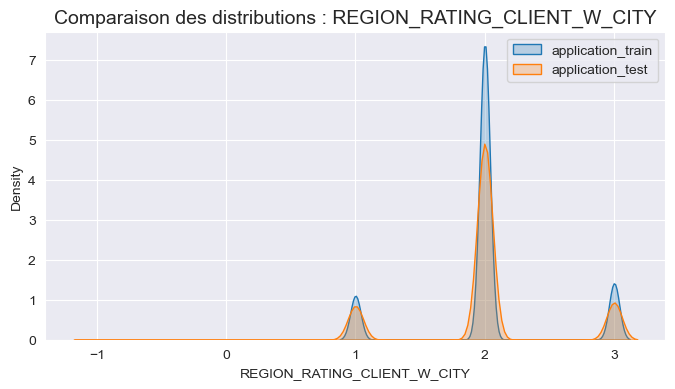

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




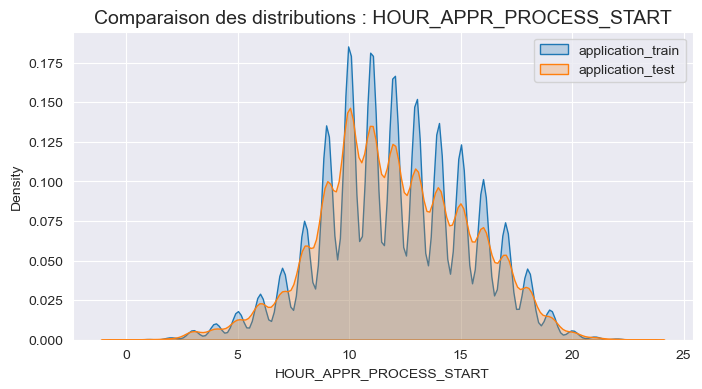

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




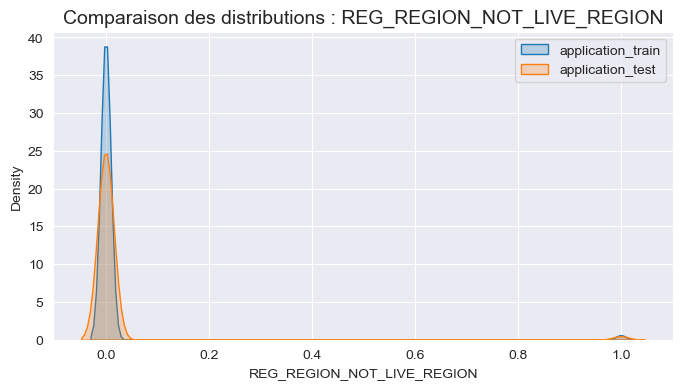

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




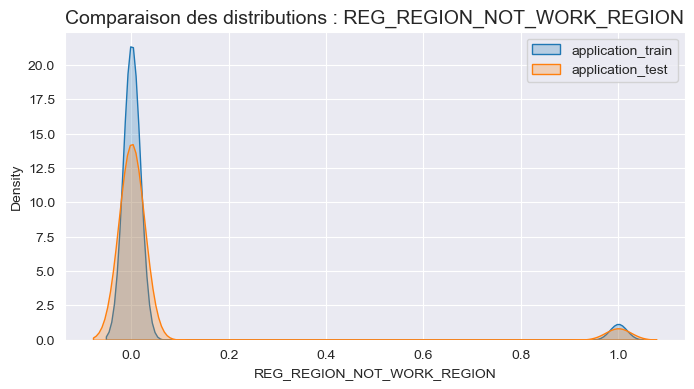

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




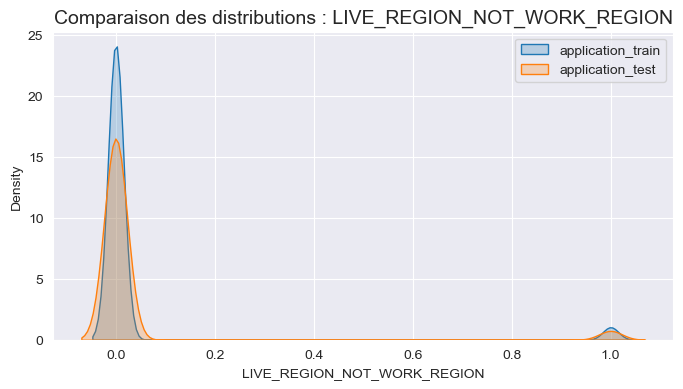

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




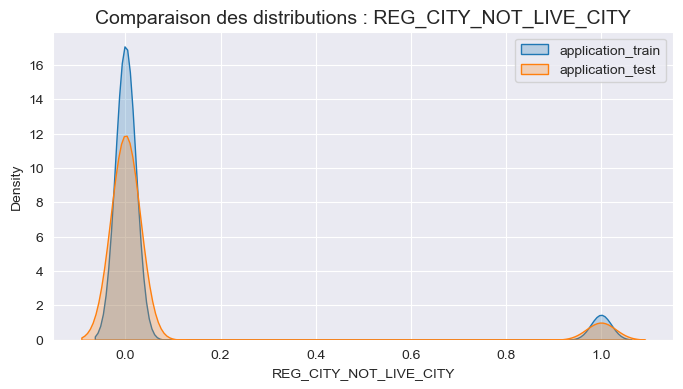

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




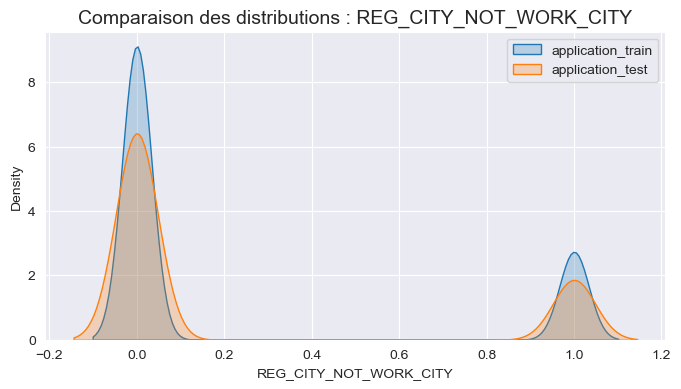

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




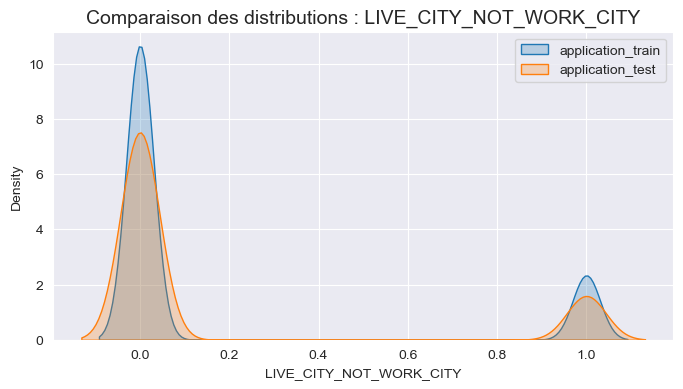

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




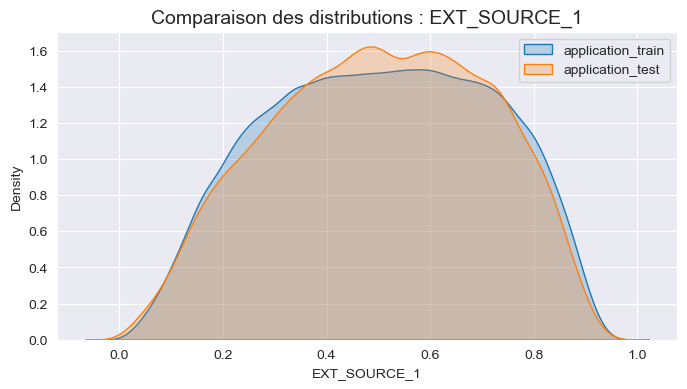

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




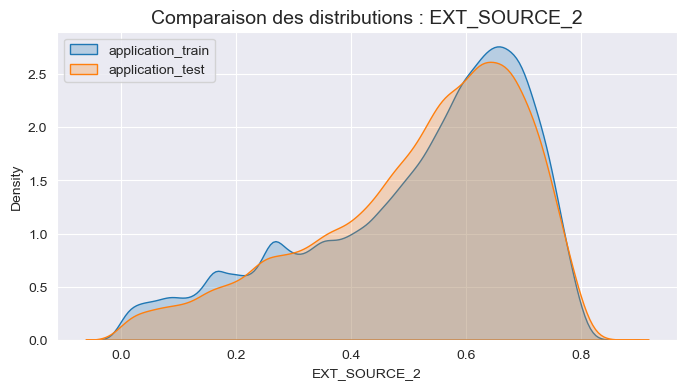

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




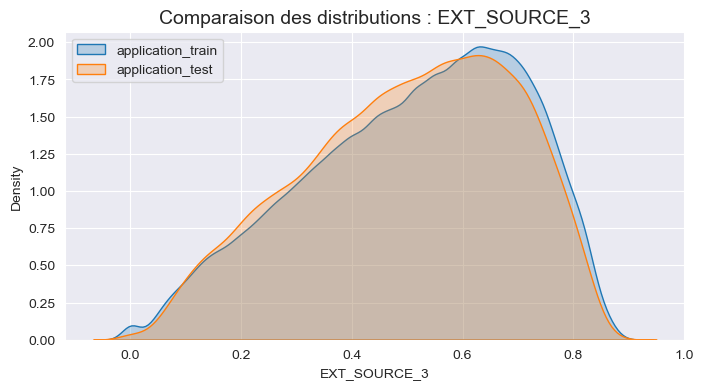

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




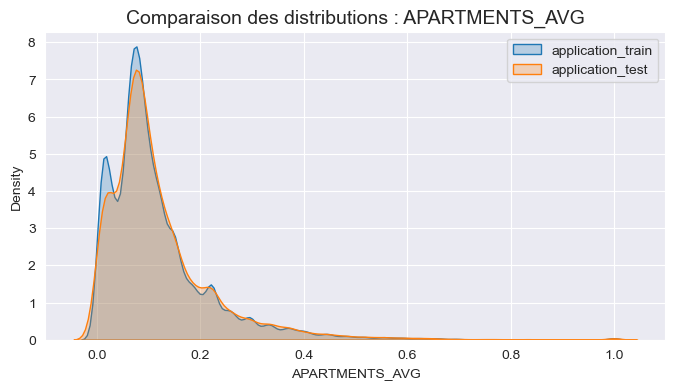

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




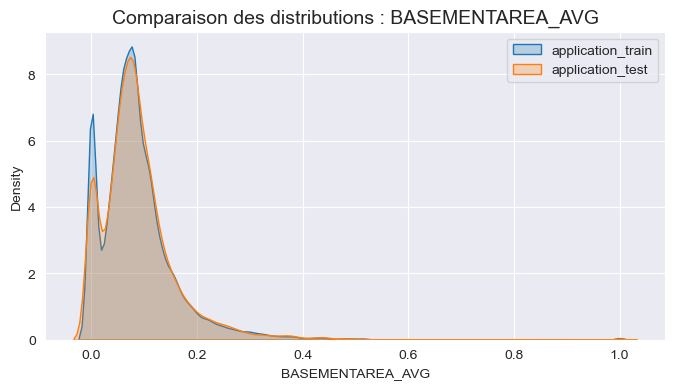

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




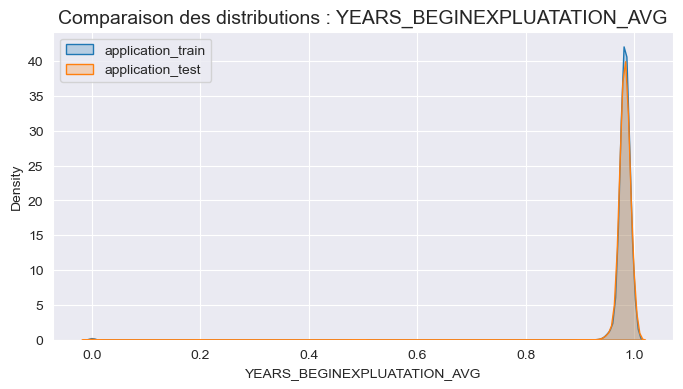

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




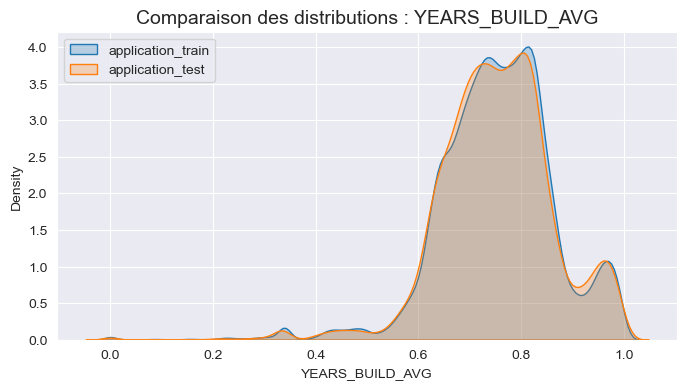

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




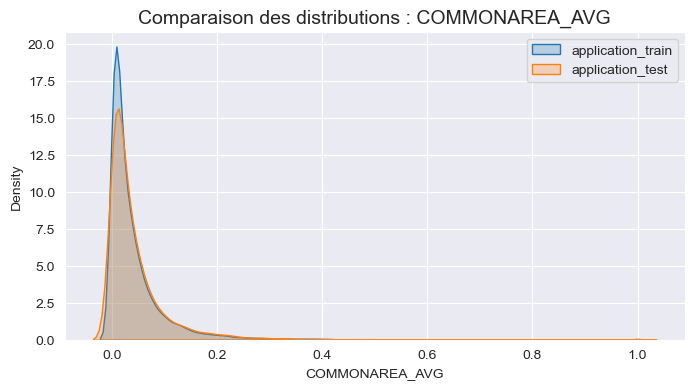

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




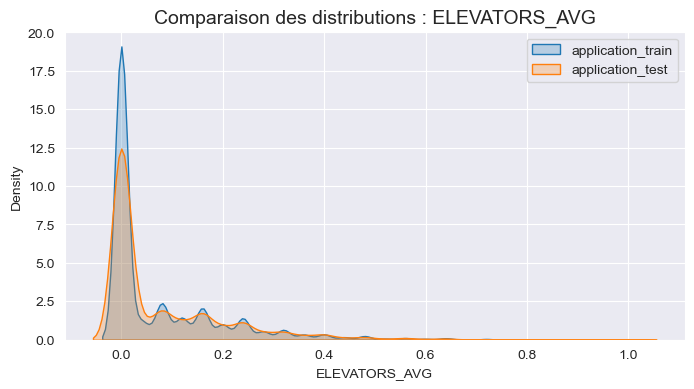

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




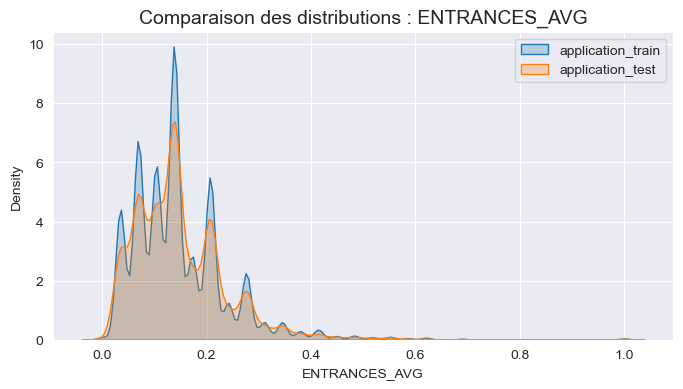

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




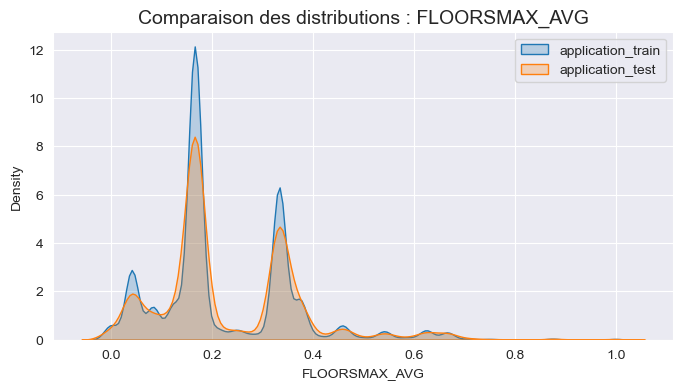

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




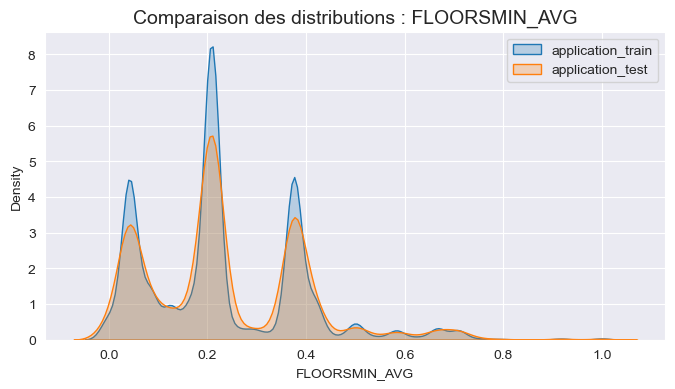

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




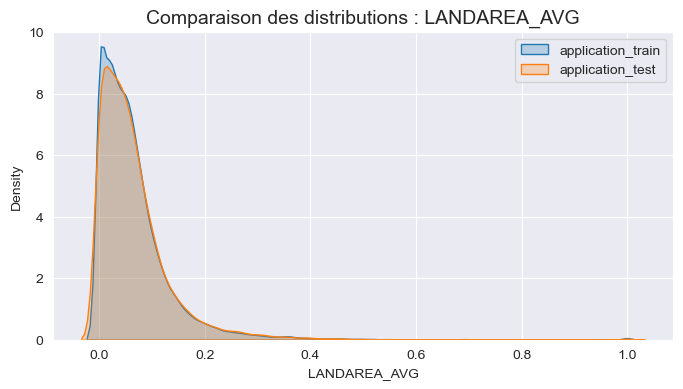

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




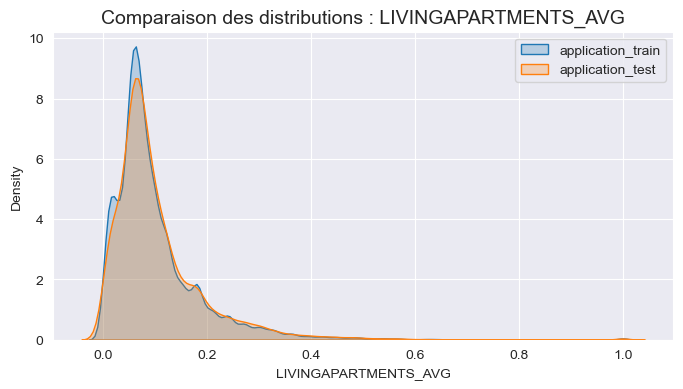

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




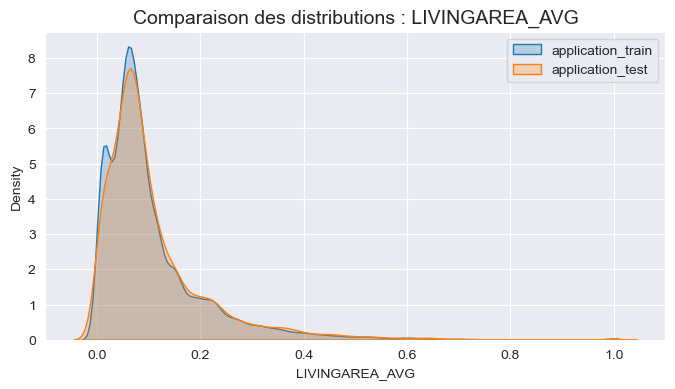

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




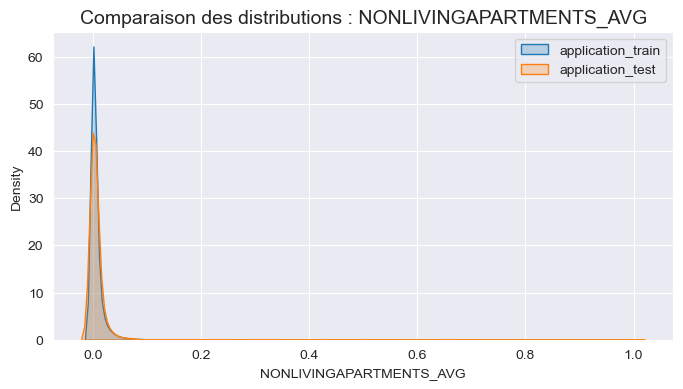

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




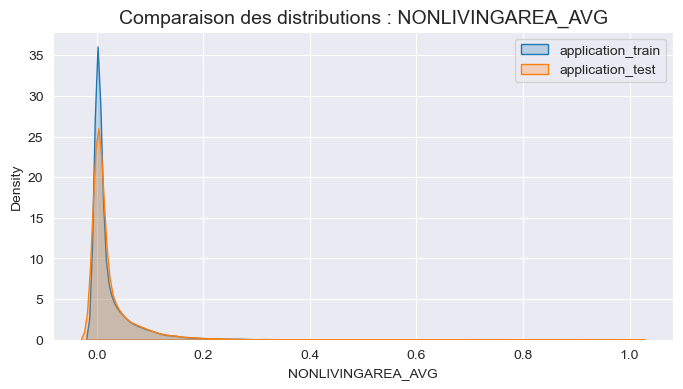

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




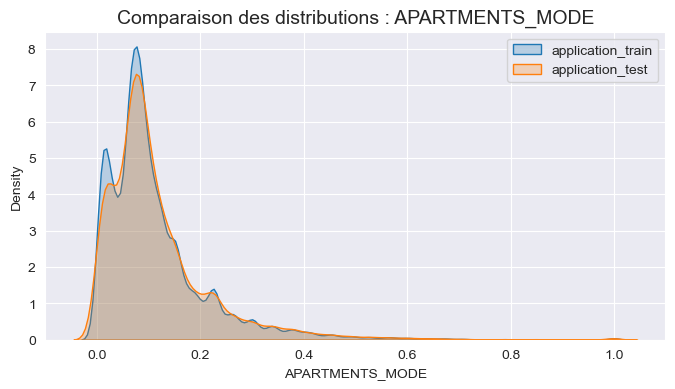

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




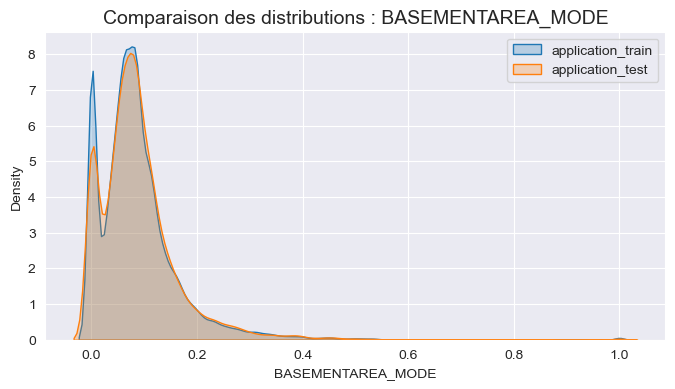

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




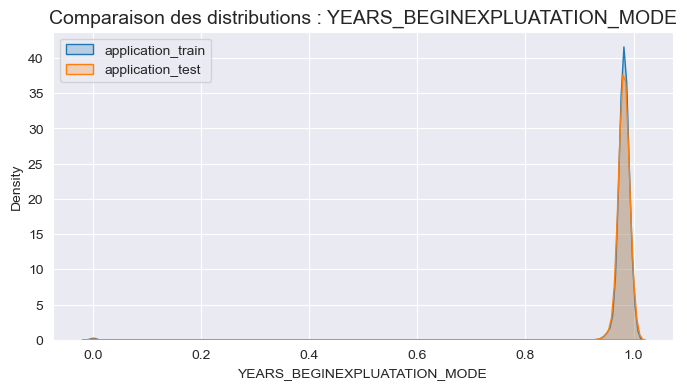

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




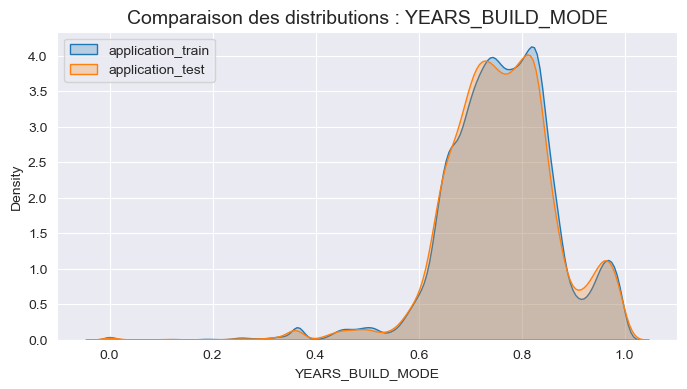

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




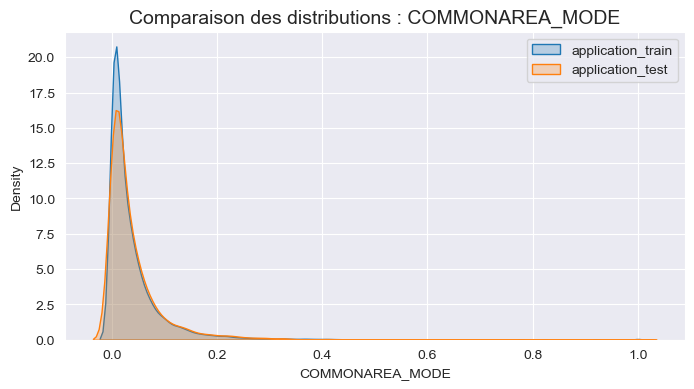

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




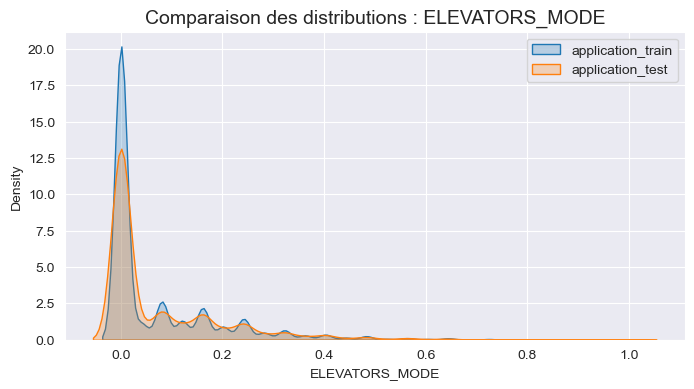

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




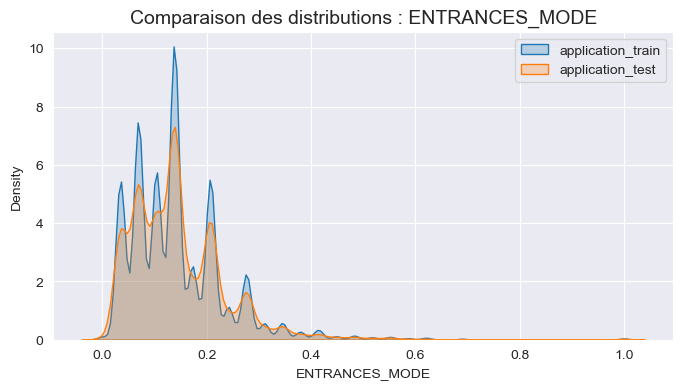

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




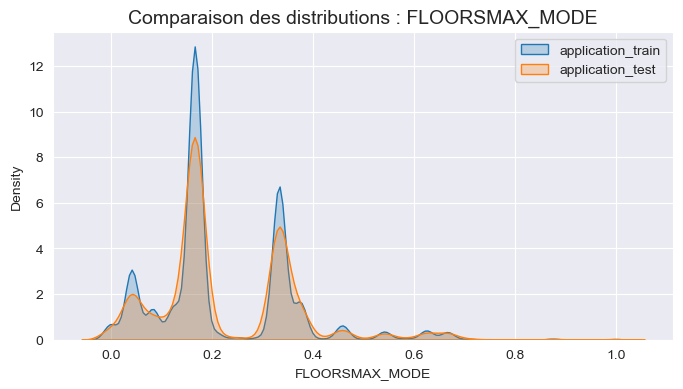

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




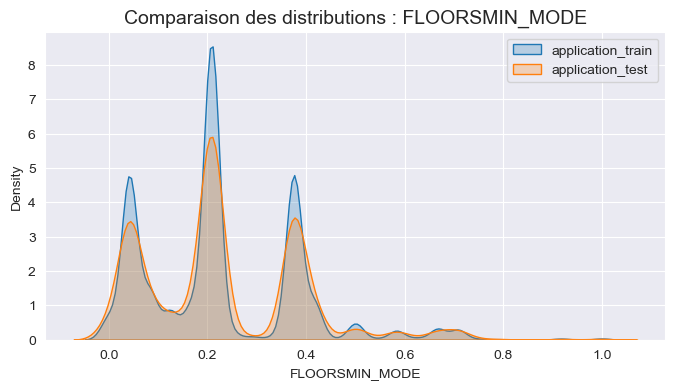

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




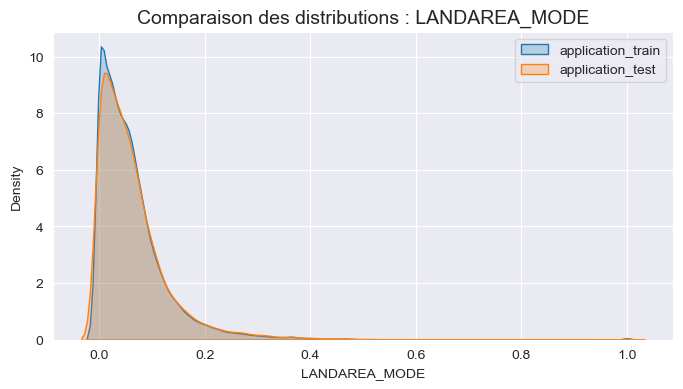

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




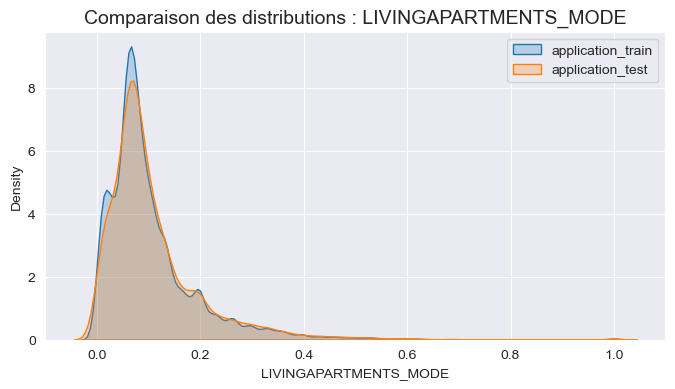

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




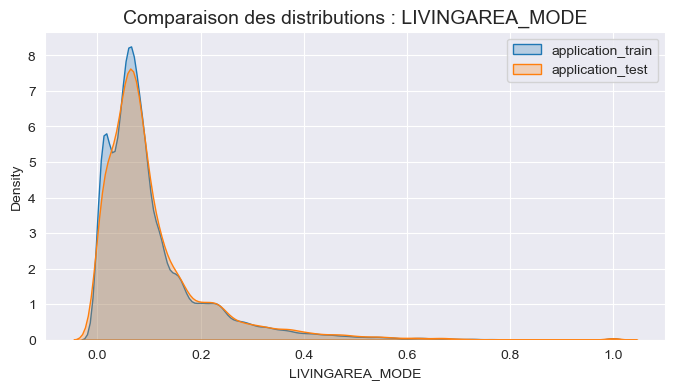

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




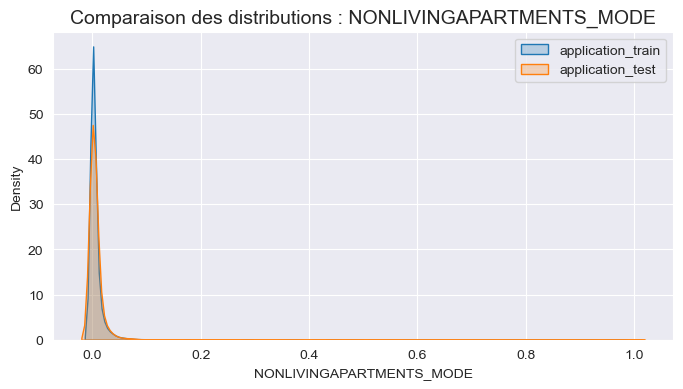

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




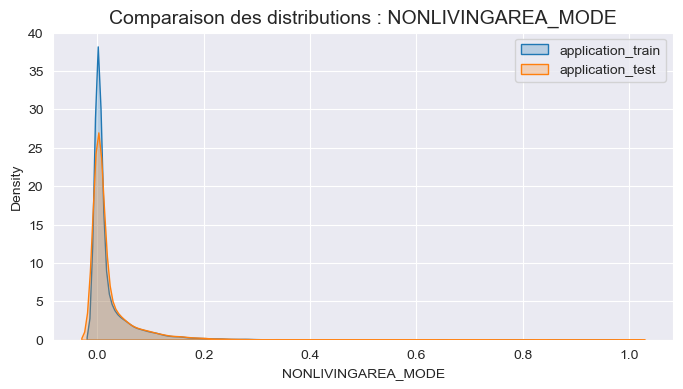

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




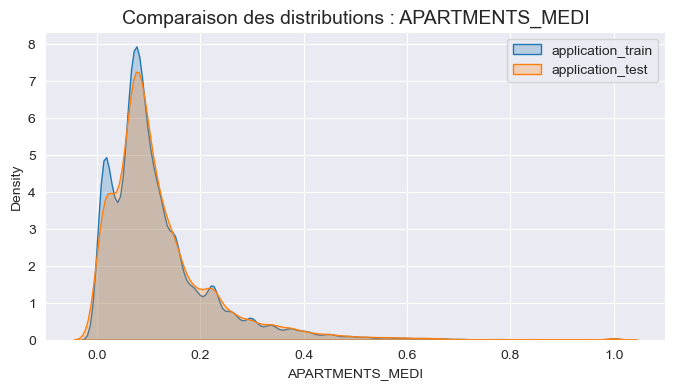

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




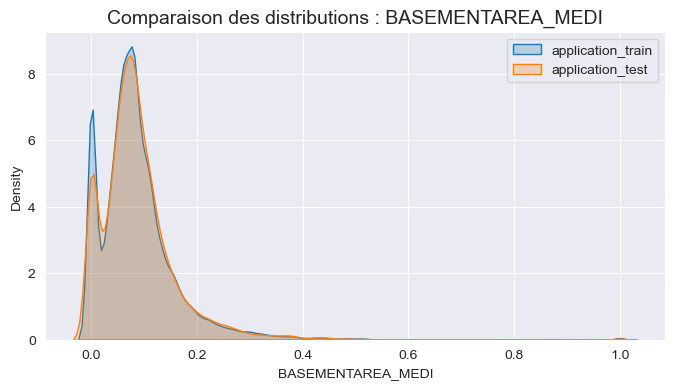

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




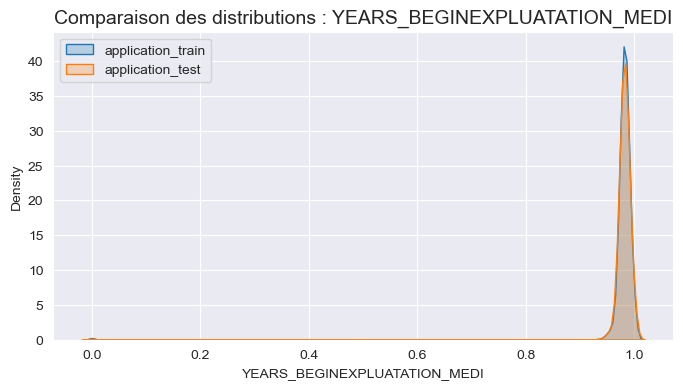

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




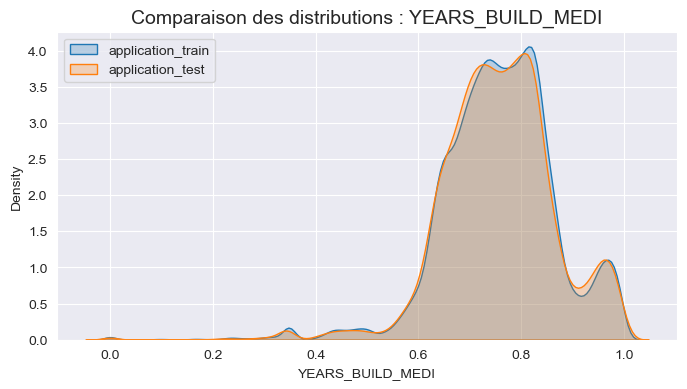

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




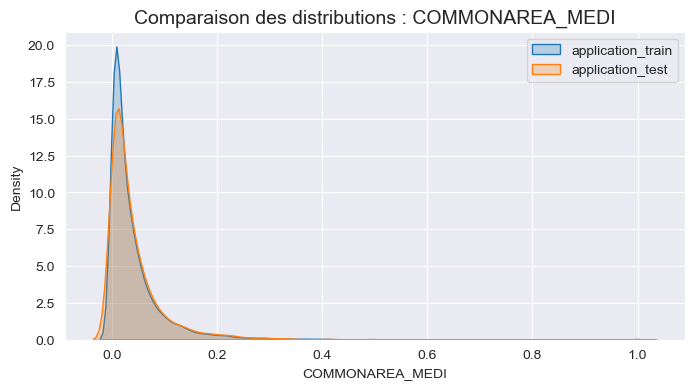

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




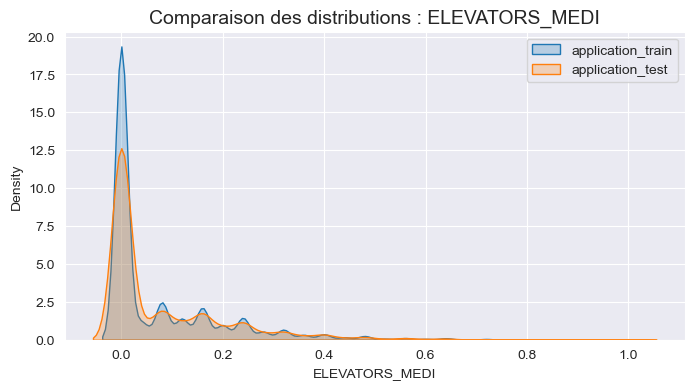

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




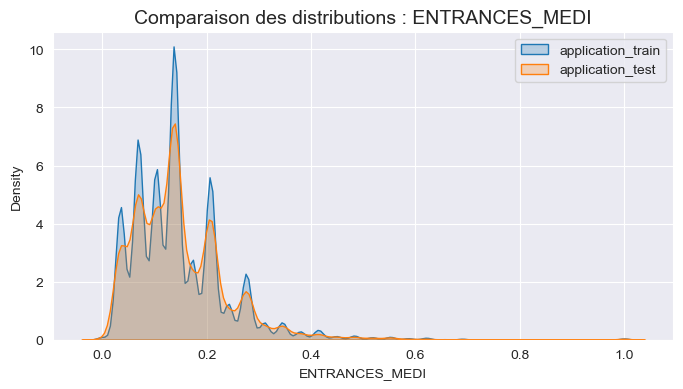

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




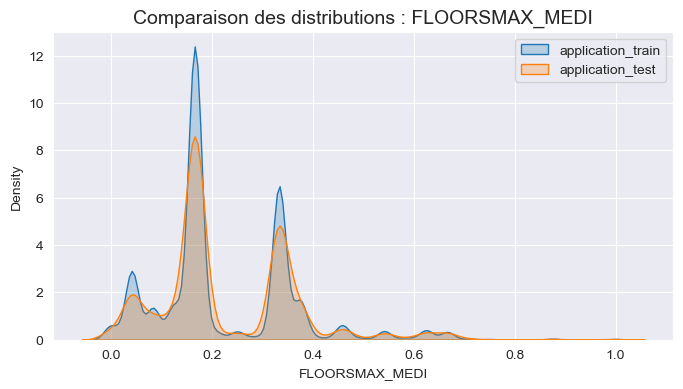

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




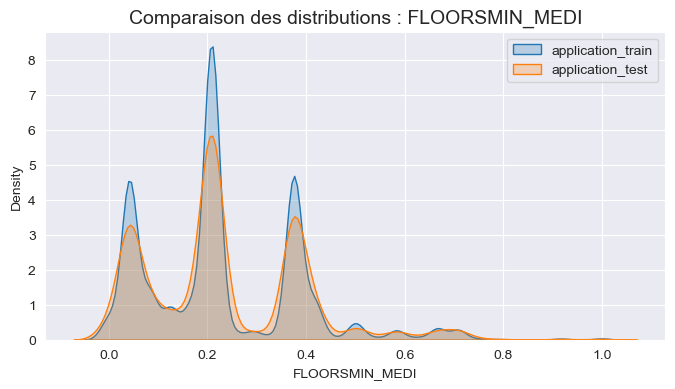

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




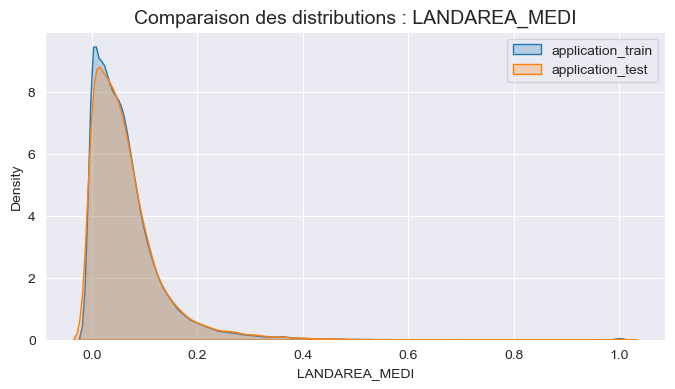

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




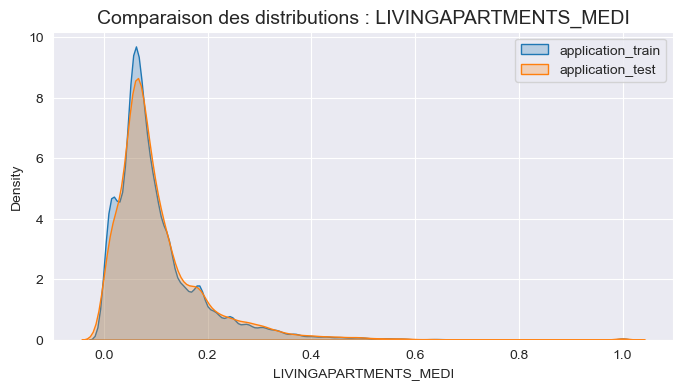

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




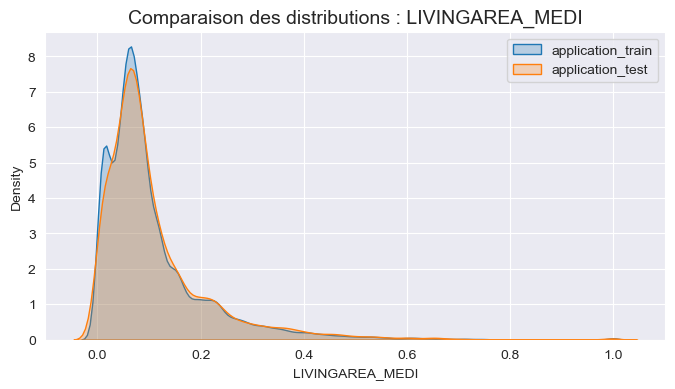

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




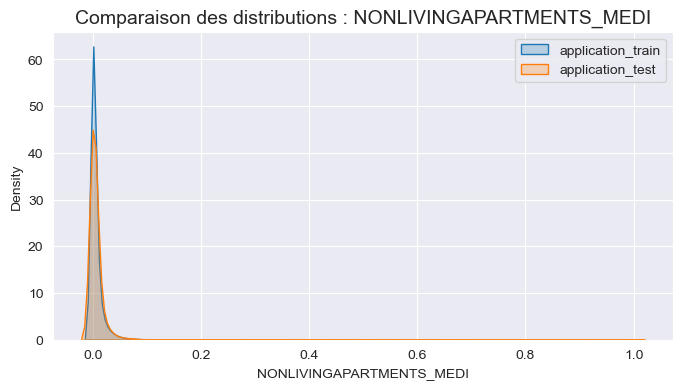

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




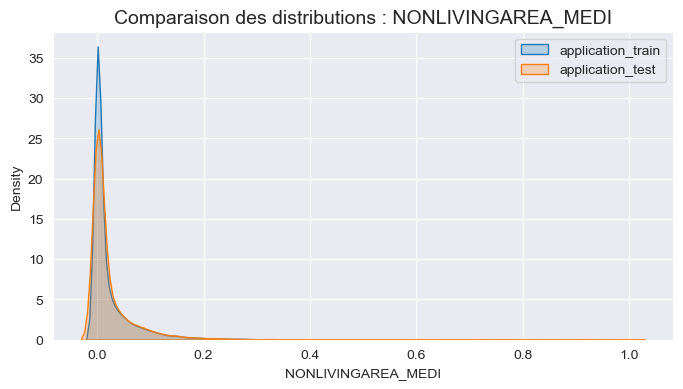

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




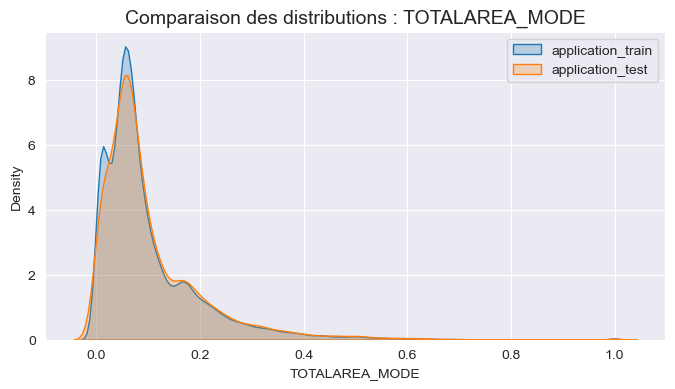

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




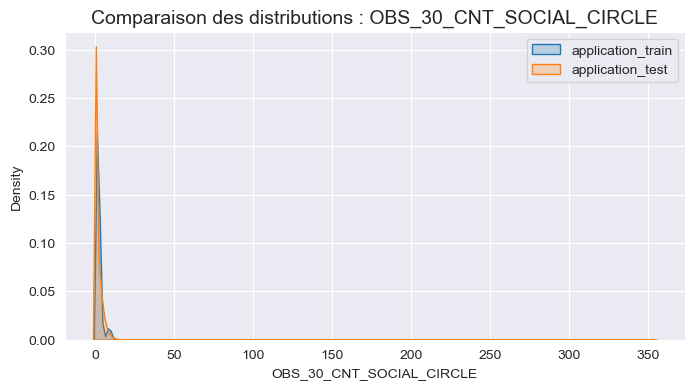

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




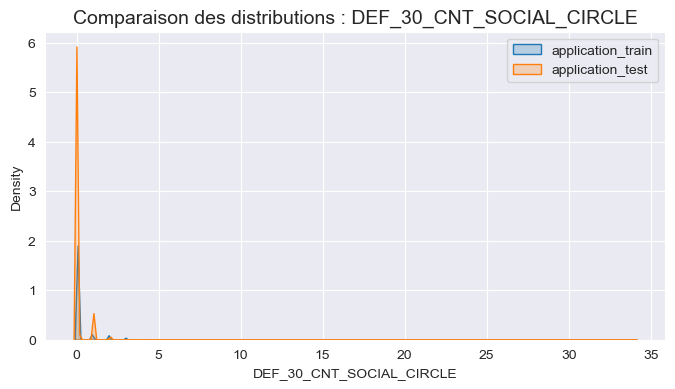

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




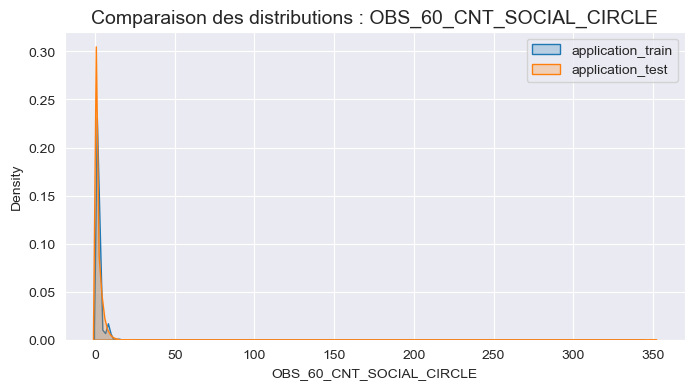

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




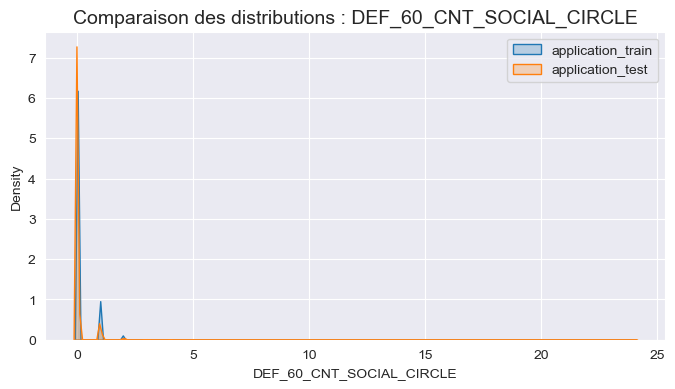

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




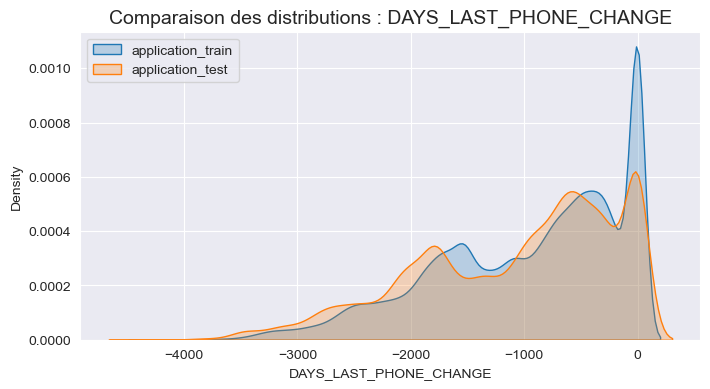

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



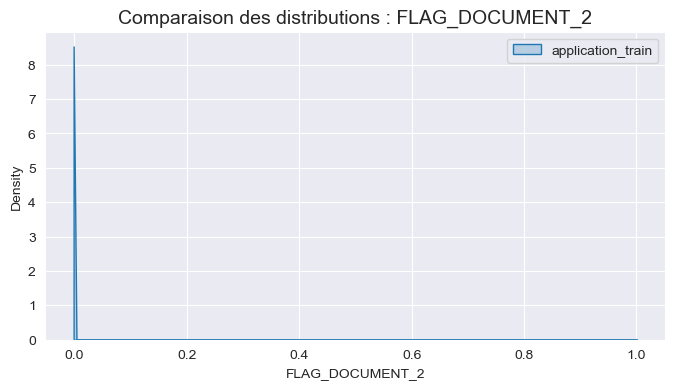

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




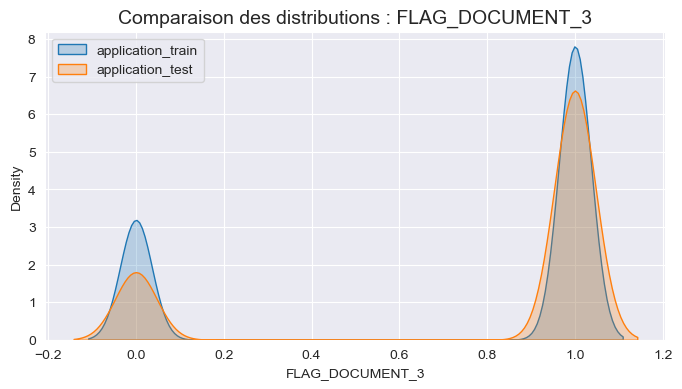

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




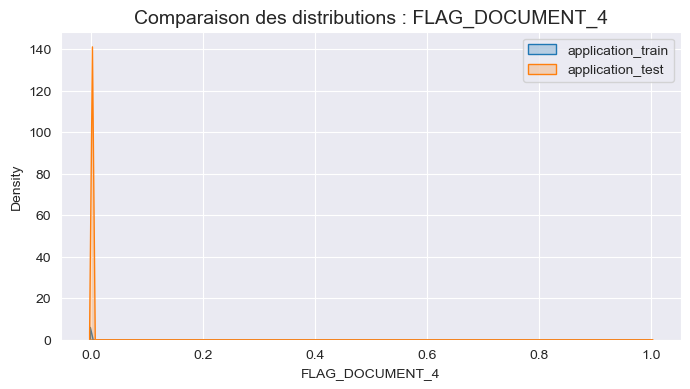

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




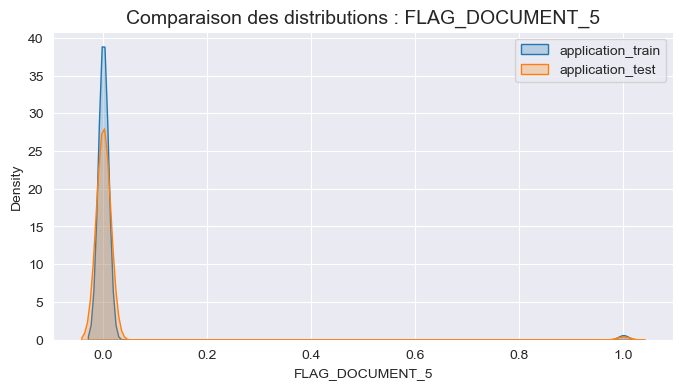

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




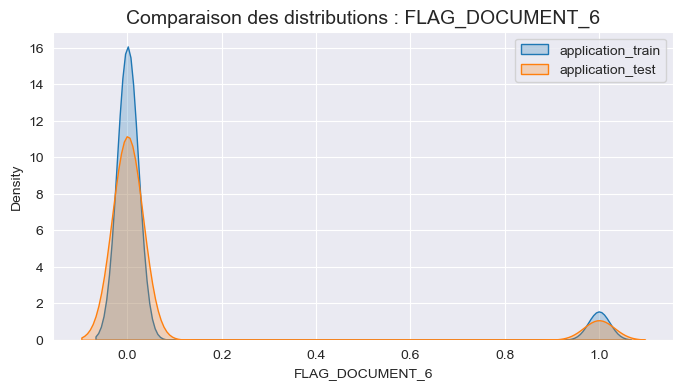

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




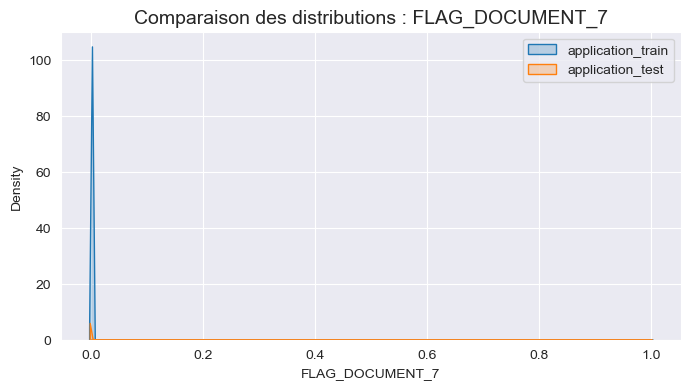

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




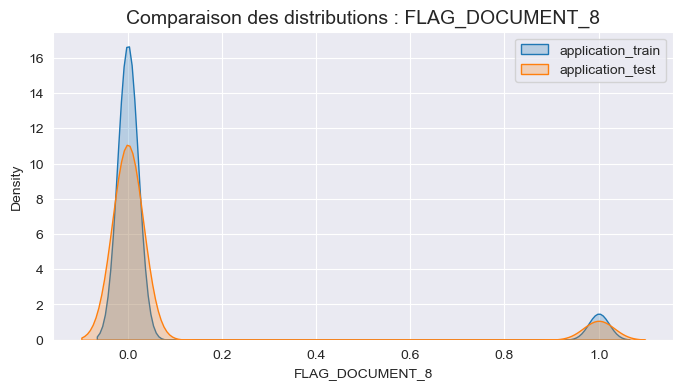

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




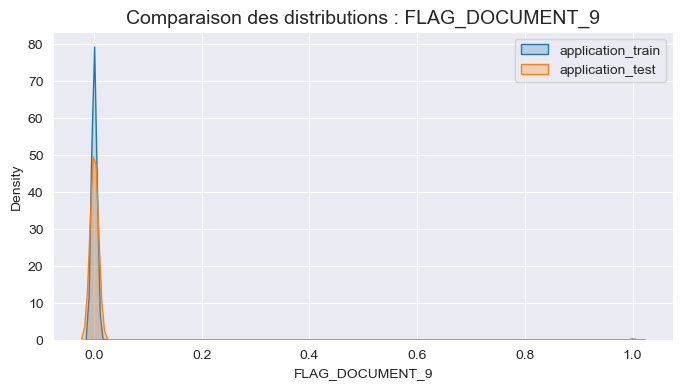

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



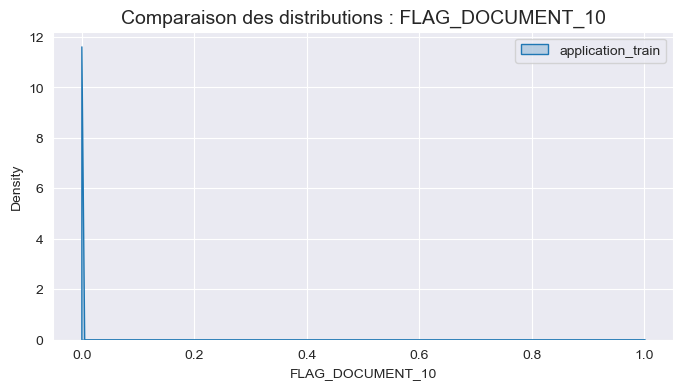

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




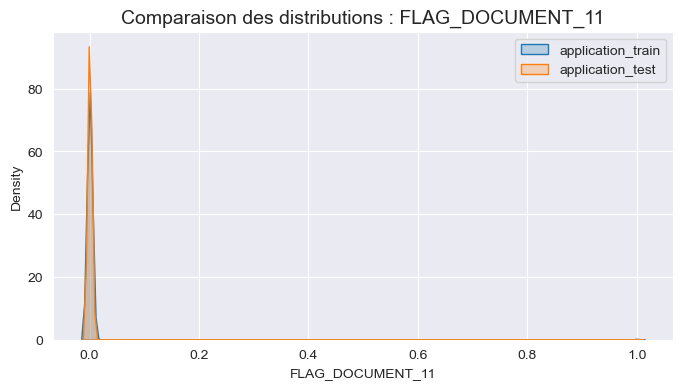

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



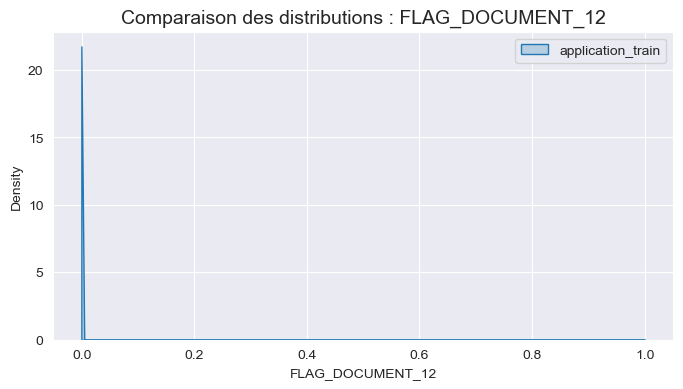

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



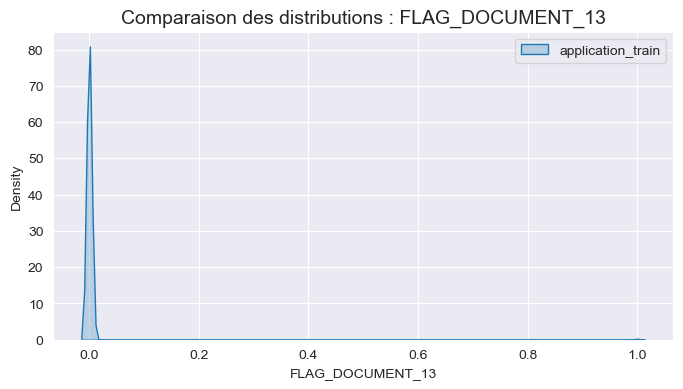

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



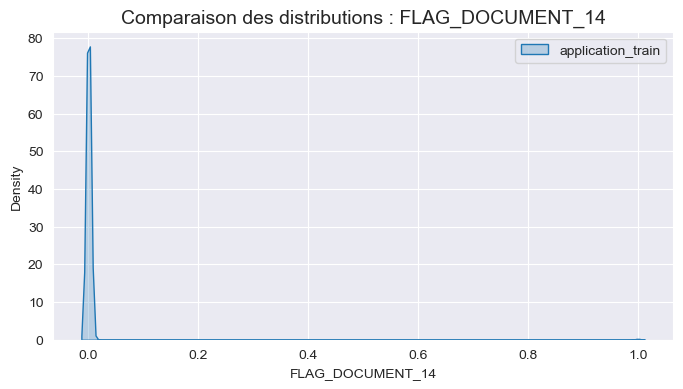

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



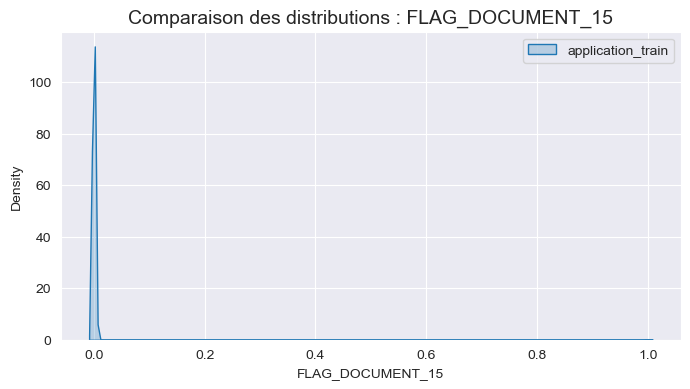

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



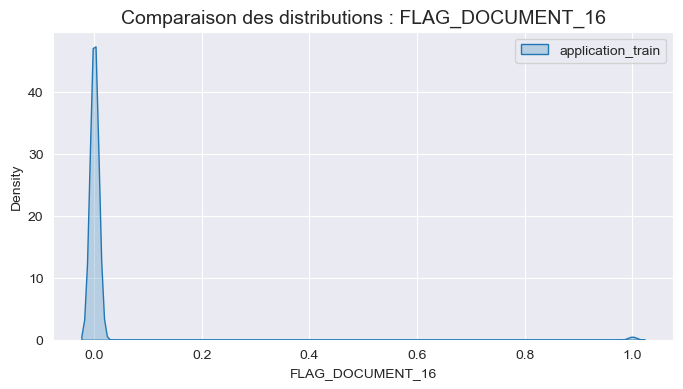

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



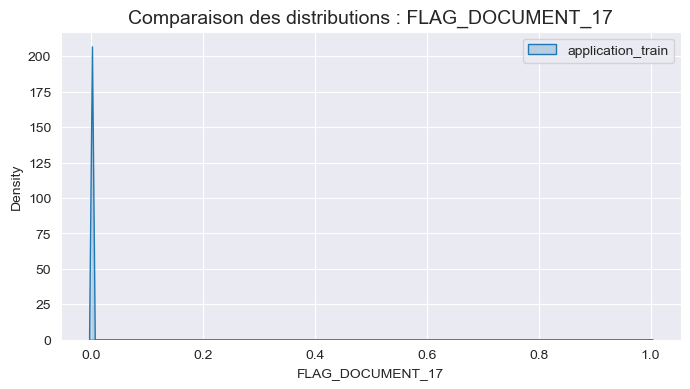

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




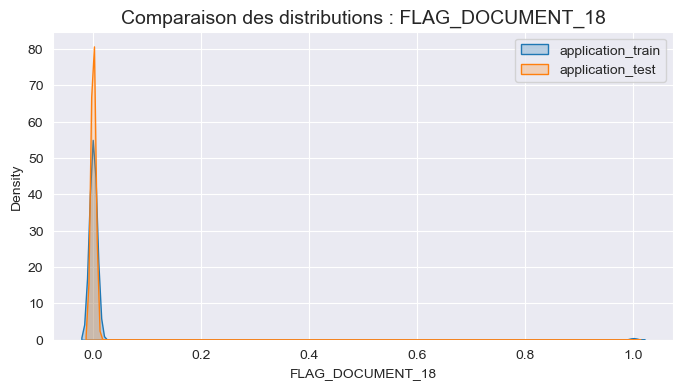

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



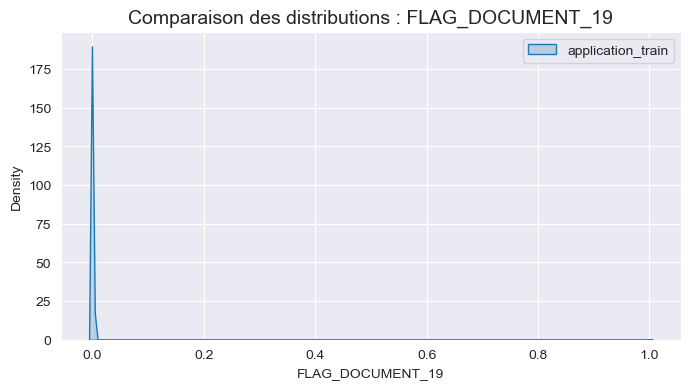

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



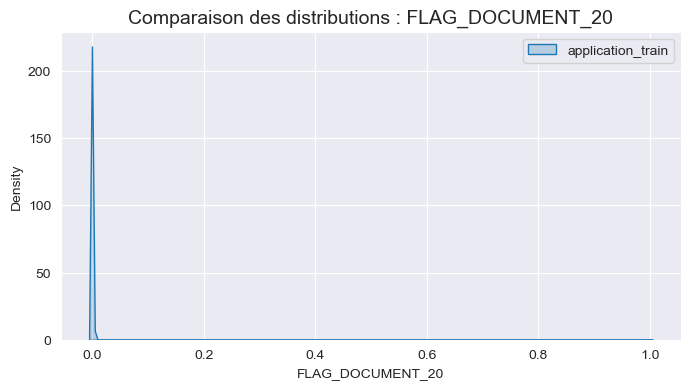

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



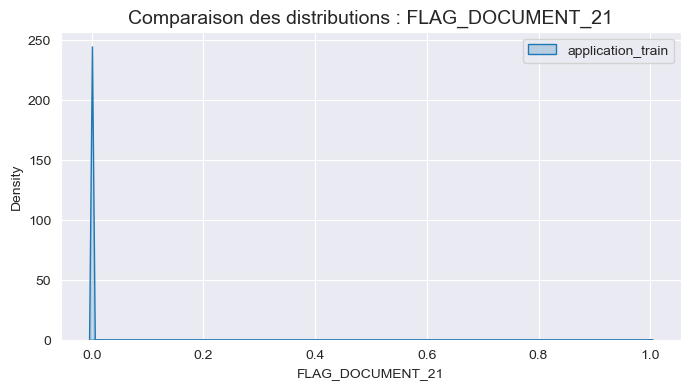

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




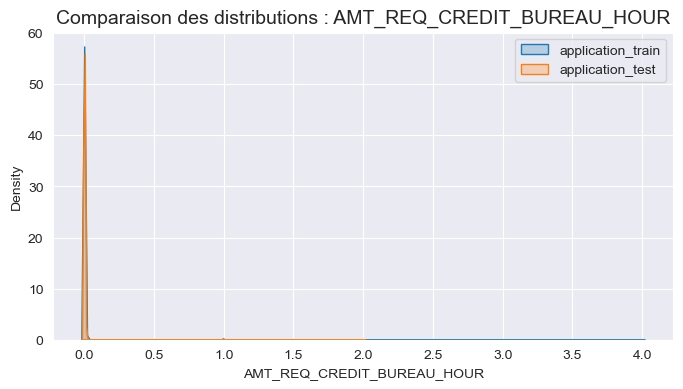

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




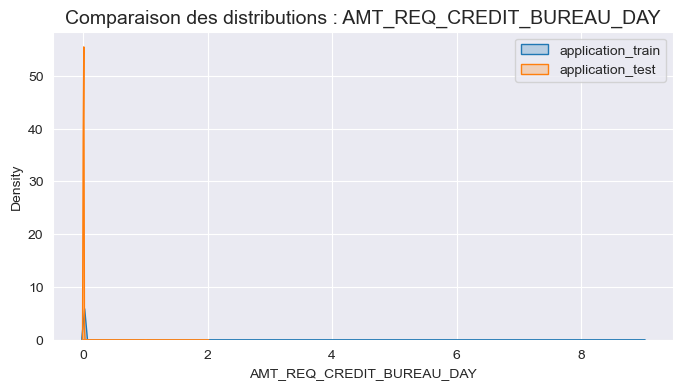

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




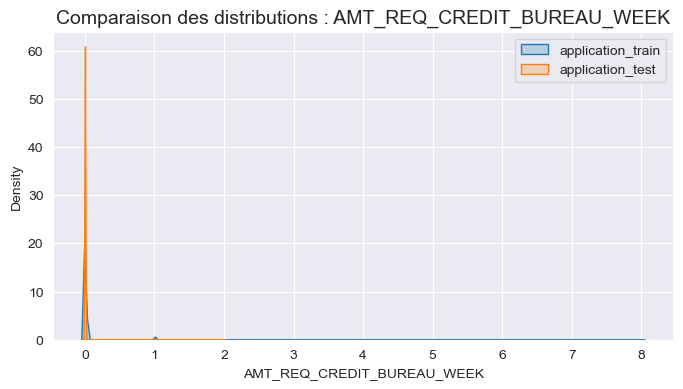

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




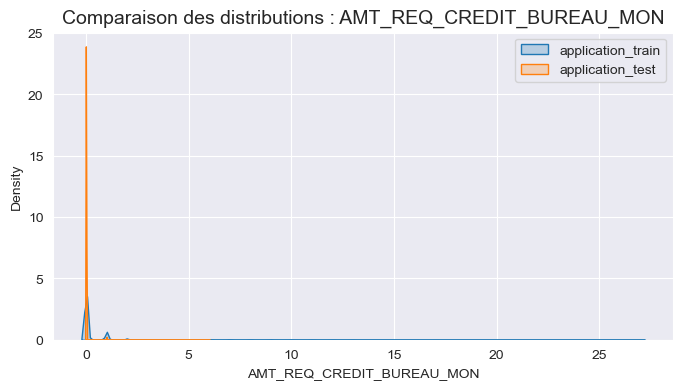

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




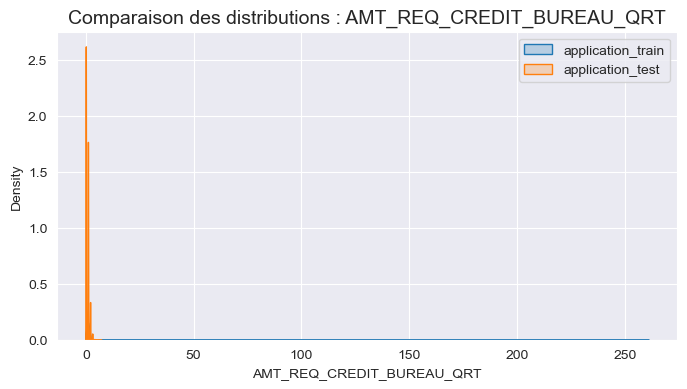

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:7: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3018212441.py:8: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




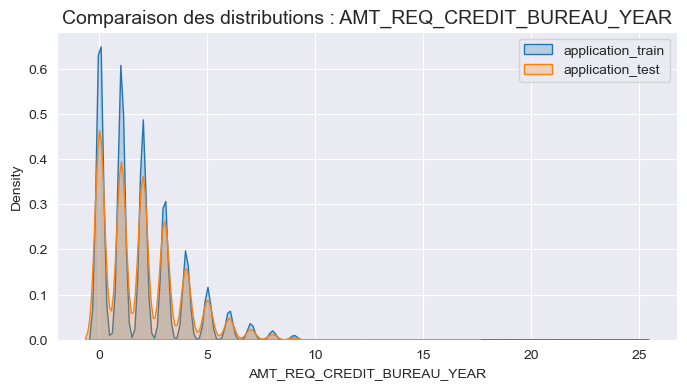

In [42]:
# Comparaison des distributions
common_cols = application_train.columns.intersection(application_test.columns)

for col in common_cols:
    if application_train[col].dtype in ["float64", "int64"]:
        plt.figure(figsize=(8, 4))
        sns.kdeplot(application_train[col], label="application_train", shade=True)
        sns.kdeplot(application_test[col], label="application_test", shade=True)
        plt.title(f"Comparaison des distributions : {col}", fontsize=14)
        plt.legend()
        plt.show()


 ## Analyse des variables catégoriques
* Compter les occurrences de chaque catégorie.
* Visualiser les répartitions des catégories.

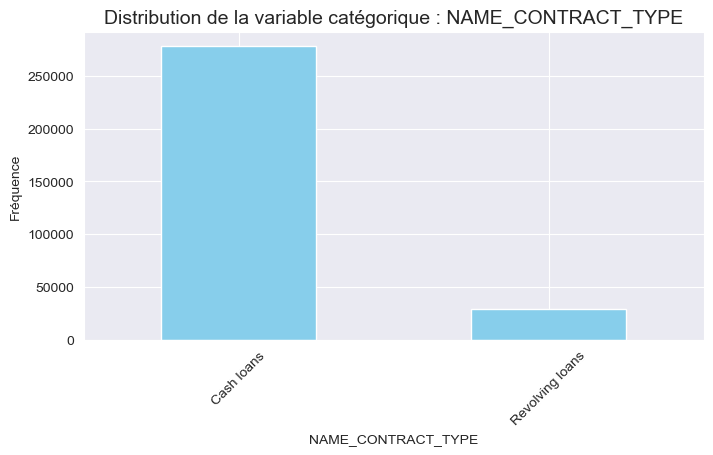

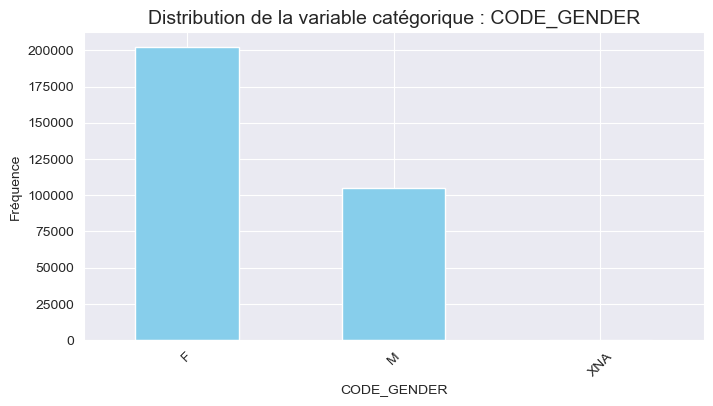

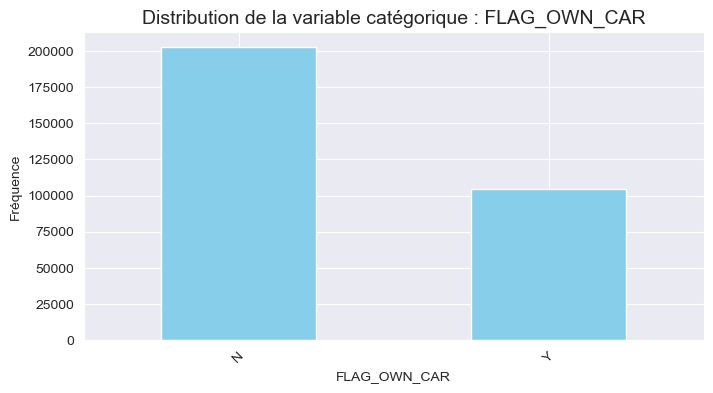

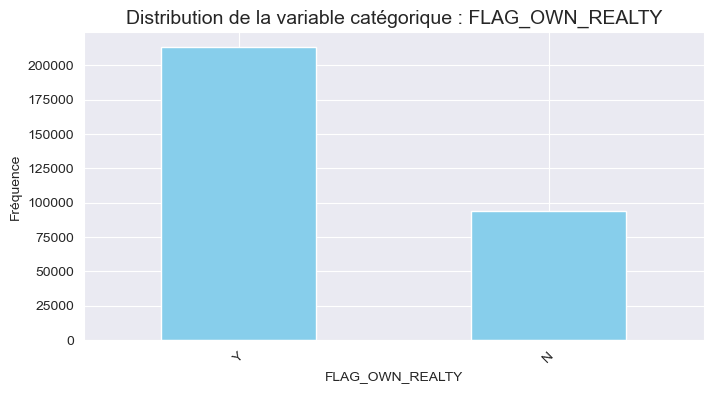

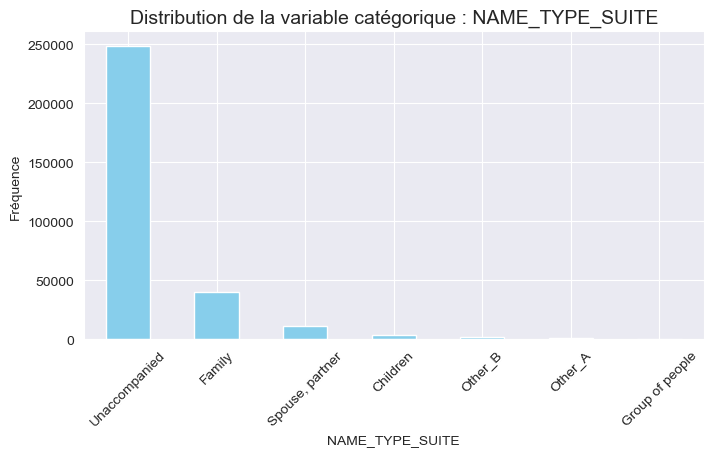

...

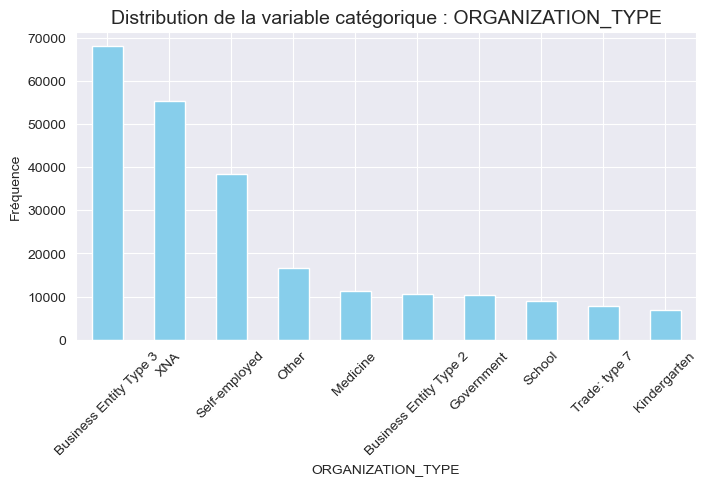

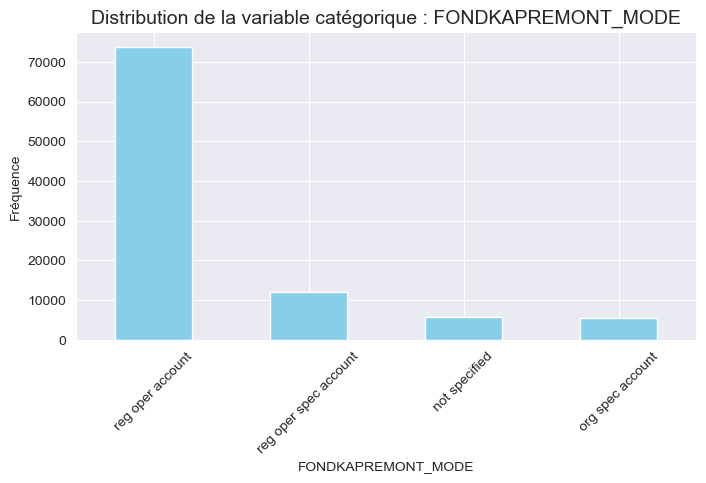

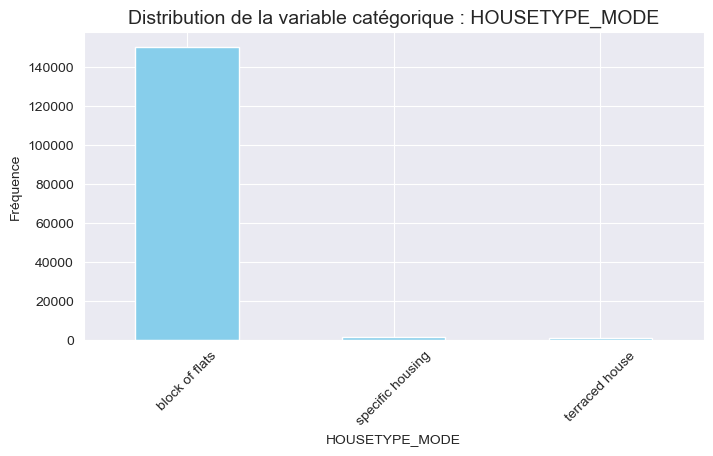

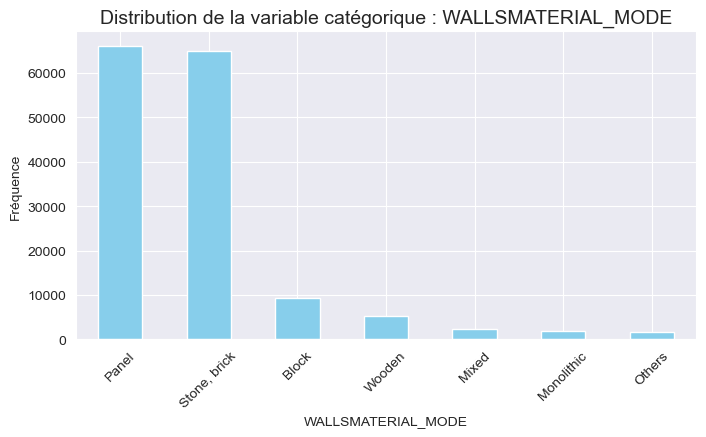

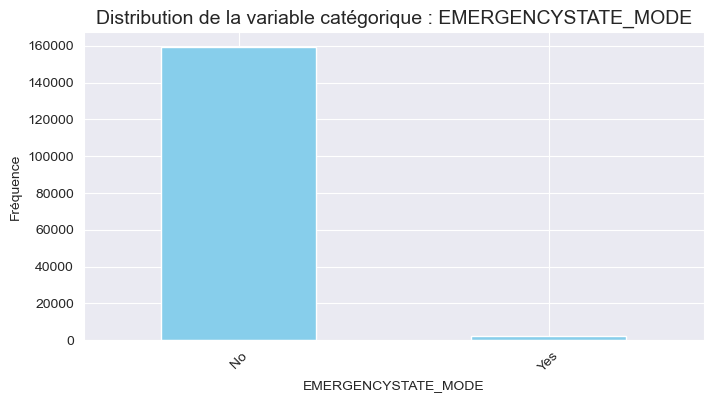

In [43]:
# Sélection des colonnes catégoriques
categorical_cols = application_train.select_dtypes(include=["object"]).columns

# Affichage des distributions
for col in categorical_cols:
    plt.figure(figsize=(8, 4))
    application_train[col].value_counts().head(10).plot(kind='bar', color="skyblue")
    plt.title(f"Distribution de la variable catégorique : {col}", fontsize=14)
    plt.ylabel("Fréquence")
    plt.xlabel(col)
    plt.xticks(rotation=45)
    plt.show()

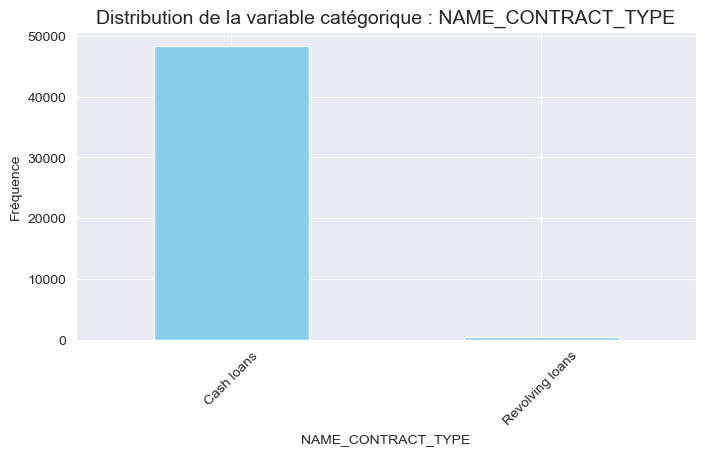

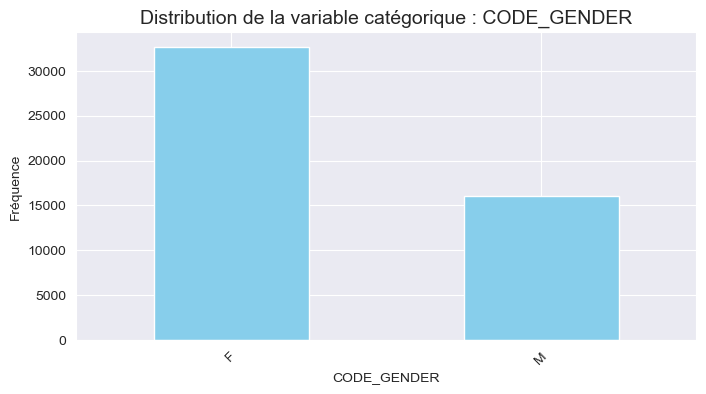

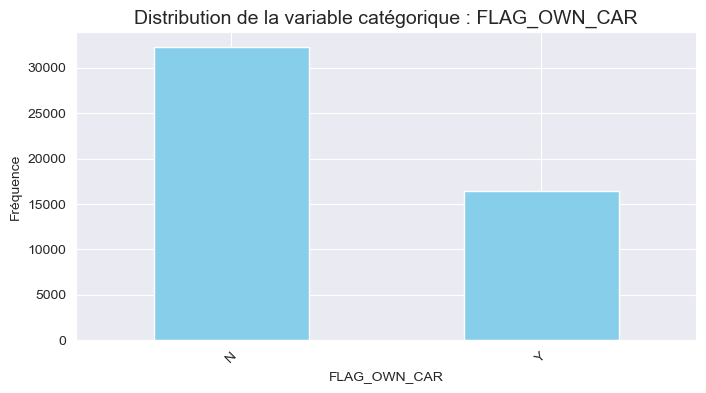

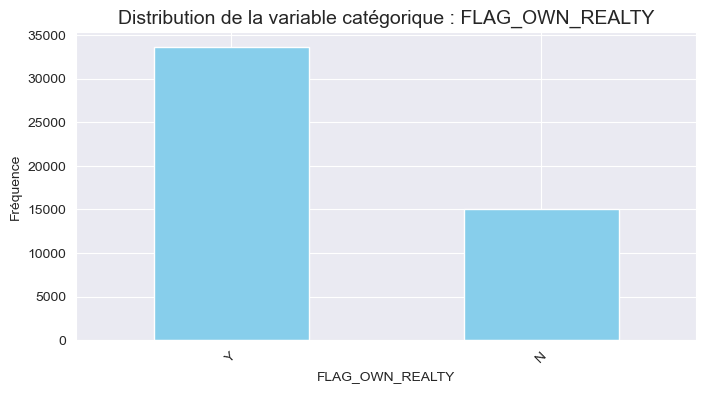

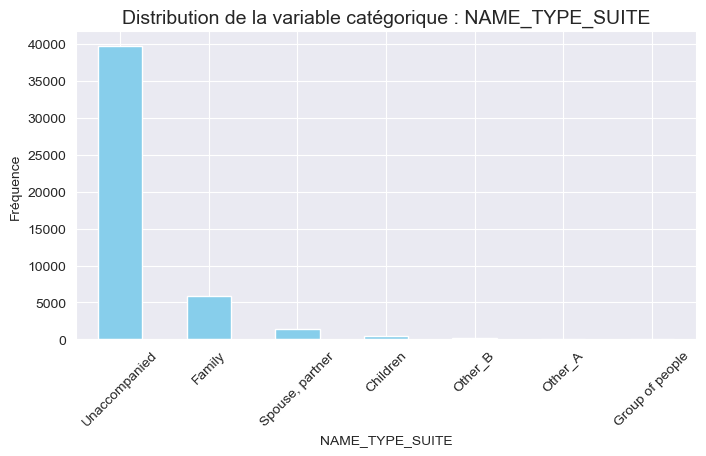

...

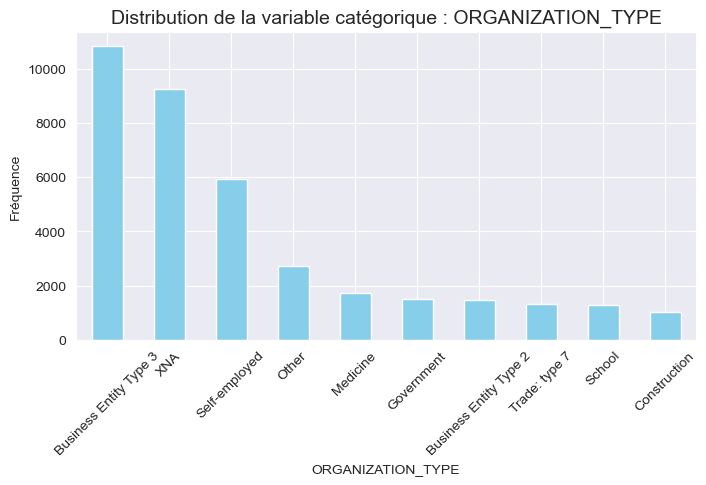

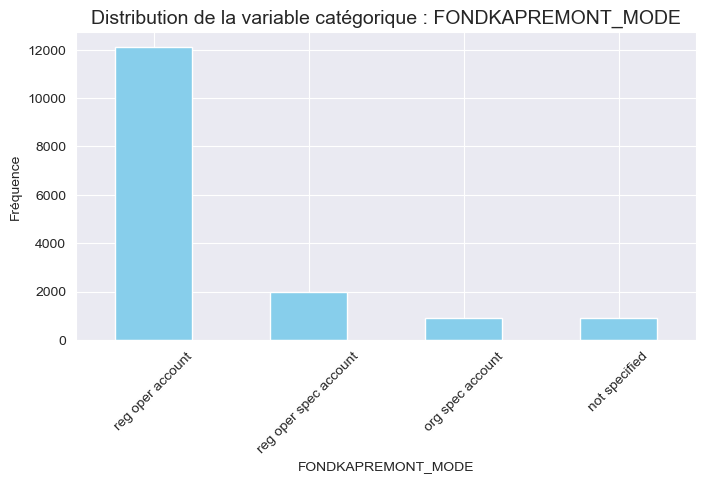

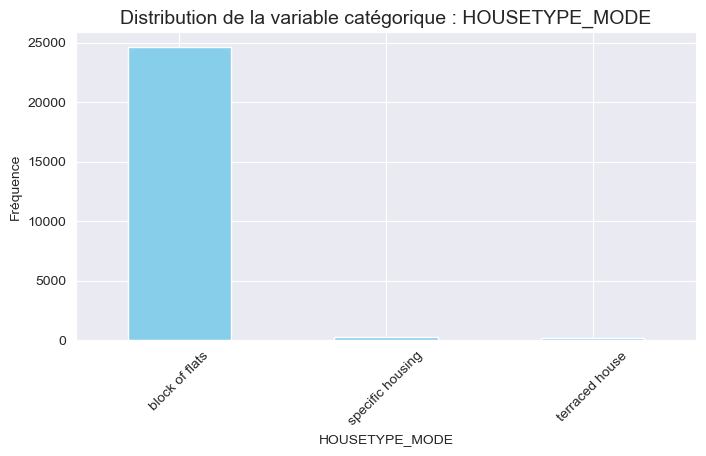

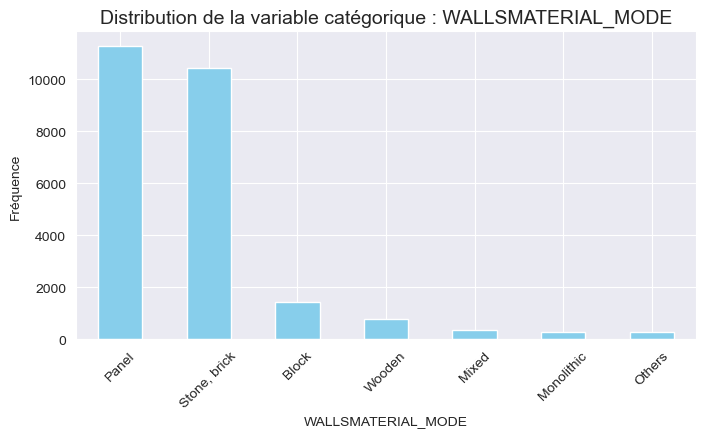

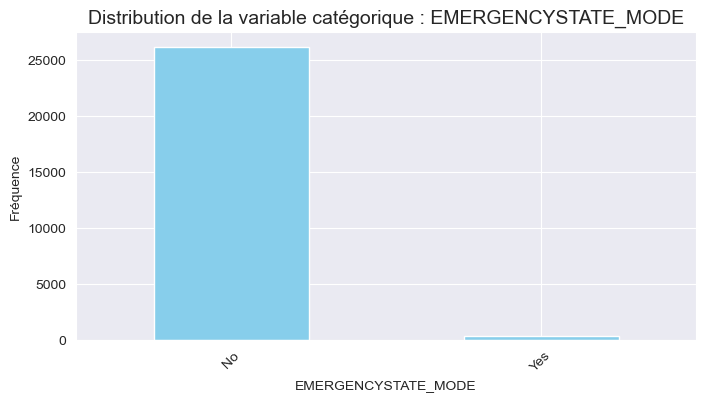

In [44]:
# Sélection des colonnes catégoriques
categorical_cols = application_test.select_dtypes(include=["object"]).columns

# Affichage des distributions
for col in categorical_cols:
    plt.figure(figsize=(8, 4))
    application_test[col].value_counts().head(10).plot(kind='bar', color="skyblue")
    plt.title(f"Distribution de la variable catégorique : {col}", fontsize=14)
    plt.ylabel("Fréquence")
    plt.xlabel(col)
    plt.xticks(rotation=45)
    plt.show()


## 2. Analyse des outliers (valeurs aberrantes)

Les valeurs aberrantes peuvent influencer les modèles de manière significative
   * Boîtes à moustaches pour repérer les valeurs extrêmes.
   * Suppression ou gestion des outliers identifiés.

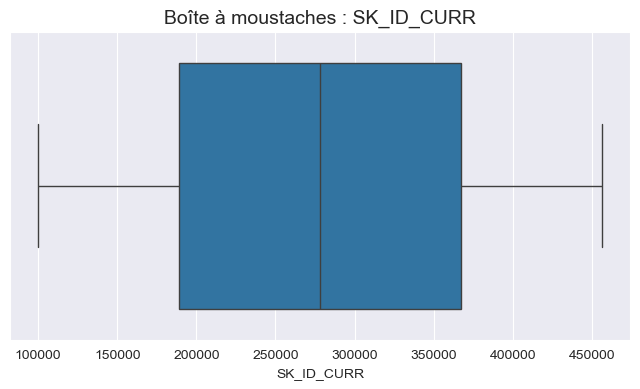

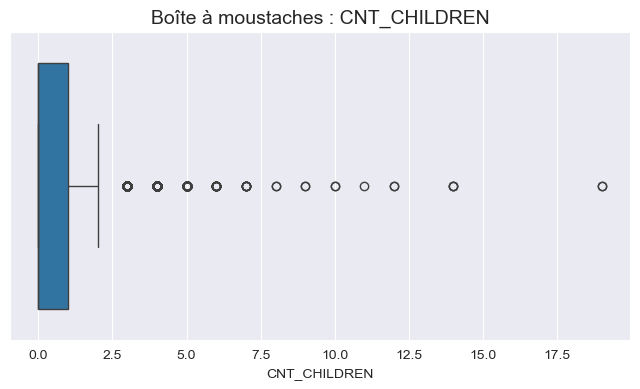

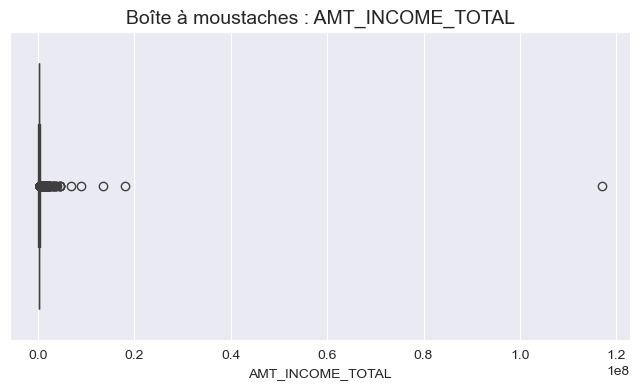

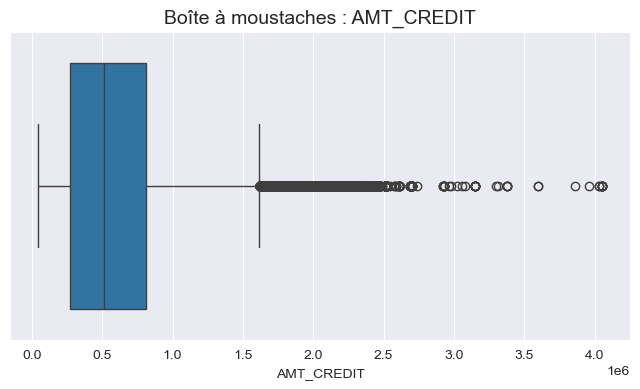

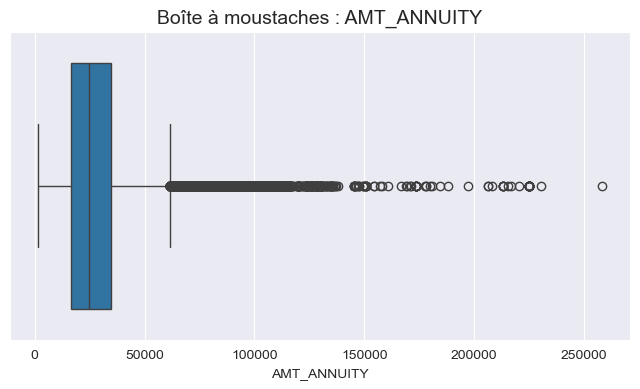

...

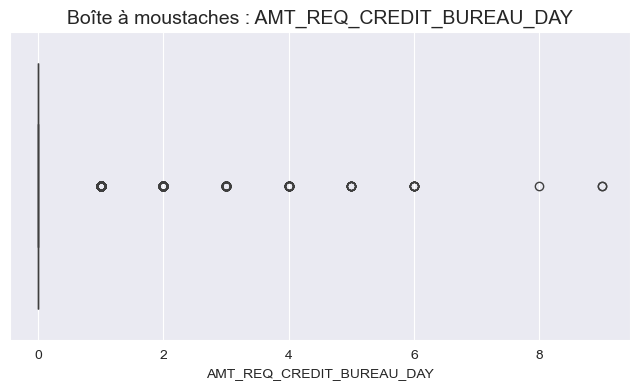

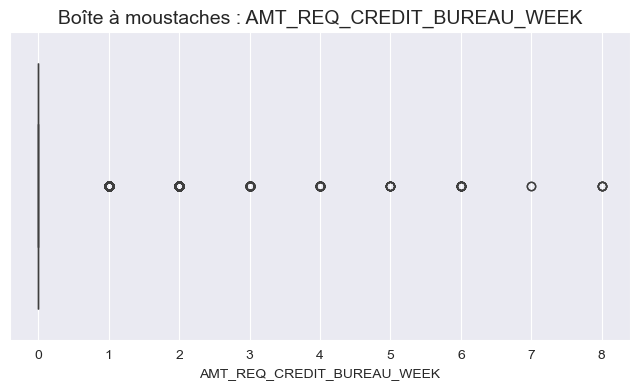

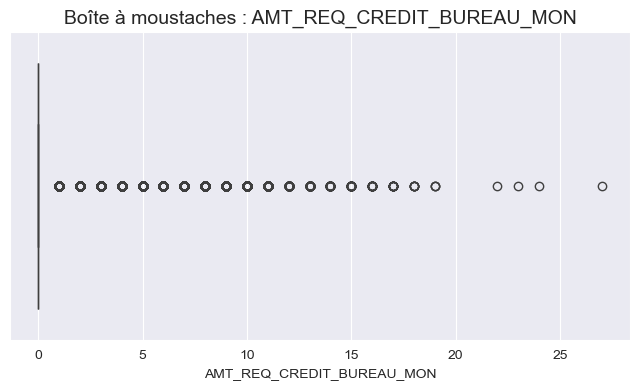

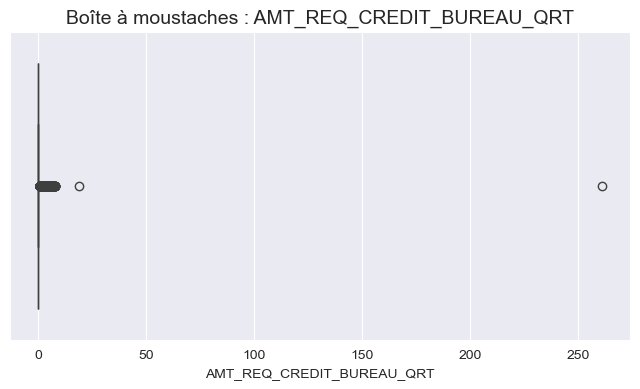

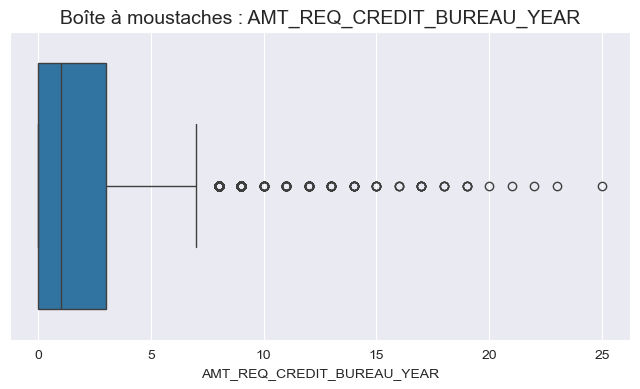

In [45]:
# Visualisation des outliers pour les variables numériques
for col in numeric_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=application_train[col])
    plt.title(f"Boîte à moustaches : {col}", fontsize=14)
    plt.show()


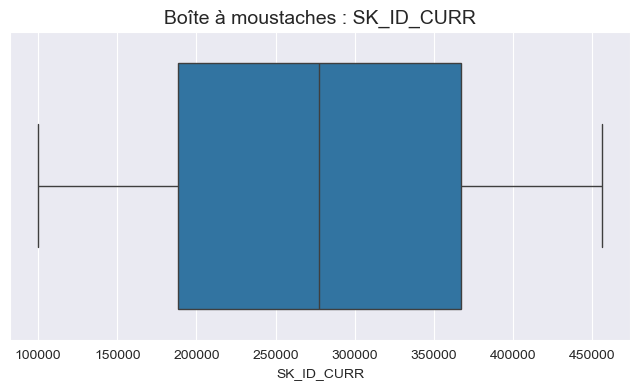

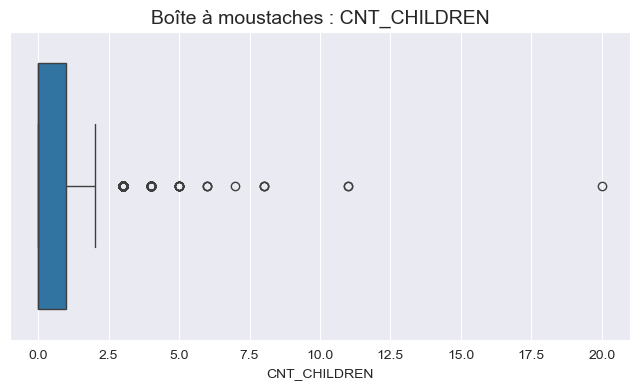

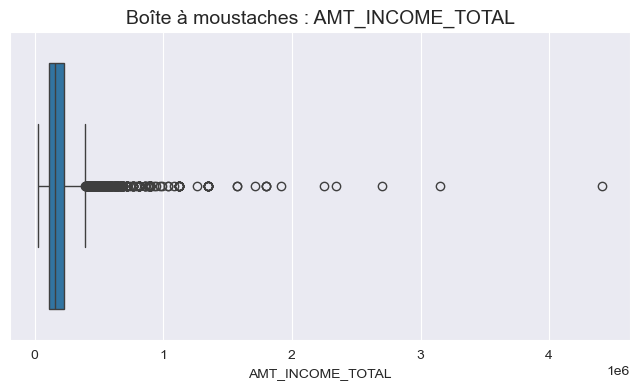

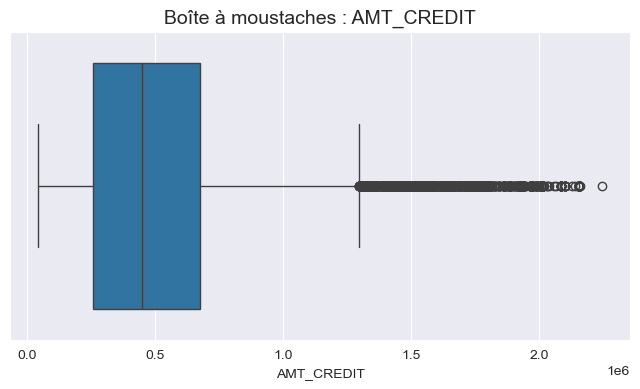

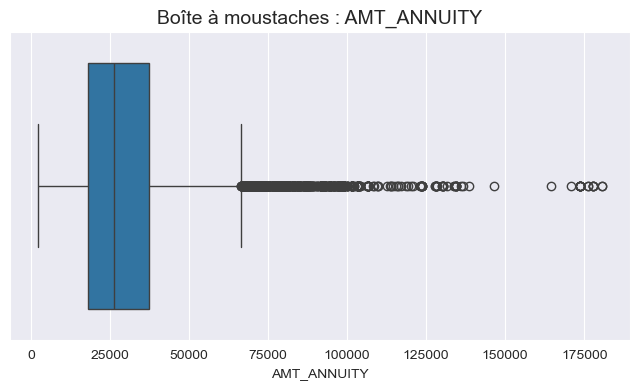

...

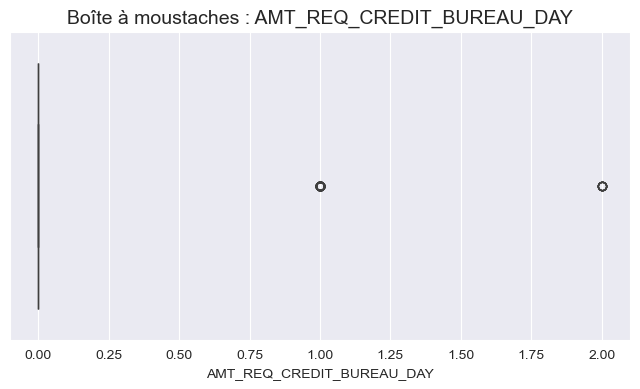

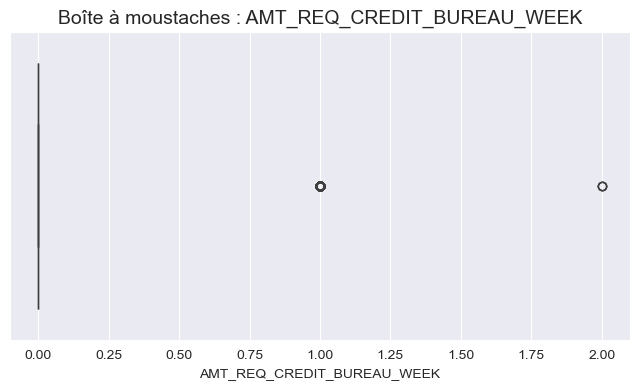

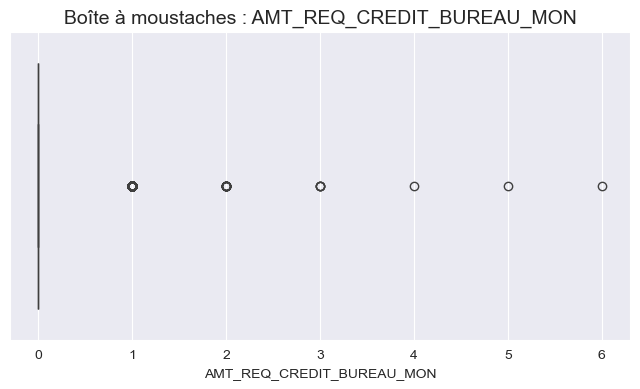

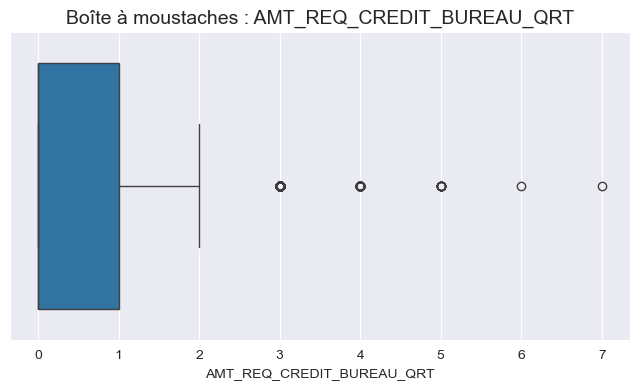

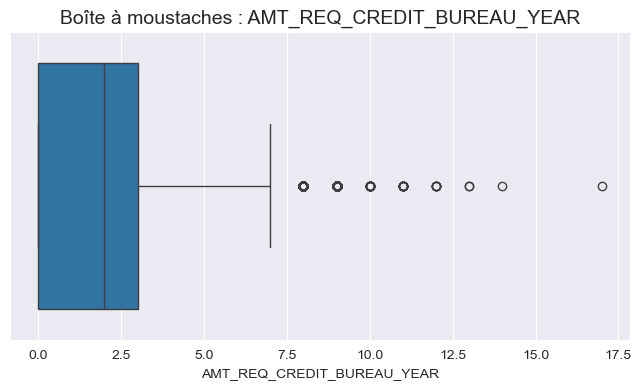

In [46]:
# Visualisation des outliers pour les variables numériques
for col in numeric_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=application_test[col])
    plt.title(f"Boîte à moustaches : {col}", fontsize=14)
    plt.show()

## Analyse de la cible TARGET

Pour mieux comprendre la cible, vous pouvez analyser :
*  La proportion des classes (0 ou 1) de TARGET.
* La répartition des variables en fonction de TARGET.

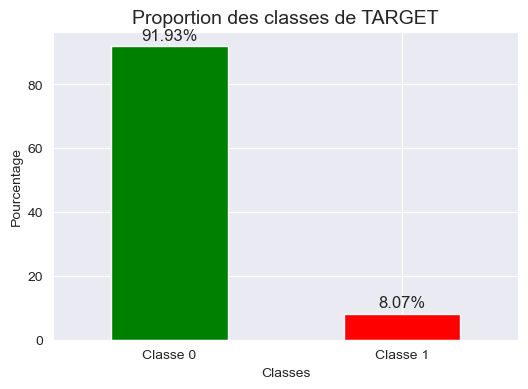

In [47]:
# Proportion des classes de TARGET
if "TARGET" in application_train.columns:
    target_counts = application_train["TARGET"].value_counts(normalize=True) * 100
    target_counts.plot(kind="bar", color=["green", "red"], figsize=(6, 4))
    
    # Affichage des pourcentages au-dessus des barres
    for i, count in enumerate(target_counts):
        plt.text(i, count + 2, f'{count:.2f}%', ha='center', fontsize=12)
    
    plt.title("Proportion des classes de TARGET", fontsize=14)
    plt.xlabel("Classes")
    plt.ylabel("Pourcentage")
    plt.xticks([0, 1], labels=["Classe 0", "Classe 1"], rotation=0)
    plt.show()


## Observations 
* Déséquilibre des classes : 8,07 % de prêts en défaut, 91,9 % non défaillants.
* La classe des non-défaillants est majoritaire.
* La précision n’est pas un bon indicateur ; il faut privilégier des métriques comme ROC-AUC, Log-Loss, F1-Score.
* Les anomalies doivent être prises en compte car elles peuvent différencier les défaillants des non-défaillants.

In [48]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def plot_categorical_variables_pie(data, column_name, plot_defaulter=True, hole=0):
    '''
    Fonction pour tracer des graphiques en secteurs (Pie Chart) pour les variables catégorielles.

    Paramètres :
        data: DataFrame
            Le DataFrame contenant les données à visualiser
        column_name: str
            Le nom de la colonne à visualiser
        plot_defaulter: bool, par défaut True
            Si True, génère un graphique supplémentaire pour les défaillants
        hole: int, par défaut 0
            Rayon du trou central pour créer un graphique en donut
    '''
    
    # Définir la disposition du graphique (un ou deux graphiques)
    if plot_defaulter:
        cols = 2
        specs = [[{'type' : 'domain'}, {'type' : 'domain'}]]
        titles = [f'Distribution de {column_name} pour tous les cibles', f'Pourcentage de défaillants par catégorie de {column_name}']
    else:
        cols = 1
        specs = [[{'type': 'domain'}]]
        titles = [f'Distribution de {column_name} pour tous les cibles']
        
    # Compter la fréquence des catégories dans la colonne spécifiée
    values_categorical = data[column_name].value_counts()
    labels_categorical = values_categorical.index
    
    # Créer une figure avec plusieurs sous-graphiques (1 ou 2)
    fig = make_subplots(rows=1, cols=cols, specs=specs, subplot_titles=titles)
    
    # Ajouter le premier graphique (distribution générale)
    fig.add_trace(go.Pie(values=values_categorical, labels=labels_categorical, hole=hole, 
                         textinfo='label+percent', textposition='inside'), row=1, col=1)
    
    # Si 'plot_defaulter' est activé, ajouter un graphique pour les défaillants
    if plot_defaulter:
        percentage_defaulter_per_category = data[column_name][data.TARGET == 1].value_counts() * 100 / data[column_name].value_counts()
        percentage_defaulter_per_category.dropna(inplace=True)  # Supprimer les valeurs manquantes
        percentage_defaulter_per_category = percentage_defaulter_per_category.round(2)  # Arrondir à deux décimales
        
        # Ajouter le graphique des défaillants
        fig.add_trace(go.Pie(values=percentage_defaulter_per_category, labels=percentage_defaulter_per_category.index, 
                             hole=hole, textinfo='label+value', hoverinfo='label+value'), row=1, col=2)
        
    # Mise en page du graphique
    fig.update_layout(title=f'Distribution de {column_name}')
    
    # Afficher le graphique
    fig.show()


## Observations et Conclusions :

   * Premier sous-graphe (distribution générale) :
        La majorité des prêts contractés par les clients sont des prêts en espèces (Cash Loans).
        Seulement 9,52% des clients ont contracté des prêts renouvelables (Revolving Loans).

   * Deuxième sous-graphe (pourcentage de défaillants) :
        Un pourcentage plus élevé de clients ayant contracté des prêts en espèces a fait défaut (8,35%) comparé à ceux ayant contracté des prêts renouvelables (5,48%).

* Distribution de la variable catégorielle CODE_GENDER :

    Cette colonne contient des informations sur le genre des clients : M pour homme et F pour femme.

Les catégories uniques de 'CODE_GENDER' sont :
CODE_GENDER
F      202448
M      105059
XNA         4
Name: count, dtype: int64


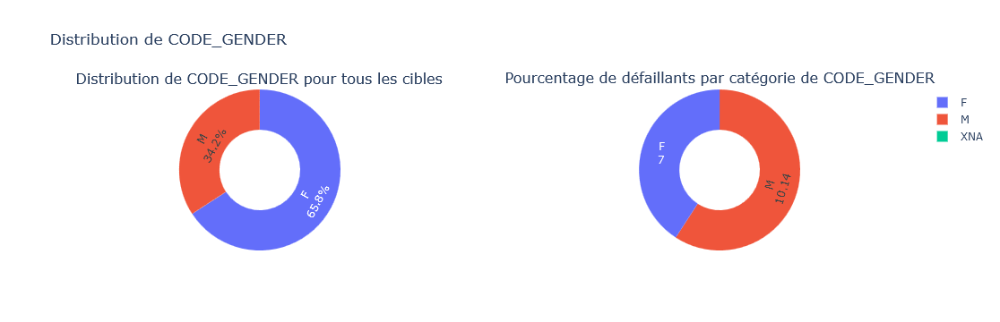

----------------------------------------------------------------------------------------------------


In [50]:
# Définir la fonction pour afficher les catégories uniques et leur comptage
def print_unique_categories(data, column_name, show_counts=True):
    """
    Affiche les catégories uniques d'une colonne avec leur comptage (si demandé).
    
    Paramètres :
        data : DataFrame
            Le DataFrame contenant les données
        column_name : str
            Le nom de la colonne pour laquelle on veut voir les catégories uniques
        show_counts : bool
            Si True, affiche également le comptage des catégories
    """
    unique_values = data[column_name].value_counts()
    print(f"Les catégories uniques de '{column_name}' sont :")
    print(unique_values if show_counts else unique_values.index)

# Afficher les catégories uniques et leur comptage pour 'CODE_GENDER'
print_unique_categories(application_train, 'CODE_GENDER', show_counts=True)

# Tracer le graphique en secteurs (Pie Plot) pour 'CODE_GENDER'
plot_categorical_variables_pie(application_train, 'CODE_GENDER', hole=0.5)

# Affichage d'une ligne de séparation
print('-'*100)


Les catégories uniques de 'NAME_CONTRACT_TYPE' sont :
NAME_CONTRACT_TYPE
Cash loans         278232
Revolving loans     29279
Name: count, dtype: int64


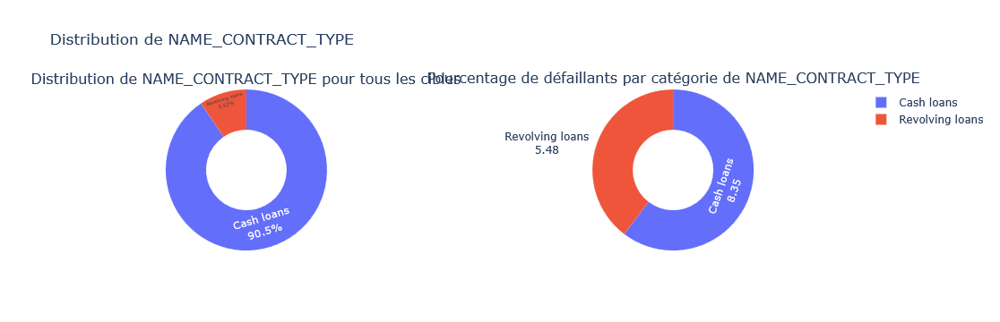

----------------------------------------------------------------------------------------------------


In [51]:
#afficher les catégories uniques de 'NAME_CONTRACT_TYPE'
print_unique_categories(application_train, 'NAME_CONTRACT_TYPE')

#plotting the Pie Plot for the column
plot_categorical_variables_pie(application_train, 'NAME_CONTRACT_TYPE', hole = 0.5)
print('-'*100)

In [52]:
import matplotlib.pyplot as plt
import seaborn as sns

# Définir la fonction pour tracer un graphique en barres pour les variables catégorielles
def plot_categorical_variables_bar(data, column_name, rotation=0, horizontal_adjust=0):
    """
    Fonction pour tracer un graphique en barres pour une variable catégorielle.

    Paramètres:
        data : DataFrame
            Le DataFrame contenant les données à visualiser.
        column_name : str
            Le nom de la colonne catégorielle à analyser.
        rotation : int, par défaut 0
            L'angle de rotation des étiquettes sur l'axe x.
        horizontal_adjust : float, par défaut 0
            Ajuste l'espacement horizontal des étiquettes (utile si elles se chevauchent).
    """
    # Compter les valeurs uniques de la colonne
    value_counts = data[column_name].value_counts()

    # Tracer le graphique en barres
    plt.figure(figsize=(10, 6))  # Définir la taille de la figure
    sns.barplot(x=value_counts.index, y=value_counts.values, palette="Set2")  # Créer un graphique en barres

    # Appliquer la rotation et ajuster l'alignement des étiquettes
    plt.xticks(rotation=rotation, ha="right")
    plt.subplots_adjust(bottom=horizontal_adjust)  # Ajuster l'espacement horizontal des étiquettes

    # Ajouter un titre et des labels
    plt.title(f'Distribution des valeurs pour {column_name}')
    plt.xlabel(column_name)
    plt.ylabel('Fréquence')

    # Afficher le graphique
    plt.show()


# Phi-K Matrix :

   * Le coefficient de corrélation Phi-K mesure l'association entre deux variables catégorielles.
   * Il est similaire au coefficient de corrélation classique, mais spécifiquement pour les variables catégorielles.
   * La valeur maximale est de 1, indiquant une association maximale entre les deux variables.
   * Une heatmap permet de visualiser cette association entre chaque paire de caractéristiques.

interval columns not set, guessing: ['TARGET', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9', 'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']


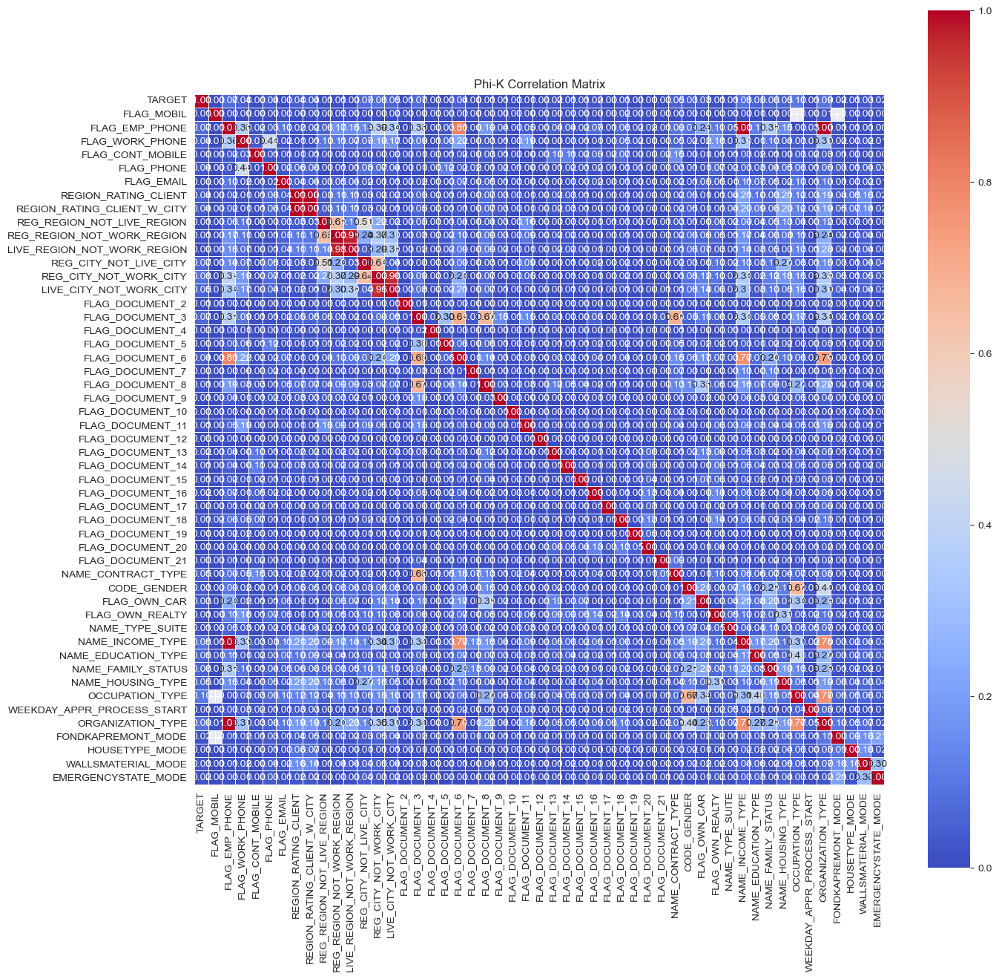

In [53]:
import phik
from phik import phik_matrix
import matplotlib.pyplot as plt

# Définir les colonnes catégorielles
categorical_columns = ['TARGET', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 
                       'FLAG_PHONE', 'FLAG_EMAIL', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 
                       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 
                       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY'] + \
                       ['FLAG_DOCUMENT_' + str(i) for i in range(2, 22)] + \
                       application_train.dtypes[application_train.dtypes == 'object'].index.tolist()

# Calculer la matrice Phi-K
phik_matrix_df = application_train[categorical_columns].phik_matrix()

# Afficher la heatmap
plt.figure(figsize=(15, 15))
plt.title("Phi-K Correlation Matrix")
sns.heatmap(phik_matrix_df, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, square=True, linewidths=0.5)
plt.show()

In [54]:
# Calculer la matrice Phi-K
phik_matrix_df = application_train[categorical_columns].phik_matrix()

# Masquer les valeurs égales à 1 (corrélation avec soi-même)
phik_matrix_df = phik_matrix_df.where(np.triu(np.ones(phik_matrix_df.shape), k=1).astype(bool))

# les variables les plus corrélées positivement et négativement
positive_corr = phik_matrix_df.stack().sort_values(ascending=False).head(10)
negative_corr = phik_matrix_df.stack().sort_values(ascending=True).head(10)

# Afficher les résultats
print("Top 10 des corrélations positives :")
print(positive_corr)

print("\n")  # Séparation de ligne
print("Top 10 des corrélations négatives :")
print(negative_corr)

interval columns not set, guessing: ['TARGET', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9', 'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']
Top 10 des corrélations positives :
FLAG_EMP_PHONE              ORGANIZATION_TYPE              1.000000
                            NAME_INCOME_TYPE               1.000000
REGION_RATING_CLIENT        REGION_RATING_CLIENT_W_CITY    0.9987

In [55]:
# Calcul de la matrice Phi-K
phik_matrix_df = application_train[categorical_columns].phik_matrix()

# Masquer les valeurs égales à 1 (corrélation avec soi-même)
phik_matrix_df = phik_matrix_df.where(np.triu(np.ones(phik_matrix_df.shape), k=1).astype(bool))

# Extraire les paires de variables avec une forte corrélation (par exemple, >= 0.8)
strong_corr_df = phik_matrix_df[phik_matrix_df >= 0.8].stack().reset_index()

# Renommer les colonnes pour plus de clarté
strong_corr_df.columns = ['Variable 1', 'Variable 2', 'Phi-K Correlation']

# Afficher le tableau des corrélations fortes
print(strong_corr_df)

interval columns not set, guessing: ['TARGET', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9', 'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']
                   Variable 1                   Variable 2  Phi-K Correlation
0              FLAG_EMP_PHONE              FLAG_DOCUMENT_6           0.806903
1              FLAG_EMP_PHONE             NAME_INCOME_TYPE           1.000000
2  

## Interprétation des résultats :

    - Corrélations positives :
* Plusieurs variables montrent une forte association, notamment FLAG_EMP_PHONE, ORGANIZATION_TYPE, et NAME_INCOME_TYPE, toutes ayant des corrélations proches de 1. Cela suggère que ces caractéristiques sont fortement liées et que leur combinaison peut fournir des informations similaires.
* REGION_RATING_CLIENT et REGION_RATING_CLIENT_W_CITY sont également fortement corrélées (0.9987), ce qui indique une relation étroite entre la note régionale et la présence en ville.

Variables les plus corrélées positivement avec TARGET :
TARGET                         1.000000
DAYS_BIRTH                     0.078239
REGION_RATING_CLIENT_W_CITY    0.060893
REGION_RATING_CLIENT           0.058899
DAYS_LAST_PHONE_CHANGE         0.055218
DAYS_ID_PUBLISH                0.051457
REG_CITY_NOT_WORK_CITY         0.050994
FLAG_EMP_PHONE                 0.045982
REG_CITY_NOT_LIVE_CITY         0.044395
FLAG_DOCUMENT_3                0.044346
Name: TARGET, dtype: float64

Variables les plus corrélées négativement avec TARGET :
ELEVATORS_AVG                -0.034199
REGION_POPULATION_RELATIVE   -0.037227
AMT_GOODS_PRICE              -0.039645
FLOORSMAX_MODE               -0.043226
FLOORSMAX_MEDI               -0.043768
FLOORSMAX_AVG                -0.044003
DAYS_EMPLOYED                -0.044932
EXT_SOURCE_1                 -0.155317
EXT_SOURCE_2                 -0.160472
EXT_SOURCE_3                 -0.178919
Name: TARGET, dtype: float64


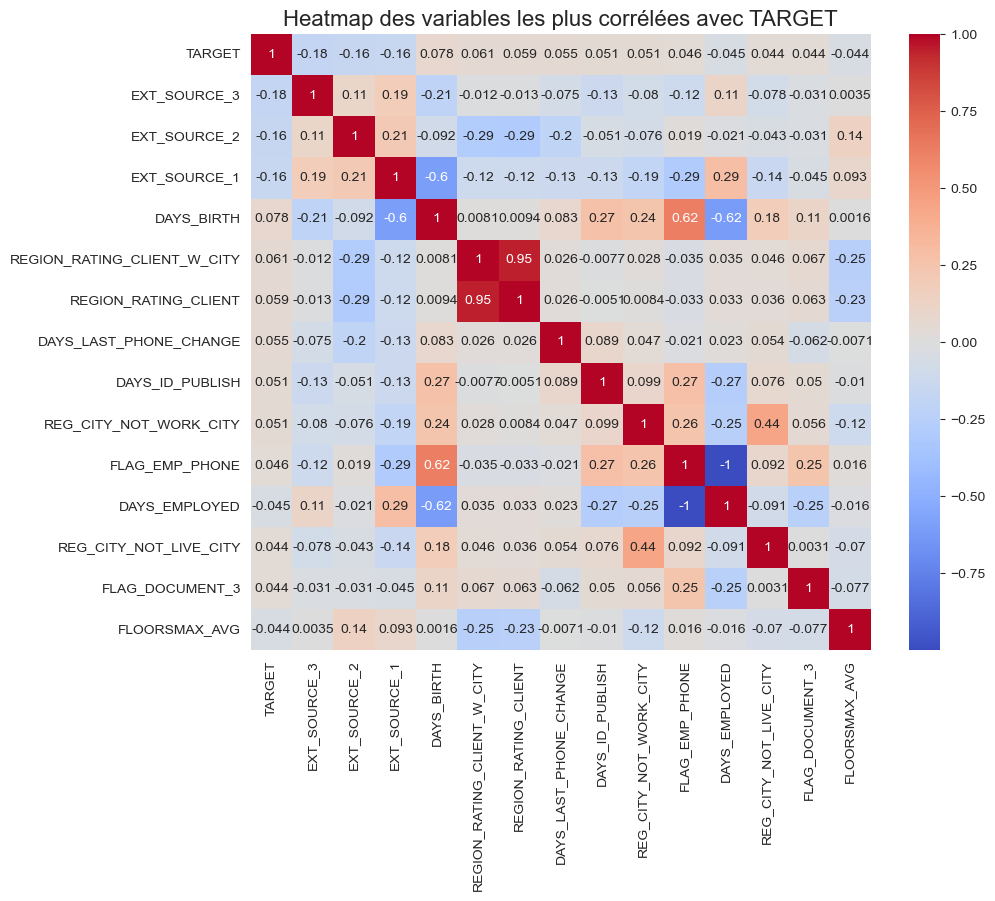

In [56]:
# Filtrage des colonnes numériques
numeric_cols = application_train.select_dtypes(include=["float64", "int64"]).columns

# Calcul de la corrélation avec TARGET
if "TARGET" in application_train.columns:
    correlations = application_train[numeric_cols].corr()["TARGET"].sort_values(ascending=False)
    
    print("Variables les plus corrélées positivement avec TARGET :")
    print(correlations.head(10))
    
    print("\nVariables les plus corrélées négativement avec TARGET :")
    print(correlations.tail(10))

    # Heatmap des corrélations les plus significatives
    top_corr_features = correlations.abs().sort_values(ascending=False).head(15).index
    plt.figure(figsize=(10, 8))
    sns.heatmap(application_train[top_corr_features].corr(), annot=True, cmap="coolwarm")
    plt.title("Heatmap des variables les plus corrélées avec TARGET", fontsize=16)
    plt.show()



### Exploration de bureau ###

Informations sur le dataset bureau:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_CURR              int64  
 1   SK_ID_BUREAU            int64  
 2   CREDIT_ACTIVE           object 
 3   CREDIT_CURRENCY         object 
 4   DAYS_CREDIT             int64  
 5   CREDIT_DAY_OVERDUE      int64  
 6   DAYS_CREDIT_ENDDATE     float64
 7   DAYS_ENDDATE_FACT       float64
 8   AMT_CREDIT_MAX_OVERDUE  float64
 9   CNT_CREDIT_PROLONG      int64  
 10  AMT_CREDIT_SUM          float64
 11  AMT_CREDIT_SUM_DEBT     float64
 12  AMT_CREDIT_SUM_LIMIT    float64
 13  AMT_CREDIT_SUM_OVERDUE  float64
 14  CREDIT_TYPE             object 
 15  DAYS_CREDIT_UPDATE      int64  
 16  AMT_ANNUITY             float64
dtypes: float64(8), int64(6), object(3)
memory usage: 222.6+ MB
None

Descriptif statistique du dataset bureau:
    

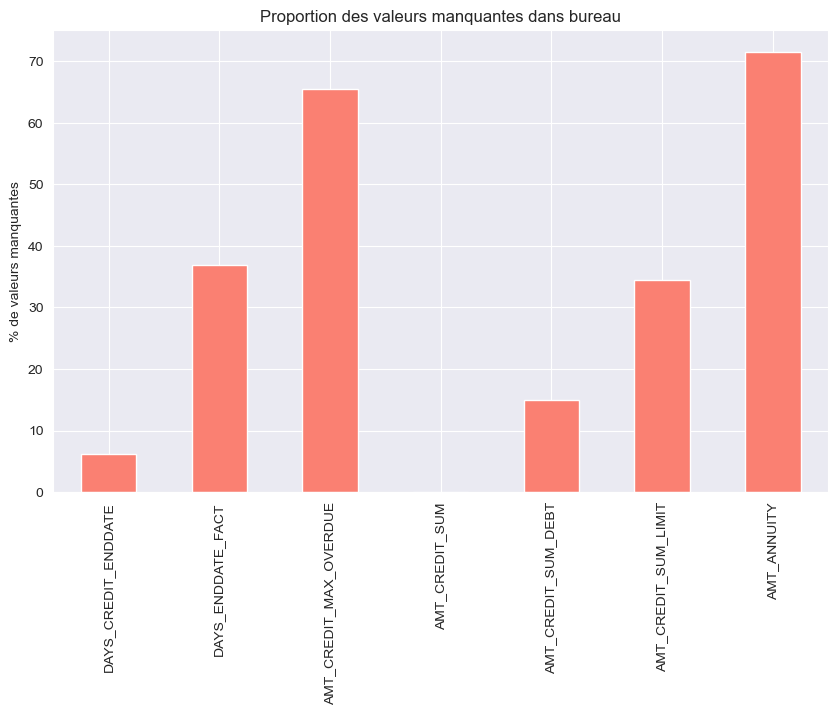


Matrice de corrélation pour bureau:


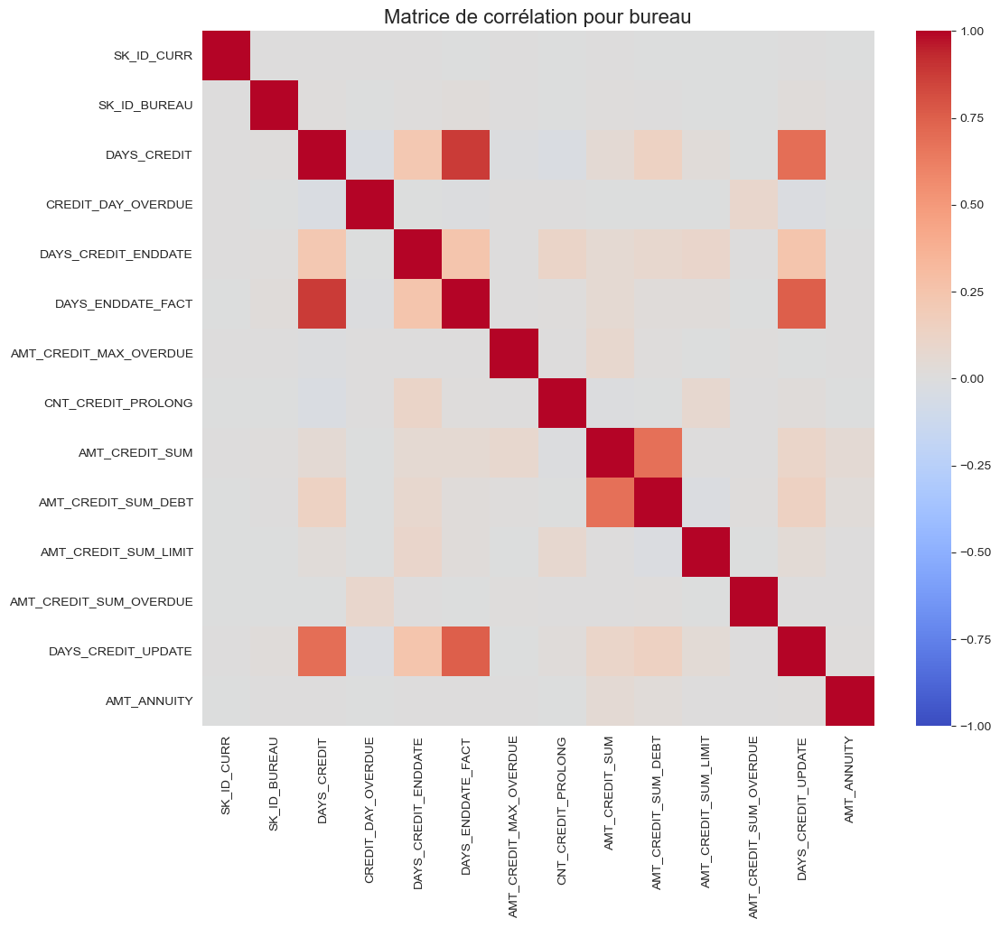


Types de variables dans bureau:
SK_ID_CURR                  int64
SK_ID_BUREAU                int64
CREDIT_ACTIVE              object
CREDIT_CURRENCY            object
DAYS_CREDIT                 int64
CREDIT_DAY_OVERDUE          int64
DAYS_CREDIT_ENDDATE       float64
DAYS_ENDDATE_FACT         float64
AMT_CREDIT_MAX_OVERDUE    float64
CNT_CREDIT_PROLONG          int64
AMT_CREDIT_SUM            float64
AMT_CREDIT_SUM_DEBT       float64
AMT_CREDIT_SUM_LIMIT      float64
AMT_CREDIT_SUM_OVERDUE    float64
CREDIT_TYPE                object
DAYS_CREDIT_UPDATE          int64
AMT_ANNUITY               float64
dtype: object

Distribution de CREDIT_ACTIVE:
CREDIT_ACTIVE
Closed      1079273
Active       630607
Sold           6527
Bad debt         21
Name: count, dtype: int64


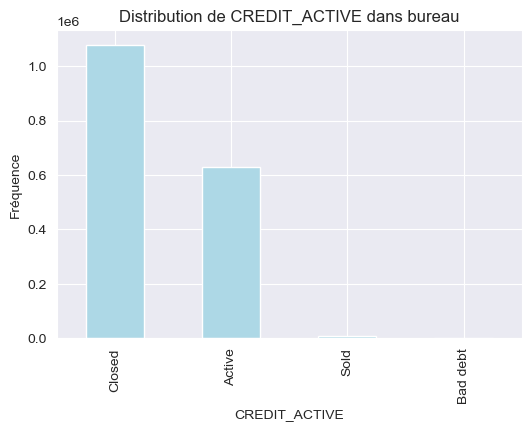


Distribution de CREDIT_CURRENCY:
CREDIT_CURRENCY
currency 1    1715020
currency 2       1224
currency 3        174
currency 4         10
Name: count, dtype: int64


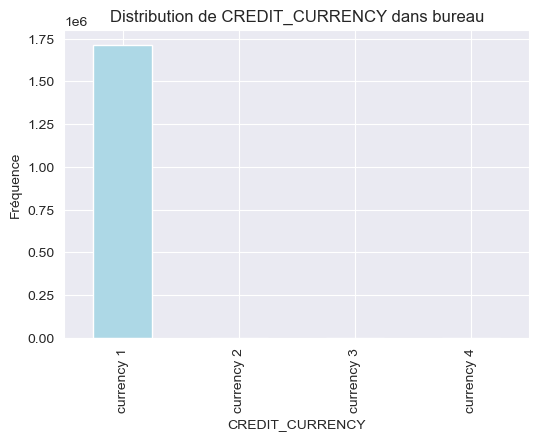


Distribution de CREDIT_TYPE:
CREDIT_TYPE
Consumer credit                                 1251615
Credit card                                      402195
Car loan                                          27690
Mortgage                                          18391
Microloan                                         12413
Loan for business development                      1975
Another type of loan                               1017
Unknown type of loan                                555
Loan for working capital replenishment              469
Cash loan (non-earmarked)                            56
Real estate loan                                     27
Loan for the purchase of equipment                   19
Loan for purchase of shares (margin lending)          4
Mobile operator loan                                  1
Interbank credit                                      1
Name: count, dtype: int64


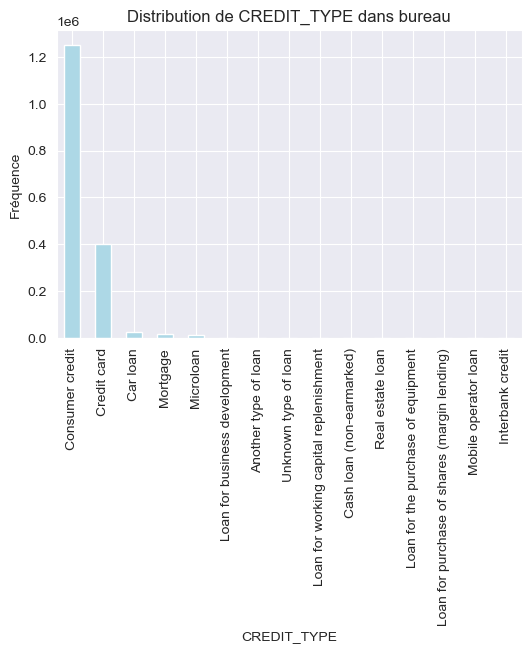


### Exploration de bureau_balance ###

Informations sur le dataset bureau_balance:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Data columns (total 3 columns):
 #   Column          Dtype 
---  ------          ----- 
 0   SK_ID_BUREAU    int64 
 1   MONTHS_BALANCE  int64 
 2   STATUS          object
dtypes: int64(2), object(1)
memory usage: 624.8+ MB
None

Descriptif statistique du dataset bureau_balance:
       SK_ID_BUREAU  MONTHS_BALANCE
count  2.729992e+07    2.729992e+07
mean   6.036297e+06   -3.074169e+01
std    4.923489e+05    2.386451e+01
min    5.001709e+06   -9.600000e+01
25%    5.730933e+06   -4.600000e+01
50%    6.070821e+06   -2.500000e+01
75%    6.431951e+06   -1.100000e+01
max    6.842888e+06    0.000000e+00

Nombre de doublons dans bureau_balance: 0

Valeurs manquantes dans bureau_balance:

Aucune valeur manquante détectée dans bureau_balance.

Matrice de corrélation pour bureau_balance:


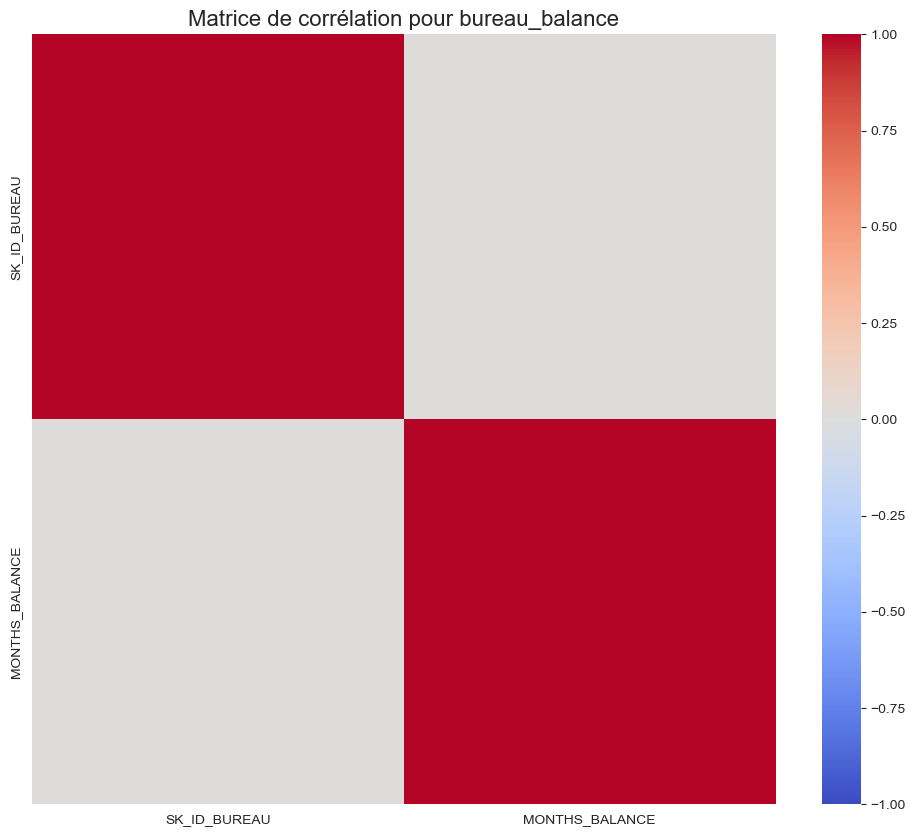


Types de variables dans bureau_balance:
SK_ID_BUREAU       int64
MONTHS_BALANCE     int64
STATUS            object
dtype: object

Distribution de STATUS:
STATUS
C    13646993
0     7499507
X     5810482
1      242347
5       62406
2       23419
3        8924
4        5847
Name: count, dtype: int64


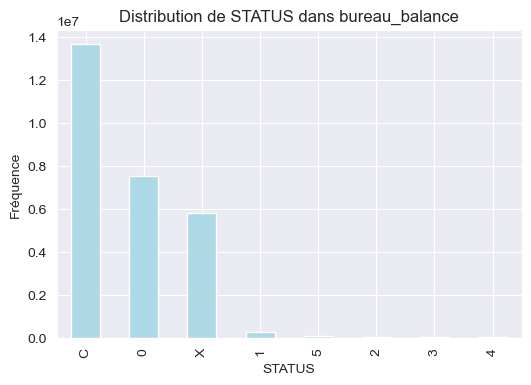


### Exploration de credit_card_balance ###

Informations sur le dataset credit_card_balance:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Dtype  
---  ------                      -----  
 0   SK_ID_PREV                  int64  
 1   SK_ID_CURR                  int64  
 2   MONTHS_BALANCE              int64  
 3   AMT_BALANCE                 float64
 4   AMT_CREDIT_LIMIT_ACTUAL     int64  
 5   AMT_DRAWINGS_ATM_CURRENT    float64
 6   AMT_DRAWINGS_CURRENT        float64
 7   AMT_DRAWINGS_OTHER_CURRENT  float64
 8   AMT_DRAWINGS_POS_CURRENT    float64
 9   AMT_INST_MIN_REGULARITY     float64
 10  AMT_PAYMENT_CURRENT         float64
 11  AMT_PAYMENT_TOTAL_CURRENT   float64
 12  AMT_RECEIVABLE_PRINCIPAL    float64
 13  AMT_RECIVABLE               float64
 14  AMT_TOTAL_RECEIVABLE        float64
 15  CNT_DRAWINGS_ATM_CURRENT    float64
 16  CNT_DRAWINGS_CURRENT        int64  
 17  CNT_DRAWI

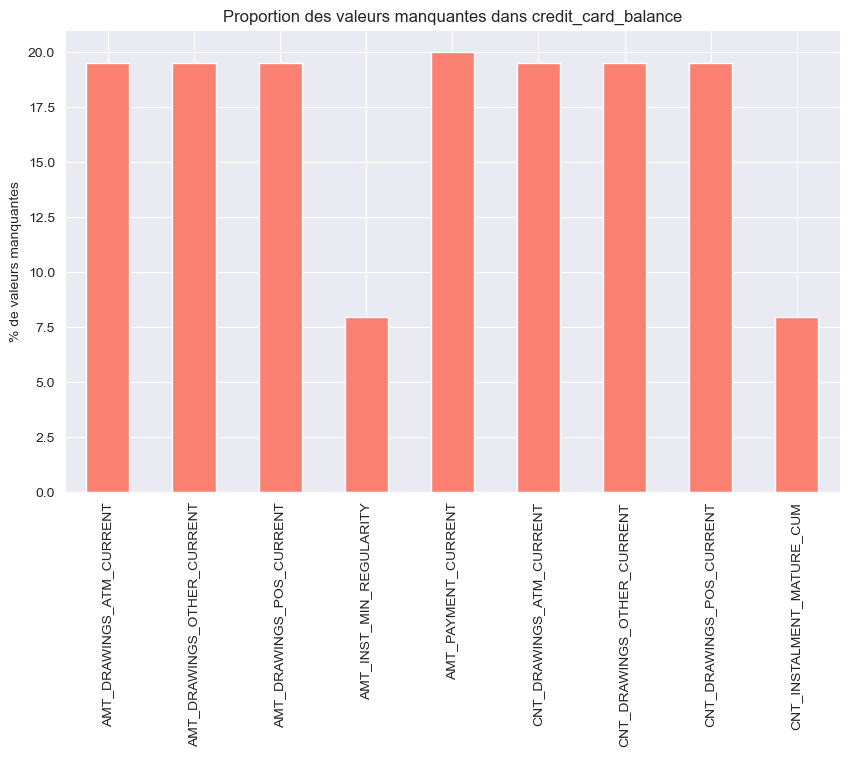


Matrice de corrélation pour credit_card_balance:


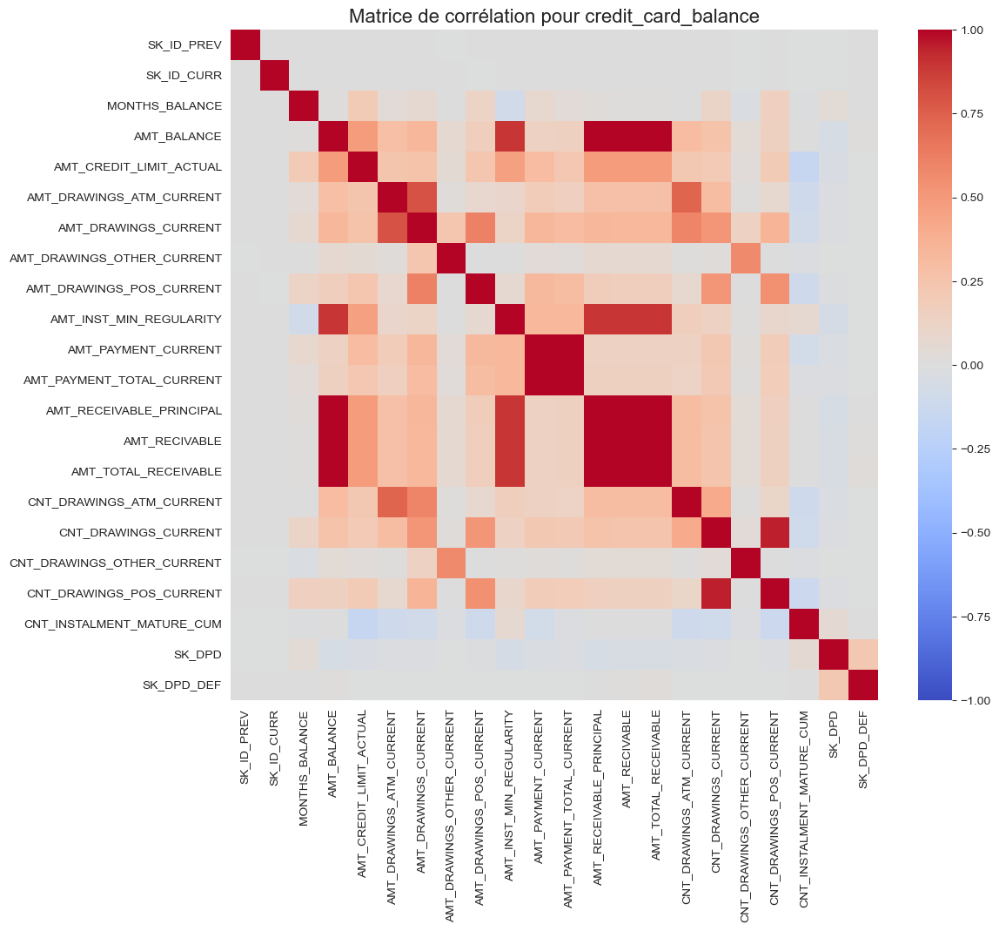


Types de variables dans credit_card_balance:
SK_ID_PREV                      int64
SK_ID_CURR                      int64
MONTHS_BALANCE                  int64
AMT_BALANCE                   float64
AMT_CREDIT_LIMIT_ACTUAL         int64
AMT_DRAWINGS_ATM_CURRENT      float64
AMT_DRAWINGS_CURRENT          float64
AMT_DRAWINGS_OTHER_CURRENT    float64
AMT_DRAWINGS_POS_CURRENT      float64
AMT_INST_MIN_REGULARITY       float64
AMT_PAYMENT_CURRENT           float64
AMT_PAYMENT_TOTAL_CURRENT     float64
AMT_RECEIVABLE_PRINCIPAL      float64
AMT_RECIVABLE                 float64
AMT_TOTAL_RECEIVABLE          float64
CNT_DRAWINGS_ATM_CURRENT      float64
CNT_DRAWINGS_CURRENT            int64
CNT_DRAWINGS_OTHER_CURRENT    float64
CNT_DRAWINGS_POS_CURRENT      float64
CNT_INSTALMENT_MATURE_CUM     float64
NAME_CONTRACT_STATUS           object
SK_DPD                          int64
SK_DPD_DEF                      int64
dtype: object

Distribution de NAME_CONTRACT_STATUS:
NAME_CONTRACT_STATUS
Active

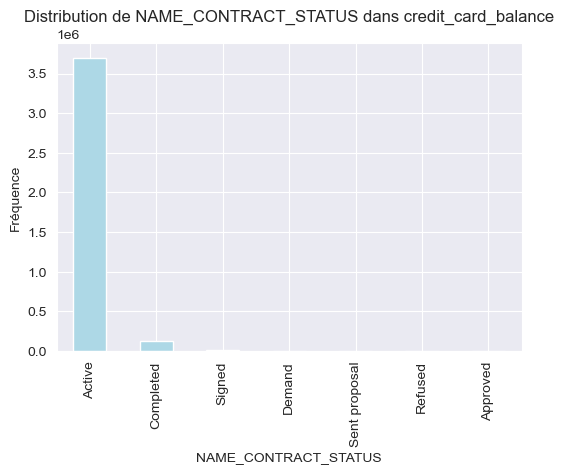


### Exploration de HomeCredit_columns_description ###

Informations sur le dataset HomeCredit_columns_description:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   219 non-null    int64 
 1   Table        219 non-null    object
 2   Row          219 non-null    object
 3   Description  219 non-null    object
 4   Special      86 non-null     object
dtypes: int64(1), object(4)
memory usage: 8.7+ KB
None

Descriptif statistique du dataset HomeCredit_columns_description:
       Unnamed: 0
count  219.000000
mean   111.981735
std     63.395726
min      1.000000
25%     57.500000
50%    112.000000
75%    166.500000
max    221.000000

Nombre de doublons dans HomeCredit_columns_description: 0

Valeurs manquantes dans HomeCredit_columns_description:
Special    60.730594
dtype: float64


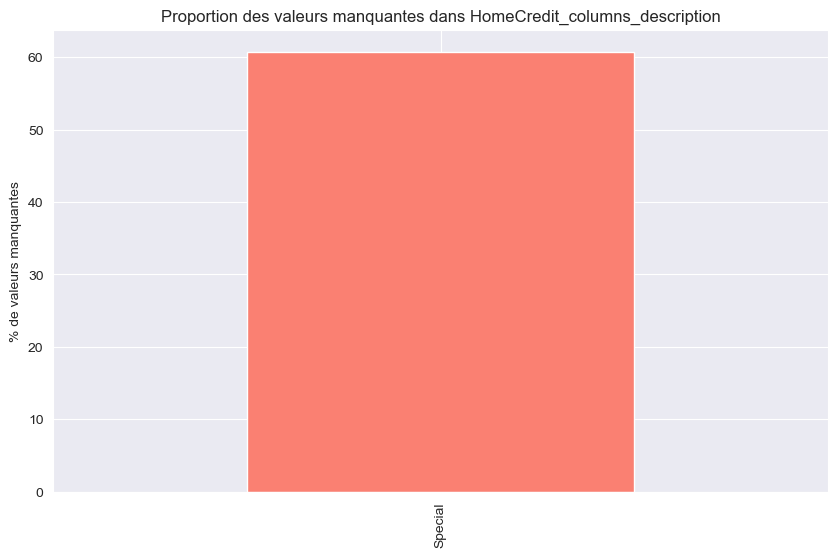


Matrice de corrélation pour HomeCredit_columns_description:

Aucune colonne numérique trouvée dans HomeCredit_columns_description pour la matrice de corrélation.

Types de variables dans HomeCredit_columns_description:
Unnamed: 0      int64
Table          object
Row            object
Description    object
Special        object
dtype: object

Distribution de Table:
Table
application_{train|test}.csv    122
previous_application.csv         38
credit_card_balance.csv          23
bureau.csv                       17
POS_CASH_balance.csv              8
installments_payments.csv         8
bureau_balance.csv                3
Name: count, dtype: int64


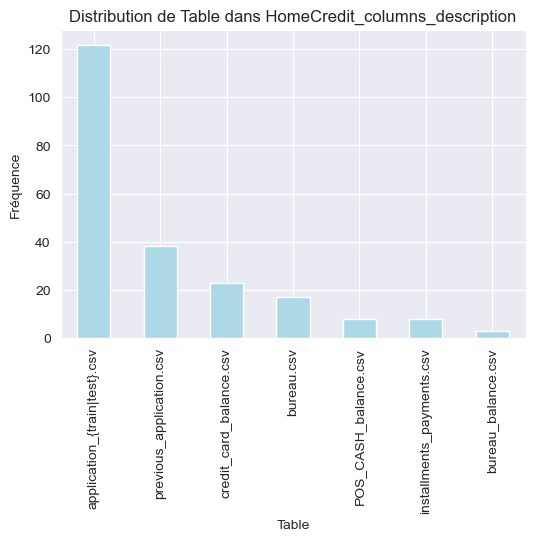


Distribution de Row:
Row
SK_ID_CURR                      6
SK_ID_PREV                      4
AMT_ANNUITY                     3
MONTHS_BALANCE                  3
NAME_CONTRACT_STATUS            3
                               ..
APARTMENTS_MEDI                 1
BASEMENTAREA_MEDI               1
YEARS_BEGINEXPLUATATION_MEDI    1
YEARS_BUILD_MEDI                1
AMT_PAYMENT                     1
Name: count, Length: 196, dtype: int64


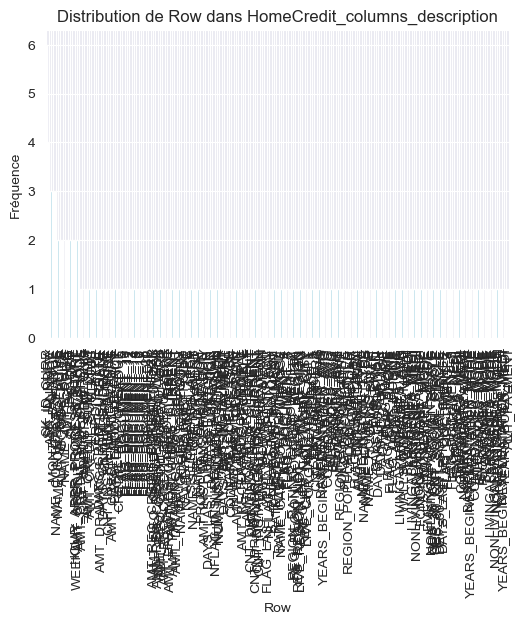


Distribution de Description:
Description
Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor    47
ID of loan in our sample                                                                                                                                                                                                                                                                 5
Normalized score from external data source                                                                                                                                                                                                                                               3
ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or

C:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 133 (\x85) missing from font(s) Arial.



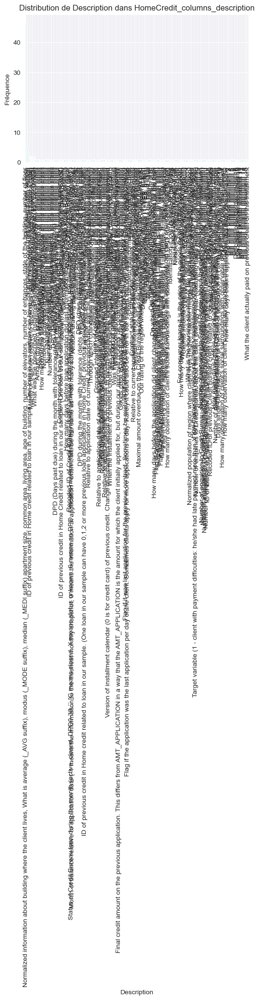


Distribution de Special:
Special
normalized                               53
time only relative to the application    19
hashed                                    9
rounded                                   2
normalized                                1
recoded                                   1
grouped                                   1
Name: count, dtype: int64


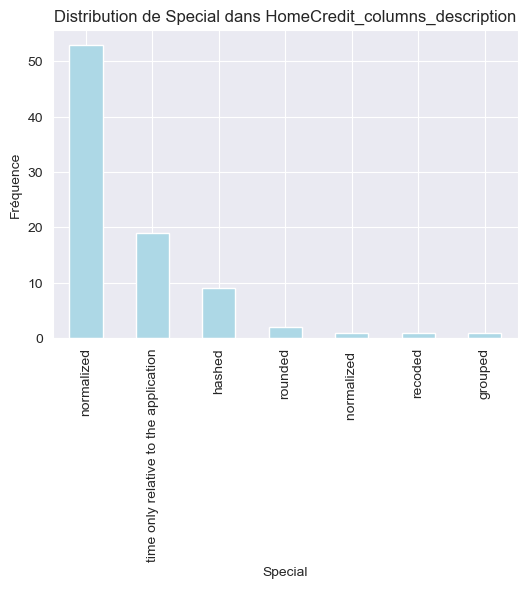


### Exploration de installments_payments ###

Informations sur le dataset installments_payments:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_PREV              int64  
 1   SK_ID_CURR              int64  
 2   NUM_INSTALMENT_VERSION  float64
 3   NUM_INSTALMENT_NUMBER   int64  
 4   DAYS_INSTALMENT         float64
 5   DAYS_ENTRY_PAYMENT      float64
 6   AMT_INSTALMENT          float64
 7   AMT_PAYMENT             float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB
None

Descriptif statistique du dataset installments_payments:
         SK_ID_PREV    SK_ID_CURR  NUM_INSTALMENT_VERSION  \
count  1.360540e+07  1.360540e+07            1.360540e+07   
mean   1.903365e+06  2.784449e+05            8.566373e-01   
std    5.362029e+05  1.027183e+05            1.035216e+00   
min    1.000001e+06  1.000010e+05            0.000000e+00  

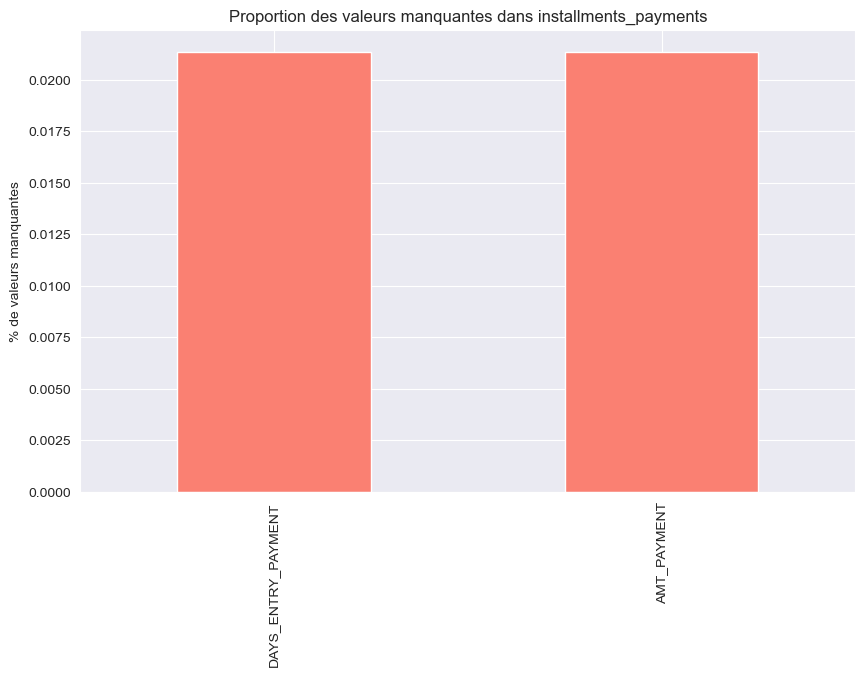


Matrice de corrélation pour installments_payments:


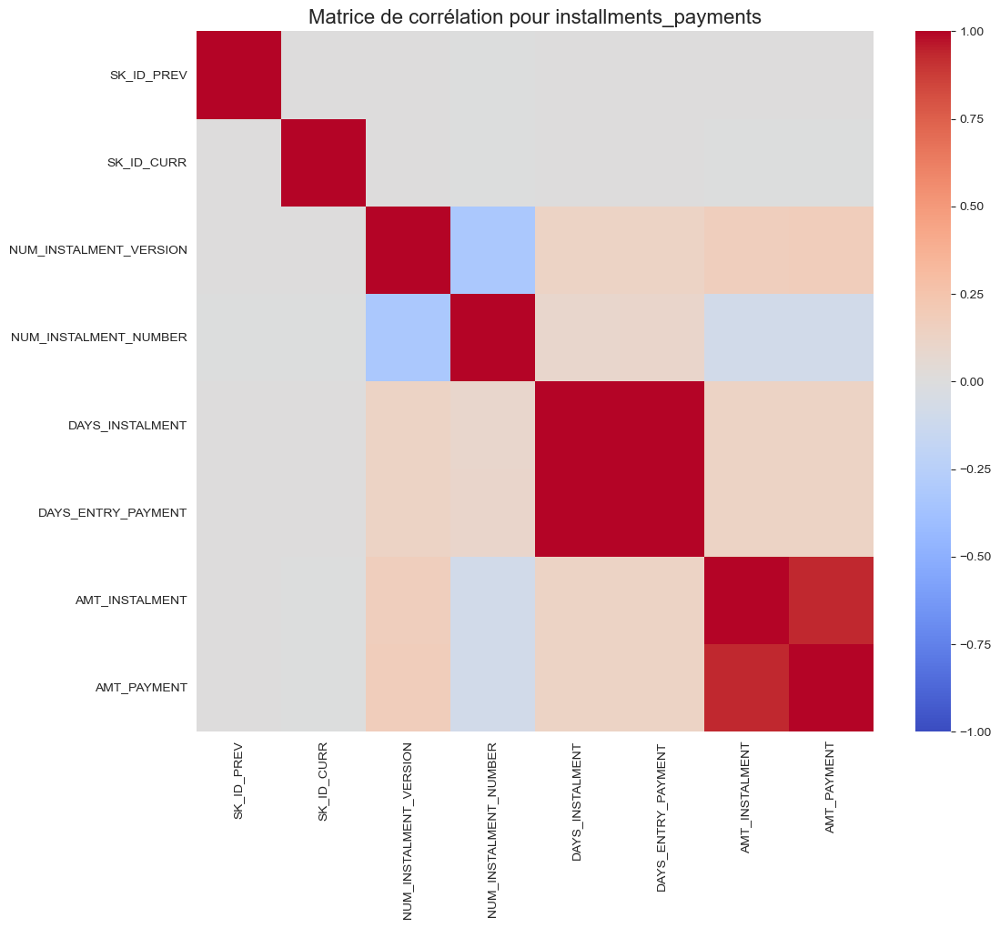


Types de variables dans installments_payments:
SK_ID_PREV                  int64
SK_ID_CURR                  int64
NUM_INSTALMENT_VERSION    float64
NUM_INSTALMENT_NUMBER       int64
DAYS_INSTALMENT           float64
DAYS_ENTRY_PAYMENT        float64
AMT_INSTALMENT            float64
AMT_PAYMENT               float64
dtype: object

### Exploration de POS_CASH_balance ###

Informations sur le dataset POS_CASH_balance:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   SK_ID_PREV             int64  
 1   SK_ID_CURR             int64  
 2   MONTHS_BALANCE         int64  
 3   CNT_INSTALMENT         float64
 4   CNT_INSTALMENT_FUTURE  float64
 5   NAME_CONTRACT_STATUS   object 
 6   SK_DPD                 int64  
 7   SK_DPD_DEF             int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB
None

Descriptif statistique du dataset 

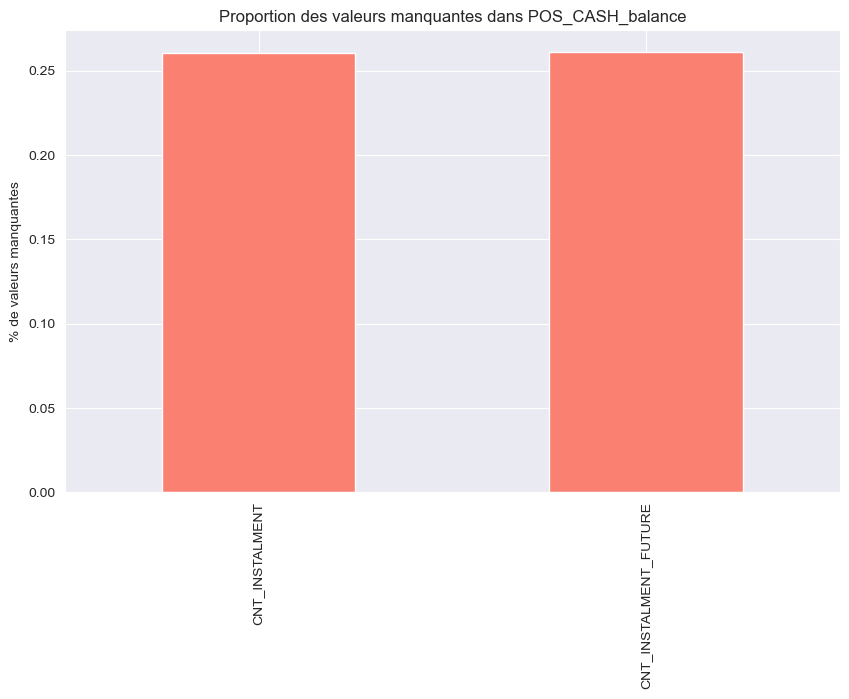


Matrice de corrélation pour POS_CASH_balance:


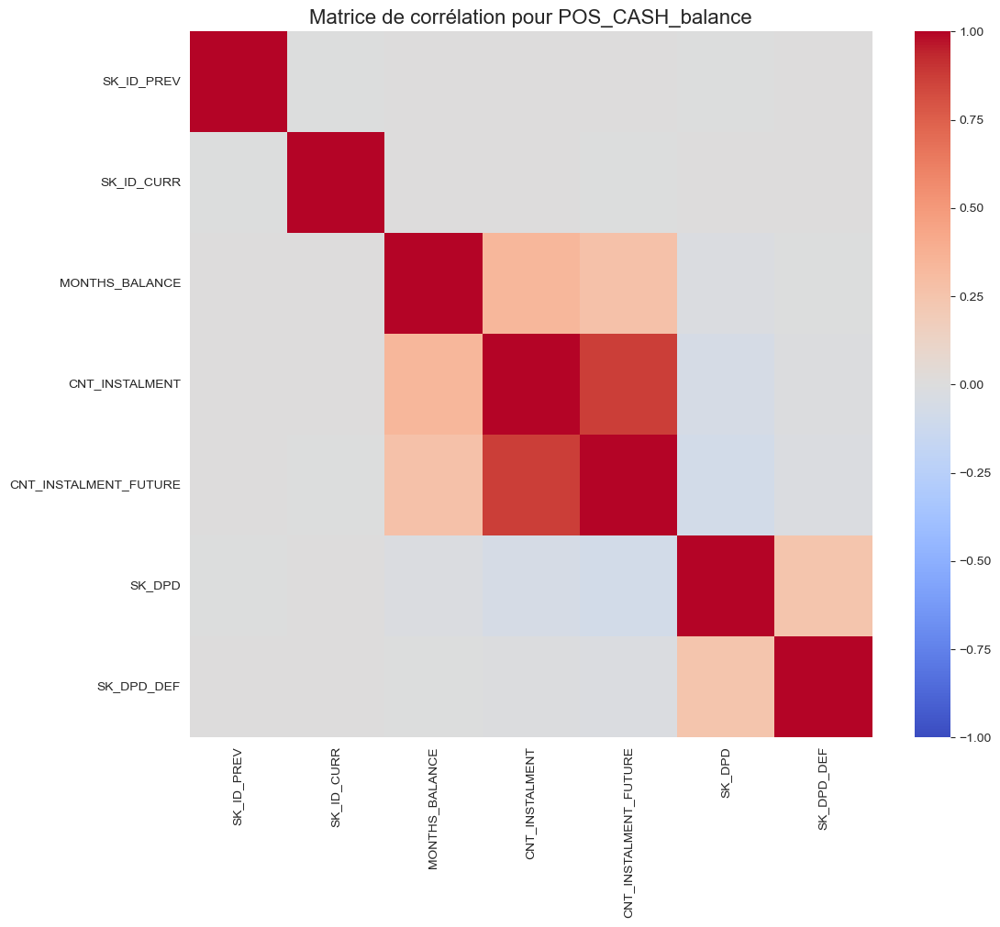


Types de variables dans POS_CASH_balance:
SK_ID_PREV                 int64
SK_ID_CURR                 int64
MONTHS_BALANCE             int64
CNT_INSTALMENT           float64
CNT_INSTALMENT_FUTURE    float64
NAME_CONTRACT_STATUS      object
SK_DPD                     int64
SK_DPD_DEF                 int64
dtype: object

Distribution de NAME_CONTRACT_STATUS:
NAME_CONTRACT_STATUS
Active                   9151119
Completed                 744883
Signed                     87260
Demand                      7065
Returned to the store       5461
Approved                    4917
Amortized debt               636
Canceled                      15
XNA                            2
Name: count, dtype: int64


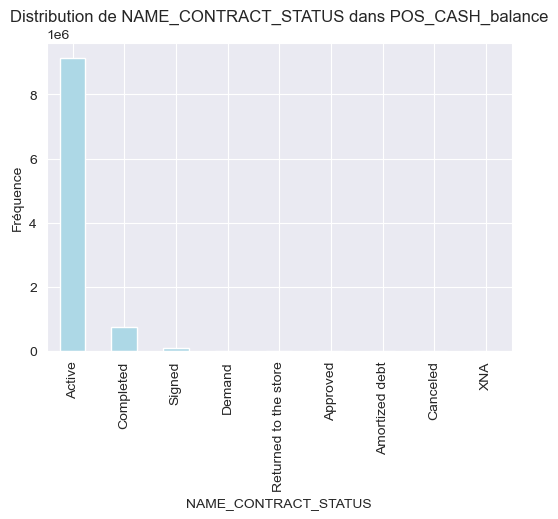


### Exploration de previous_application ###

Informations sur le dataset previous_application:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_

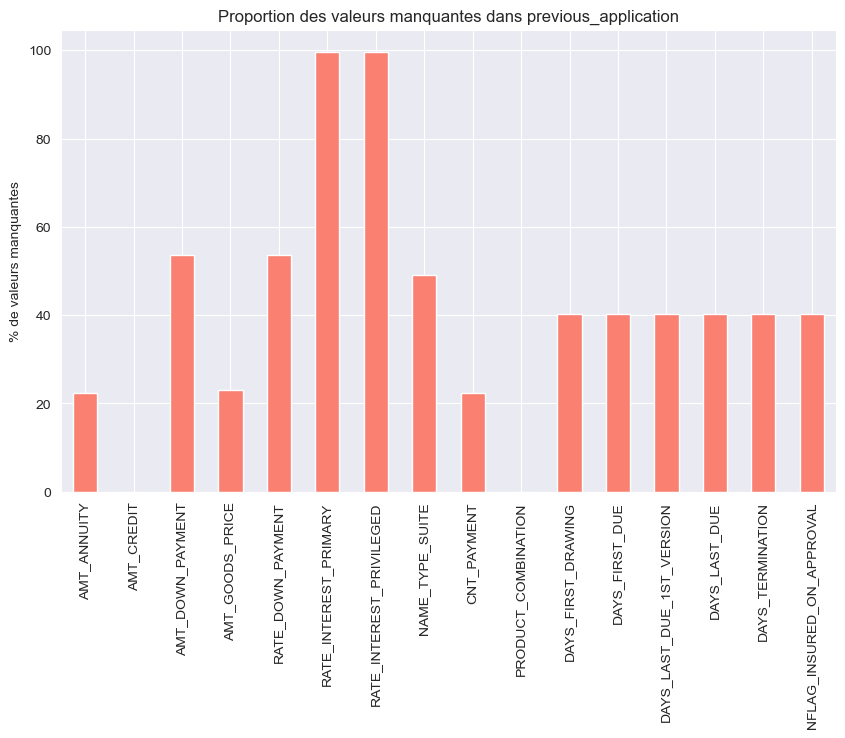


Matrice de corrélation pour previous_application:


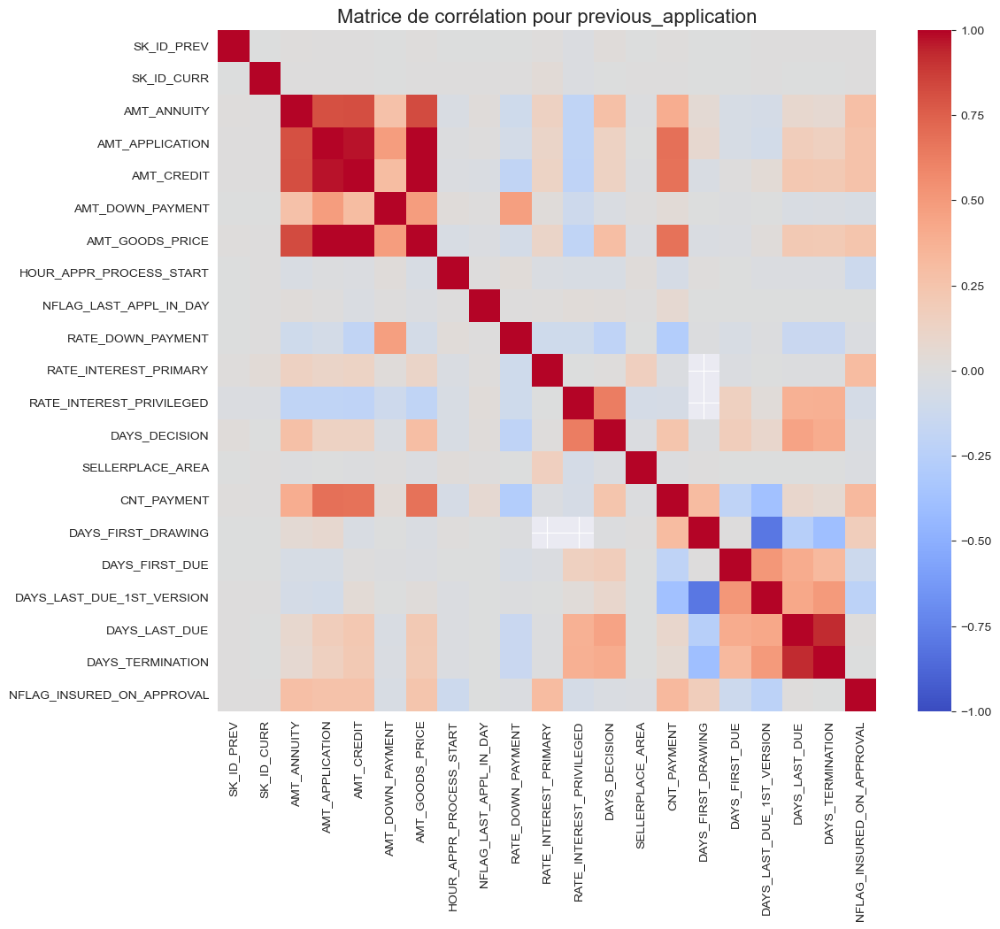


Types de variables dans previous_application:
SK_ID_PREV                       int64
SK_ID_CURR                       int64
NAME_CONTRACT_TYPE              object
AMT_ANNUITY                    float64
AMT_APPLICATION                float64
AMT_CREDIT                     float64
AMT_DOWN_PAYMENT               float64
AMT_GOODS_PRICE                float64
WEEKDAY_APPR_PROCESS_START      object
HOUR_APPR_PROCESS_START          int64
FLAG_LAST_APPL_PER_CONTRACT     object
NFLAG_LAST_APPL_IN_DAY           int64
RATE_DOWN_PAYMENT              float64
RATE_INTEREST_PRIMARY          float64
RATE_INTEREST_PRIVILEGED       float64
NAME_CASH_LOAN_PURPOSE          object
NAME_CONTRACT_STATUS            object
DAYS_DECISION                    int64
NAME_PAYMENT_TYPE               object
CODE_REJECT_REASON              object
NAME_TYPE_SUITE                 object
NAME_CLIENT_TYPE                object
NAME_GOODS_CATEGORY             object
NAME_PORTFOLIO                  object
NAME_PRODUCT_TYPE

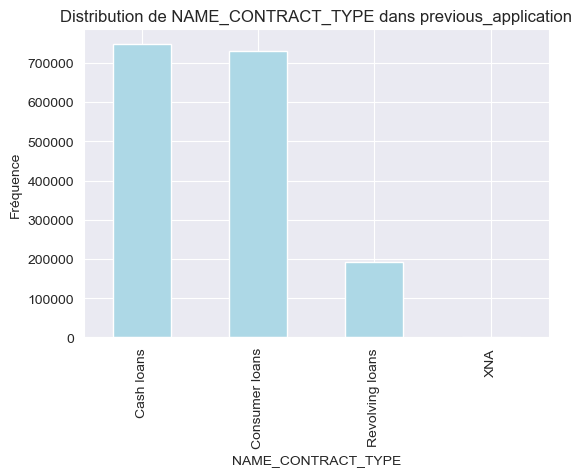


Distribution de WEEKDAY_APPR_PROCESS_START:
WEEKDAY_APPR_PROCESS_START
TUESDAY      255118
WEDNESDAY    255010
MONDAY       253557
FRIDAY       252048
THURSDAY     249099
SATURDAY     240631
SUNDAY       164751
Name: count, dtype: int64


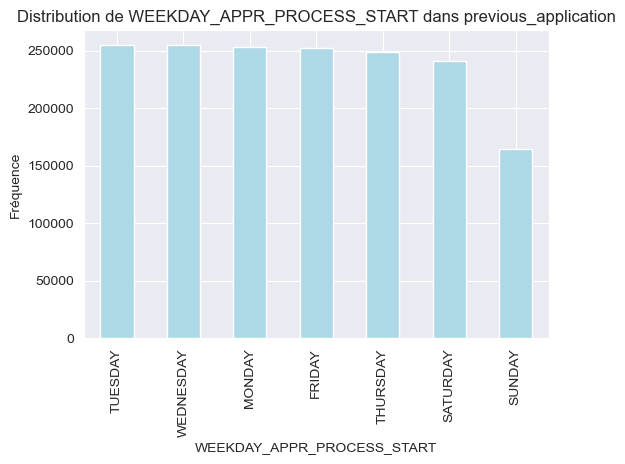


Distribution de FLAG_LAST_APPL_PER_CONTRACT:
FLAG_LAST_APPL_PER_CONTRACT
Y    1661739
N       8475
Name: count, dtype: int64


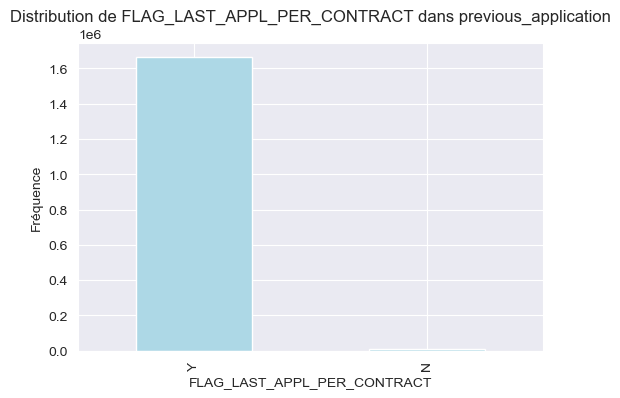


Distribution de NAME_CASH_LOAN_PURPOSE:
NAME_CASH_LOAN_PURPOSE
XAP                                 922661
XNA                                 677918
Repairs                              23765
Other                                15608
Urgent needs                          8412
Buying a used car                     2888
Building a house or an annex          2693
Everyday expenses                     2416
Medicine                              2174
Payments on other loans               1931
Education                             1573
Journey                               1239
Purchase of electronic equipment      1061
Buying a new car                      1012
Wedding / gift / holiday               962
Buying a home                          865
Car repairs                            797
Furniture                              749
Buying a holiday home / land           533
Business development                   426
Gasification / water supply            300
Buying a garage                  

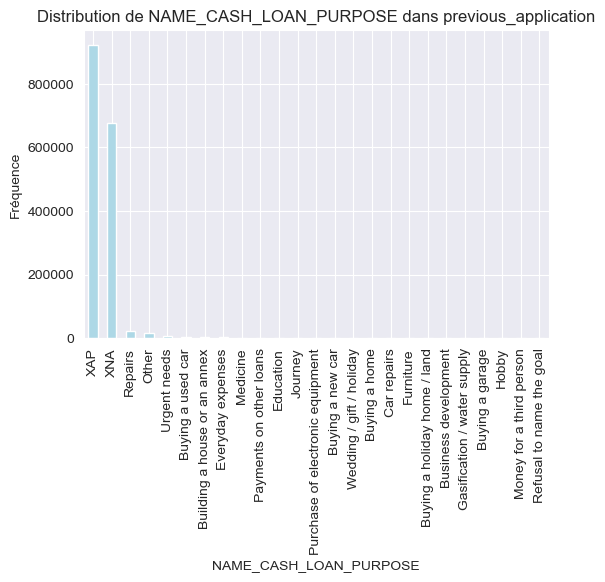


Distribution de NAME_CONTRACT_STATUS:
NAME_CONTRACT_STATUS
Approved        1036781
Canceled         316319
Refused          290678
Unused offer      26436
Name: count, dtype: int64


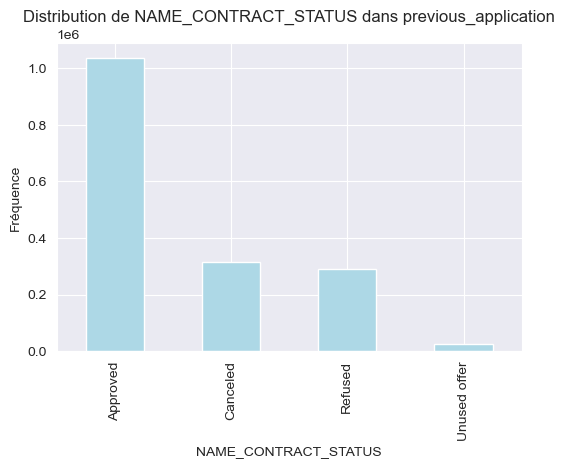


Distribution de NAME_PAYMENT_TYPE:
NAME_PAYMENT_TYPE
Cash through the bank                        1033552
XNA                                           627384
Non-cash from your account                      8193
Cashless from the account of the employer       1085
Name: count, dtype: int64


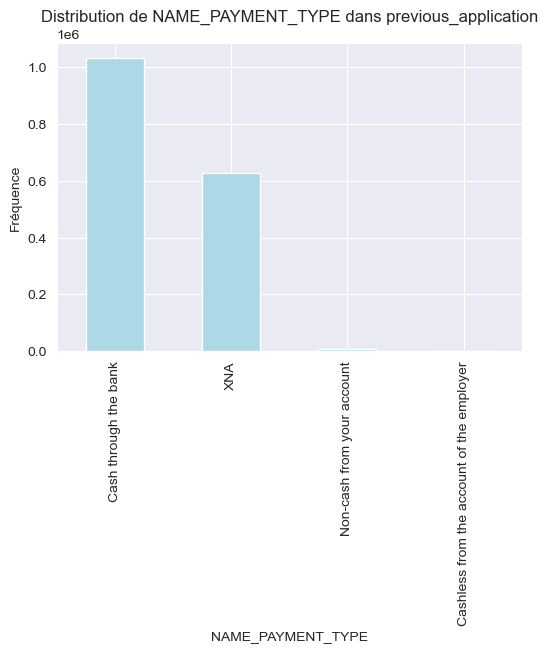


Distribution de CODE_REJECT_REASON:
CODE_REJECT_REASON
XAP       1353093
HC         175231
LIMIT       55680
SCO         37467
CLIENT      26436
SCOFR       12811
XNA          5244
VERIF        3535
SYSTEM        717
Name: count, dtype: int64


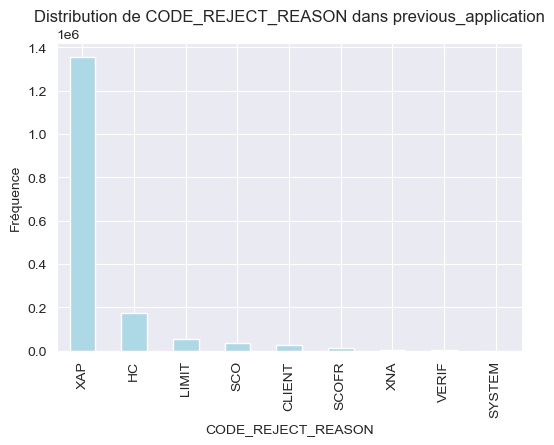


Distribution de NAME_TYPE_SUITE:
NAME_TYPE_SUITE
Unaccompanied      508970
Family             213263
Spouse, partner     67069
Children            31566
Other_B             17624
Other_A              9077
Group of people      2240
Name: count, dtype: int64


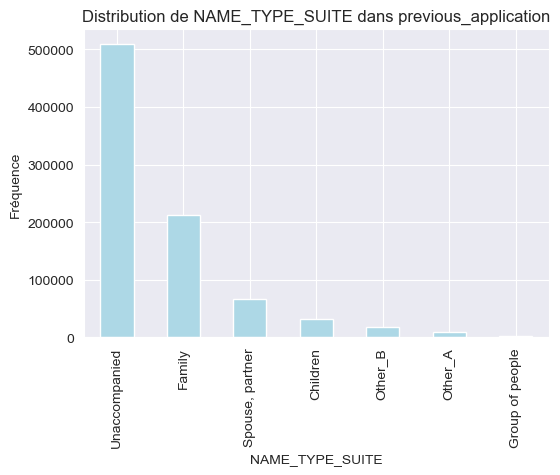


Distribution de NAME_CLIENT_TYPE:
NAME_CLIENT_TYPE
Repeater     1231261
New           301363
Refreshed     135649
XNA             1941
Name: count, dtype: int64


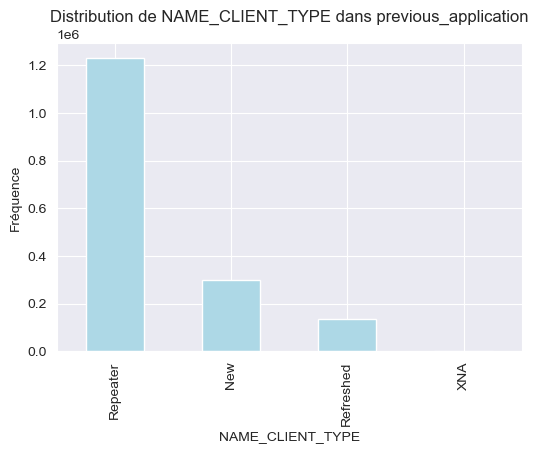


Distribution de NAME_GOODS_CATEGORY:
NAME_GOODS_CATEGORY
XNA                         950809
Mobile                      224708
Consumer Electronics        121576
Computers                   105769
Audio/Video                  99441
Furniture                    53656
Photo / Cinema Equipment     25021
Construction Materials       24995
Clothing and Accessories     23554
Auto Accessories              7381
Jewelry                       6290
Homewares                     5023
Medical Supplies              3843
Vehicles                      3370
Sport and Leisure             2981
Gardening                     2668
Other                         2554
Office Appliances             2333
Tourism                       1659
Medicine                      1550
Direct Sales                   446
Fitness                        209
Additional Service             128
Education                      107
Weapon                          77
Insurance                       64
Animals                         

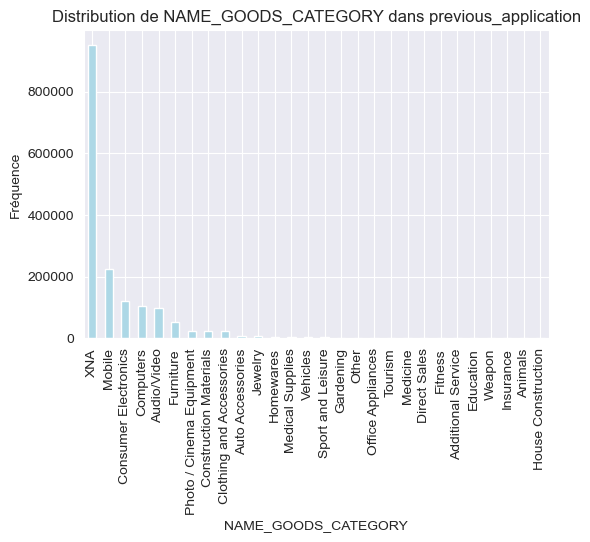


Distribution de NAME_PORTFOLIO:
NAME_PORTFOLIO
POS      691011
Cash     461563
XNA      372230
Cards    144985
Cars        425
Name: count, dtype: int64


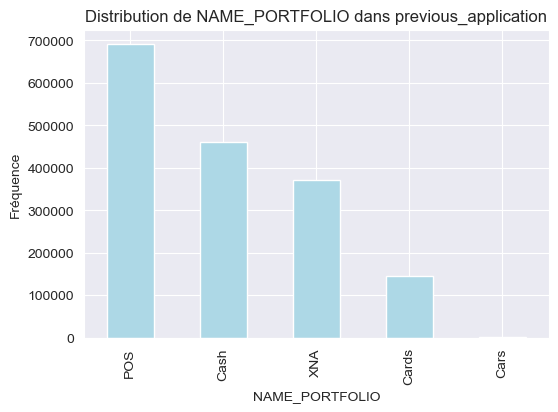


Distribution de NAME_PRODUCT_TYPE:
NAME_PRODUCT_TYPE
XNA        1063666
x-sell      456287
walk-in     150261
Name: count, dtype: int64


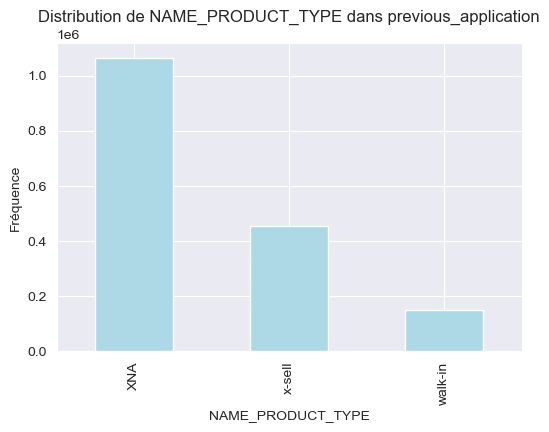


Distribution de CHANNEL_TYPE:
CHANNEL_TYPE
Credit and cash offices       719968
Country-wide                  494690
Stone                         212083
Regional / Local              108528
Contact center                 71297
AP+ (Cash loan)                57046
Channel of corporate sales      6150
Car dealer                       452
Name: count, dtype: int64


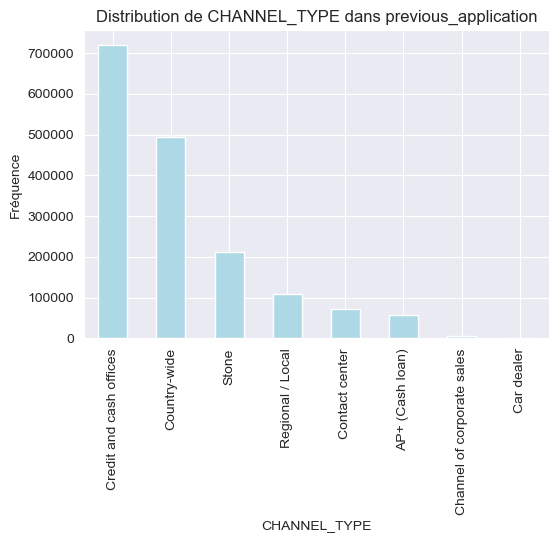


Distribution de NAME_SELLER_INDUSTRY:
NAME_SELLER_INDUSTRY
XNA                     855720
Consumer electronics    398265
Connectivity            276029
Furniture                57849
Construction             29781
Clothing                 23949
Industry                 19194
Auto technology           4990
Jewelry                   2709
MLM partners              1215
Tourism                    513
Name: count, dtype: int64


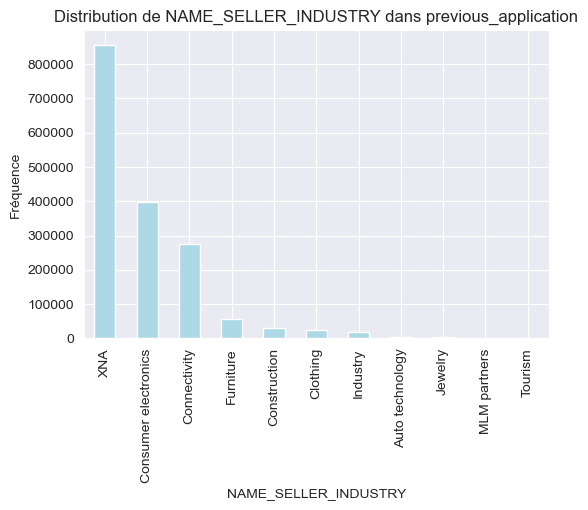


Distribution de NAME_YIELD_GROUP:
NAME_YIELD_GROUP
XNA           517215
middle        385532
high          353331
low_normal    322095
low_action     92041
Name: count, dtype: int64


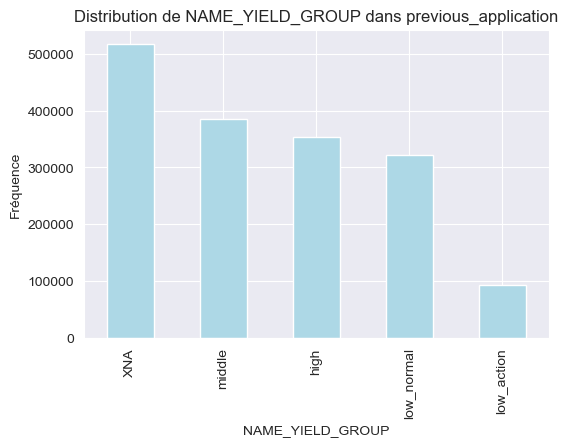


Distribution de PRODUCT_COMBINATION:
PRODUCT_COMBINATION
Cash                              285990
POS household with interest       263622
POS mobile with interest          220670
Cash X-Sell: middle               143883
Cash X-Sell: low                  130248
Card Street                       112582
POS industry with interest         98833
POS household without interest     82908
Card X-Sell                        80582
Cash Street: high                  59639
Cash X-Sell: high                  59301
Cash Street: middle                34658
Cash Street: low                   33834
POS mobile without interest        24082
POS other with interest            23879
POS industry without interest      12602
POS others without interest         2555
Name: count, dtype: int64


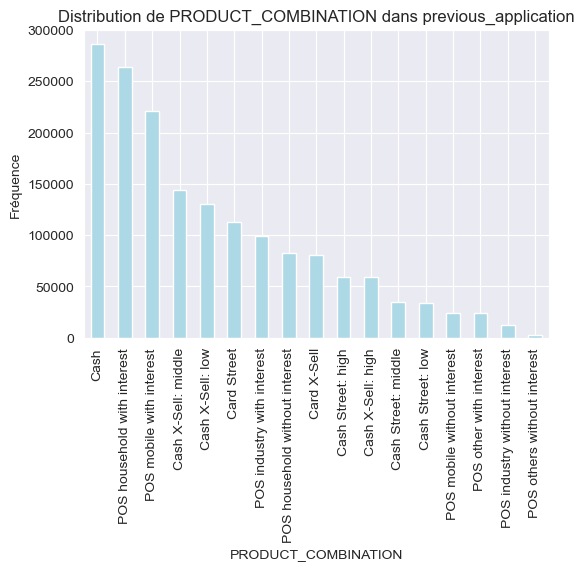


### Exploration de sample_submission ###

Informations sur le dataset sample_submission:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   SK_ID_CURR  48744 non-null  int64  
 1   TARGET      48744 non-null  float64
dtypes: float64(1), int64(1)
memory usage: 761.8 KB
None

Descriptif statistique du dataset sample_submission:
          SK_ID_CURR   TARGET
count   48744.000000  48744.0
mean   277796.676350      0.5
std    103169.547296      0.0
min    100001.000000      0.5
25%    188557.750000      0.5
50%    277549.000000      0.5
75%    367555.500000      0.5
max    456250.000000      0.5

Nombre de doublons dans sample_submission: 0

Valeurs manquantes dans sample_submission:

Aucune valeur manquante détectée dans sample_submission.

Proportions de TARGET :
TARGET
0.5    100.0
Name: proportion, dtype: float64


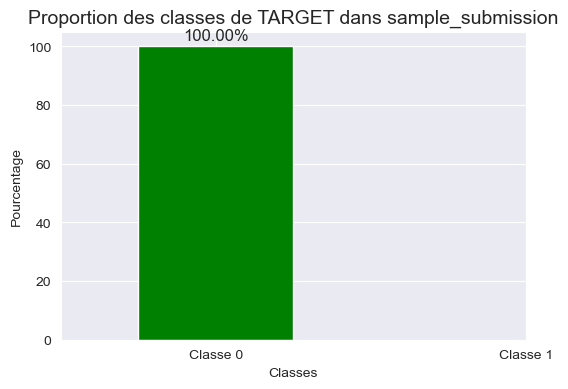


Les classes de TARGET semblent équilibrées.

Matrice de corrélation pour sample_submission:


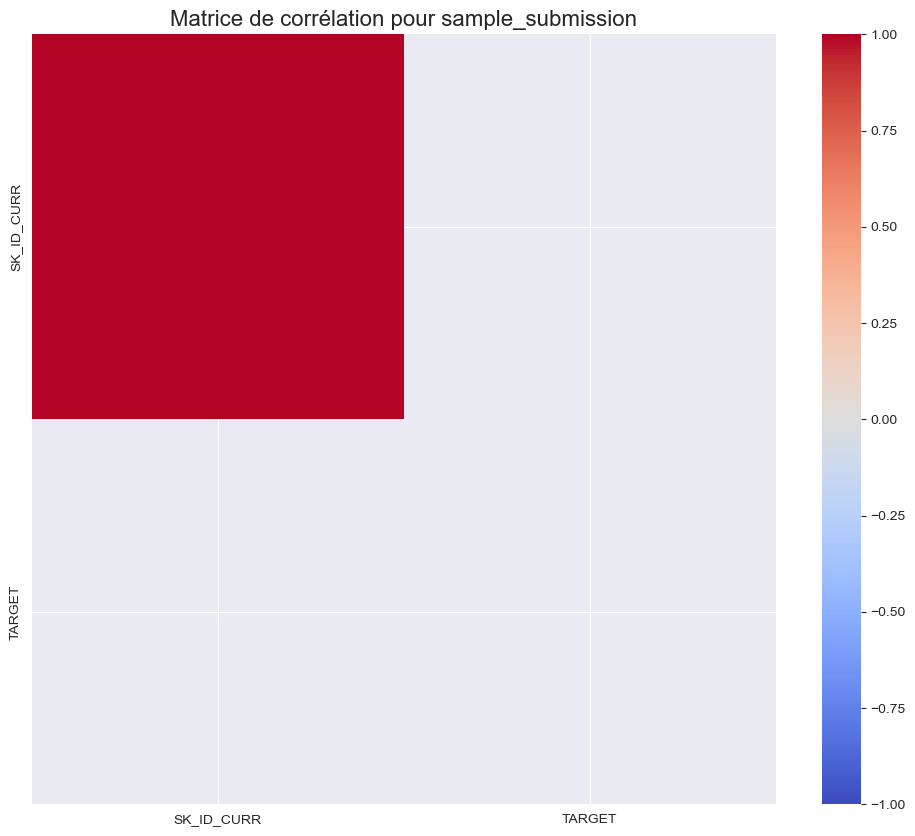


Variables les plus corrélées positivement avec TARGET :
SK_ID_CURR   NaN
TARGET       NaN
Name: TARGET, dtype: float64

Variables les plus corrélées négativement avec TARGET :
SK_ID_CURR   NaN
TARGET       NaN
Name: TARGET, dtype: float64


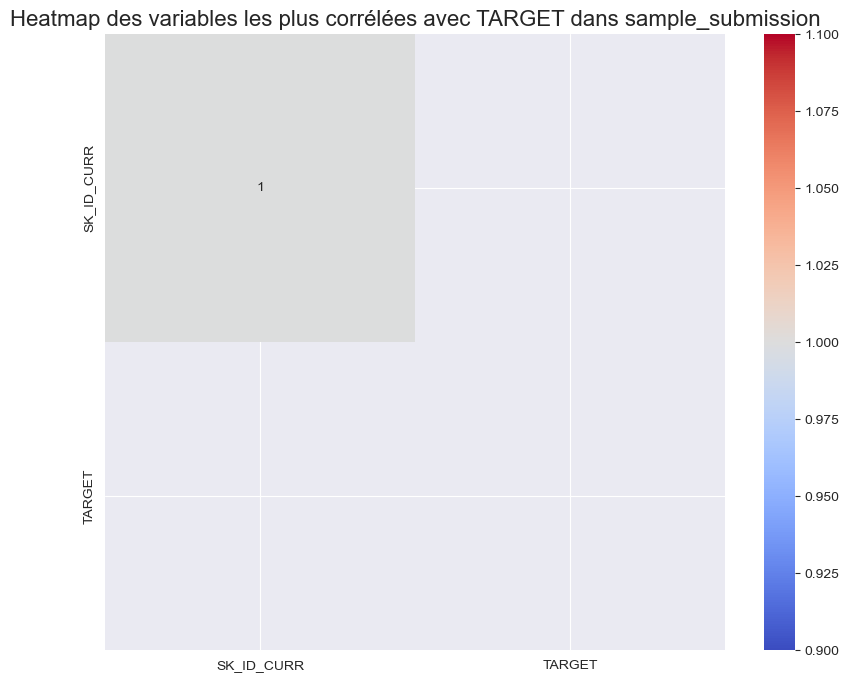


Types de variables dans sample_submission:
SK_ID_CURR      int64
TARGET        float64
dtype: object


In [57]:
# Fonction mise à jour pour explorer un dataset avec visualisation
def explore_dataset(df, name="Dataset"):
    print(f"\n### Exploration de {name} ###")
    
    # Étape 1 : Affichage des informations générales sur le dataset
    print(f"\nInformations sur le dataset {name}:")
    print(df.info())
    print(f"\nDescriptif statistique du dataset {name}:")
    print(df.describe())
    
    # Étape 2 : Vérification des doublons
    print(f"\nNombre de doublons dans {name}: {df.duplicated().sum()}")
    if df.duplicated().sum() > 0:
        print(f"\nRemarque : Des doublons ont été détectés dans {name}. Il est conseillé de les supprimer.")
    
    # Étape 3 : Vérification des valeurs manquantes
    print(f"\nValeurs manquantes dans {name}:")
    missing_data = df.isnull().sum()
    missing_data_percentage = (missing_data / len(df)) * 100
    missing_data_percentage = missing_data_percentage[missing_data_percentage > 0]
    
    if not missing_data_percentage.empty:
        print(missing_data_percentage)
        
        # Visualisation des valeurs manquantes
        missing_data_percentage.plot(kind="bar", figsize=(10, 6), color='salmon')
        plt.title(f"Proportion des valeurs manquantes dans {name}")
        plt.ylabel("% de valeurs manquantes")
        plt.show()
    else:
        print(f"\nAucune valeur manquante détectée dans {name}.")
    
    # Étape 4 : Proportion de la variable cible (TARGET)
    if "TARGET" in df.columns:
        target_counts = df["TARGET"].value_counts(normalize=True) * 100
        
        # Vérification des valeurs présentes dans TARGET
        print(f"\nProportions de TARGET :\n{target_counts}")
        
        # Affichage des pourcentages au-dessus des barres
        target_counts.plot(kind="bar", color=["green", "red"], figsize=(6, 4))
        for i, count in enumerate(target_counts):
            plt.text(i, count + 2, f'{count:.2f}%', ha='center', fontsize=12)
        
        plt.title(f"Proportion des classes de TARGET dans {name}", fontsize=14)
        plt.xlabel("Classes")
        plt.ylabel("Pourcentage")
        plt.xticks([0, 1], labels=["Classe 0", "Classe 1"], rotation=0)
        plt.show()

        # Vérification de l'existence des clés 0 et 1
        target_0 = target_counts.get(0, 0)  # Si 0 n'existe pas, prendre 0
        target_1 = target_counts.get(1, 0)  # Si 1 n'existe pas, prendre 0
        
        if target_0 > 70:
            print("\nRemarque : La classe 0 représente plus de 70% des données, ce qui peut créer un déséquilibre.")
        elif target_1 > 70:
            print("\nRemarque : La classe 1 représente plus de 70% des données, ce qui peut créer un déséquilibre.")
        else:
            print("\nLes classes de TARGET semblent équilibrées.")
    
    # Étape 5 : Matrice de corrélation (filtrer les colonnes numériques uniquement)
    print(f"\nMatrice de corrélation pour {name}:")
    numeric_df = df.select_dtypes(include=["float64", "int64"])
    
    if numeric_df.shape[1] > 1:  # Vérifier qu'il y a des colonnes numériques
        corr = numeric_df.corr()
        plt.figure(figsize=(12, 10))
        sns.heatmap(corr, cmap="coolwarm", vmin=-1, vmax=1, annot=False)
        plt.title(f"Matrice de corrélation pour {name}", fontsize=16)
        plt.show()
    else:
        print(f"\nAucune colonne numérique trouvée dans {name} pour la matrice de corrélation.")

    # Étape 6 : Corrélations avec TARGET
    if "TARGET" in df.columns:
        correlations = numeric_df.corr()["TARGET"].sort_values(ascending=False)
        print("\nVariables les plus corrélées positivement avec TARGET :")
        print(correlations.head(10))
        print("\nVariables les plus corrélées négativement avec TARGET :")
        print(correlations.tail(10))
        
        # Heatmap des variables les plus corrélées
        top_corr_features = correlations.abs().sort_values(ascending=False).head(10).index
        plt.figure(figsize=(10, 8))
        sns.heatmap(numeric_df[top_corr_features].corr(), annot=True, cmap="coolwarm")
        plt.title(f"Heatmap des variables les plus corrélées avec TARGET dans {name}", fontsize=16)
        plt.show()

    # Étape 7 : Analyser les types de variables (catégorielles, numériques)
    print(f"\nTypes de variables dans {name}:")
    print(df.dtypes)

    # Étape 8 : Statistiques des variables catégorielles
    categorical_columns = df.select_dtypes(include=["object"]).columns
    for col in categorical_columns:
        print(f"\nDistribution de {col}:")
        print(df[col].value_counts())
        
        # Visualisation de la distribution des variables catégorielles
        df[col].value_counts().plot(kind="bar", figsize=(6, 4), color='lightblue')
        plt.title(f"Distribution de {col} dans {name}")
        plt.xlabel(f"{col}")
        plt.ylabel("Fréquence")
        plt.show()

# Appliquer la fonction sur les datasets spécifiques
datasets = {
    "bureau": bureau,
    "bureau_balance": bureau_balance,
    "credit_card_balance": credit_card_balance,
    "HomeCredit_columns_description": HomeCredit_columns_description,
    "installments_payments": installments_payments,
    "POS_CASH_balance": POS_CASH_balance,
    "previous_application": previous_application,
    "sample_submission": sample_submission
}

# Appliquer la fonction d'exploration sur tous les datasets
for name, data in datasets.items():
    explore_dataset(data, name)


* L'analyse approfondie des données d'exportation réalisée nous permet de tirer des conclusions globales sur notre ensemble de données.

## 1. Fusion des données

Pour combiner les différents ensembles de données de manière logique, on doit les fusionner sur des colonnes communes (comme l'ID des clients ou des prêts). Chaque dataset doit ajouter des informations pertinentes sans créer de conflits.

## 2. Identification des variables discriminantes

Certaines variables catégorielles (comme le type de contrat ou le genre) peuvent être très utiles pour prédire la défaillance. Il faut analyser leur relation avec la variable cible (TARGET) et retenir celles qui apportent une valeur discriminante.
3. Gestion des valeurs aberrantes

Les variables numériques peuvent avoir des valeurs extrêmes qui ne sont pas des erreurs, mais qui reflètent des comportements inhabituels, notamment chez les défaillants. Au lieu de les supprimer, on peut utiliser des transformations (comme la normalisation) pour les rendre moins influentes tout en conservant leur importance.

## 4. Suppression des variables corrélées

Si certaines variables sont fortement corrélées entre elles, elles peuvent créer des problèmes pour les modèles de machine learning (multicolinéarité). Il est donc important de supprimer celles qui ne rajoutent pas de valeur supplémentaire.

## 5. Gestion du déséquilibre des classes

L'ensemble de données est déséquilibré (beaucoup plus de non-défaillants que de défaillants). Pour éviter que le modèle soit biaisé en faveur de la classe majoritaire, des techniques comme le sur-échantillonnage (SMOTE) ou le sous-échantillonnage peuvent être utilisées.

## 6. Conservation des valeurs aberrantes importantes

Dans un problème de prédiction de défaillance, les valeurs extrêmes peuvent être des indicateurs cruciaux de comportement anormal. Il est donc important de les garder, mais de les traiter de manière appropriée, par exemple en les transformant ou en les normalisant.

## 7. Nettoyage et création de nouvelles variables (Feature Engineering)

Une fois les données nettoyées, il est important de créer de nouvelles variables à partir des données existantes. Par exemple, calculer des ratios ou des catégories dérivées. Cela peut aider à mieux comprendre les relations et à améliorer la performance du modèle.
Conclusion finale :

Le nettoyage des données, la gestion des déséquilibres, et le traitement des valeurs aberrantes permettent d'améliorer la qualité des données avant d'entraîner un modèle de machine learning. Ces étapes, bien exécutées, vont rendre le modèle plus robuste et performant pour prédire la défaillance des clients.

In [58]:
def plot_stats(feature,label_rotation=False,horizontal_layout=True):
    # Compter les occurrences de chaque catégorie dans la variable 'feature'
    temp = application_train[feature].value_counts()
    
    # Créer un DataFrame avec le nom de la catégorie et le nombre de contrats
    df1 = pd.DataFrame({feature: temp.index, 'Number of contracts': temp.values})
    
    # Calculer le pourcentage de TARGET=1 par catégorie
    cat_perc = application_train[[feature, 'TARGET']].groupby([feature], as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)
    
    # Définir la disposition des sous-graphiques (horizontal ou vertical)
    if horizontal_layout:
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,6))  # Disposition horizontale
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12,14))  # Disposition verticale
    
    # Appliquer les couleurs pastel pour les graphiques
    sns.set_color_codes("pastel")
    
    # Tracer le graphique en barres du nombre de contrats par catégorie
    s = sns.barplot(ax=ax1, x=feature, y="Number of contracts", data=df1)
    if label_rotation:
        s.set_xticklabels(s.get_xticklabels(), rotation=90)  # Rotation des étiquettes si spécifié
    
    # Tracer le graphique en barres pour le pourcentage de TARGET=1 par catégorie
    s = sns.barplot(ax=ax2, x=feature, y='TARGET', order=cat_perc[feature], data=cat_perc)
    if label_rotation:
        s.set_xticklabels(s.get_xticklabels(), rotation=90)  # Rotation des étiquettes si spécifié
    
    # Ajouter les labels et ajuster la taille des ticks
    plt.ylabel('Percent of target with value 1 [%]', fontsize=10)
    plt.tick_params(axis='both', which='major', labelsize=10)

    # Afficher les graphiques
    plt.show()


In [59]:
def plot_distribution(var):
    # Initialisation de la variable i pour numéroter les graphiques
    i = 0
    # Séparation des données en fonction de la cible (TARGET)
    t1 = application_train.loc[application_train['TARGET'] != 0]  # Cible 1
    t0 = application_train.loc[application_train['TARGET'] == 0]  # Cible 0

    # Appliquer le style 'whitegrid' pour les graphiques
    sns.set_style('whitegrid')
    plt.figure()
    # Créer une figure avec une grille 2x2 pour afficher plusieurs graphiques
    fig, ax = plt.subplots(2, 2, figsize=(12, 12))

    # Boucle à travers les variables pour tracer la distribution de chacune
    for feature in var:
        i += 1
        plt.subplot(2, 2, i)  # Placer chaque graphique dans la grille
        # Tracer les courbes de densité pour TARGET=1 et TARGET=0
        sns.kdeplot(t1[feature], bw=0.5, label="TARGET = 1")
        sns.kdeplot(t0[feature], bw=0.5, label="TARGET = 0")
        plt.ylabel('Density plot', fontsize=12)  # Étiquette pour l'axe des Y
        plt.xlabel(feature, fontsize=12)  # Étiquette pour l'axe des X
        locs, labels = plt.xticks()  # Obtenir les positions des ticks sur l'axe des X
        plt.tick_params(axis='both', which='major', labelsize=12)  # Ajuster la taille des ticks
    plt.show()  # Afficher les graphiques


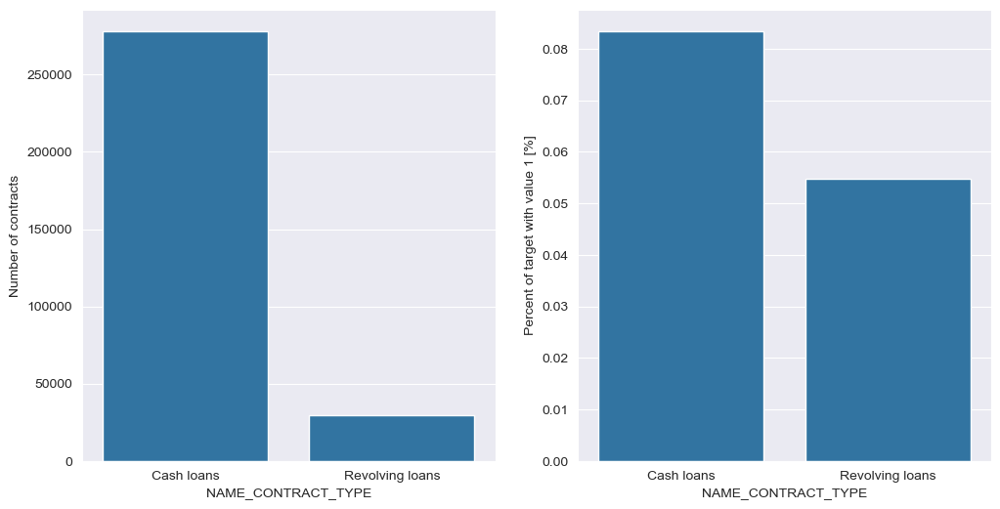

In [60]:
plot_stats('NAME_CONTRACT_TYPE')

## Observation des Types de Prêts

deux graphiques à barres comparant les prêts en espèces et les prêts renouvelables.

   * Graphique de gauche :

        Type de prêts :

      - Prêts en espèces : Environ 280 000 contrats.

      -  Prêts renouvelables : Environ 50 000 contrats.

        Observation :

      -   Il y a une différence significative dans le nombre de contrats entre les prêts en espèces et les prêts renouvelables, les prêts en espèces étant beaucoup plus nombreux.

   * Graphique de droite :

        Pourcentage de défauts (TARGET = 1) :

            Prêts en espèces : Environ 8,5%.

            Prêts renouvelables : Environ 6%.

        Observation :

       * Le pourcentage de défauts est plus élevé pour les prêts en espèces par rapport aux prêts renouvelables.

- Conclusion

    Prévalence des Types de Prêts :

     * Les prêts en espèces sont beaucoup plus courants que les prêts renouvelables, avec un nombre de contrats environ cinq fois plus élevé.

    Taux de Défaut :

   *   Les prêts en espèces ont un taux de défaut (TARGET = 1) légèrement plus élevé que les prêts renouvelables. Cela pourrait indiquer que les prêts en espèces sont plus risqués en termes de remboursement.

En résumé, bien que les prêts en espèces soient plus nombreux, ils présentent également un taux de défaut plus élevé par rapport aux prêts renouvelables. 

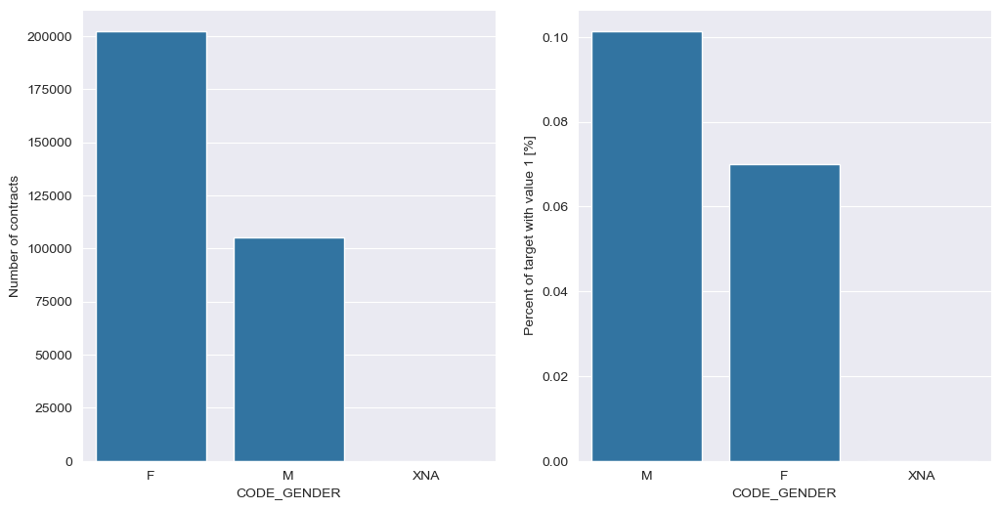

In [61]:
plot_stats('CODE_GENDER')

## Observation des Types de Prêts par Genre

 - L'image montre deux graphiques à barres comparant les contrats de prêts et le pourcentage de défauts par genre (CODE_GENDER).

    Graphique de gauche :

        Nombre de contrats :

            F (Femmes) : Environ 200 000 contrats.

            M (Hommes) : Environ 100 000 contrats.

            XNA : Aucun contrat.

* Observation :

 Il y a une différence significative dans le nombre de contrats entre les femmes et les hommes, les femmes ayant deux fois plus de contrats que les hommes.

* Graphique de droite :

Pourcentage de défauts (TARGET = 1) :

* M (Hommes) : Près de 10%.

* F (Femmes) : Près de 7%.

 * Observation :

Le pourcentage de défauts est plus élevé pour les hommes par rapport aux femmes.

* Conclusion

   * Prévalence des Contrats par Genre :

- Les femmes ont signé plus de contrats de prêts que les hommes, ce qui pourrait indiquer une plus grande propension des femmes à souscrire des prêts.

  * Taux de Défaut par Genre :

- Le taux de défaut (TARGET = 1) est plus élevé chez les hommes que chez les femmes, ce qui pourrait suggérer que les hommes ont un risque légèrement plus élevé de ne pas rembourser leurs prêts.

* En résumé, bien que les femmes contractent plus de prêts, les hommes présentent un taux de défaut plus élevé.

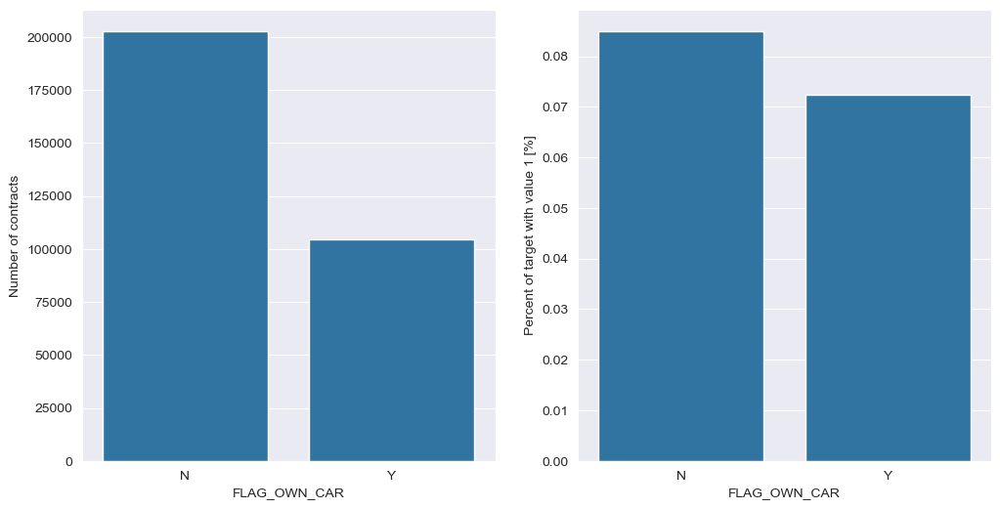

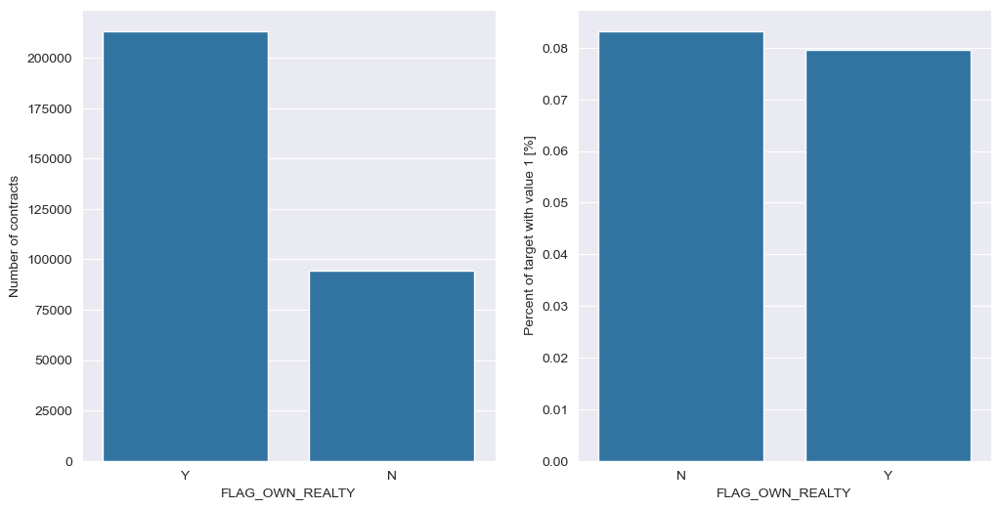

In [62]:
plot_stats('FLAG_OWN_CAR')
plot_stats('FLAG_OWN_REALTY')

Les deux graphiques à barres comparant le nombre de contrats et le pourcentage de prêts non remboursés (TARGET = 1) en fonction de la possession d'une voiture (FLAG_OWN_CAR).
Observations

   * Nombre de Contrats :

       - Sans Voiture (N) :
           Plus de 200 000 contrats.

       - Avec Voiture (Y) :
            Environ 100 000 contrats.

### Observation : 

Le nombre de contrats pour les individus sans voiture est significativement plus élevé que pour ceux avec une voiture.

   * Pourcentage de Prêts Non Remboursés (TARGET = 1) :

       - Sans Voiture (N) :

            Environ 0,08%.

       - Avec Voiture (Y) :

            Environ 0,07%.

### Observation :
Le pourcentage de prêts non remboursés est légèrement plus élevé pour les individus sans voiture.

### Conclusion

   * Possession de Voiture et Contrats :

        Les individus sans voiture sont plus susceptibles d'avoir des contrats. Cela peut être dû à diverses raisons socio-économiques.

   * Possession de Voiture et Taux de Défaut :

        Le fait de ne pas posséder une voiture est associé à un taux de défaut légèrement plus élevé, bien que la différence soit minime. Cela pourrait indiquer que la possession d'une voiture est légèrement liée à une meilleure solvabilité ou à une moindre probabilité de défaut de paiement.

En résumé, bien que les individus sans voiture aient plus de contrats, ils présentent également un taux de défaut légèrement plus élevé.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:24: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:29: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



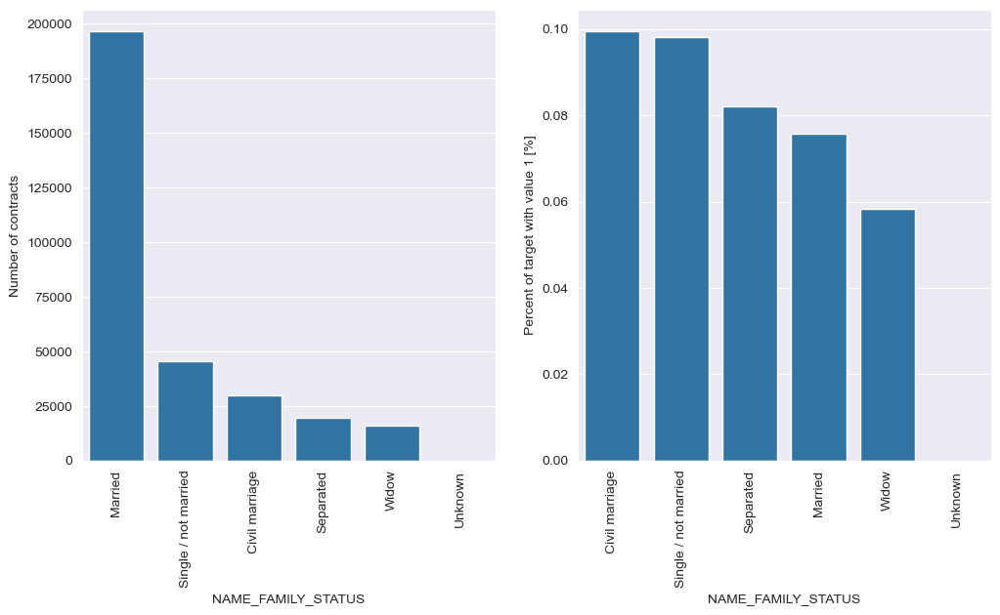

In [63]:
plot_stats('NAME_FAMILY_STATUS',True, True)

###  comparisont de nombre de contrats et de pourcentage de prêts non remboursés (TARGET = 1) en fonction du statut familial (NAME_FAMILY_STATUS).

## Observations

   * Nombre de Contrats :

Marié :Le nombre de contrats le plus élevé.

Célibataire / non marié : Deuxième nombre de contrats le plus élevé.

Mariage civil : Troisième nombre de contrats le plus élevé.

Séparé :Nombre de contrats plus faible.

Veuf :Nombre de contrats encore plus faible.


   * Pourcentage de Prêts Non Remboursés (TARGET = 1) :

 Mariage civil :Pourcentage le plus élevé.

Célibataire / non marié :Deuxième pourcentage le plus élevé.

Séparé :Troisième pourcentage le plus élevé.

Marié : Pourcentage plus faible.

Veuf :Pourcentage encore plus faible.


### Conclusion

   * Statut Familial et Nombre de Contrats :

       - Les individus mariés ont le plus grand nombre de contrats, suivis par les célibataires et ceux en mariage civil. Les séparés et les veufs ont moins de contrats, avec le nombre le plus faible pour les statuts familiaux inconnus.

   * Statut Familial et Taux de Défaut :

       - Les individus en mariage civil et les célibataires présentent des pourcentages plus élevés de prêts non remboursés (TARGET = 1). Les mariés et les veufs ont des pourcentages de défaut plus faibles, indiquant une meilleure solvabilité relative.

En résumé, les individus mariés sont plus nombreux à contracter des prêts, mais présentent un taux de défaut plus faible. Les personnes en mariage civil et les célibataires ont un taux de défaut plus élevé. 

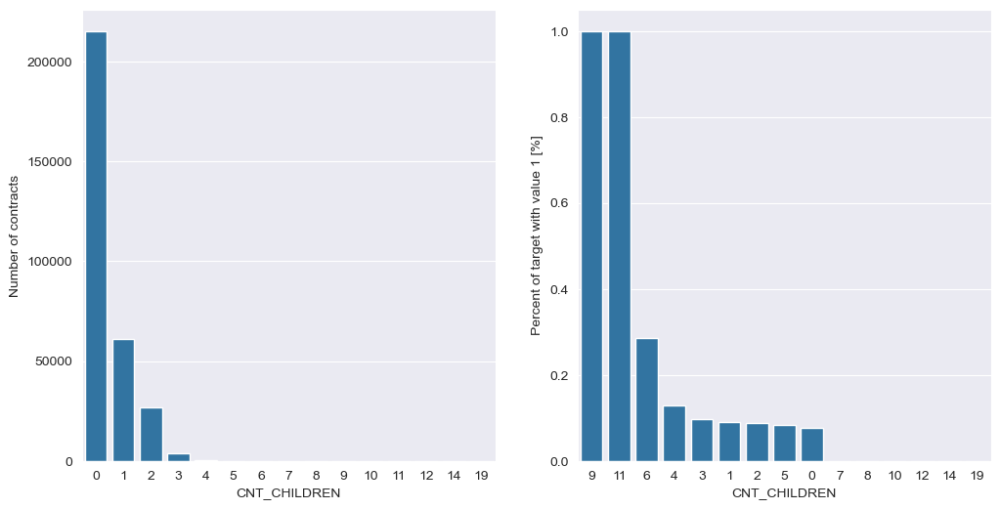

In [64]:
plot_stats('CNT_CHILDREN')

### Observation
 la relation entre le nombre d'enfants (CNT_CHILDREN) et le nombre de contrats, ainsi que le pourcentage de prêts non remboursés (TARGET = 1) en fonction du nombre d'enfants.
Observations

   * Nombre de Contrats :

       - La majorité des contrats sont pour des individus avec 0 enfant, suivis par ceux ayant 1, 2 enfants, et ainsi de suite.

       - Le nombre de contrats diminue de manière significative à mesure que le nombre d'enfants augmente.

   * Pourcentage de Prêts Non Remboursés (TARGET = 1) :

       - Les pourcentages les plus élevés de prêts non remboursés sont observés pour les individus ayant 9 et 11 enfants.

       - Des pourcentages relativement élevés sont également observés pour les individus avec 6, 4, 3, 1, 2 et 5 enfants.

## Conclusion

   * Nombre de Contrats :

       - Les individus avec peu ou pas d'enfants (0 à 2 enfants) ont tendance à contracter plus de prêts. Cela pourrait indiquer une plus grande propension ou capacité à emprunter pour ces groupes.

   * Taux de Défaut :

       - Un nombre élevé d'enfants semble corréler avec un taux de défaut plus élevé. En particulier, les individus avec 9 et 11 enfants présentent les pourcentages les plus élevés de prêts non remboursés. Cela pourrait suggérer que les charges financières augmentent avec le nombre d'enfants, affectant la capacité à rembourser les prêts.

En résumé, les individus avec peu ou pas d'enfants sont plus nombreux à contracter des prêts, tandis que ceux avec de nombreux enfants présentent des taux de défaut plus élevés. 

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:24: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:29: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



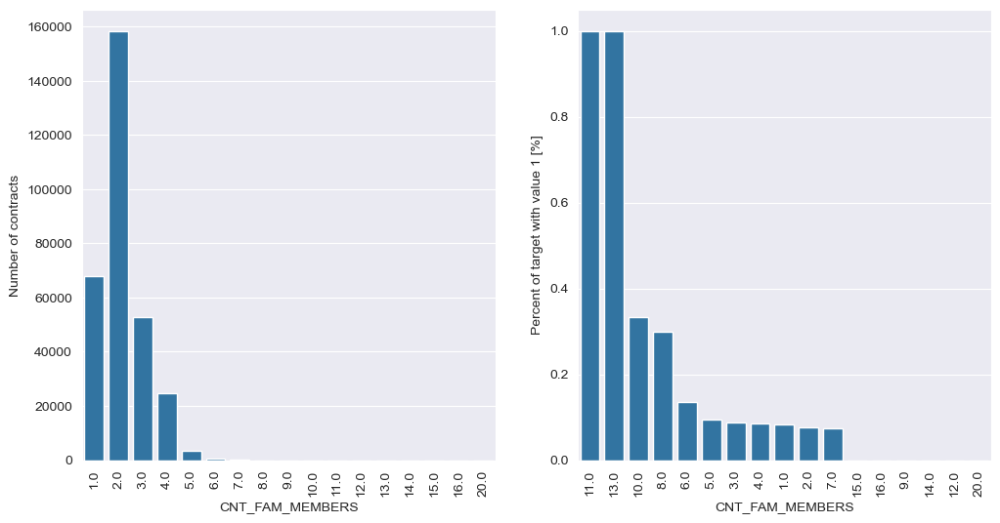

In [65]:
plot_stats('CNT_FAM_MEMBERS',True)

la relation entre le nombre de membres de la famille (CNT_FAM_MEMBERS) et le nombre de contrats, ainsi que le pourcentage de prêts non remboursés (TARGET = 1).
Observations

   * Nombre de Contrats :

       - La majorité des contrats sont pour des familles avec 1, 2 ou 3 membres, avec une diminution significative du nombre de contrats pour des familles plus grandes.

   * Pourcentage de Prêts Non Remboursés (TARGET = 1) :

       - Les pourcentages les plus élevés de prêts non remboursés sont observés pour les familles avec 1, 10 et 13 membres, avec une tendance décroissante pour les autres tailles de famille.

### Conclusion

   * Nombre de Contrats :

       - Les familles avec 1 à 3 membres contractent plus de prêts. Cela pourrait indiquer une plus grande propension ou capacité à emprunter pour ces groupes.

   * Taux de Défaut :

       - Les familles avec 1, 10 et 13 membres présentent des taux de défaut plus élevés, suggérant que certaines tailles de famille peuvent avoir un risque accru de défaut de paiement.

En résumé, les familles avec 1 à 3 membres contractent plus de prêts, tandis que celles avec 1, 10 et 13 membres présentent des taux de défaut plus élevés. 

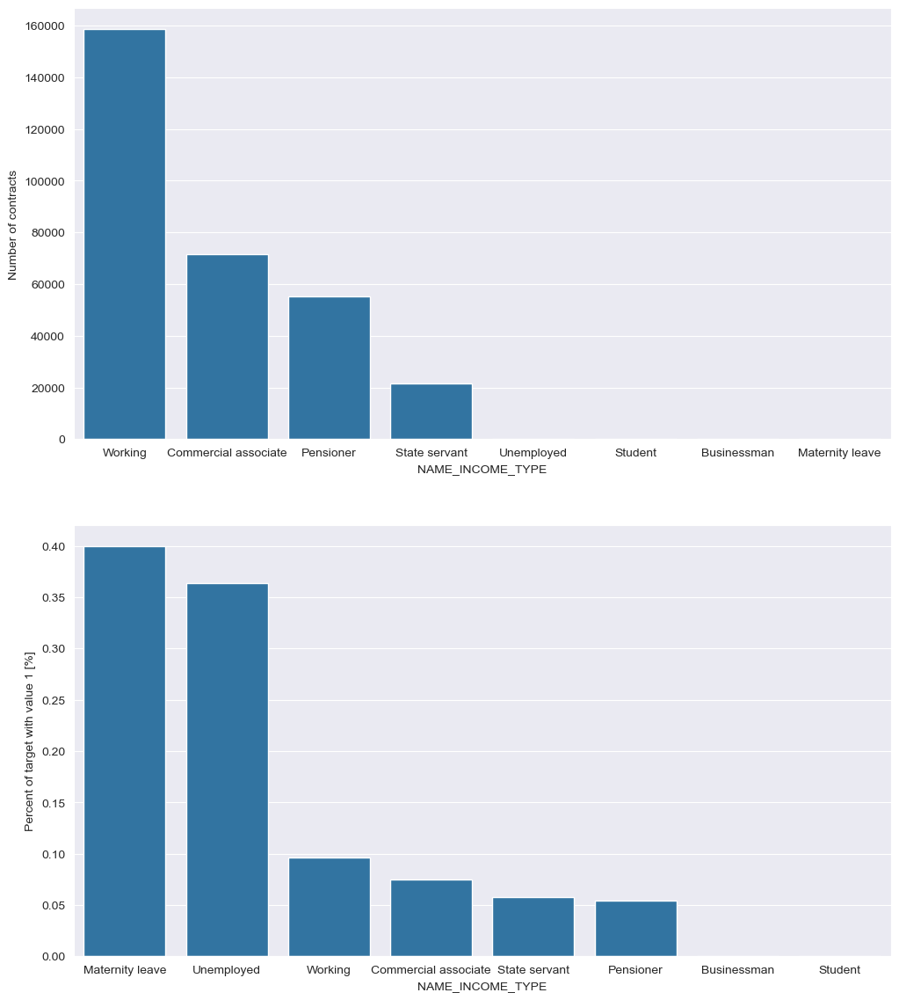

In [66]:
plot_stats('NAME_INCOME_TYPE',False,False)

Observation des Types de Revenus

L'image présente deux graphiques à barres comparant le nombre de contrats et le pourcentage de défauts par type de revenu (NAME_INCOME_TYPE).
Observations

   * Nombre de Contrats :
Travailleur :Environ 160 000 contrats.

Associé commercial :Environ 80 000 contrats.

Retraité :Environ 60 000 contrats.

Fonctionnaire :Environ 20 000 contrats.

Chômeur, Étudiant, Homme d'affaires, Congé maternité :

Nombre de contrats très bas, proche de 0.

### Observation :

            Les travailleurs ont le plus grand nombre de contrats, suivis par les associés commerciaux, les retraités et les fonctionnaires. Les autres catégories ont des nombres de contrats beaucoup plus bas.

   * Pourcentage de Prêts Non Remboursés (TARGET = 1) :

Congé maternité :Environ 0,40%.

Chômeur :Environ 0,35%.

Travailleur :Environ 0,10%.

Associé commercial :Environ 0,07%.

Fonctionnaire :Environ 0,06%.

Retraité :Environ 0,05%.

Homme d'affaires, Étudiant :Pourcentages très proches de 0.

### Observation :

            Les personnes en congé maternité et les chômeurs ont les pourcentages de défaut les plus élevés, tandis que les retraités, les fonctionnaires et les associés commerciaux ont les pourcentages de défaut les plus bas.

### Conclusion

   * Type de Revenu et Nombre de Contrats :

       - Les travailleurs, les associés commerciaux et les retraités contractent le plus de prêts. Les autres types de revenus ont des nombres de contrats beaucoup plus bas.

   * Type de Revenu et Taux de Défaut :

       - Les personnes en congé maternité et les chômeurs présentent des taux de défaut plus élevés, suggérant une plus grande probabilité de défaut de paiement dans ces groupes. Les retraités, les fonctionnaires et les associés commerciaux ont des taux de défaut plus bas, indiquant une meilleure solvabilité.

En résumé, les travailleurs, les associés commerciaux et les retraités contractent plus de prêts, tandis que les personnes en congé maternité et les chômeurs présentent des taux de défaut plus élevés. 

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:24: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:29: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



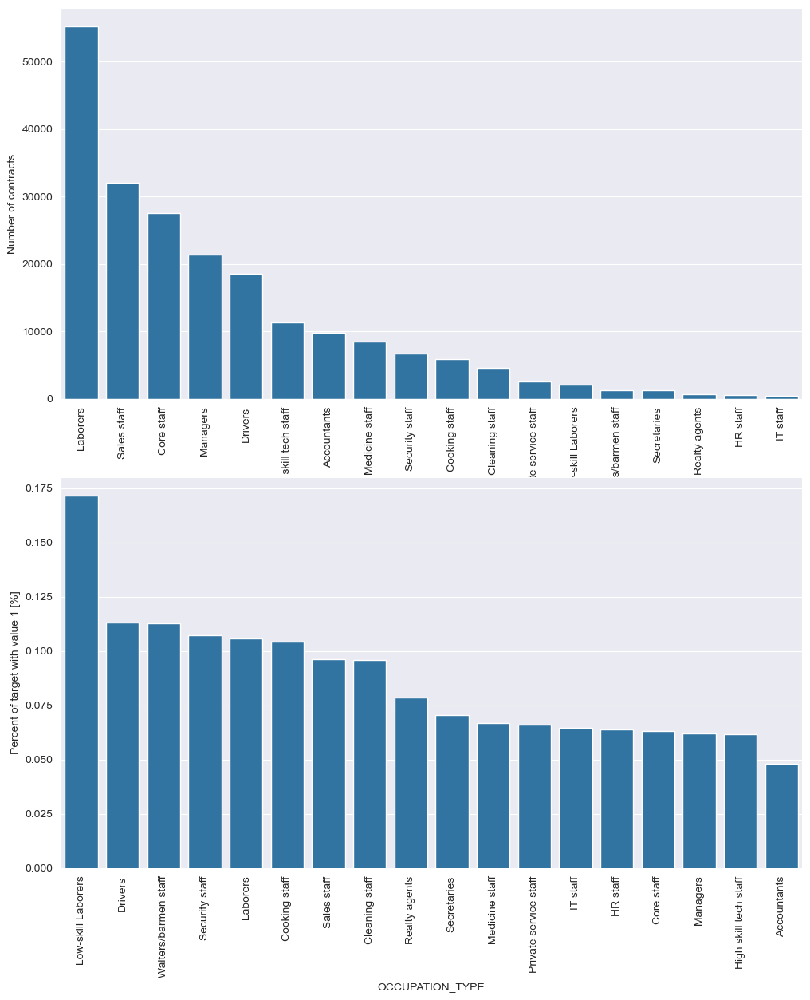

In [67]:
plot_stats('OCCUPATION_TYPE',True, False)

## Observations

   * Nombre de Contrats :

Ouvriers (Laborers) : Le nombre le plus élevé de contrats.

Personnel de vente (Sales staff) : Deuxième nombre de contrats le plus élevé.

Personnel de base (Core staff) : Troisième nombre de contrats le plus élevé.

Drivers, Skill tech staff, Accountants : Nombre de contrats notable mais moins élevé.

Autres catégories : Nombre de contrats décroissant, avec les "HR staff" et "IT staff" ayant le plus bas.

   * Pourcentage de Prêts Non Remboursés (TARGET = 1) :

Ouvriers non qualifiés (Low-skill Laborers) : Pourcentage le plus élevé de défauts de paiement.

Drivers et Serveurs/barmen (Waiters/barmen staff) : Pourcentages élevés de défauts de paiement.

Autres catégories : Pourcentages de défaut plus faibles, avec certaines professions telles que "Realty agents" et "IT staff" ayant les pourcentages les plus bas.

### Conclusion

   * Type d'Occupation et Nombre de Contrats :

       - Les ouvriers, le personnel de vente et le personnel de base contractent le plus grand nombre de prêts. Ces groupes peuvent avoir une demande de crédit plus élevée ou être plus susceptibles de se qualifier pour des prêts.

   * Type d'Occupation et Taux de Défaut :

       - Les ouvriers non qualifiés, les conducteurs et les serveurs présentent des taux de défaut de paiement plus élevés. Cela pourrait indiquer une instabilité financière plus élevée ou des difficultés accrues à rembourser des prêts dans ces groupes professionnels.

En résumé, les ouvriers, le personnel de vente et le personnel de base contractent le plus de prêts, tandis que les ouvriers non qualifiés, les conducteurs et les serveurs présentent des taux de défaut plus élevés. 

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:24: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:29: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



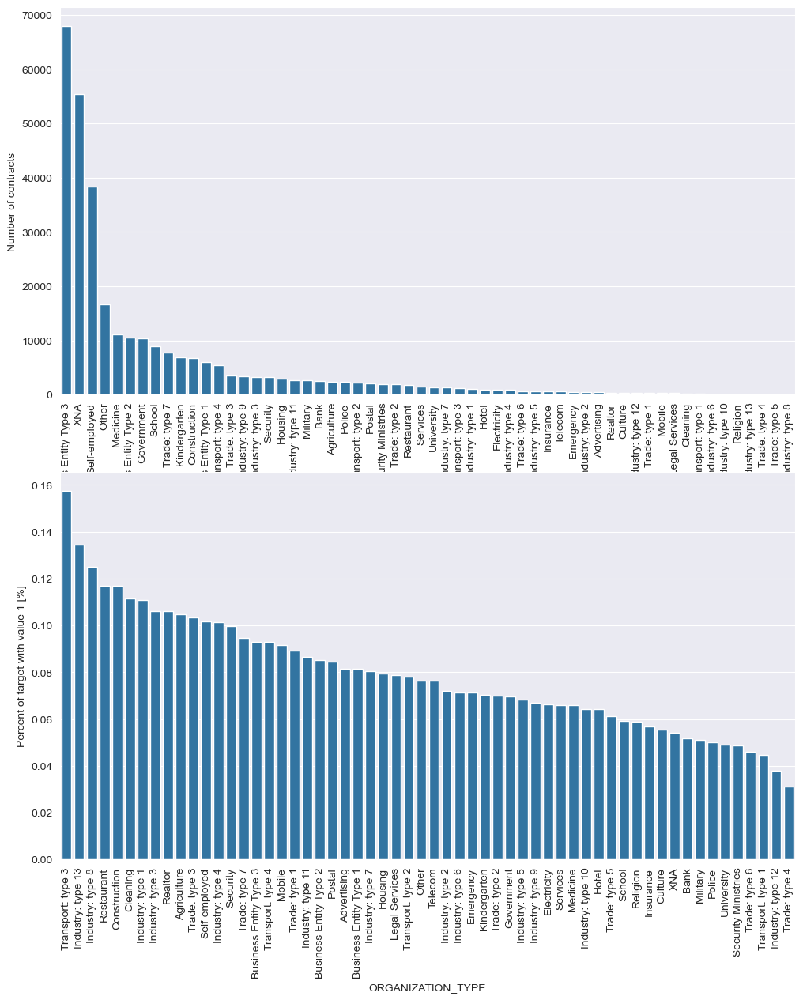

In [68]:
plot_stats('ORGANIZATION_TYPE',True, False)

Observations

   * Nombre de Contrats :

Entity Type 3 : Le nombre le plus élevé de contrats.

Self-employed (Travailleur indépendant) : Deuxième nombre de contrats le plus élevé.

Autres (Others) : Troisième nombre de contrats le plus élevé.

Autres catégories : Nombre de contrats décroissant en fonction des types d'organisation.

   * Pourcentage de Prêts Non Remboursés (TARGET = 1) :

Transport: type 3 : Pourcentage le plus élevé de défauts de paiement.

Industry: type 13 : Deuxième pourcentage de défaut le plus élevé.

Industry: type 8 : Troisième pourcentage de défaut le plus élevé.

 Autres catégories : Pourcentages de défauts plus faibles, décroissants en fonction des types d'organisation.

### Conclusion

   * Type d'Organisation et Nombre de Contrats :

       - Les organisations de type "Entity Type 3", les travailleurs indépendants et les autres organisations contractent le plus grand nombre de prêts. Cela peut indiquer une plus grande propension ou capacité à emprunter pour ces groupes.

   * Type d'Organisation et Taux de Défaut :

       - Les types d'organisation "Transport: type 3", "Industry: type 13" et "Industry: type 8" présentent des taux de défaut de paiement plus élevés. Cela pourrait indiquer une instabilité financière plus élevée ou des difficultés accrues à rembourser des prêts dans ces groupes professionnels.

En résumé, les organisations de type "Entity Type 3", les travailleurs indépendants et les autres organisations contractent le plus grand nombre de prêts, tandis que les types d'organisation "Transport: type 3", "Industry: type 13" et "Industry: type 8" présentent des taux de défaut plus élevés.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:24: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:29: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



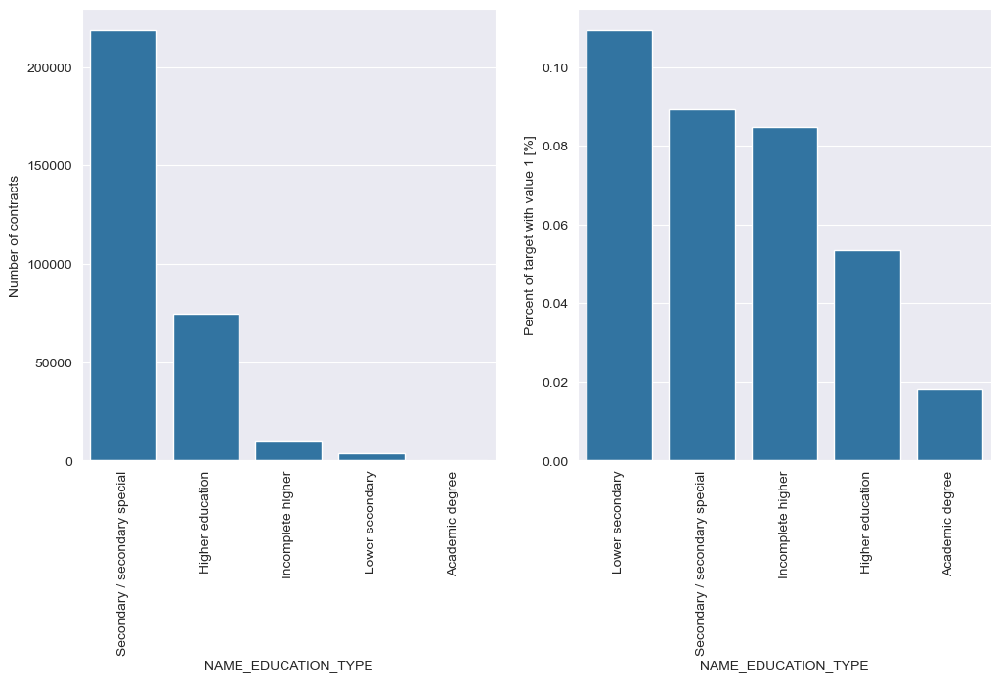

In [69]:
plot_stats('NAME_EDUCATION_TYPE',True)

## Observation

   * Type d'Éducation et Nombre de Contrats :

        - Les individus ayant une éducation secondaire ou secondaire spéciale contractent le plus grand nombre de prêts, suivis par ceux ayant une éducation supérieure. Les autres types d'éducation ont des nombres de contrats beaucoup plus bas.

   * Type d'Éducation et Taux de Défaut :

       - Les individus ayant une éducation secondaire inférieure présentent les taux de défaut les plus élevés, suivis par ceux ayant une éducation secondaire / secondaire spéciale. Les individus avec un diplôme académique ont les taux de défaut les plus bas, suggérant une meilleure solvabilité.

En résumé, les individus ayant une éducation secondaire contractent plus de prêts, tandis que ceux avec une éducation secondaire inférieure présentent des taux de défaut plus élevés. Les individus avec un diplôme académique ont les taux de défaut les plus bas. 

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:24: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3623580445.py:29: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



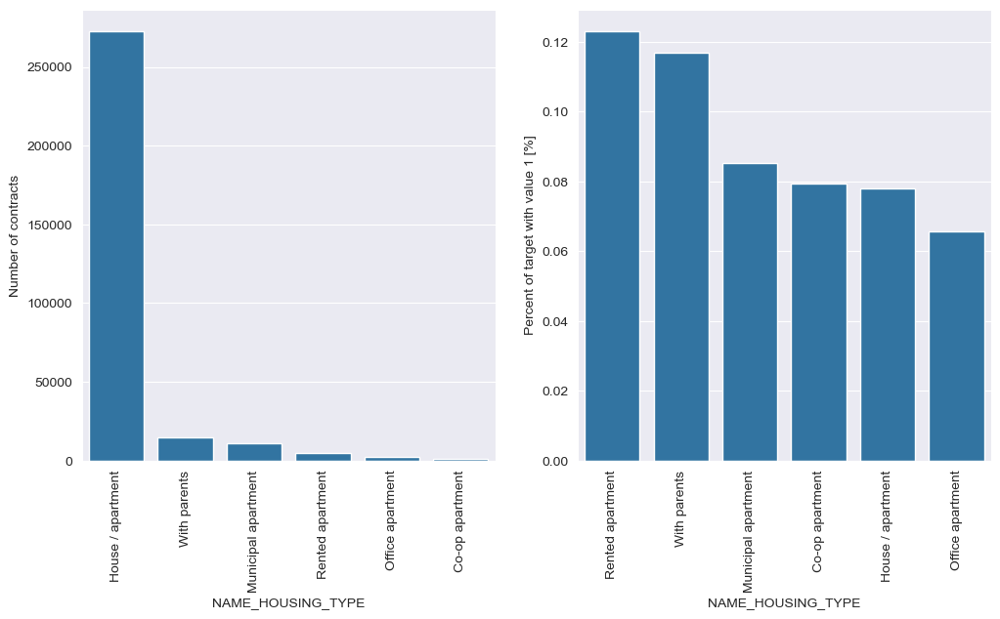

In [70]:
plot_stats('NAME_HOUSING_TYPE',True)

* Type de Logement et Nombre de Contrats :

  - Les individus vivant dans des maisons ou des appartements contractent le plus grand nombre de prêts. Les autres types de logements ont des nombres de contrats beaucoup plus bas.

* Type de Logement et Taux de Défaut :

    - Les individus vivant dans des appartements loués et avec leurs parents présentent les pourcentages de défaut les plus élevés. Cela pourrait suggérer une plus grande instabilité financière ou une capacité réduite à rembourser les prêts dans ces groupes.

En résumé, les individus vivant dans des maisons ou des appartements contractent plus de prêts, tandis que ceux vivant dans des appartements loués et avec leurs parents présentent des taux de défaut plus élevés. 

In [71]:
# Fonction pour tracer la distribution d'une variable
def plot_distribution(feature, color):
    """
    Cette fonction trace l'histogramme et la courbe de densité pour une variable donnée.

    Paramètres :
        - feature (str) : Le nom de la colonne à tracer.
        - color (str) : La couleur des barres et de la courbe.
    """
    plt.figure(figsize=(10, 6))  # Définir la taille de la figure
    plt.title(f"Distribution de {feature}")  # Titre du graphique
    sns.histplot(application_train[feature].dropna(), color=color, kde=True, bins=100)  # Histogramme avec densité
    plt.xlabel(feature, fontsize=12)  # Étiquette pour l'axe X
    plt.ylabel("Fréquence", fontsize=12)  # Étiquette pour l'axe Y
    plt.show()


In [72]:
# Fonction pour tracer les distributions de plusieurs variables avec la distinction TARGET = 1/0
def plot_distribution_comp(var, nrow=2):
    """
    Cette fonction trace des graphiques de densité pour plusieurs variables avec la distinction
    entre les cibles TARGET = 1 et TARGET = 0.

    Paramètres :
        - var (list) : Liste des noms de colonnes à tracer.
        - nrow (int) : Nombre de lignes dans la disposition des sous-graphiques.

    Retour :
        - Affiche les graphiques de densité.
    """
    t1 = application_train.loc[application_train['TARGET'] != 0]  # Sous-ensemble pour TARGET = 1
    t0 = application_train.loc[application_train['TARGET'] == 0]  # Sous-ensemble pour TARGET = 0

    # Définir le style des graphiques
    sns.set_style('whitegrid')

    # Initialisation des sous-graphiques
    fig, ax = plt.subplots(nrow, 2, figsize=(12, 6 * nrow))  # Dimensions de la figure
    ax = ax.flatten()  # Aplatir pour un accès facile aux axes

    for i, feature in enumerate(var):
        if i >= len(ax):
            break  # Arrêter si le nombre de graphiques dépasse le nombre de sous-graphiques disponibles
        sns.kdeplot(data=t1, x=feature, label="TARGET = 1", ax=ax[i], fill=True, alpha=0.6, color="blue")
        sns.kdeplot(data=t0, x=feature, label="TARGET = 0", ax=ax[i], fill=True, alpha=0.6, color="orange")
        ax[i].set_title(f"Distribution de {feature}", fontsize=14)  # Titre pour chaque graphique
        ax[i].set_xlabel(feature, fontsize=12)  # Étiquette de l'axe X
        ax[i].set_ylabel("Densité", fontsize=12)  # Étiquette de l'axe Y
        ax[i].legend(loc='best', fontsize=10)  # Légende

    # Ajuster les espacements
    plt.tight_layout()
    plt.show()


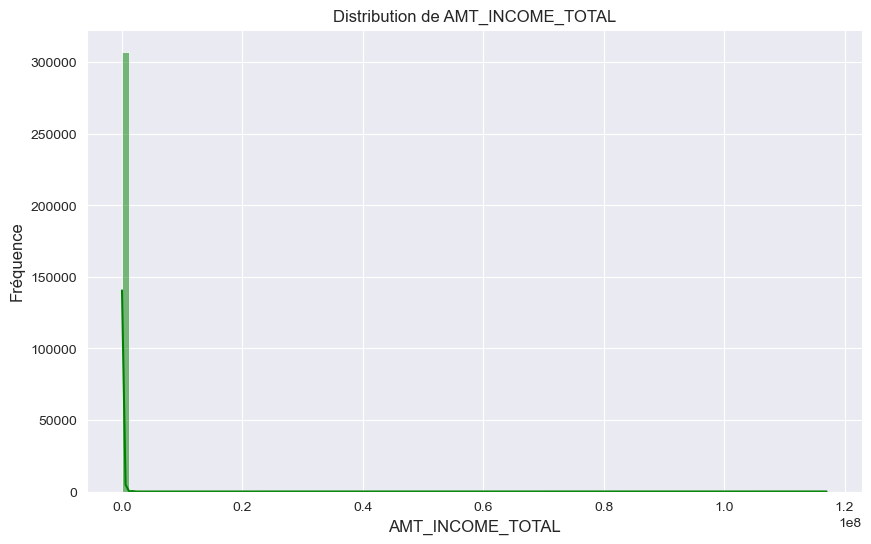

In [73]:
plot_distribution('AMT_INCOME_TOTAL','green')

## Distribution de MONTANT_TOTAL_REVENUS


### Observation
* L'histogramme montre que la plupart des valeurs de MONTANT_TOTAL_REVENUS sont concentrées dans la partie inférieure de l'échelle des revenus.

* L'axe des x représente les valeurs de MONTANT_TOTAL_REVENUS, allant de 0 à 120 000 000, et l'axe des y représente la fréquence de ces valeurs, allant de 0 à 300 000.

* La majorité des données se trouvent près de 0, avec une fréquence très élevée, puis diminue rapidement à mesure que le montant des revenus augmente.

### Conclusion

 * La distribution est fortement biaisée avec la majorité des individus ayant des montants de revenus relativement faibles.

## Distribution de MONTANT_DU_CRÉDIT

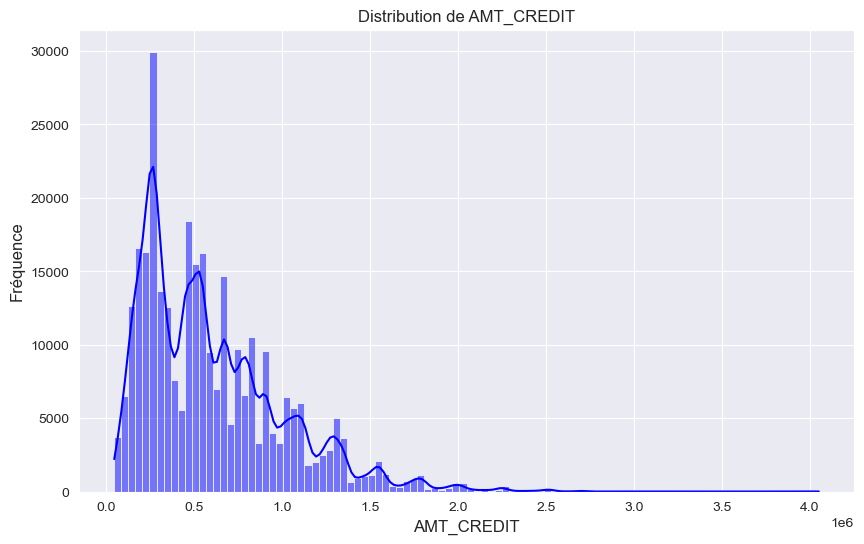

In [74]:
plot_distribution('AMT_CREDIT','blue')

### Observation

- La distribution de MONTANT_DU_CRÉDIT montre que la plupart des montants de crédits sont concentrés dans des valeurs plus basses.

- L'axe des x représente le montant du crédit (MONTANT_DU_CRÉDIT) en notation scientifique (allant de 0 à 4.0 x 10^6), et l'axe des y représente la fréquence (Fréquence) des occurrences.

- Le graphique est un histogramme avec des barres bleues et une ligne bleue représentant l'estimation de la densité de la distribution.

### Conclusion    
   - La majorité des montants de crédit sont concentrés vers des valeurs plus faibles, avec un pic autour de 0,5 x 10^6.
 - La fréquence diminue à mesure que le montant du crédit augmente. Cela pourrait indiquer que les montants de crédit plus élevés sont moins courants dans la population étudiée.

## Distribution de MONTANT_ANNUITÉ

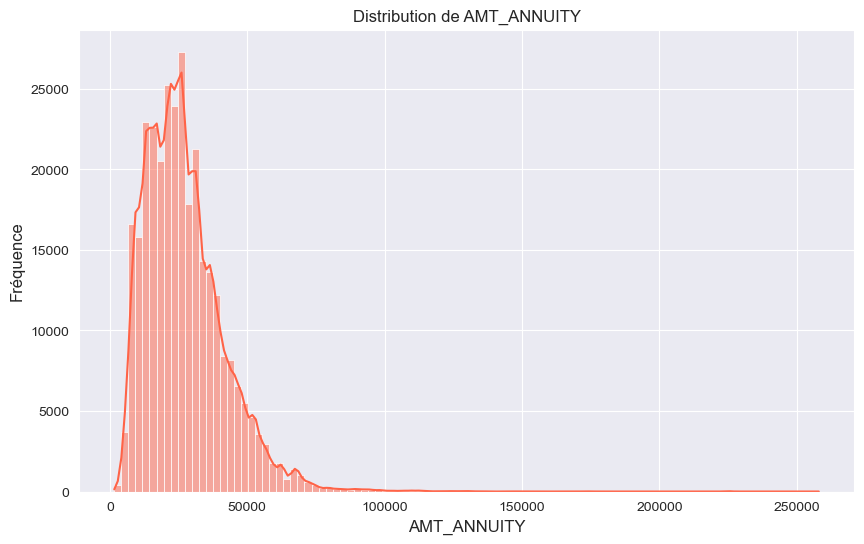

In [75]:
plot_distribution('AMT_ANNUITY','tomato')

### Observation
- La majorité des montants des annuités sont concentrés entre 0 et 50 000, avec un pic de fréquence autour de 25 000.

- La fréquence diminue significativement à mesure que le montant de l'annuité augmente, avec très peu de valeurs dépassant 100 000.

- La distribution présente une longue traîne vers des montants d'annuités plus élevés, atteignant jusqu'à 250 000.

### Conclusion
*  La plupart des emprunteurs ont des annuités relativement basses, ce qui pourrait suggérer une préférence ou une capacité limitée à s'engager dans des paiements annuels plus élevés.

*  Les montants des annuités plus élevés sont rares et pourraient indiquer un risque accru ou des profils financiers particuliers nécessitant des analyses supplémentaires.

## Distribution de PRIX_DES_BIENS

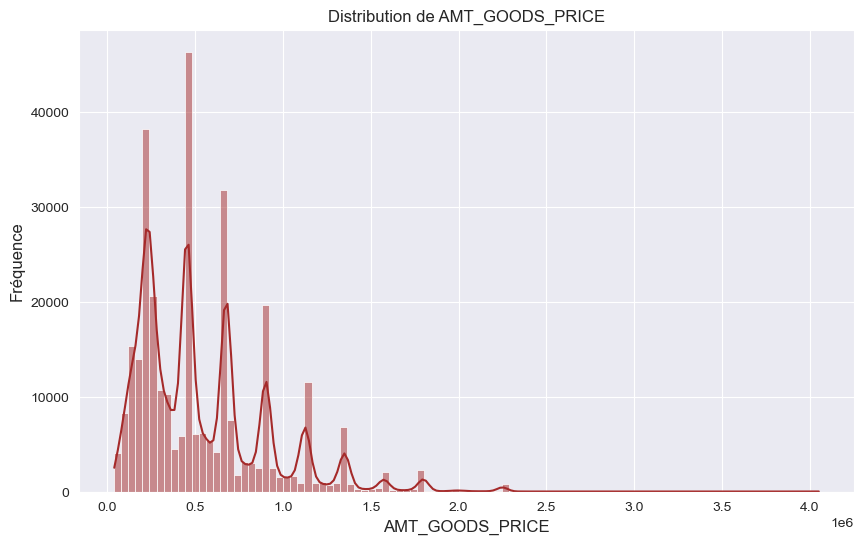

In [76]:
plot_distribution('AMT_GOODS_PRICE','brown')

### Observation

* La distribution de PRIX_DES_BIENS est asymétrique à droite avec la plupart des données concentrées sur le côté gauche du graphique, indiquant que les valeurs plus basses de PRIX_DES_BIENS sont plus fréquentes.

     - L'axe des x est étiqueté PRIX_DES_BIENS et s'étend de 0 à 4 000 000 .

     - L'axe des y est étiqueté Fréquence et s'étend de 0 à 50 000.

### Conclusion
La majorité des prix des biens sont inférieurs à 1 000 000. Cette distribution pourrait indiquer une préférence ou une tendance à acheter des biens moins chers dans l'ensemble de données.

##  Distribution de DAYS_BIRTH

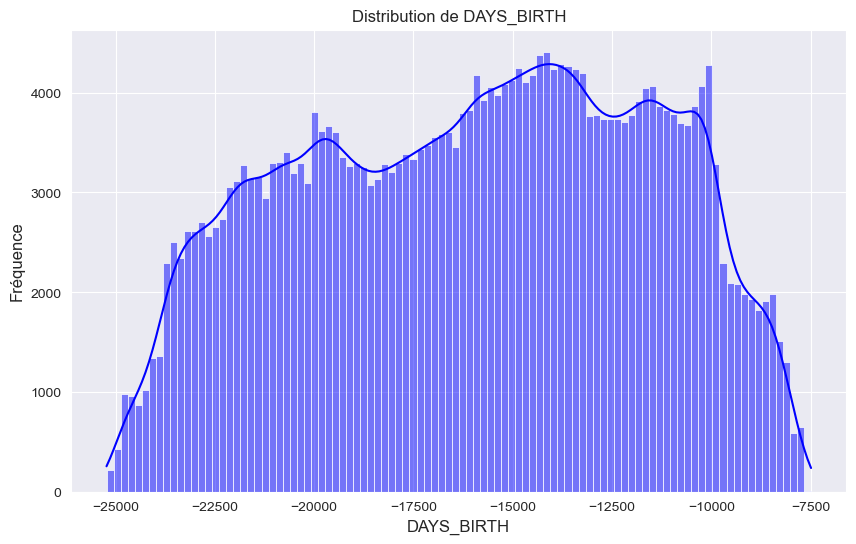

In [77]:
plot_distribution('DAYS_BIRTH','blue')

### Observation
 - La distribution de DAYS_BIRTH (jours depuis la naissance) est approximativement unimodale avec un pic autour de -15 000 jours.

  - La fréquence de DAYS_BIRTH augmente de -25 000 jours, atteint un pic autour de -15 000 jours, puis diminue vers -7 500 jours.

### Conclusion
* La distribution indique une concentration plus élevée d'individus ayant un âge autour de 41 ans (environ -15 000 jours). La plupart des individus dans cet ensemble de données sont d'âge moyen.

## Distribution de JOURS_EMPLOYÉ

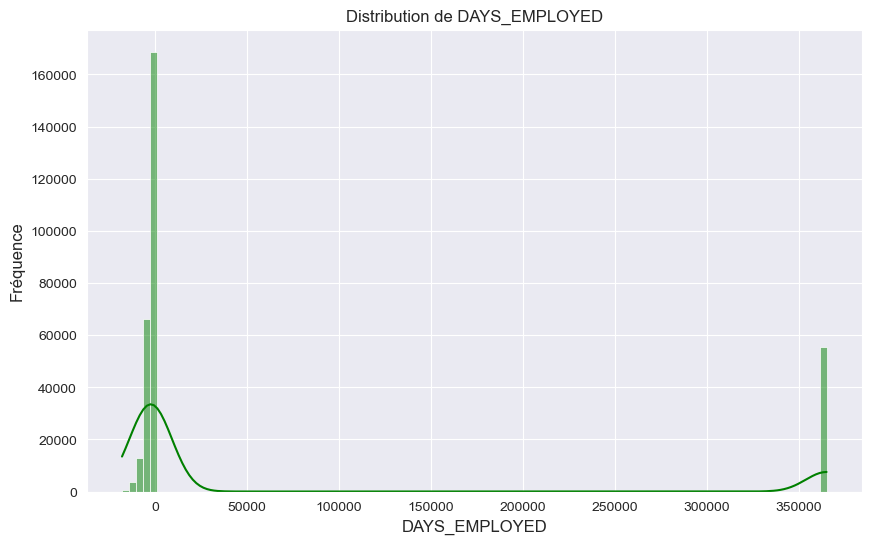

In [78]:
plot_distribution('DAYS_EMPLOYED','green')

### Observation

   * Distribution :

       - La distribution de JOURS_EMPLOYÉ montre un pic important près de zéro jours employés, indiquant une fréquence élevée d'individus ayant très peu de jours d'emploi.

       - Un pic significatif autour de 365 000 jours employés, probablement une erreur de saisie ou un outlier, car ce nombre est irréaliste.

### Conclusion
   * Le pic à zéro jours employés pourrait suggérer une instabilité dans l'emploi pour de nombreux individus, ce qui pourrait influencer leur capacité à rembourser des prêts.

   * Le pic à 365 000 jours est probablement un outlier ou une erreur de saisie et devrait être traité lors de l'analyse des données pour éviter des biais.

## Distribution de DAYS_REGISTRATION

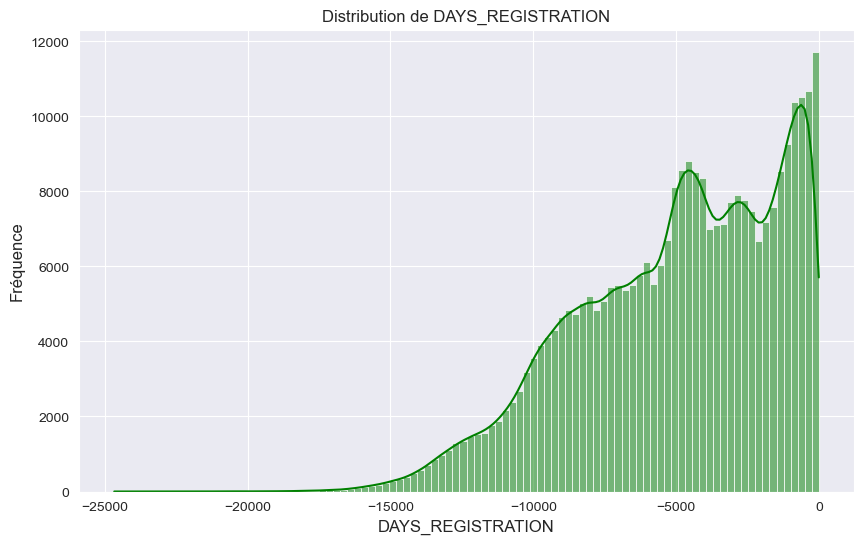

In [79]:
plot_distribution('DAYS_REGISTRATION','green')

### Observation

   * Distribution :

       - La distribution de DAYS_REGISTRATION est négativement asymétrique avec une concentration plus élevée de valeurs proches de 0.

        - La fréquence des valeurs varie de 0 à plus de 12000.

### Conclusion

 * La distribution montre une tendance à avoir plus d'enregistrements à mesure que l'on se rapproche du présent (0 sur l'axe des x). Cela indique que de nombreux enregistrements ont eu lieu plus récemment, suggérant peut-être une augmentation des activités d'enregistrement au fil du temps.

## la Distribution de DAYS_ID_PUBLISH

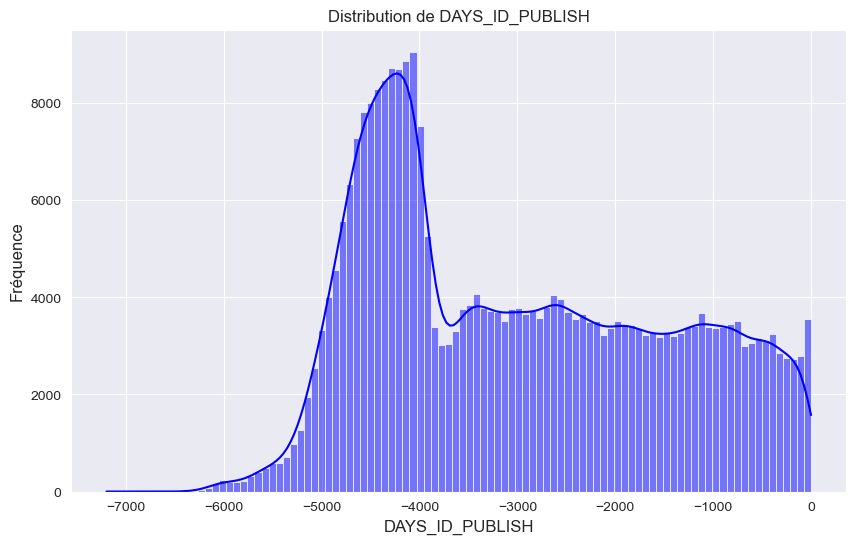

In [80]:
plot_distribution('DAYS_ID_PUBLISH','blue')

### Observation

   * Distribution :

       - La distribution de DAYS_ID_PUBLISH est bimodale avec deux pics significatifs : un autour de -5000 jours et un autre, plus petit, autour de -4000 jours.

       - La fréquence des valeurs varie de 0 à plus de 8000.

### Conclusion

   - Les deux pics dans la distribution de DAYS_ID_PUBLISH pourraient indiquer des périodes spécifiques où il y a eu une forte activité de mise à jour ou de publication des identifiants. Ces périodes pourraient correspondre à des événements réglementaires ou administratifs, ou à des pratiques de gestion courantes chez les emprunteurs.

   - La majorité des identifiants ont été publiés autour de ces deux périodes, ce qui pourrait influencer le comportement de remboursement des emprunteurs en fonction de la récence de leur publication d'ID.

## La distribution de diverses variables financières et démographiques pour deux groupes cibles différents (TARGET = 1 et TARGET = 0). Les variables sont :

    AMT_ANNUITY : Distribution des montants des annuités.

    AMT_GOODS_PRICE : Distribution des prix des biens.

    DAYS_EMPLOYED : Distribution des jours d'emploi.

    DAYS_REGISTRATION : Distribution des jours depuis l'enregistrement.

    DAYS_BIRTH : Distribution des jours depuis la naissance.

    DAYS_ID_PUBLISH : Distribution des jours depuis la publication de l'ID.

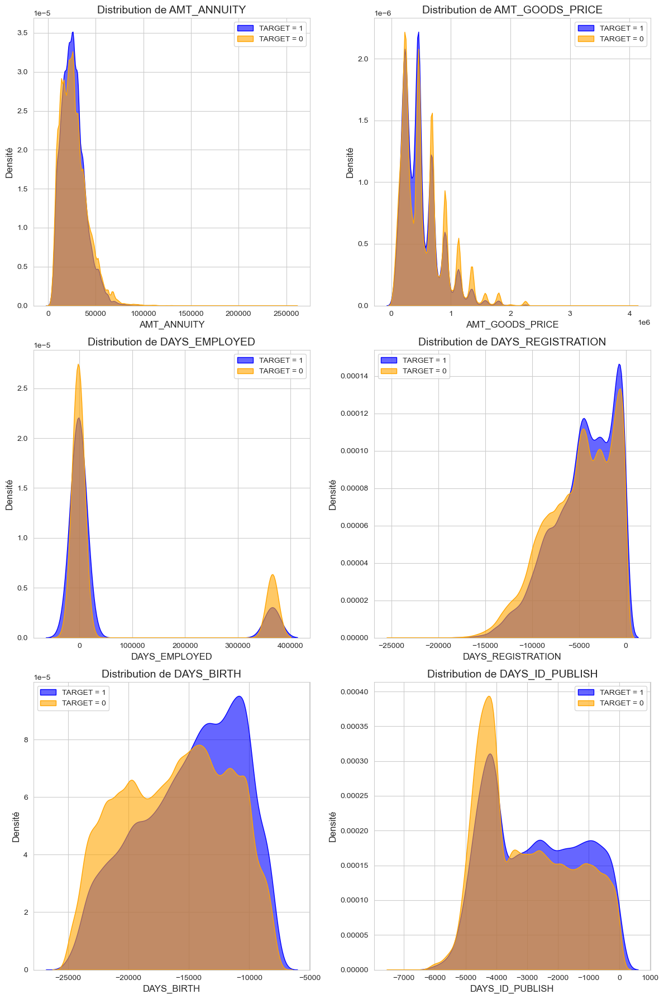

In [81]:
var = ['AMT_ANNUITY','AMT_GOODS_PRICE','DAYS_EMPLOYED', 'DAYS_REGISTRATION','DAYS_BIRTH','DAYS_ID_PUBLISH']
plot_distribution_comp(var,nrow=3)

Chaque graphique compare la densité de la variable pour TARGET = 1 (bleu) et TARGET = 0 (orange). L'axe des y représente la densité, et l'axe des x représente la valeur de la variable respective.
Observations

   - AMT_ANNUITY :La distribution est relativement similaire pour les deux groupes cibles, avec une densité légèrement plus élevée pour TARGET = 0 pour les montants d'annuités plus faibles.

   - AMT_GOODS_PRICE :La distribution montre une densité plus élevée pour TARGET = 0 pour les prix des biens plus bas, et TARGET = 1 montre une distribution plus dispersée avec des prix plus élevés.

   - DAYS_EMPLOYED :TARGET = 0 a une distribution plus cohérente, tandis que TARGET = 1 montre une densité plus élevée pour moins de jours d'emploi.

   - DAYS_REGISTRATION : Les distributions sont similaires, mais TARGET = 0 montre une densité plus élevée pour les dates d'enregistrement plus anciennes.

   - DAYS_BIRTH :Les deux distributions sont similaires, avec TARGET = 0 montrant une densité légèrement plus élevée pour les individus plus jeunes.

   - DAYS_ID_PUBLISH : TARGET = 0 a une densité plus élevée pour les dates de publication d'ID plus récentes par rapport à TARGET = 1.

### Conclusion

   * Stabilité financière : TARGET = 0 (prêts remboursés) montre généralement des densités plus élevées dans les catégories indiquant une meilleure stabilité financière (par exemple, une durée d'emploi plus longue, des dates de publication d'ID plus récentes).

   * Facteurs de risque : TARGET = 1 (prêts non remboursés) a des densités plus élevées dans les catégories pouvant indiquer un risque plus élevé (par exemple, moins de jours d'emploi, prix des biens dispersés).

## la Relation entre la Région de Résidence et la Région de Travail (REG_REGION_NOT_LIVE_REGION)

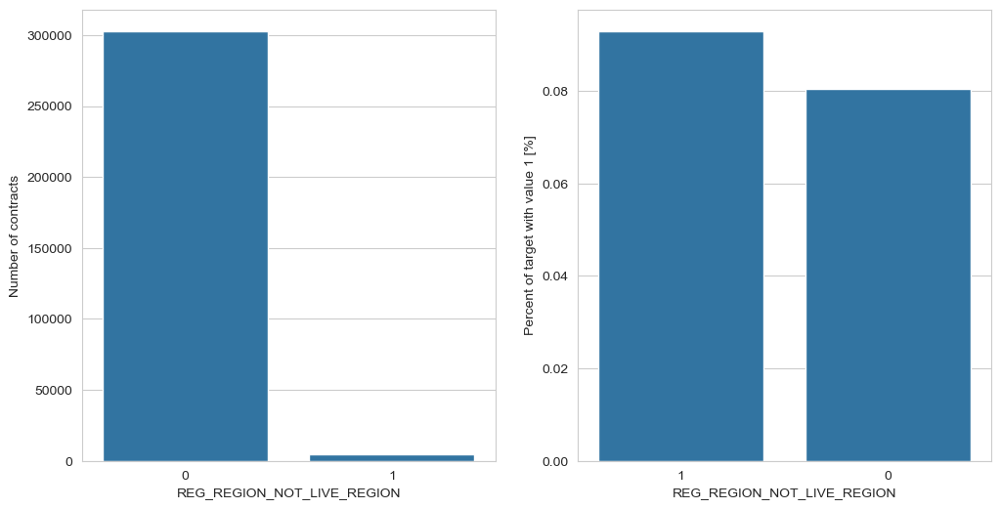

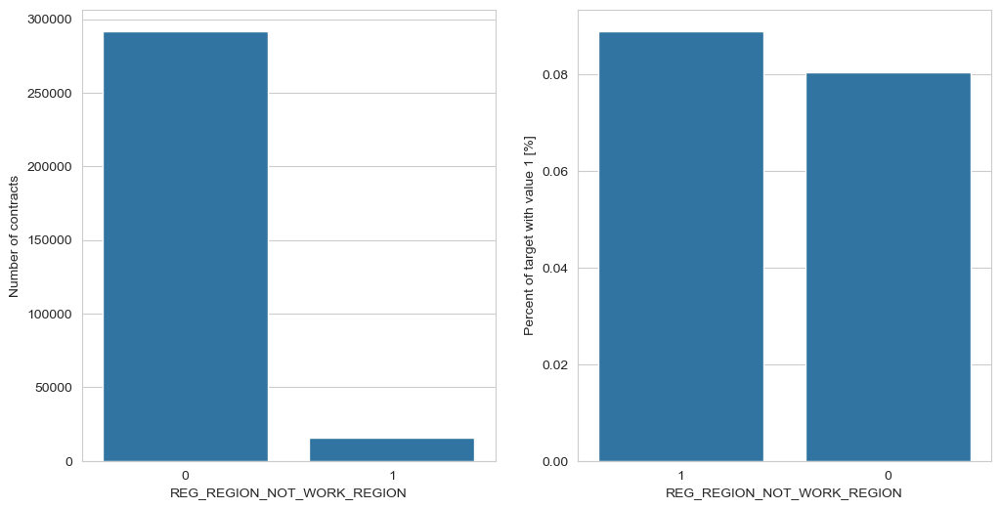

In [82]:
plot_stats('REG_REGION_NOT_LIVE_REGION')
plot_stats('REG_REGION_NOT_WORK_REGION')

   * Région de Résidence et Région de Travail et Nombre de Contrats :

       - Les individus dont la région de résidence est la même que la région de travail contractent significativement plus de prêts. Cela pourrait indiquer une plus grande stabilité ou facilité d'accès aux crédits pour ces individus.

   * Région de Résidence et Région de Travail et Taux de Défaut :

       - Les individus dont la région de résidence est différente de la région de travail présentent un pourcentage légèrement plus élevé de prêts non remboursés. Cela pourrait suggérer que le fait de travailler dans une région différente de celle de résidence est associé à des défis financiers accrus ou à une légère instabilité financière.

En résumé, les individus vivant et travaillant dans la même région contractent plus de prêts et ont un taux de défaut légèrement plus faible. Ceux dont la région de résidence diffère de la région de travail présentent un taux de défaut légèrement plus élevé.

 ### la relation entre le nombre de contrats et le pourcentage de prêts non remboursés (TARGET = 1) en fonction de la variable REG_CITY_NOT_WORK_CITY.

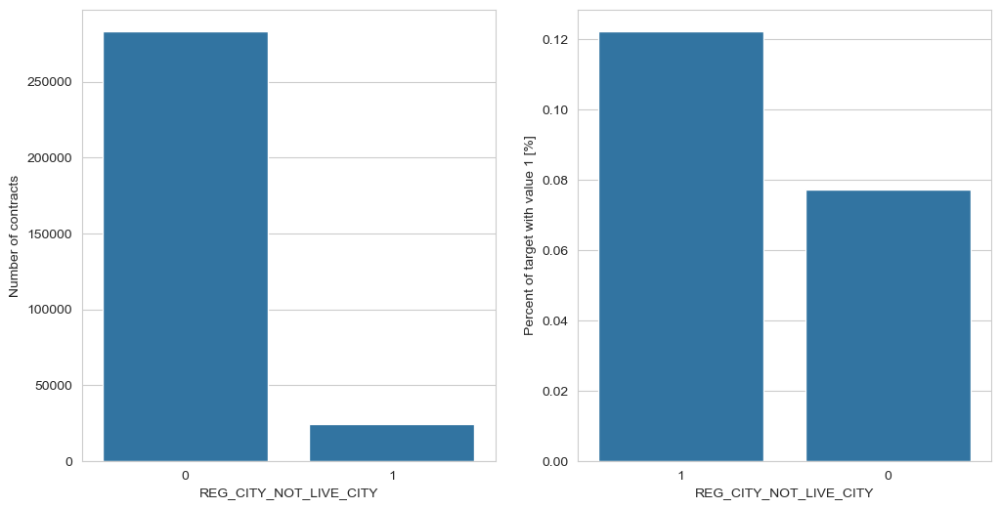

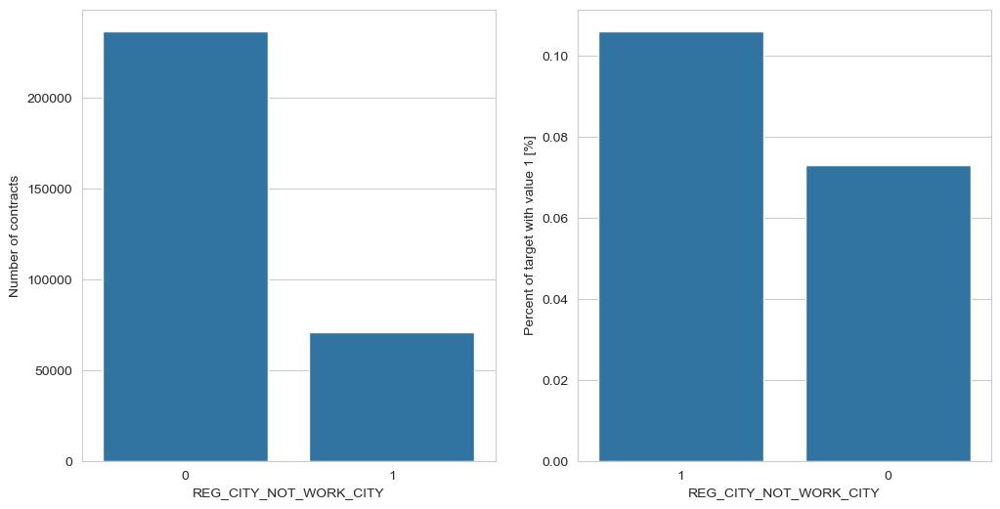

In [83]:
plot_stats('REG_CITY_NOT_LIVE_CITY')
plot_stats('REG_CITY_NOT_WORK_CITY')

### Observations :

   * Graph 1 (REG_CITY_NOT_LIVE_CITY):
       - La majorité des contrats sont attribués à des clients dont la ville de résidence correspond à la ville de leur enregistrement (valeur 0).
       - Les clients vivant dans une ville différente (valeur 1) ont un pourcentage légèrement plus élevé de défauts de paiement (TARGET = 1).

   * Graph 2 (REG_CITY_NOT_WORK_CITY):
       - Une proportion significative de clients travaille dans une ville différente de celle de leur enregistrement.
       - Les défauts de paiement sont plus fréquents parmi ceux qui travaillent dans une autre ville (valeur 1).

les individus vivant et travaillant dans la même ville contractent plus de prêts et ont un taux de défaut plus faible. Ceux dont la ville de résidence diffère de la ville de travail présentent un taux de défaut plus élevé.

 les individus vivant et travaillant dans la même ville contractent plus de prêts et ont un taux de défaut plus faible. Ceux dont la ville de résidence diffère de la ville de travail présentent un taux de défaut plus élevé.

## Bureau 



Les données du Bureau contiennent les crédits antérieurs des clients, signalés par d'autres institutions financières au Bureau de crédit. Pour chaque prêt dans l'échantillon, il y a autant de lignes que de crédits antérieurs du client avant la date de la demande. SK_ID_CURR est la clé permettant de relier les données application_train|test aux données du Bureau.

Fusionnons application_train avec les données du Bureau.

In [20]:
application_bureau_train = application_train.merge(bureau, left_on='SK_ID_CURR', right_on='SK_ID_CURR', how='inner')

In [85]:
# Affiche le nombre de lignes et de colonnes du DataFrame `application_bureau_train`
print("Le DataFrame résultant `application_bureau_train` a ", application_bureau_train.shape[0], " lignes et ", 
      application_bureau_train.shape[1], " colonnes.")


Le DataFrame résultant `application_bureau_train` a  1465325  lignes et  138  colonnes.


In [86]:
# Analysons maintenant les données du DataFrame application_bureau_train.

In [87]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Fonction pour afficher des statistiques sur une caractéristique
def plot_b_stats(feature, rotation_labels=False, disposition_horizontale=True):
    # Compte le nombre d'occurrences de chaque valeur dans la caractéristique
    temp = application_bureau_train[feature].value_counts()
    df1 = pd.DataFrame({feature: temp.index, 'Nombre de contrats': temp.values})

    # Calcule le pourcentage de TARGET=1 par valeur de la catégorie
    cat_perc = application_bureau_train[[feature, 'TARGET']].groupby([feature], as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)
    
    # Configuration de l'affichage en fonction de la disposition
    if(disposition_horizontale):
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,6))
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12,14))

    # Applique les couleurs pastel
    sns.set_color_codes("pastel")

    # Graphique du nombre de contrats par catégorie
    s = sns.barplot(ax=ax1, x=feature, y="Nombre de contrats", data=df1)
    if(rotation_labels):
        s.set_xticklabels(s.get_xticklabels(), rotation=90)
    
    # Graphique du pourcentage de TARGET=1 par catégorie
    s = sns.barplot(ax=ax2, x=feature, y='TARGET', order=cat_perc[feature], data=cat_perc)
    if(rotation_labels):
        s.set_xticklabels(s.get_xticklabels(), rotation=90)
    
    # Ajouter les labels et ajuster la taille des ticks
    plt.ylabel('Pourcentage de TARGET avec valeur 1 [%]', fontsize=10)
    plt.tick_params(axis='both', which='major', labelsize=10)

    # Afficher les graphiques
    plt.show()


In [88]:
# la répartition des statuts de crédit. Nous montrons d'abord le nombre de crédits par catégorie 

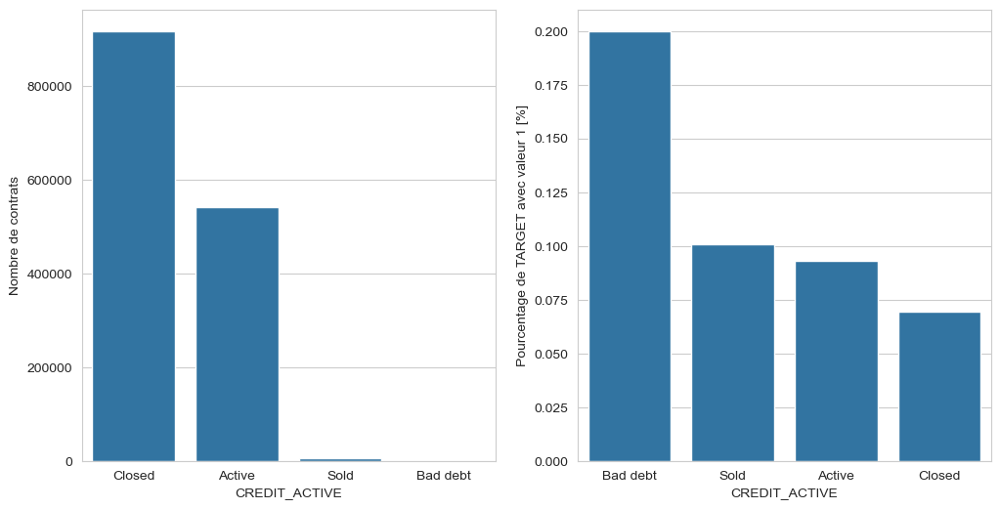

In [89]:
plot_b_stats('CREDIT_ACTIVE')

Observation et Conclusion sur l'Activité de Crédit (CREDIT_ACTIVE)
Observations

    Nombre de Contrats :

        Fermé (Closed) : Environ 850 000 contrats, le nombre le plus élevé.

        Actif (Active) : Environ 600 000 contrats, le deuxième nombre le plus élevé.

        Vendu (Sold) : Moins de 50 000 contrats, un nombre très faible.

        Mauvaise dette (Bad debt) : Nombre presque négligeable de contrats.

    Pourcentage de Prêts Non Remboursés (TARGET = 1) :

        Mauvaise dette (Bad debt) : Environ 20%, le pourcentage le plus élevé.

        Vendu (Sold) : Environ 10%, le deuxième pourcentage le plus élevé.

        Actif (Active) : Pourcentage légèrement inférieur à celui de "Vendu".

        Fermé (Closed) : Environ 7%, le pourcentage le plus faible.

### Conclusion

    Nombre de Contrats :

 * La majorité des crédits sont dans les catégories "Fermé" et "Actif", ce qui montre que la plupart des prêts sont soit remboursés, soit en cours.

    Taux de Défaut :

       * La catégorie "Mauvaise dette" a le taux de défaut le plus élevé, indiquant un risque accru pour ces prêts.

       * Les catégories "Vendu" et "Actif" ont des pourcentages de défaut modérés, tandis que "Fermé" a le taux de défaut le plus faible, suggérant une stabilité financière meilleure pour ces contrats.

En résumé, les contrats "Fermé" et "Actif" sont les plus fréquents, mais les contrats "Mauvaise dette" présentent le risque le plus élevé en termes de défauts de paiement. 

## Activité de Crédit en Fonction de la Devise

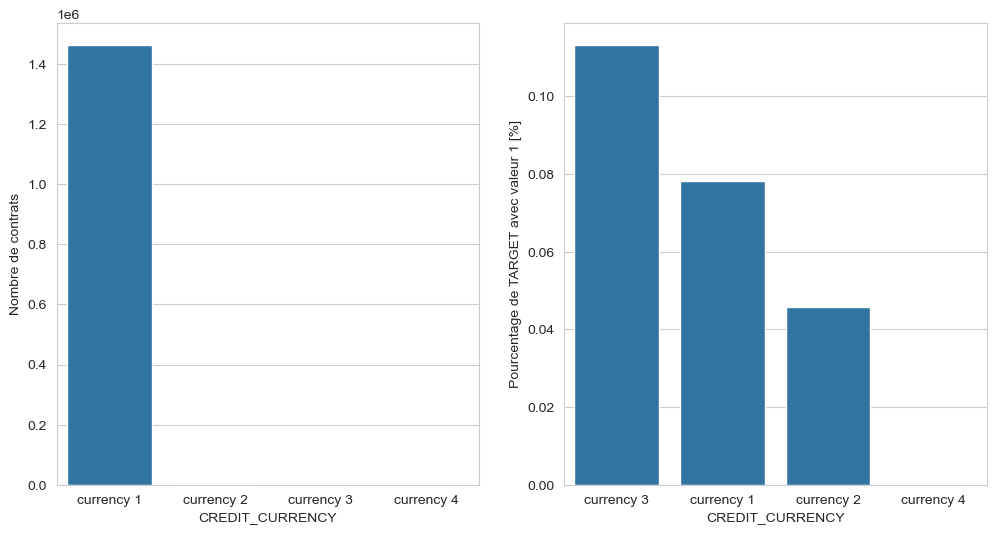

In [90]:
plot_b_stats('CREDIT_CURRENCY')

### Observations

   * Nombre de Contrats :

       - Devise 1 : Environ 1,4 million de contrats, le nombre le plus élevé.

       - Autres devises (Devise 2, 3 et 4) : Nombre négligeable ou zéro contrat.

   * Pourcentage de TARGET avec Valeur [%] :

       - Devise 3 : Le pourcentage le plus élevé de TARGET avec valeur.

       - Devise 1 et Devise 2 : Pourcentages modérés.

       - Devise 4 : Aucun pourcentage de TARGET avec valeur.

### Conclusion

   * Nombre de Contrats :

       - La majorité des contrats sont émis en Devise 1, indiquant une préférence ou une popularité plus élevée pour cette devise.

   * Taux de Défaut :

       - Bien que Devise 1 ait le plus grand nombre de contrats, Devise 3 présente le pourcentage le plus élevé de prêts non remboursés (TARGET avec valeur). Cela pourrait indiquer un risque plus élevé associé à cette devise.

En résumé, Devise 1 est la plus utilisée pour les contrats, mais Devise 3 présente le plus grand risque de défaut de paiement. 

## Types de Crédit (CREDIT_TYPE)


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\2244216437.py:27: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\2244216437.py:32: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



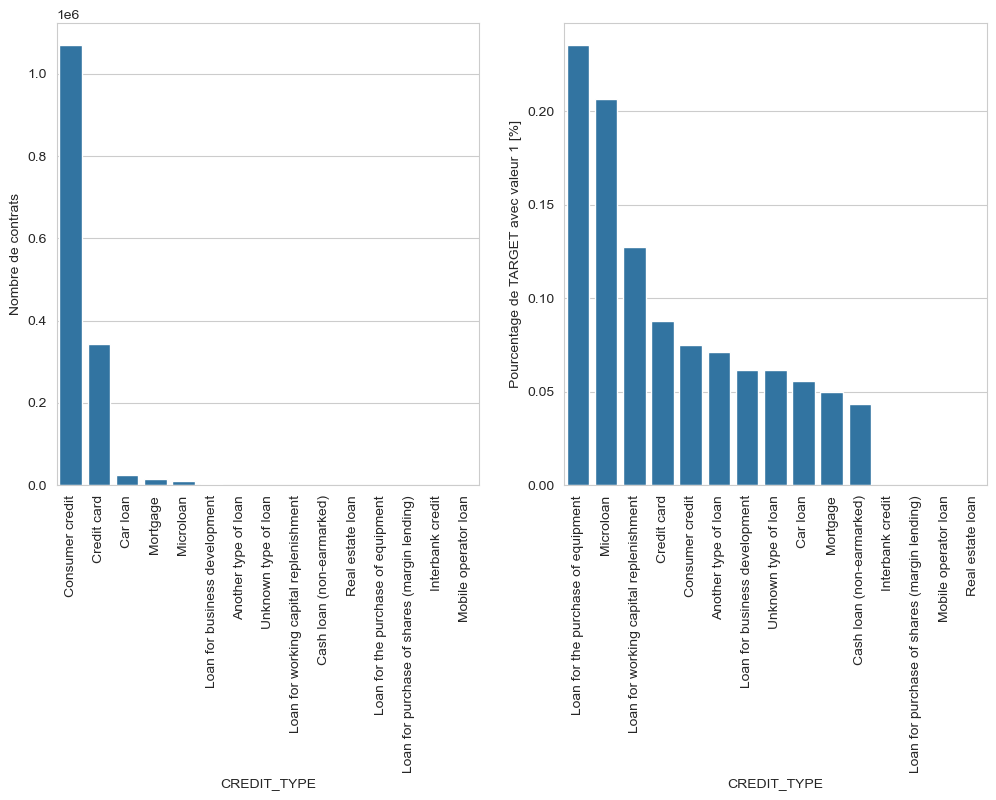

In [91]:
plot_b_stats('CREDIT_TYPE', True, True)

### Observations

   * Nombre de Contrats :

       - Crédit à la consommation : Le nombre le plus élevé de contrats, suivi par la carte de crédit et le prêt automobile.

       - Autres types de crédit : Nombre de contrats significativement plus faible.

   * Pourcentage de TARGET avec Valeur 1 [%] :

       - Prêt pour l'achat d'équipements : Le pourcentage le plus élevé de TARGET avec valeur 1.

       - Microcrédit et Prêt pour le réapprovisionnement des fonds de roulement : Pourcentages élevés.

       - Autres types de crédit : Pourcentages plus bas.

### Conclusion

   * Popularité des Types de Crédit :

       - Le crédit à la consommation est le plus populaire en termes de nombre de contrats. Cela pourrait indiquer une forte demande pour ce type de crédit.

   * Risque Associé aux Types de Crédit :

       - Les prêts pour l'achat d'équipements et les microcrédits présentent les taux de défaut les plus élevés (TARGET avec valeur 1). Cela pourrait indiquer un risque accru pour ces types de crédit.

En résumé, le crédit à la consommation est le plus utilisé, mais les prêts pour l'achat d'équipements et les microcrédits présentent le risque le plus élevé. 

 ## Distribution de DAYS_CREDIT

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3552277966.py:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




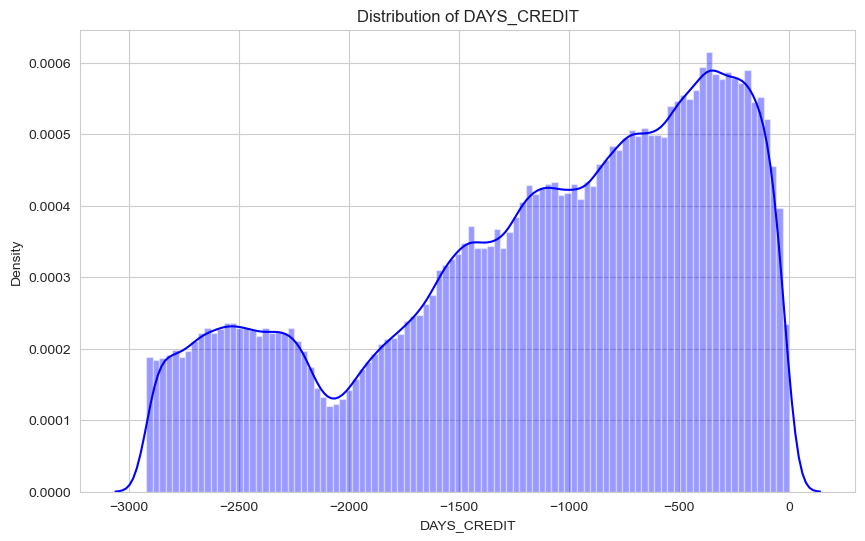

In [92]:
def plot_b_distribution(feature,color):
    plt.figure(figsize=(10,6))
    plt.title("Distribution of %s" % feature)
    sns.distplot(application_bureau_train[feature].dropna(),color=color, kde=True,bins=100)
    plt.show() 
    
plot_b_distribution('DAYS_CREDIT','blue')

### Observation

    Distribution : Pics et creux entre -3000 jours et 0 jours.

### Conclusion

    Pics fréquents : Périodes spécifiques de crédits fréquents.

    Tendances : Réflectent des tendances saisonnières ou des politiques de prêt.

## Distribution de CREDIT_DAY_OVERDUE


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3552277966.py:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




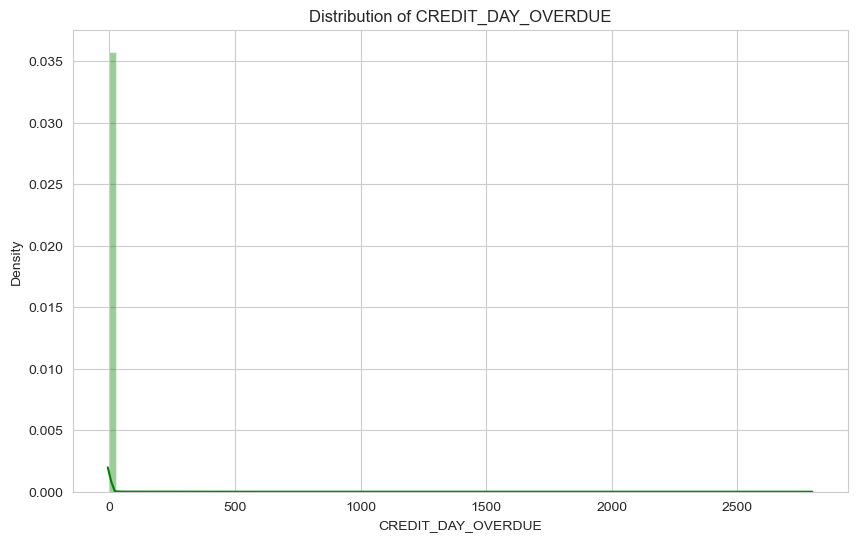

In [93]:
plot_b_distribution('CREDIT_DAY_OVERDUE','green')

### Observation

   * Distribution : La distribution des jours de crédit en retard (CREDIT_DAY_OVERDUE) montre un pic important à 0 jours en retard, ce qui indique que la plupart des données n'ont pas de jours de retard.

   * Fréquence : La densité diminue fortement après 0, avec presque aucune occurrence au-delà de 500 jours en retard.

### Conclusion

   * Implication : La majorité des crédits ne sont pas en retard, ce qui pourrait indiquer une bonne gestion des remboursements par la plupart des clients.

   * Risques : Les crédits avec des jours de retard au-delà de 0 jours nécessitent une attention particulière car ils représentent un risque accru de défaut de paiement.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3552277966.py:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




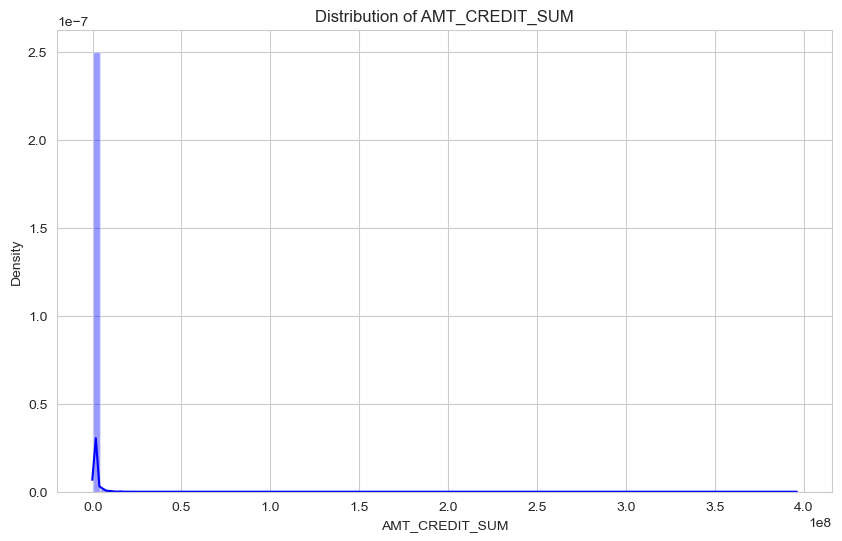

In [94]:
plot_b_distribution('AMT_CREDIT_SUM','blue')

### Observation

 * Distribution : Concentrée vers valeurs basses.

  * Fréquence : Haute densité près de zéro, diminue avec augmentation des valeurs.

### Conclusion

Majorité des crédits avec montants faibles.

In [95]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Fonction pour détecter les valeurs aberrantes (outliers) dans les données
def is_outlier(points, thresh=3.5):
    """
    Retourne un tableau de booléens où True indique que le point est une valeur aberrante et False sinon.

    Paramètres :
    -----------
        points : Un tableau de données avec les observations. Chaque ligne représente une observation, chaque colonne une dimension.
        thresh : Le seuil basé sur le score z modifié utilisé pour identifier les valeurs aberrantes. 
                Les observations avec un score z modifié (basé sur l'écart absolu médian) supérieur à ce seuil seront considérées comme des valeurs aberrantes.

    Retour :
    --------
        mask : Un tableau de booléens de la même taille que les données d'entrée.
        
    Références :
    -----------
        Boris Iglewicz et David Hoaglin (1993), "Volume 16: How to Detect and Handle Outliers", 
        The ASQC Basic References in Quality Control: Statistical Techniques.
    """
    if len(points.shape) == 1:
        points = points[:, None]  # Si une seule dimension, on l'ajoute comme colonne
    median = np.median(points, axis=0)  # Calcul de la médiane des points
    diff = np.sum((points - median)**2, axis=-1)  # Calcul de la différence au carré par rapport à la médiane
    diff = np.sqrt(diff)  # Racine carrée de la somme des carrés pour obtenir la distance
    med_abs_deviation = np.median(diff)  # Écart absolu médian

    modified_z_score = 0.6745 * diff / med_abs_deviation  # Calcul du score z modifié

    # Retourne True si le score z modifié est supérieur au seuil
    return modified_z_score > thresh

# Fonction pour tracer la distribution d'une caractéristique en excluant les valeurs aberrantes
def plot_b_o_distribution(feature, color):
    """
    Trace la distribution d'une caractéristique après avoir filtré les valeurs aberrantes.
    
    Paramètres :
    -----------
        feature : La colonne du DataFrame pour laquelle nous voulons tracer la distribution.
        color : La couleur à utiliser pour le graphique.
    """
    plt.figure(figsize=(10,6))  # Définir la taille de la figure
    plt.title("Distribution de %s" % feature)  # Ajouter un titre dynamique avec le nom de la caractéristique
    x = application_bureau_train[feature].dropna()  # Supprimer les valeurs manquantes
    filtered = x[~is_outlier(x)]  # Appliquer le filtre pour exclure les valeurs aberrantes
    sns.distplot(filtered, color=color, kde=True, bins=100)  # Tracer la distribution avec une courbe de densité
    plt.show()  # Afficher le graphique


## Distribution de AMT_CREDIT_SUM

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3256189145.py:55: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




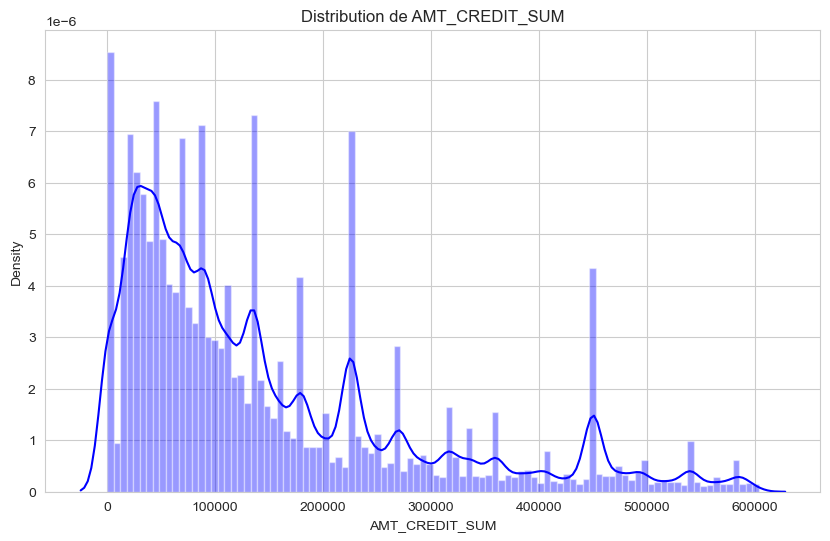

In [96]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Fonction pour détecter les valeurs aberrantes (outliers) dans les données
def is_outlier(points, thresh=3.5):
    """
    Retourne un tableau de booléens où True indique que le point est une valeur aberrante et False sinon.

    Paramètres :
    -----------
        points : Un tableau de données avec les observations. Chaque ligne représente une observation, chaque colonne une dimension.
        thresh : Le seuil basé sur le score z modifié utilisé pour identifier les valeurs aberrantes. 
                Les observations avec un score z modifié (basé sur l'écart absolu médian) supérieur à ce seuil seront considérées comme des valeurs aberrantes.

    Retour :
    --------
        mask : Un tableau de booléens de la même taille que les données d'entrée.
        
    Références :
    -----------
        Boris Iglewicz et David Hoaglin (1993), "Volume 16: How to Detect and Handle Outliers", 
        The ASQC Basic References in Quality Control: Statistical Techniques.
    """
    # Convertir les points en tableau numpy si ce n'est pas déjà le cas
    points = np.array(points)
    
    if len(points.shape) == 1:
        points = points[:, None]  # Ajouter une dimension si nécessaire

    median = np.median(points, axis=0)  # Calcul de la médiane des points
    diff = np.sum((points - median)**2, axis=-1)  # Calcul de la différence au carré par rapport à la médiane
    diff = np.sqrt(diff)  # Racine carrée de la somme des carrés pour obtenir la distance
    med_abs_deviation = np.median(diff)  # Écart absolu médian

    modified_z_score = 0.6745 * diff / med_abs_deviation  # Calcul du score z modifié

    # Retourne True si le score z modifié est supérieur au seuil
    return modified_z_score > thresh

# Fonction pour tracer la distribution d'une caractéristique en excluant les valeurs aberrantes
def plot_b_o_distribution(feature, color):
    """
    Trace la distribution d'une caractéristique après avoir filtré les valeurs aberrantes.
    
    Paramètres :
    -----------
        feature : La colonne du DataFrame pour laquelle nous voulons tracer la distribution.
        color : La couleur à utiliser pour le graphique.
    """
    plt.figure(figsize=(10,6))  # Définir la taille de la figure
    plt.title("Distribution de %s" % feature)  # Ajouter un titre dynamique avec le nom de la caractéristique
    x = application_bureau_train[feature].dropna()  # Supprimer les valeurs manquantes
    filtered = x[~is_outlier(x)]  # Appliquer le filtre pour exclure les valeurs aberrantes
    sns.distplot(filtered, color=color, kde=True, bins=100)  # Tracer la distribution avec une courbe de densité
    plt.show()  # Afficher le graphique

# Exemple d'appel pour tracer la distribution de la caractéristique 'AMT_CREDIT_SUM'
plot_b_o_distribution('AMT_CREDIT_SUM', 'blue')


### Observation

   * Distribution : Concentrée vers valeurs basses.

   * Fréquence : Haute densité près de zéro, diminue avec augmentation des valeurs.

### Conclusion

  * Majorité des crédits avec montants faibles.

## Distribution de AMT_CREDIT_SUM_LIMIT

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3552277966.py:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




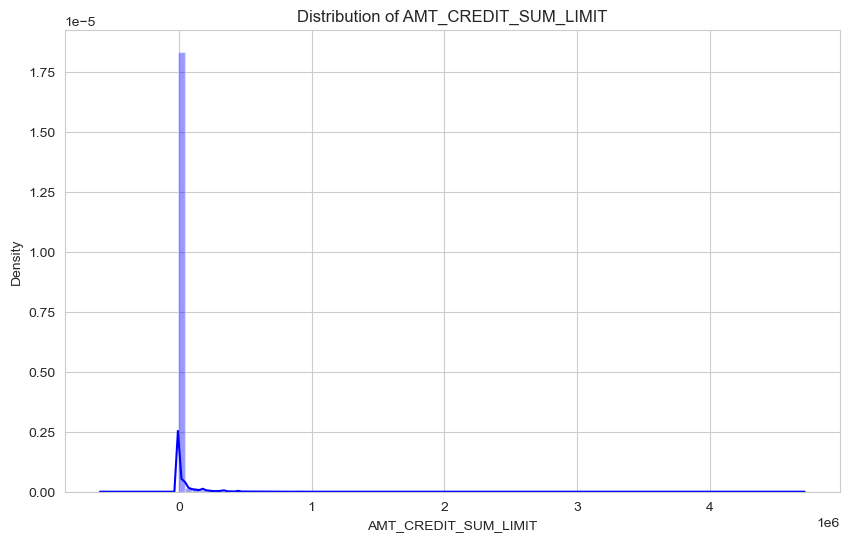

In [97]:
plot_b_distribution('AMT_CREDIT_SUM_LIMIT','blue')

### Observation

   * Distribution : La distribution des limites de crédit (AMT_CREDIT_SUM_LIMIT) montre que la majorité des valeurs sont concentrées vers l'extrémité inférieure.

  * Valeurs : La majorité des limites se situent entre 0 et 50 000 unités.

   * Fréquence : La densité est très élevée près de zéro et diminue progressivement à mesure que les valeurs augmentent.

   * Fréquence maximale : Environ 0.0015 pour les valeurs proches de 0.

### Conclusion
La plupart des limites de crédit sont relativement basses, avec très peu de valeurs élevées. Cela suggère une tendance à accorder des limites de crédit plus basses aux emprunteurs.

In [98]:
def plot_b_distribution_comp(var,nrow=2):
    
    i = 0
    t1 = application_bureau_train.loc[application_bureau_train['TARGET'] != 0]
    t0 = application_bureau_train.loc[application_bureau_train['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(nrow,2,figsize=(12,6*nrow))

    for feature in var:
        i += 1
        plt.subplot(nrow,2,i)
        sns.kdeplot(t1[feature], bw=0.5,label="TARGET = 1")
        sns.kdeplot(t0[feature], bw=0.5,label="TARGET = 0")
        plt.ylabel('Density plot', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        locs, labels = plt.xticks()
        plt.tick_params(axis='both', which='major', labelsize=12)
    plt.show();

<Figure size 640x480 with 0 Axes>

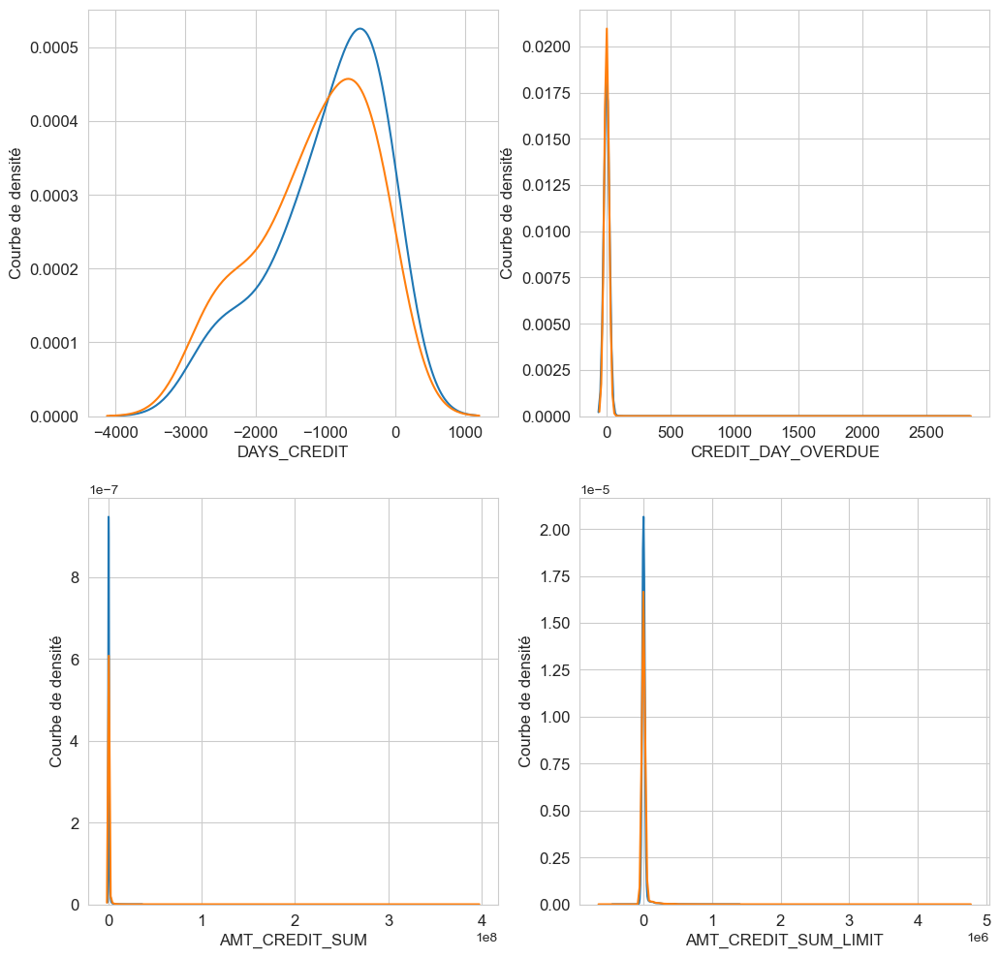

In [99]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_b_distribution_comp(var, nrow=2):
    i = 0
    t1 = application_bureau_train.loc[application_bureau_train['TARGET'] != 0]
    t0 = application_bureau_train.loc[application_bureau_train['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(nrow, 2, figsize=(12, 6 * nrow))

    for feature in var:
        i += 1
        plt.subplot(nrow, 2, i)
        sns.kdeplot(t1[feature], bw_method=0.5, label="TARGET = 1")
        sns.kdeplot(t0[feature], bw_method=0.5, label="TARGET = 0")
        plt.ylabel('Courbe de densité', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        plt.tick_params(axis='both', which='major', labelsize=12)

    plt.show()

# Appliquer la fonction avec les variables spécifiques
var = ['DAYS_CREDIT', 'CREDIT_DAY_OVERDUE', 'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_LIMIT']
plot_b_distribution_comp(var, nrow=2)


<Figure size 640x480 with 0 Axes>

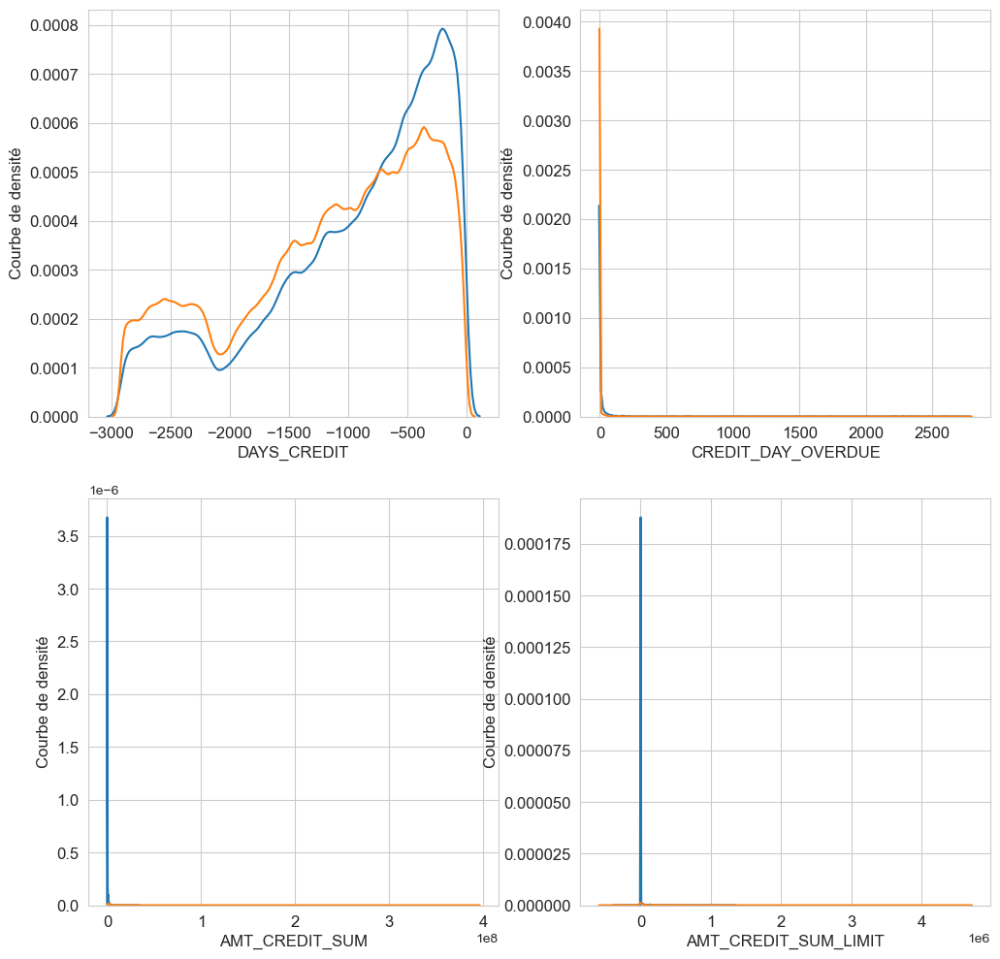

In [100]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_b_distribution_comp(var, nrow=2):
    # Remplacer les valeurs infinies par NaN
    application_bureau_train.replace([np.inf, -np.inf], np.nan, inplace=True)

    i = 0
    t1 = application_bureau_train.loc[application_bureau_train['TARGET'] != 0]
    t0 = application_bureau_train.loc[application_bureau_train['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(nrow, 2, figsize=(12, 6 * nrow))

    for feature in var:
        i += 1
        plt.subplot(nrow, 2, i)
        # Utiliser bw_adjust au lieu de bw_method pour éviter les avertissements
        sns.kdeplot(t1[feature], bw_adjust=0.5, label="TARGET = 1")
        sns.kdeplot(t0[feature], bw_adjust=0.5, label="TARGET = 0")
        plt.ylabel('Courbe de densité', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        plt.tick_params(axis='both', which='major', labelsize=12)

    plt.show()

# Variables pour tracer les distributions
var = ['DAYS_CREDIT', 'CREDIT_DAY_OVERDUE', 'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_LIMIT']
plot_b_distribution_comp(var, nrow=2)


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\903172848.py:15: UserWarning:



The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method=0.5`, but please see the docs for the new parameters
and update your code. This will become an error in seaborn v0.14.0.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\903172848.py:16: UserWarning:



The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method=0.5`, but please see the docs for the new parameters
and update your code. This will become an error in seaborn v0.14.0.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\903172848.py:15: UserWarning:



The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method=0.5`, but please see the docs for the new parameters
and update your code. This will become an error in seaborn v0.14.0.


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\903172848.py:16: UserWarning:



The `bw` parameter i

<Figure size 640x480 with 0 Axes>

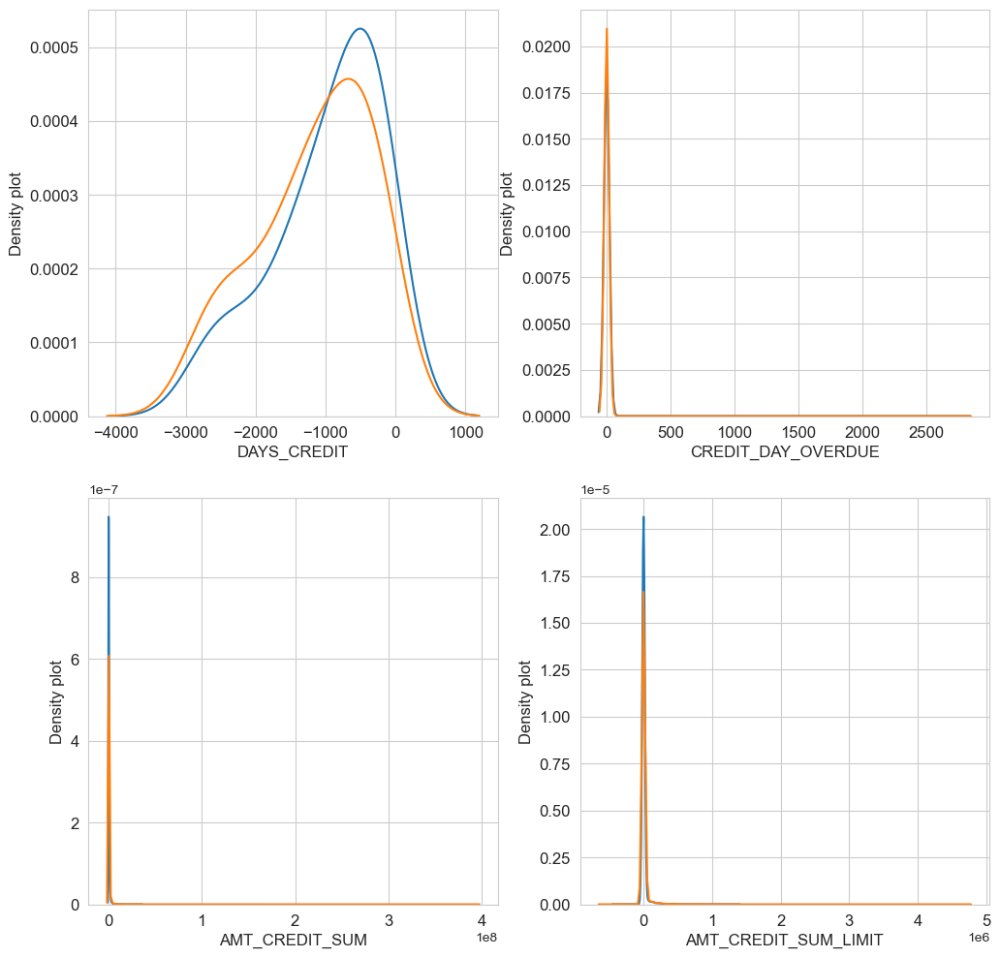

In [101]:
def plot_b_distribution_comp(var, nrow=2):
    
    i = 0
    t1 = application_bureau_train.loc[application_bureau_train['TARGET'] != 0]
    t0 = application_bureau_train.loc[application_bureau_train['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(nrow, 2, figsize=(12, 6 * nrow))

    for feature in var:
        i += 1
        plt.subplot(nrow, 2, i)
        # Utiliser bw_adjust pour des courbes plus lisses
        sns.kdeplot(t1[feature], bw=0.5, label="TARGET = 1")
        sns.kdeplot(t0[feature], bw=0.5, label="TARGET = 0")
        plt.ylabel('Density plot', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        plt.tick_params(axis='both', which='major', labelsize=12)
        
    plt.show()

# Variables à tracer
var = ['DAYS_CREDIT', 'CREDIT_DAY_OVERDUE', 'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_LIMIT']
plot_b_distribution_comp(var, nrow=2)


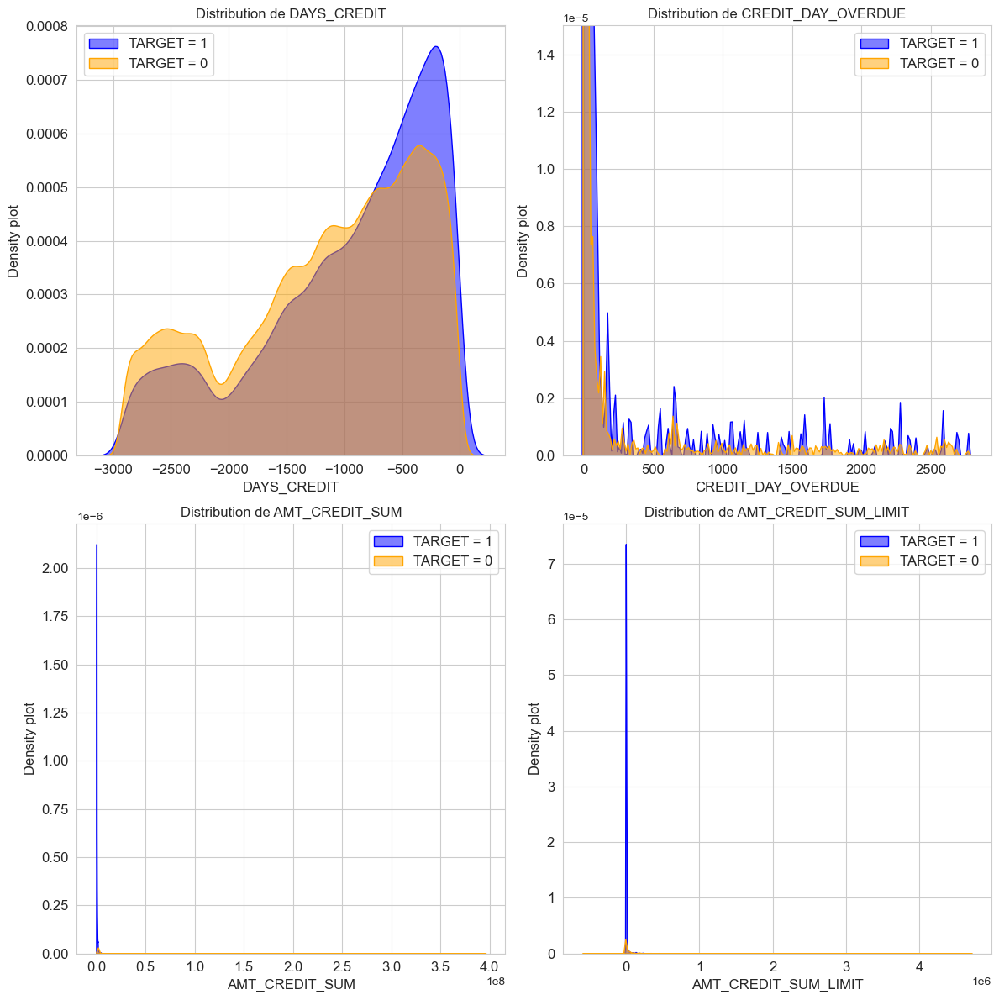

In [102]:
# Fonction pour tracer les distributions de plusieurs variables avec TARGET = 1/0
def plot_b_distribution_comp(var, df, nrow=2):
    """
    Cette fonction trace des graphiques de densité pour plusieurs variables avec distinction
    entre les cibles TARGET = 1 et TARGET = 0 sur une seule figure.

    Paramètres :
        - var (list) : Liste des noms de colonnes à tracer.
        - df (DataFrame) : Jeu de données contenant les colonnes spécifiées et la colonne 'TARGET'.
        - nrow (int) : Nombre de lignes dans la disposition des sous-graphiques.

    Retour :
        - Affiche les graphiques de densité.
    """
    # Séparer les données pour TARGET = 1 et TARGET = 0
    t1 = application_bureau_train.loc[application_bureau_train['TARGET'] != 0]
    t0 = application_bureau_train.loc[application_bureau_train['TARGET'] == 0]

    # Définir le style des graphiques
    sns.set_style('whitegrid')
    fig, axes = plt.subplots(nrow, 2, figsize=(12, 6 * nrow))  # Initialiser la grille
    axes = axes.flatten()  # Aplatir les axes pour faciliter l'accès

    for i, feature in enumerate(var):
        if i >= len(axes):  # Si plus de graphiques que d'axes disponibles, arrêter
            break
        sns.kdeplot(t1[feature], label="TARGET = 1", ax=axes[i], color="blue", fill=True, alpha=0.5)
        sns.kdeplot(t0[feature], label="TARGET = 0", ax=axes[i], color="orange", fill=True, alpha=0.5)
        axes[i].set_title(f"Distribution de {feature}", fontsize=12)  # Ajouter un titre
        axes[i].set_xlabel(feature, fontsize=12)  # Nom de l'axe X
        axes[i].set_ylabel("Density plot", fontsize=12)  # Nom de l'axe Y
        axes[i].legend(loc="best", fontsize=12)  # Ajouter une légende
        axes[i].tick_params(axis='both', which='major', labelsize=12)  # Taille des ticks

        # Ajuster les limites de l'axe des y pour CREDIT_DAY_OVERDUE
        if feature == "CREDIT_DAY_OVERDUE":
            axes[i].set_ylim(0, 0.000015)  # Plage spécifique pour l'axe y

    # Ajuster l'espacement entre les graphiques
    plt.tight_layout()
    plt.show()

# Liste des variables à tracer
var = ['DAYS_CREDIT', 'CREDIT_DAY_OVERDUE', 'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_LIMIT']

# Appeler la fonction avec le DataFrame
plot_b_distribution_comp(var, application_bureau_train, nrow=2)


## Distribution de DAYS_CREDIT
### Observations

* Distribution : La fréquence des crédits varie entre -3000 jours et 0 jours, avec plusieurs pics notables.

* Fréquence élevée : Pics fréquents à environ -1500 jours, -2500 jours, et proches de 0 jours.

#### Conclusions

* Pics fréquents : Indiquent des périodes spécifiques où les crédits étaient souvent accordés.

* Tendances : Révèlent des tendances saisonnières ou des politiques de prêt spécifiques.
    
## Distribution de DAYS_CREDIT
### Observations

* Distribution : Concentrée vers les valeurs basses.

* Fréquence élevée : Pics fréquents à environ -1500 jours, -2500 jours, et proches de 0 jours.

### Conclusions

* Pics fréquents : Indiquent des périodes spécifiques où les crédits étaient souvent accordés.

* Révèlent des tendances saisonnières ou des politiques de prêt spécifiques.

## Distribution de CREDIT_DAY_OVERDUE
### Observation

* Distribution : La distribution des jours de crédit en retard (CREDIT_DAY_OVERDUE) montre un pic important à 0 jours en retard.

* Fréquence élevée : La densité diminue fortement après 0 jours, avec presque aucune occurrence au-delà de 500 jours en retard.

Conclusion

* La majorité des crédits ne sont pas en retard, ce qui pourrait indiquer une bonne gestion des remboursements par la plupart des clients.

* Les crédits avec des jours de retard au-delà de 0 jours nécessitent une attention particulière car ils représentent un risque accru de défaut de paiement.

## Distribution de AMT_CREDIT_SUM
### Observations

   * Distribution : Concentrée vers les valeurs basses.

   * Fréquence élevée : Haute densité près de zéro, diminue rapidement à mesure que les valeurs augmentent.

### Conclusions

 La plupart des crédits ont des montants relativement faibles, avec très peu de valeurs élevées.

## Distribution de AMT_CREDIT_SUM_LIMIT
### Observations

   * Distribution : Concentrée vers valeurs basses.

   * Valeurs : La majorité des limites se situent entre 0 et 50 000 unités.

   * Fréquence élevée : Haute densité près de zéro, diminue avec l'augmentation des valeurs.

### Conclusions

 Majorité des crédits avec montants faibles.



## Previous application data

Données des demandes précédentes

Le dataframe previous_application contient des informations sur toutes les demandes de prêt précédentes auprès de Home Credit, concernant les clients ayant des prêts dans notre échantillon. Chaque ligne représente une demande précédente liée aux prêts de notre échantillon de données. La clé SK_ID_CURR permet de connecter les données application_train ou application_test avec les données de previous_application.

Fusionnons maintenant application_train avec previous_application.

In [21]:
application_prev_train = application_train.merge(previous_application, left_on='SK_ID_CURR', right_on='SK_ID_CURR', how='inner')

In [22]:
print("Le dataframe résultant `application_prev_train` contient ", application_prev_train.shape[0], " lignes et ", 
      application_prev_train.shape[1], " colonnes.")


Le dataframe résultant `application_prev_train` contient  1413701  lignes et  158  colonnes.


In [105]:
def plot_p_stats(feature, rotation_labels=False, disposition_horizontale=True):
    """
    Cette fonction trace deux graphiques côte à côte (ou l'un sous l'autre) pour une caractéristique catégorique :
    - Le nombre de contrats pour chaque catégorie.
    - Le pourcentage de cibles ayant la valeur TARGET = 1 pour chaque catégorie.

    Paramètres :
        - feature (str) : Le nom de la colonne à analyser.
        - rotation_labels (bool) : Si vrai, fait pivoter les étiquettes de l'axe X.
        - disposition_horizontale (bool) : Si vrai, affiche les graphiques côte à côte.
                                          Sinon, les graphiques sont affichés l'un sous l'autre.
    """
    # Calculer la distribution des contrats
    temp = application_prev_train[feature].value_counts()
    df1 = pd.DataFrame({feature: temp.index, 'Nombre de contrats': temp.values})

    # Calculer le pourcentage de TARGET = 1 pour chaque catégorie
    cat_perc = application_prev_train[[feature, 'TARGET']].groupby([feature], as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)
    
    # Configuration de la disposition des graphiques
    if disposition_horizontale:
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 6))
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12, 14))
    
    # Tracer le graphique pour le nombre de contrats
    sns.set_color_codes("pastel")
    s = sns.barplot(ax=ax1, x=feature, y="Nombre de contrats", data=df1)
    if rotation_labels:
        s.set_xticklabels(s.get_xticklabels(), rotation=90)
    
    # Tracer le graphique pour le pourcentage de TARGET = 1
    s = sns.barplot(ax=ax2, x=feature, y='TARGET', order=cat_perc[feature], data=cat_perc)
    if rotation_labels:
        s.set_xticklabels(s.get_xticklabels(), rotation=90)
    
    plt.ylabel('Pourcentage de TARGET avec valeur 1 [%]', fontsize=10)
    plt.tick_params(axis='both', which='major', labelsize=10)

    plt.show()


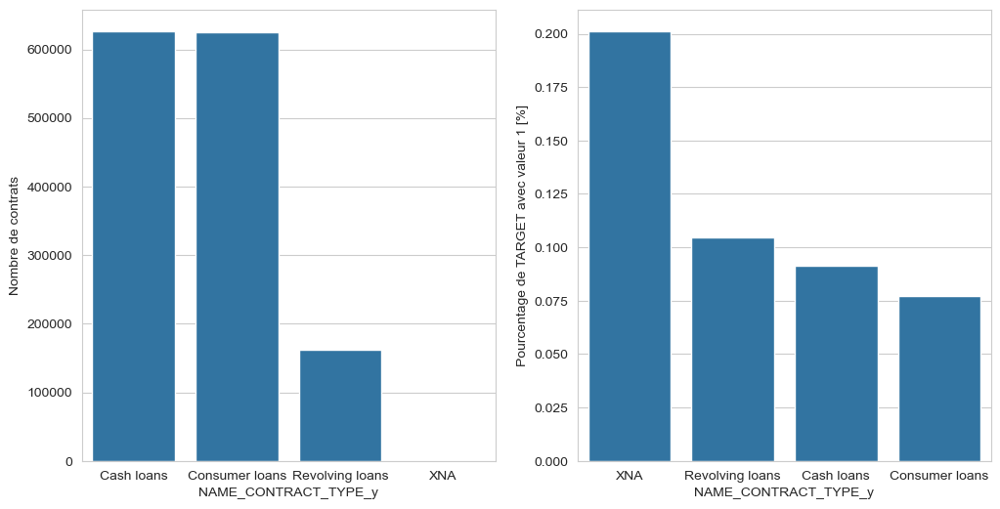

In [106]:
plot_p_stats('NAME_CONTRACT_TYPE_y')

### Observations

   * Nombre de Contrats :

       - Prêts en espèces (Cash loans) : Nombre le plus élevé (environ 600 000 contrats).

       - Prêts à la consommation (Consumer loans) : Nombre élevé (environ 600 000 contrats).

       - Prêts renouvelables (Revolving loans) : Nombre moyen (environ 150 000 contrats).

        - XNA : Aucun contrat.

  *  Pourcentage de TARGET avec Valeur 1 [%] :

       - XNA : Pourcentage le plus élevé (environ 20%).

       - Prêts renouvelables (Revolving loans) : Pourcentage élevé (environ 10%).

       - Prêts en espèces (Cash loans) et Prêts à la consommation (Consumer loans) : Pourcentages similaires, légèrement en dessous de 10%.

### Conclusions

   * Popularité : Les prêts en espèces et les prêts à la consommation sont les plus populaires en termes de nombre de contrats.

   - Risque : Les XNA et les prêts renouvelables présentent des risques plus élevés (pourcentage élevé de TARGET avec valeur 1).

## Types de Crédit

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3527287972.py:31: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3527287972.py:36: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



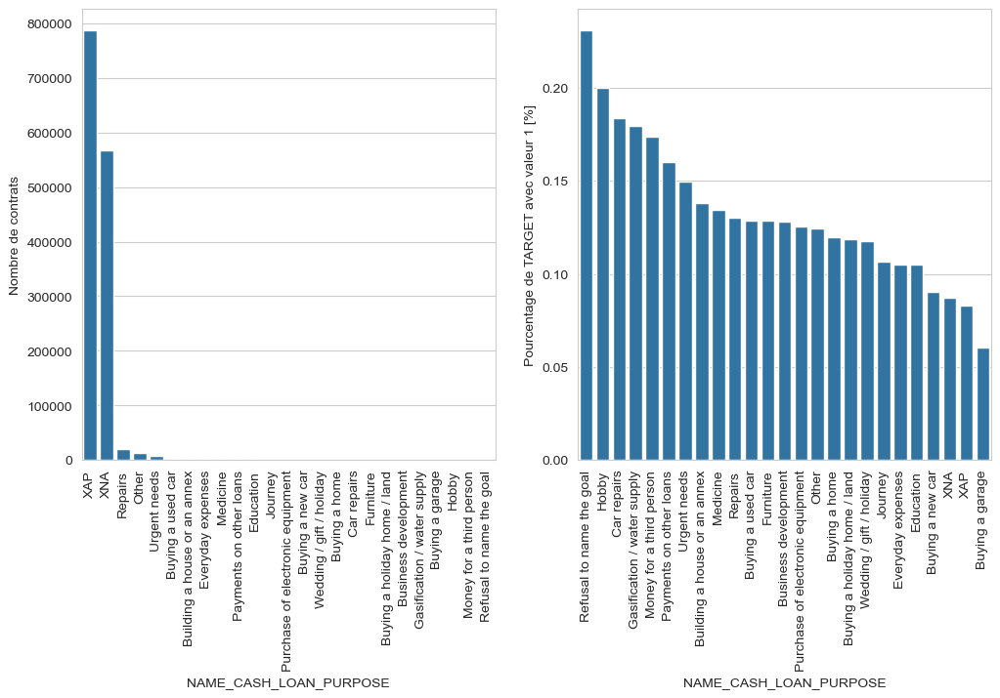

In [107]:
plot_p_stats('NAME_CASH_LOAN_PURPOSE', True, True)

### Observations

   * Nombre de Contrats :

       - XAP et XNA : Nombre de contrats significativement plus élevé.

       - Autres catégories : Nombre de contrats beaucoup plus faible.

   * Pourcentage de TARGET avec Valeur 1 [%] :

       - Objectif (goal), Loisir (hobby), Réparations de voiture (car repairs) : Pourcentages les plus élevés.

       - Autres catégories : Pourcentages variés mais généralement plus faibles.

### Conclusions

   * Popularité : Les catégories XAP et XNA sont les plus populaires en termes de nombre de contrats.

   * Risque : Les catégories liées aux objectifs, aux loisirs et aux réparations de voiture présentent des risques plus élevés (pourcentage élevé de TARGET avec valeur 1).

## Statuts de Contrat (NAME_CONTRACT_STATUS)


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3527287972.py:31: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3527287972.py:36: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



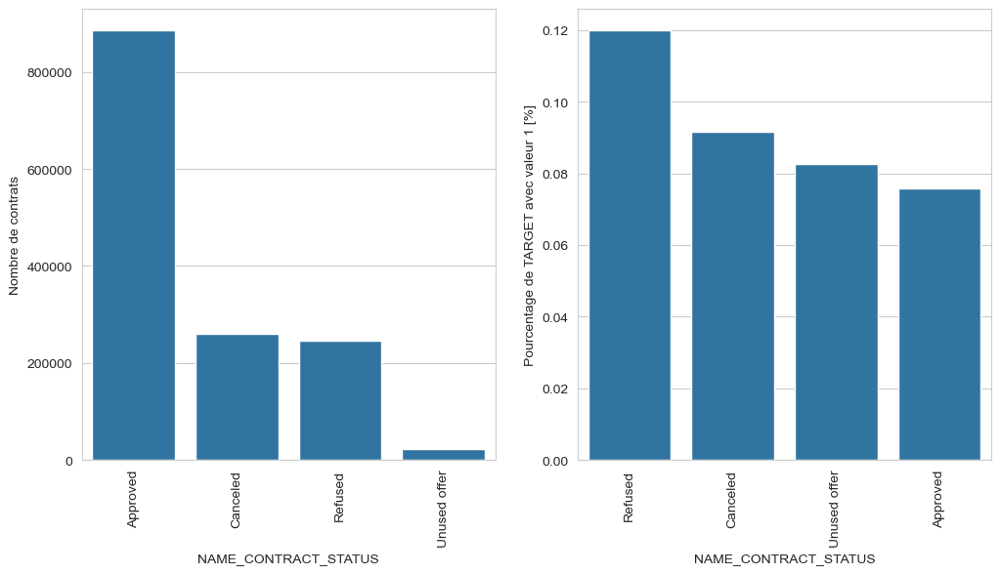

In [108]:
plot_p_stats('NAME_CONTRACT_STATUS', True, True)

### Observations

   * Nombre de Contrats :

       - Approved (Approuvé) : Environ 900 000 contrats, le nombre le plus élevé.

       - Canceled (Annulé) : Environ 250 000 contrats, nombre modéré.

       - Refused (Refusé) : Environ 250 000 contrats, nombre modéré.

       - Unused offer (Offre inutilisée) : Environ 50 000 contrats, le nombre le plus faible.

   * Pourcentage de TARGET avec Valeur 1 [%] :

       - Refused (Refusé) : Environ 0,11%, le pourcentage le plus élevé.

       - Canceled (Annulé) : Environ 0,09%.

       - Unused offer (Offre inutilisée) : Environ 0,09%.

       - Approved (Approuvé) : Environ 0,08%, le pourcentage le plus faible.

### Conclusions

   * Popularité : Les contrats approuvés sont les plus courants, suivis des contrats annulés et refusés.

   * Risque : Les contrats refusés présentent le plus grand risque, suivis des contrats annulés et des offres inutilisées. Les contrats approuvés présentent le risque le plus faible.

## Types de Paiement (NAME_PAYMENT_TYPE)


C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3527287972.py:31: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\yosra\AppData\Local\Temp\ipykernel_10956\3527287972.py:36: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



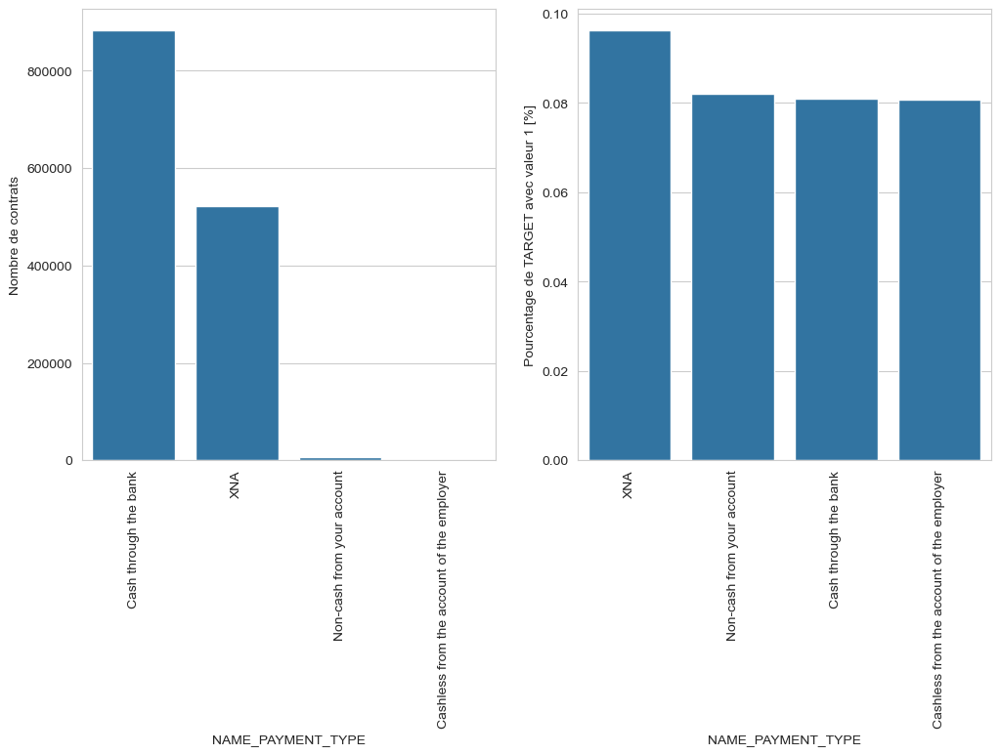

In [109]:
plot_p_stats('NAME_PAYMENT_TYPE', True, True)

### Observations

   * Nombre de Contrats :

       - Cash through the bank : Le nombre le plus élevé de contrats.

       - XNA : Deuxième nombre le plus élevé.

       - Non-cash from your account et Cashless from the account of the employer : Significativement moins de contrats.

   * Pourcentage de TARGET avec Valeur 1 [%] :

       - XNA : Le pourcentage le plus élevé.

       - Non-cash from your account : Deuxième pourcentage le plus élevé.

       - Cash through the bank et Cashless from the account of the employer : Pourcentages plus faibles.

### Conclusions

   * Popularité : Cash through the bank est le type de paiement le plus populaire en termes de nombre de contrats.

   * Risque : XNA présente le risque le plus élevé (pourcentage élevé de TARGET avec valeur 1).



## Types de Clients


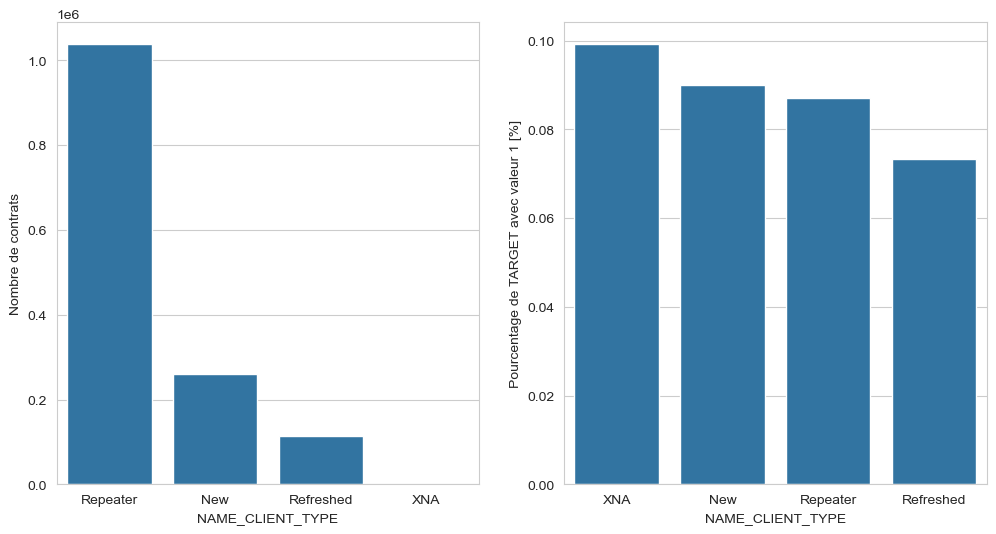

In [110]:
plot_p_stats('NAME_CLIENT_TYPE')

### Observations

   * Nombre de Contrats :

       - Client répétitif (Repeater) : Nombre le plus élevé de contrats.

       - Nouveau client (New) : Deuxième nombre le plus élevé.

       - Client rafraîchi (Refreshed) : Nombre modéré de contrats.

       - XNA : Aucun contrat.

   * Pourcentage de TARGET avec Valeur 1 [%] :

       - XNA : Pourcentage le plus élevé.

       - Nouveau client (New) : Pourcentage élevé.

       - Client répétitif (Repeater) : Pourcentage modéré.

       - Client rafraîchi (Refreshed) : Pourcentage le plus faible.

### Conclusions

   * Popularité : Les clients répétitifs sont les plus fréquents en termes de nombre de contrats.

   * Risque : Les clients XNA présentent le plus grand risque, tandis que les clients rafraîchis présentent le risque le plus faible.

# Conclusions de l'Analyse Exploratoire des Données (EDA)

L'analyse exploratoire approfondie des données que nous avons réalisée a permis de dégager des conclusions importantes pour guider les étapes suivantes de notre projet. Voici les principales observations :

  ##  1- Fusion des données :
    L'ensemble de données nécessite une fusion astucieuse afin que les données combinées aient un sens contextuel et soient exploitables pour les analyses futures.

  ##  2- Discrimination entre les classes :
    Certaines catégories se révèlent être de très bons discriminants entre les défaillants et les non-défaillants. Ces caractéristiques pourraient jouer un rôle clé dans la classification et méritent une attention particulière.

  ## 3- Points erronés dans les variables continues :
    Quelques variables numériques continues contiennent des valeurs manifestement erronées ou aberrantes. Ces points devront être identifiés et traités avec soin pour garantir la qualité des données.

  ##  4- Corrélation entre les caractéristiques :
    Nous avons remarqué la présence de certaines variables fortement corrélées. Ces corrélations pourraient augmenter inutilement la dimensionnalité des données sans ajouter de valeur significative. Une sélection ou une suppression de ces caractéristiques sera nécessaire pour simplifier le modèle tout en maintenant sa performance.

  ##  5- Déséquilibre des classes :
    L'ensemble de données présente un déséquilibre global entre les défaillants et les non-défaillants. Il sera essentiel d'utiliser des techniques appropriées pour gérer cet équilibre, telles que le suréchantillonnage, le sous-échantillonnage ou des méthodes pondérées.

  ##  6- Importance des valeurs aberrantes :
    Contrairement à des cas classiques, les valeurs aberrantes ou éloignées ne peuvent pas être simplement supprimées. Pour la prédiction du risque de défaillance, ces points peuvent refléter des comportements inhabituels mais significatifs chez les défaillants. Ils devront être conservés et analysés avec attention.

## Étapes suivantes Fortes de ces observations, les étapes suivantes consistent à :

    - Nettoyer les données pour traiter les valeurs aberrantes et les incohérences.
    - Réaliser un feature engineering pour transformer, sélectionner ou créer des caractéristiques pertinentes qui améliorent les performances du modèle.
    - Gérer le déséquilibre des classes pour garantir une modélisation équitable et robuste.

# --------------------------------------------------------------------------------------------------
# FEATURES ENGINEERING
# --------------------------------------------------------------------------------------------------

Cette partie est inspirée du notebook kaggle suivant https://www.kaggle.com/jsaguiar/lightgbm-with-simple-features/

Les idées clés suivantes ont été utilisées :

- Diviser ou soustraire des caractéristiques importantes pour obtenir des taux (comme l'annuité et le revenu).
- Dans les données du bureau : créer des caractéristiques spécifiques pour les crédits actifs et les crédits fermés.
- Dans les demandes précédentes : créer des caractéristiques spécifiques pour les demandes approuvées et refusées.
- Encodage unique pour les caractéristiques catégorielles
- Toutes les tables sont jointes en utilisant la clé SK_ID_CURR(ID du client)

In [80]:
def one_hot_encoder(df, nan_as_category=True):
    # Stocker les noms des colonnes initiales
    original_columns = list(df.columns)
    
    # Identifier les colonnes catégoriques
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    
    # Appliquer l'encodage one-hot aux colonnes catégoriques
    df = pd.get_dummies(df, columns=categorical_columns, dummy_na=nan_as_category)
    
    # Identifier les nouvelles colonnes créées après encodage
    new_columns = [c for c in df.columns if c not in original_columns]
    
    return df, new_columns


In [81]:
# Prétraiter application_train.csv
def application_train(num_rows = None, nan_as_category = False):
    # Lire les données et fusionner
    df = pd.read_csv("application_train.csv")
    
    
    # Encoder les variables catégorielles avec un encodage binaire (0 ou 1 ; deux catégories)
    df = label_encoder(df)
    # Encoder les variables catégorielles avec One-Hot
    df, cat_cols = one_hot_encoder(df, nan_as_category)
    
    # Remplacer les valeurs NaN pour DAYS_EMPLOYED : 365.243 -> NaN
    df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace=True)
    # Quelques nouvelles fonctionnalités simples (pourcentages)
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    df['INCOME_CREDIT_PERC'] = df['AMT_INCOME_TOTAL'] / df['AMT_CREDIT']
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']
    df = df.set_index('SK_ID_CURR')
    gc.collect()
    return df

# Prétraiter bureau.csv et bureau_balance.csv
def bureau_balance(num_rows = None, nan_as_category = True):
    bureau = pd.read_csv("bureau.csv")
   
    bb = pd.read_csv("bureau_balance.csv")
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    # Bureau balance : Effectuer des agrégations et fusionner avec bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace=True)
    del bb, bb_agg
    gc.collect()
    
    # Caractéristiques numériques de bureau et bureau_balance
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Caractéristiques catégorielles de bureau et bureau_balance
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau : Crédits actifs - en utilisant uniquement les agrégations numériques
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau : Crédits fermés - en utilisant uniquement les agrégations numériques
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

# Prétraiter POS_CASH_balance.csv
def POS_CASH_balance(num_rows = None, nan_as_category = True):
    pos = pd.read_csv("POS_CASH_balance.csv")
    pos, cat_cols = one_hot_encoder(pos, nan_as_category=True)
    # Caractéristiques
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Compter les comptes POS cash (POS_MONTHS_BALANCE_SIZE)
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    return pos_agg

# Prétraiter installments_payments.csv
def installments_payments(num_rows = None, nan_as_category = True):
    ins = pd.read_csv("installments_payments.csv")
    ins, cat_cols = one_hot_encoder(ins, nan_as_category=True)
    # Pourcentage et différence payée dans chaque versement (montant payé et valeur de la versement)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Jours passés dus et jours avant la date d'échéance (pas de valeurs négatives)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    # Caractéristiques : Effectuer des agrégations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Compter les comptes de versements
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    return ins_agg

# Prétraiter credit_card_balance.csv
def credit_card_balance(num_rows = None, nan_as_category = True):
    cc = pd.read_csv("credit_card_balance.csv")
    cc, cat_cols = one_hot_encoder(cc, nan_as_category=True)
    # Agrégations générales
    cc.drop(['SK_ID_PREV'], axis=1, inplace=True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Compter les lignes de cartes de crédit
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    return cc_agg


In [82]:
import pandas as pd
import numpy as np
import gc
from sklearn.preprocessing import LabelEncoder

# Fonction d'encodage avec One-Hot
def one_hot_encoder(df, nan_as_category=True):
    original_columns = list(df.columns)
    df = pd.get_dummies(df, dummy_na=nan_as_category)
    new_columns = [col for col in df.columns if col not in original_columns]
    return df, new_columns

# Fonction d'encodage avec LabelEncoder
def label_encoder(df):
    label_enc = LabelEncoder()
    for col in df.select_dtypes(include=['object']).columns:
        df[col] = label_enc.fit_transform(df[col].astype(str))
    return df

# Prétraitement de application_train.csv
def application_train(num_rows=None, nan_as_category=False):
    df = pd.read_csv("application_train.csv", nrows=num_rows)
    df = label_encoder(df)
    df, cat_cols = one_hot_encoder(df, nan_as_category)
    
    # Remplacement des valeurs NaN spécifiques
    df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace=True)
    
    # Création de nouvelles colonnes
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    df['INCOME_CREDIT_PERC'] = df['AMT_INCOME_TOTAL'] / df['AMT_CREDIT']
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']
    
    gc.collect()
    return df

# Prétraitement de bureau.csv et bureau_balance.csv
def bureau_balance(num_rows=None, nan_as_category=True):
    bureau = pd.read_csv("bureau.csv", nrows=num_rows)
    bb = pd.read_csv("bureau_balance.csv", nrows=num_rows)
    
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    # Agrégations pour bureau_balance
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace=True)
    del bb, bb_agg
    gc.collect()
    
    # Agrégations pour bureau
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum']
    }
    cat_aggregations = {cat: ['mean'] for cat in bureau_cat}
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    
    gc.collect()
    return bureau_agg

# Prétraitement de installments_payments.csv
def installments_payments(num_rows=None, nan_as_category=True):
    ins = pd.read_csv("installments_payments.csv", nrows=num_rows)
    ins, cat_cols = one_hot_encoder(ins, nan_as_category)
    
    # Création de nouvelles colonnes
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: max(x, 0))
    ins['DBD'] = ins['DBD'].apply(lambda x: max(x, 0))
    
    # Agrégations
    aggregations = {
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    
    gc.collect()
    return ins_agg

# Prétraitement de credit_card_balance.csv
def credit_card_balance(num_rows=None, nan_as_category=True):
    cc = pd.read_csv("credit_card_balance.csv", nrows=num_rows)
    cc, cat_cols = one_hot_encoder(cc, nan_as_category)
    
    # Agrégations
    cc.drop(['SK_ID_PREV'], axis=1, inplace=True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    
    gc.collect()
    return cc_agg


In [83]:
df_app_train = application_train()
df =df_app_train.copy()

C:\Users\yosra\AppData\Local\Temp\ipykernel_23740\383901355.py:27: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [84]:
df_app_train = application_train()
df_bureau_balance = bureau_balance()
df_pos_cash = POS_CASH_balance()
df_installments_payments = installments_payments()
df_credit_card_balance = credit_card_balance()

C:\Users\yosra\AppData\Local\Temp\ipykernel_23740\383901355.py:27: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [85]:
# taille des data frames 
df_app_train.shape, df_bureau_balance.shape, df_pos_cash.shape, df_installments_payments.shape, df_credit_card_balance.shape

((307511, 127), (305811, 36), (337252, 18), (339587, 13), (103558, 141))

In [86]:
# Join dataframes
df = df_app_train \
.join(df_bureau_balance, how='left', on='SK_ID_CURR') \
.join(df_pos_cash, how='left', on='SK_ID_CURR') \
.join(df_installments_payments, how='left', on='SK_ID_CURR') \
.join(df_credit_card_balance, how='left', on='SK_ID_CURR') \
.reset_index()

In [87]:
df.head()

,index,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,...,CC_NAME_CONTRACT_STATUS_Signed_MAX,CC_NAME_CONTRACT_STATUS_Signed_MEAN,CC_NAME_CONTRACT_STATUS_Signed_SUM,CC_NAME_CONTRACT_STATUS_Signed_VAR,CC_NAME_CONTRACT_STATUS_nan_MIN,CC_NAME_CONTRACT_STATUS_nan_MAX,CC_NAME_CONTRACT_STATUS_nan_MEAN,CC_NAME_CONTRACT_STATUS_nan_SUM,CC_NAME_CONTRACT_STATUS_nan_VAR,CC_COUNT
0,0,100002,1,0,1,0,1,0,202500.0,406597.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,100003,0,0,0,0,0,0,270000.0,1293502.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,100004,0,1,1,1,1,0,67500.0,135000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,100006,0,0,0,0,1,0,135000.0,312682.5,...,False,0.0,0.0,0.0,False,False,0.0,0.0,0.0,6.0
4,4,100007,0,0,1,0,1,0,121500.0,513000.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [88]:
df.shape

(307511, 336)

In [89]:
def drop_columns_too_many_Nan(df):
    # Remplacer les valeurs infinies par NaN avant de calculer les NaN pourcentages
    df.replace([np.inf, -np.inf], np.nan, inplace=True)
    
    # Calculer le pourcentage de NaN par colonne
    total_nan_pourcentage = df.isnull().sum() / df.shape[0]
    
    # Sélectionner les colonnes avec moins de 50% de NaN
    features_inf = total_nan_pourcentage[total_nan_pourcentage < 0.50].index
    
    # Garder uniquement ces colonnes
    df_clean = df[features_inf]
    return df_clean

# Appliquer la fonction sur le DataFrame df
df_final = drop_columns_too_many_Nan(df)


In [90]:
df_final.shape

(307511, 157)

In [91]:
df=df_final.copy()

In [92]:
def reduce_mem_usage(data, verbose=True):
    # source: https://www.kaggle.com/gemartin/load-data-reduce-memory-usage
    '''
    Cette fonction est utilisée pour réduire l'utilisation de la mémoire en convertissant les types de données d'un DataFrame
    Pandas dans des limites nécessaires.
    '''

    # Calcul de l'utilisation mémoire initiale
    start_mem = data.memory_usage().sum() / 1024**2
    if verbose:
        print('-' * 79)
        print('Utilisation de la mémoire du dataframe: {:.2f} MB'.format(start_mem))

    # Parcours des colonnes du DataFrame
    for col in data.columns:
        col_type = data[col].dtype

        # Traitement des colonnes numériques (float et int)
        if col_type != object:
            c_min = data[col].min()
            c_max = data[col].max()
            
            # Si la colonne est de type entier (int), nous optimisons la taille du type
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    data[col] = data[col].astype(np.int8)  # Conversion en int8 si possible
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    data[col] = data[col].astype(np.int16)  # Conversion en int16 si possible
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    data[col] = data[col].astype(np.int32)  # Conversion en int32 si possible
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    data[col] = data[col].astype(np.int64)  # Conversion en int64 si nécessaire
            else:
                # Si la colonne est de type float, nous optimisons la taille du type
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    data[col] = data[col].astype(np.float16)  # Conversion en float16 si possible
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    data[col] = data[col].astype(np.float32)  # Conversion en float32 si possible
                else:
                    data[col] = data[col].astype(np.float64)  # Conversion en float64 si nécessaire

    # Calcul de l'utilisation mémoire après optimisation
    end_mem = data.memory_usage().sum() / 1024**2
    if verbose:
        print('Utilisation de la mémoire après optimisation: {:.2f} MB'.format(end_mem))
        print('Réduction de {:.1f}%'.format(
            100 * (start_mem - end_mem) / start_mem))  # Affichage du pourcentage de réduction de mémoire
        print('-' * 79)

    return data


In [93]:
def convert_types(dataframe, print_info=False):
    # Mémoire originale avant modification
    original_memory = dataframe.memory_usage().sum()

    # Parcours de chaque colonne pour ajuster son type
    for c in dataframe:

        # Convertir les identifiants (SK_ID) et les booléens en entiers
        if ('SK_ID' in c):
            dataframe[c] = dataframe[c].fillna(0).astype(np.int32)  # Remplacer les NaN par 0 et convertir en int32

        # Convertir les colonnes de type object en catégorie si elles ont un nombre limité de valeurs uniques
        elif (dataframe[c].dtype == 'object') and (dataframe[c].nunique() < dataframe.shape[0]):
            dataframe[c] = dataframe[c].astype('category')  # Conversion en catégorie

        # Si les colonnes sont booléennes, les convertir en type booléen (True/False)
        elif list(dataframe[c].unique()) == [1, 0]:
            dataframe[c] = dataframe[c].astype(bool)  # Conversion en booléen

        # Convertir les colonnes de type float64 en float32 pour économiser de la mémoire
        elif dataframe[c].dtype == float:
            dataframe[c] = dataframe[c].astype(np.float32)  # Conversion en float32

        # Convertir les colonnes de type int64 en int32
        elif dataframe[c].dtype == int:
            dataframe[c] = dataframe[c].astype(np.int32)  # Conversion en int32

    # Mémoire après modification des types
    new_memory = dataframe.memory_usage().sum()

    if print_info:
        print(
            f'Utilisation de la mémoire à l\'origine : {round(original_memory / 1e9, 2)} Go.')
        print(
            f'Utilisation de la mémoire après modification des types: {round(new_memory / 1e9, 2)} Go.')

    return dataframe


In [94]:
df =reduce_mem_usage(df, verbose=True)

-------------------------------------------------------------------------------
Utilisation de la mémoire du dataframe: 349.57 MB
Utilisation de la mémoire après optimisation: 88.27 MB
Réduction de 74.7%
-------------------------------------------------------------------------------


In [95]:
# Export des données nettoyées 
df.to_csv('df_clean.csv',index=False)

# ------------------------------------------------------------------------------------------------------
# PREPROCESSING
# ------------------------------------------------------------------------------------------------------

In [96]:
df = pd.read_csv("df_clean.csv")

In [97]:
# On se rassure que les noms des colonnes sont adéquats (sans espaces)
df.columns = list(map(lambda x: str(x).replace(" ", "_").replace("-", "_").replace("_/_", "_").upper(),
                      df.columns))

df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [98]:
df.TARGET.value_counts()

TARGET
0    282686
1     24825
Name: count, dtype: int64

In [99]:
df.TARGET.value_counts()/df.shape[0]

TARGET
0    0.919271
1    0.080729
Name: count, dtype: float64

### Observations

Les données sont largement déséquilibrées:

   * environ 92 % des données sont des clients à qui on accorde le prêt (classe 0 majoritaire)
   * environ 8 % des données sont des clients à qui on refuse le prêt

In [100]:
# On sépare la colonne TARGET (la variable cible) du DataFrame
target = df.TARGET  # La variable cible, c'est-à-dire l'étiquette que nous voulons prédire

# On crée le DataFrame des entrées (inputs) en supprimant la colonne TARGET et SK_ID_CURR
inputs = df.drop(columns=['TARGET','SK_ID_CURR'])  # Suppression de la colonne TARGET (cible) et SK_ID_CURR (identifiant unique)

# On crée une version des entrées avec les identifiants (SK_ID_CURR), sans la colonne TARGET
inputs_with_ids = df.drop(columns=['TARGET'])  # Ici, on garde la colonne SK_ID_CURR, mais on supprime uniquement TARGET

## Séparation train(80 %) et test(20 %) des données

In [121]:
# On divise les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(inputs, target, test_size=0.2, random_state=42)
# X_train : Caractéristiques d'entraînement (80% des données)
# X_test : Caractéristiques de test (20% des données)
# y_train : Variable cible d'entraînement (80% des données)
# y_test : Variable cible de test (20% des données)

In [122]:
# Affiche les dimensions des ensembles d'entraînement et de test
X_train.shape, X_test.shape

((246008, 155), (61503, 155))

In [123]:
# Afficher la proportion des valeurs cibles dans les ensembles d'entraînement et de test
fig, ax = plt.subplots(1, 2, figsize=(12, 6))  # Crée un graphique avec 1 ligne et 2 colonnes de sous-graphiques

# Proportion des valeurs cibles dans l'ensemble d'entraînement (Train Set)
y_train.value_counts().plot.pie(autopct='%1.2f%%', ax=ax[0], title='Train Set')
# 'value_counts()' compte les occurrences de chaque classe dans 'y_train'
# 'plot.pie()' génère un graphique en camembert pour afficher ces proportions
# 'autopct' ajoute un pourcentage à chaque portion du graphique

# Proportion des valeurs cibles dans l'ensemble de test (Test Set)
y_test.value_counts().plot.pie(autopct='%1.2f%%', ax=ax[1], title='Test Set')
# Même chose que pour l'ensemble d'entraînement, mais pour 'y_test'

# Ajustement de l'espacement entre les graphiques
fig.subplots_adjust(wspace=0.5)
# 'wspace' définit l'espacement horizontal entre les sous-graphiques (ici, 0.5)

In [104]:
# On sauvegarde en csv les données test qui seront nos clients d'exemples pour API et dashboard
index_test = X_test.index.tolist()
X_test_with_id = inputs_with_ids.loc[index_test]
X_test_with_id.to_csv('data_test.csv',index=False)

Nous allons prétraiter les données en :

   - remplissant les valeurs manquantes (imputation)
   - normalisant les features (mise à l'échelle des features).

# Imputation des valeurs manquantes

In [105]:
# Imputation des valeurs manquantes en utilisant la médiane
imputer = SimpleImputer(missing_values=np.nan, strategy='median')

In [106]:
# Sélectionner les colonnes de type entier (uint8 et int64) dans X_train
col_int = list(X_train.select_dtypes(include=['uint8', 'int64']).columns)

# Sélectionner les colonnes de type flottant (float64) dans X_train
col_float = list(X_train.select_dtypes(include=['float64']).columns)

# Créer une copie de X_train pour le prétraitement
X_train_preprocess = X_train.copy()

# Créer une copie de X_test pour le prétraitement
X_test_preprocess = X_test.copy()

In [107]:
from sklearn.impute import SimpleImputer

In [108]:
# Transform training data
# Fit on the training data
# Remplacer les valeurs infinies dans X_train par des NaN
X_train[X_train==np.inf] = np.nan
# Appliquer l'imputation sur les données d'entraînement
imputer.fit(X_train)
# Remplacer les valeurs infinies dans X_test par des NaN
X_test[X_test==np.inf] = np.nan
# Appliquer l'imputation sur les données de test
imputer.fit(X_test)
# Transformer X_train et X_test avec l'imputation
X_train_preprocess = imputer.transform(X_train)
X_test_preprocess = imputer.transform(X_test)

In [109]:
# Copier toutes les colonnes de X_train dans X_train_preprocess
X_train_preprocess = X_train.iloc[:,:]

In [110]:
# Copier toutes les colonnes de X_test dans X_test_preprocess
X_test_preprocess = X_test.iloc[:,:]

In [111]:
# Initialiser un imputer avec la stratégie de remplacement par la médiane
imputer = SimpleImputer(strategy='median')

# Appliquer l'imputation sur X_test en remplaçant les valeurs manquantes par la médiane
# et mettre à jour X_test avec les valeurs transformées
X_test.iloc[:,:] = imputer.fit_transform(X_test)

In [112]:
# Initialiser un imputer avec une stratégie de remplacement par la médiane
imputer = SimpleImputer(strategy='median')

# Appliquer l'imputation sur X_train en remplaçant les valeurs manquantes par la médiane
# et mettre à jour X_train avec les valeurs transformées
X_train.iloc[:,:] = imputer.fit_transform(X_train)

In [113]:
# Vérifier si toutes les valeurs manquantes ont été imputées dans X_test
sum(X_test.isnull().sum())

0

In [114]:
sum(X_train.isnull().sum())

0

In [115]:
# Vérifier si toutes les valeurs manquantes ont été imputées dans X_train_preprocess
# Calculer le nombre total de valeurs manquantes dans toutes les colonnes de X_train_preprocess
total_missing_values = sum(X_train_preprocess.isnull().sum())
print(f"Nombre total de valeurs manquantes dans X_train_preprocess : {total_missing_values}")

Nombre total de valeurs manquantes dans X_train_preprocess : 0


# Mise à l'échèle des valeurs
Appliquons le MinMaxScaler pour mettre à l'échelle les données contenant de nombreux outliers. Ajustons le scaler uniquement sur les données d'entraînement (fit sur les données d'entraînement) et utiliser cette transformation pour mettre à l'échelle les données d'entraînement et de test.

In [116]:
from sklearn.preprocessing import MinMaxScaler

# Initialiser le MinMaxScaler avec un intervalle de mise à l'échelle entre 0 et 1
scaler = MinMaxScaler(feature_range=(0, 1))

# Ajuster le scaler sur les données d'entraînement (calcul des min et max)
scaler.fit(X_train_preprocess)

# Transformer les données d'entraînement avec les paramètres appris
X_train_preprocess = scaler.transform(X_train_preprocess)

# Transformer les données de test en utilisant les mêmes paramètres
X_test_preprocess = scaler.transform(X_test_preprocess)

# Créer un DataFrame pour les données transformées d'entraînement avec les mêmes index et colonnes que X_train
xtrain = pd.DataFrame(X_train_preprocess, 
                      index=X_train.index, 
                      columns=X_train.columns)

# Créer un DataFrame pour les données transformées de test avec les mêmes index et colonnes que X_test
xtest = pd.DataFrame(X_test_preprocess, 
                     index=X_test.index, 
                     columns=X_test.columns)

# Stratégies de Gestion du Déséquilibre des Données

   * Constat initial :
       - 91,93 % des prêts sont remboursés (classe majoritaire).
       - 8,07 % des prêts ne sont pas remboursés (classe minoritaire).

   * Stratégies possibles :
       - Undersampling : Supprimer des observations de la classe majoritaire pour équilibrer le jeu de données.
       - Oversampling : Répéter des observations de la classe minoritaire pour équilibrer le jeu de données.
       - Weight_balanced : Informer le modèle du déséquilibre pour qu'il le prenne en compte directement.

   * Approche :
       - Utiliser les trois stratégies et comparer leurs performances sur différents modèles.

# Modélisation et Comparaison des Algorithmes

   * Algorithmes testés :
       - Régression Logistique.
       - RandomForestClassifier.
       - LGBMClassifier.

   * Baseline pour comparaison :
       - Utilisation de DummyClassifier (stratégie "most_frequent") pour prédire systématiquement la classe majoritaire.

   * Évaluation des modèles :
       - Validation croisée à 5 folds.
       - Optimisation des hyperparamètres via GridSearch.

   * Critères d'Optimisation et Évaluation

* Métriques de performance :
         * Score ROC AUC :
    - Probabilité qu'un client choisi au hasard dans la classe "bon" soit mieux classé qu'un client choisi dans la classe "mauvais".
        
 * Métrique métier (F-beta score) :
      - Variante pondérée du F1-score qui favorise davantage la précision ou le rappel, selon les besoins.

  * Détails sur les métriques :
       - F1-score :
            Moyenne harmonique entre la précision (proportion de vrais positifs parmi les prédictions positives) et le rappel (proportion de vrais positifs parmi les cas positifs).
       - F-beta score :
            Variante du F1-score où la précision ou le rappel est pondéré pour répondre aux besoins spécifiques du domaine.

Plan d'Action

    Implémenter les trois stratégies de gestion du déséquilibre (undersampling, oversampling, weight_balanced).
    Tester les trois modèles candidats (Régression Logistique, RandomForest, LGBM) et comparer leurs performances avec la baseline.
    Évaluer les résultats en utilisant les scores ROC AUC et F-beta.
    Sélectionner le modèle offrant les meilleures performances en tenant compte des métriques métier.

# -----------------------------------------------------------------------------------------------------
# MODELISATION
# -----------------------------------------------------------------------------------------------------

In [117]:
# Initialiser un DataFrame pour stocker les résultats
# Colonnes incluent :
# - "Algorithm" : le nom de l'algorithme testé (Régression Logistique, RandomForest, etc.)
# - "Balancing_method" : la méthode d'équilibrage utilisée (undersampling, oversampling, weight_balanced)
# - "AUC" : le score AUC obtenu sur les données de validation
# - "AUC_test" : le score AUC obtenu sur les données de test
# - "Time" : le temps d'exécution de l'entraînement et des prédictions
results = pd.DataFrame(columns=["Algorithm", "Balancing_method", "AUC", "AUC_test", "Time"])


In [118]:
import time
from sklearn.metrics import roc_auc_score

def evaluate_model(gs, x, y, x_test, y_test, model_name, balancing_method):
    """
    Fonction pour évaluer un modèle en utilisant la validation croisée, 
    calculer l'AUC et mesurer le temps d'exécution pour l'entraînement et les prédictions.

    Paramètres :
    - gs : L'algorithme ou le modèle de GridSearchCV
    - x : Données d'entraînement
    - y : Labels d'entraînement
    - x_test : Données de test
    - y_test : Labels de test
    - model_name : Le nom de l'algorithme utilisé
    - balancing_method : La méthode de gestion du déséquilibre des données utilisée

    Retour :
    - Une ligne contenant les résultats sous forme de liste [algorithme, méthode d'équilibrage, AUC d'entraînement, AUC de test, temps d'exécution]
    """
    
    # Entrainement du modèle
    start = time.time()  # Enregistrer l'heure de début
    model = gs.fit(x, y)  # Entraîner le modèle sur les données d'entraînement
    end = time.time() - start  # Calculer le temps d'entraînement
    
    # Si ce n'est pas une baseline, récupérer les résultats de la validation croisée
    if (model_name != 'Baseline'):
        df_results = pd.DataFrame.from_dict(model.cv_results_)
    
    # Calcul de la performance sur les données d'entraînement
    if (model_name == 'Baseline'):
        y_proba = model.predict_proba(x)  # Probabilités de prédiction
        auc_train = round(roc_auc_score(y, y_proba[:, 1]), 3)  # Calcul de l'AUC sur les données d'entraînement
    else:
        auc_train = round(model.best_score_, 3)  # AUC obtenue à partir de la meilleure validation croisée
    
    # Calcul de la performance sur les données de test
    y_pred = model.predict(x_test)  # Prédictions sur les données de test
    y_proba = model.predict_proba(x_test)  # Probabilités de prédiction sur les données de test
    auc_test = round(roc_auc_score(y_test, y_proba[:, 1]), 3)  # Calcul de l'AUC sur les données de test
    
    # Création d'une ligne avec les résultats
    row = [model_name, 
           balancing_method,
           auc_train, 
           auc_test,
           end]  # Liste des résultats

    return row  # Retourner la ligne contenant les résultats

In [119]:
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE

# Undersampling : Réduire la classe majoritaire pour équilibrer les classes
rus = RandomUnderSampler(random_state=42, sampling_strategy=0.4)  # Réduire la classe majoritaire à 40% de la classe minoritaire
xtrain_us, ytrain_us = rus.fit_resample(xtrain, y_train)  # Appliquer l'undersampling aux données d'entraînement

# Oversampling : Augmenter la classe minoritaire pour équilibrer les classes
smote = SMOTE(random_state=42, sampling_strategy=0.4)  # Augmenter la classe minoritaire à 40% de la classe majoritaire
xtrain_os, ytrain_os = smote.fit_resample(xtrain, y_train)  # Appliquer l'oversampling aux données d'entraînement

## DummyClassifier (Baseline)

In [50]:
# Création d'un DummyClassifier avec la stratégie "most_frequent" :
# Ce classifieur prédit toujours la classe majoritaire dans les données d'entraînement.
dc1 = DummyClassifier(strategy="most_frequent")

# Création d'un DummyClassifier avec la stratégie "stratified" :
# Ce classifieur génère des prédictions en suivant la distribution des classes dans les données d'entraînement.
dc2 = DummyClassifier(strategy="stratified")

In [51]:
# Évaluation du modèle DummyClassifier (dc1) avec une stratégie de prédiction "most_frequent".
# Fonction 'evaluate_model' :
#   - Prend le modèle (dc1) comme premier paramètre.
#   - Utilise les données d'entraînement sous-échantillonnées (xtrain_us, ytrain_us).
#   - Teste la performance sur les données de test (xtest, y_test).
#   - Les paramètres "Baseline" et "Undersampling" sont probablement utilisés pour étiqueter ou différencier les expériences.
row = evaluate_model(dc1, xtrain_us, ytrain_us, xtest, y_test, \
                     "Baseline", "Undersampling")

In [52]:
# Ajout des résultats d'évaluation 
# - 'len(results)' : Renvoie l'indice de la dernière ligne + 1 (pour insérer une nouvelle ligne).
# - 'row' : Contient les données évaluées par 'evaluate_model' pour le modèle DummyClassifier (dc1).
results.loc[len(results)] = row

results

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.5,0.5,0.006906


## Oversampling (Using SMOTE)

In [53]:
row = evaluate_model(dc1, xtrain_os, ytrain_os, xtest, y_test,\
                        "Baseline", "Oversampling")
results.loc[len(results)] = row
results

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.5,0.5,0.006906
1,Baseline,Oversampling,0.5,0.5,0.019477


## Stratégie de rééquilibrage : class_weight='balanced' simulé avec DummyClassifier


    Absence du paramètre class_weight='balanced' :
        Le DummyClassifier ne prend pas directement en charge ce paramètre.

    Simulation avec la stratégie "stratified" :
        La stratégie "stratified" génère des prédictions aléatoires en respectant la distribution des classes de la cible dans les données d'entraînement.

    Objectif :
        Fournir une baseline (référence) pour évaluer des modèles plus avancés sur des données déséquilibrées.

In [54]:
row = evaluate_model(dc2,xtrain,y_train, xtest, y_test, \
                        "Baseline", "Balanced")

results.loc[len(results)] = row
results

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.5,0.006906
1,Baseline,Oversampling,0.500,0.5,0.019477
2,Baseline,Balanced,0.501,0.5,0.015285


## RandomForestClassifier

In [55]:
# Initialisation d'un modèle RandomForestClassifier standard
# Le paramètre random_state permet de fixer la graine pour garantir la reproductibilité des résultats.
# Ce modèle est utilisé sans rééquilibrage des classes, donc il peut être biaisé en faveur des classes majoritaires si les données sont déséquilibrées.
rf = RandomForestClassifier(random_state=42)

# Initialisation d'un modèle RandomForestClassifier avec rééquilibrage des classes
# Le paramètre class_weight='balanced' permet au modèle de gérer les classes déséquilibrées en attribuant des poids plus élevés aux classes minoritaires.
# Cela permet d'améliorer les performances sur les classes rares.
rf_balanced = RandomForestClassifier(random_state=42, class_weight="balanced")


In [56]:
# Dictionnaire des hyperparamètres à tester pour RandomForestClassifier
# 'n_estimators' : Nombre d'arbres dans la forêt.
# 'max_depth' : Profondeur maximale des arbres. Une profondeur plus grande permet aux arbres de capturer plus de complexité dans les données, mais peut aussi entraîner un sur-apprentissage.
params = {
    'n_estimators': [50, 100, 200],  # Nombre d'arbres (forêt) à tester
    'max_depth': [5, 10]  # Profondeur maximale des arbres à tester
}

# Initialisation de GridSearchCV pour le modèle RandomForest standard
# GridSearchCV permet de tester différentes combinaisons d'hyperparamètres sur un modèle
# - 'scoring="roc_auc"' : On évalue les modèles en fonction de la courbe ROC AUC, qui est un bon indicateur de performance pour les problèmes de classification binaire.
# - 'cv=5' : Utilisation de la validation croisée avec 5 plis pour évaluer les performances du modèle.
# - 'return_train_score=True' : Retourne également les scores d'entraînement pour permettre une comparaison.
# - 'n_jobs=-1' : Utilise tous les cœurs disponibles pour accélérer le processus.
gs_rf = GridSearchCV(
    rf,  # Modèle à tester
    param_grid=params,  # Grille des hyperparamètres à tester
    scoring="roc_auc",  # Critère de score
    cv=5,  # Validation croisée avec 5 plis
    return_train_score=True,  # Retourner les scores d'entraînement
    n_jobs=-1  # Utilisation de tous les cœurs pour accélérer
)

# Initialisation de GridSearchCV pour le modèle RandomForest avec rééquilibrage des classes
# Identique à gs_rf, mais appliqué au modèle avec class_weight="balanced"
gs_rf_balanced = GridSearchCV(
    rf_balanced,  # Modèle à tester
    param_grid=params,  # Grille des hyperparamètres à tester
    scoring="roc_auc",  # Critère de score
    cv=5,  # Validation croisée avec 5 plis
    return_train_score=True,  # Retourner les scores d'entraînement
    n_jobs=-1  # Utilisation de tous les cœurs pour accélérer
)


## Stratégie de rééquilibrage : undersampling

In [57]:
# Évaluation du modèle Random Forest (sans rééquilibrage des classes)
# 'evaluate_model' est une fonction qui évalue le modèle entraîné sur les données d'entraînement et de test.
# - 'gs_rf' : Le modèle de recherche en grille RandomForestClassifier sans rééquilibrage des classes.
# - 'xtrain_us' et 'ytrain_us' : Les données d'entraînement après rééchantillonnage (undersampling) des classes.
# - 'xtest' et 'y_test' : Les données de test.
# - "RandomForest" : Le nom du modèle pour l'ajouter au tableau de résultats.
# - "Undersampling" : Le type de rééquilibrage des classes utilisé (undersampling).
row = evaluate_model(gs_rf, xtrain_us, ytrain_us, xtest, y_test, "RandomForest", "Undersampling")

# Ajouter la ligne de résultats à la variable 'results', qui contient les performances des modèles évalués.
# 'results' est un DataFrame qui accumule les résultats d'évaluation pour chaque modèle testé.
# 'len(results)' permet d'ajouter cette nouvelle ligne à la fin du DataFrame.
results.loc[len(results)] = row

# Affichage des résultats de tous les modèles évalués jusqu'à présent.
# Cette ligne permet de visualiser les performances du modèle actuel (RandomForest sans rééquilibrage des classes) 
# ainsi que celles des autres modèles précédemment évalués.
results

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050


In [58]:
from imblearn.pipeline import Pipeline as imbPipeline
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

In [59]:
# Création d'un pipeline utilisant SMOTE pour le rééquilibrage des classes et un modèle RandomForestClassifier
# 'imbPipeline' est un pipeline permettant d'enchaîner des étapes de prétraitement (rééquilibrage des classes avec SMOTE) et un modèle de classification.
# - 'sampling' : Étape de rééchantillonnage avec SMOTE (Synthetic Minority Over-sampling Technique), qui génère des exemples synthétiques pour les classes minoritaires.
# - 'clf' : Modèle de classification, ici un RandomForestClassifier.
model = imbPipeline([
    ('sampling', SMOTE()),  # Application de SMOTE pour le rééquilibrage des classes
    ('clf', RandomForestClassifier(random_state=42))  # Utilisation d'un RandomForestClassifier pour la classification
])

# Dictionnaire des hyperparamètres à tester pour le RandomForestClassifier dans le pipeline
# 'clf__n_estimators' : Nombre d'arbres à tester (50, 100, 200).
# 'clf__max_depth' : Profondeur maximale des arbres à tester (5, 10).
# 'clf__' est utilisé pour spécifier les paramètres du classificateur dans le pipeline.
params = {
    'clf__n_estimators': [50, 100, 200],  # Nombre d'arbres à tester
    'clf__max_depth': [5, 10]  # Profondeur maximale des arbres à tester
}

# Initialisation de GridSearchCV pour tester différentes combinaisons d'hyperparamètres du pipeline
# - 'model' : Le pipeline à tester (SMOTE + RandomForestClassifier).
# - 'param_grid=params' : La grille d'hyperparamètres à tester (n_estimators et max_depth pour RandomForest).
# - 'scoring="roc_auc"' : Évaluation du modèle en fonction de la courbe ROC AUC.
# - 'cv=5' : Validation croisée avec 5 plis.
# - 'return_train_score=True' : Retourner les scores d'entraînement en plus des scores de validation.
# - 'n_jobs=-1' : Utilisation de tous les cœurs de processeur disponibles pour accélérer le processus.
gs_rf_os = GridSearchCV(
    model,  # Le pipeline à tester
    param_grid=params,  # La grille d'hyperparamètres à tester
    scoring="roc_auc",  # Critère de performance (ROC AUC)
    cv=5,  # Validation croisée avec 5 plis
    return_train_score=True,  # Retourner les scores d'entraînement
    n_jobs=-1  # Utilisation de tous les cœurs de processeur pour accélérer les calculs
)

In [60]:
row = evaluate_model(gs_rf_os,xtrain, y_train, xtest, y_test,"RandomForest", "Oversampling")
results.loc[len(results)] = row
results

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050
4,RandomForest,Oversampling,0.673,0.674,2586.342171


In [61]:
row = evaluate_model(gs_rf_balanced ,xtrain, y_train, xtest, y_test, \
                        "RandomForest", "Balanced")
results.loc[len(results)] = row
results

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050
4,RandomForest,Oversampling,0.673,0.674,2586.342171
5,RandomForest,Balanced,0.741,0.744,935.922785


## Light Gradient Boosting Machine

In [62]:
import lightgbm as lgb

In [63]:
lgbm = lgb.LGBMClassifier(random_state = 42, objective = 'binary')

lgbm_balanced = lgb.LGBMClassifier(random_state = 42,
                                   objective = 'binary',
                                   class_weight = 'balanced')

In [64]:
params = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.05]
}

gs_lgbm = GridSearchCV(
    lgbm,
    param_grid=params,
    scoring="roc_auc",
    cv=5, 
    return_train_score = True,
    n_jobs=-1
)

gs_lgbm_balanced = GridSearchCV(
    lgbm_balanced,
    param_grid=params,
    scoring="roc_auc",
    cv=5, 
    return_train_score = True,
    n_jobs=-1
)

In [65]:
row = evaluate_model(gs_lgbm,xtrain_us, ytrain_us, xtest, y_test, \
                        "LGBM", "Undersampling")
results.loc[len(results)] = row
results

[LightGBM] [Info] Number of positive: 19876, number of negative: 49690
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.029515 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 14851
[LightGBM] [Info] Number of data points in the train set: 69566, number of used features: 133
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285714 -> initscore=-0.916291
[LightGBM] [Info] Start training from score -0.916291


,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050
4,RandomForest,Oversampling,0.673,0.674,2586.342171
5,RandomForest,Balanced,0.741,0.744,935.922785
6,LGBM,Undersampling,0.766,0.769,82.272417


In [68]:
model = imbPipeline([
        ('sampling', SMOTE()),
        ('clf', lgb.LGBMClassifier(random_state = 42, objective = 'binary'))
    ])

params = {
    'clf__n_estimators': [50, 100, 200],
    'clf__learning_rate': [0.01, 0.05]
}

gs_lgbm_os = GridSearchCV(
    model,
    param_grid=params,
    scoring="roc_auc",
    cv=5, 
    return_train_score = True,
    n_jobs=-1
)

In [74]:
row = evaluate_model(gs_lgbm_os,xtrain, y_train, xtest, y_test,\
                        "LGBM", "Oversampling")
results.loc[len(results)] = row
results

[LightGBM] [Info] Number of positive: 226132, number of negative: 226132
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.478797 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 30878
[LightGBM] [Info] Number of data points in the train set: 452264, number of used features: 143
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050
4,RandomForest,Oversampling,0.673,0.674,2586.342171
5,RandomForest,Balanced,0.741,0.744,935.922785
6,LGBM,Undersampling,0.766,0.769,82.272417
7,LGBM,Oversampling,0.753,0.751,650.171966


In [75]:
row =evaluate_model(gs_lgbm_balanced,xtrain, y_train, xtest, y_test, \
                        "LGBM", "Balanced")
results.loc[len(results)] = row
results

[LightGBM] [Info] Number of positive: 19876, number of negative: 226132
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.106580 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 15198
[LightGBM] [Info] Number of data points in the train set: 246008, number of used features: 135
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050
4,RandomForest,Oversampling,0.673,0.674,2586.342171
5,RandomForest,Balanced,0.741,0.744,935.922785
6,LGBM,Undersampling,0.766,0.769,82.272417
7,LGBM,Oversampling,0.753,0.751,650.171966
8,LGBM,Balanced,0.768,0.772,214.244822


In [77]:
lr = LogisticRegression()
lr_balanced = LogisticRegression(class_weight="balanced")

In [78]:
params = {
    'penalty': ['l1', 'l2'],
    'C': [0.01, 0.1, 1, 2, 10, 100]
}

gs_lr = GridSearchCV(
    lr,
    param_grid=params,
    scoring="roc_auc",
    cv=5, 
    return_train_score = True,
    n_jobs=-1
)

gs_lr_balanced = GridSearchCV(
    lr_balanced,
    param_grid=params,
    scoring="roc_auc",
    cv=5, 
    return_train_score = True,
    n_jobs=-1
)

In [79]:
row = evaluate_model(gs_lr, xtrain_us, ytrain_us, xtest, y_test, \
                        "LogisticRegression", "Undersampling")
results.loc[len(results)] = row
results

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning:


30 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py", line 1194, in fit
    solver = 

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050
4,RandomForest,Oversampling,0.673,0.674,2586.342171
5,RandomForest,Balanced,0.741,0.744,935.922785
6,LGBM,Undersampling,0.766,0.769,82.272417
7,LGBM,Oversampling,0.753,0.751,650.171966
8,LGBM,Balanced,0.768,0.772,214.244822
9,LogisticRegression,Undersampling,0.743,0.748,60.121543


In [80]:
model = imbPipeline([
        ('sampling', SMOTE()),
        ('clf', LogisticRegression())
    ])

params = {
    'clf__penalty': ['l1', 'l2'],
    'clf__C': [0.01, 0.1, 1, 2, 10, 100]
}

gs_lr_os = GridSearchCV(
    model,
    param_grid=params,
    scoring="roc_auc",
    cv=5, 
    return_train_score = True,
    n_jobs=-1
)

In [81]:
row = evaluate_model(gs_lr_os, xtrain, y_train, xtest, y_test, \
                        "LogisticRegression", "Oversampling")
results.loc[len(results)] = row
results

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning:


30 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\ProgramData\anaconda3\Lib\site-packages\imblearn\pipeline.py", line 333, in fit
    self._final_estimator.f

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050
4,RandomForest,Oversampling,0.673,0.674,2586.342171
5,RandomForest,Balanced,0.741,0.744,935.922785
6,LGBM,Undersampling,0.766,0.769,82.272417
7,LGBM,Oversampling,0.753,0.751,650.171966
8,LGBM,Balanced,0.768,0.772,214.244822
9,LogisticRegression,Undersampling,0.743,0.748,60.121543


In [82]:
row = evaluate_model(gs_lr_balanced,xtrain, y_train, xtest, y_test, \
                        "LogisticRegression", "Balanced")
results.loc[len(results)] = row
results

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning:


30 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py", line 1194, in fit
    solver = 

,Algorithm,Balancing_method,AUC,AUC_test,Time
0,Baseline,Undersampling,0.500,0.500,0.006906
1,Baseline,Oversampling,0.500,0.500,0.019477
2,Baseline,Balanced,0.501,0.500,0.015285
3,RandomForest,Undersampling,0.744,0.745,235.146050
4,RandomForest,Oversampling,0.673,0.674,2586.342171
5,RandomForest,Balanced,0.741,0.744,935.922785
6,LGBM,Undersampling,0.766,0.769,82.272417
7,LGBM,Oversampling,0.753,0.751,650.171966
8,LGBM,Balanced,0.768,0.772,214.244822
9,LogisticRegression,Undersampling,0.743,0.748,60.121543


In [83]:
def plotComparaisonResults(metrics_compare, metric):
    
    fig, ax = plt.subplots()
    
    # create data
    x = np.arange(4)
    y1 = metrics_compare [metrics_compare['Balancing_method'] == "Undersampling"] [metric]
    y2 = metrics_compare [metrics_compare['Balancing_method'] == "Oversampling"] [metric]
    y3 = metrics_compare [metrics_compare['Balancing_method'] == "Balanced"] [metric]
    width = 0.2

    # plot data in grouped manner of bar type
    b1 = plt.bar(x-0.2, y1, width)
    b2 = plt.bar(x, y2, width)
    b3 = plt.bar(x+0.2, y3, width)
    plt.xticks(x, ['Baseline', 'RandomForest', 'LGBM','LogisticRegression'])
    
    #if (metric =="F2"):
    #    plt.title('F2-score des modèles (train)')
    
    #if(metric =="F2_test"):
    #    plt.title('F2-score des modèles (test)')

    if (metric =="AUC"):
        plt.title('AUC des modèles (train)')
    
    if(metric =="AUC_test"):
        plt.title('AUC des modèles (test)')
        
    #if (metric =="F2" or metric =="F2_test"):    
     #   plt.ylabel("F2-score")
    if (metric =="Time"):
        plt.ylabel("Time (sec)")
        plt.title("Temps d'exécution du fit")    
    else:
        plt.ylabel("AUC score")
    plt.legend(["Undersampling", "Oversampling", "Balanced"], loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()

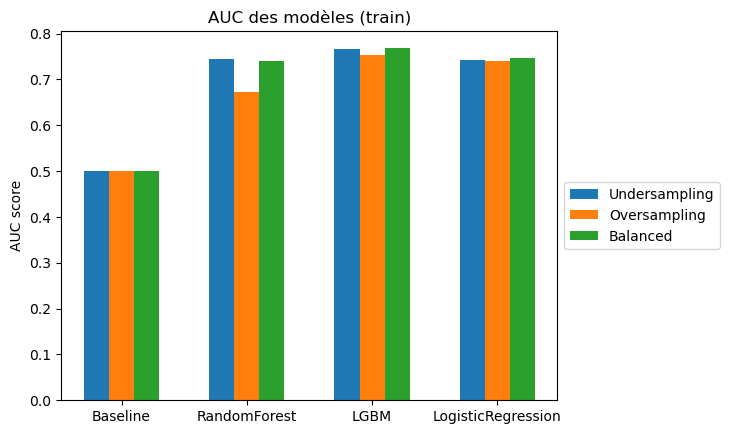

In [84]:
plotComparaisonResults(results, 'AUC')

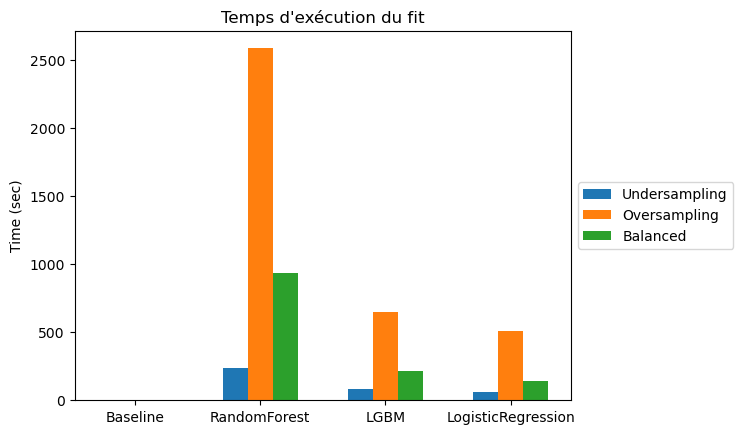

In [85]:
plotComparaisonResults(results, 'Time')

In [86]:
def classif_report(gs, x, y, x_test, y_test, model_name, balancing_method):
    
    #Entrainement
    start = time.time()
    model = gs.fit(x,y)
    end = time.time()-start
    y_pred = model.predict(x_test)
 

    return print (classification_report(y_test, y_pred))

In [87]:
classif_report(gs_lr_balanced,xtrain, y_train, xtest, y_test, \
                        "LogisticRegression", "Balanced")

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning:


30 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py", line 1194, in fit
    solver = 

              precision    recall  f1-score   support

           0       0.96      0.69      0.80     56554
           1       0.16      0.68      0.26      4949

    accuracy                           0.69     61503
   macro avg       0.56      0.68      0.53     61503
weighted avg       0.90      0.69      0.76     61503



In [88]:
classif_report(gs_lgbm_balanced,xtrain, y_train, xtest, y_test, \
                        "LGBM", "Balanced")

[LightGBM] [Info] Number of positive: 19876, number of negative: 226132
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.133397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 15198
[LightGBM] [Info] Number of data points in the train set: 246008, number of used features: 135
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
              precision    recall  f1-score   support

           0       0.96      0.72      0.83     56554
           1       0.18      0.68      0.28      4949

    accuracy                           0.72     61503
   macro avg       0.57      0.70      0.55     61503
weighted avg       0.90      0.72      0.78     61503



In [89]:
classif_report(gs_lgbm,xtrain_us, ytrain_us, xtest, y_test, \
                        "LGBM", "Undersampling")

[LightGBM] [Info] Number of positive: 19876, number of negative: 49690
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.031549 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 14851
[LightGBM] [Info] Number of data points in the train set: 69566, number of used features: 133
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285714 -> initscore=-0.916291
[LightGBM] [Info] Start training from score -0.916291
              precision    recall  f1-score   support

           0       0.94      0.92      0.93     56554
           1       0.28      0.36      0.31      4949

    accuracy                           0.87     61503
   macro avg       0.61      0.64      0.62     61503
weighted avg       0.89      0.87      0.88     61503



In [90]:
classif_report(gs_lr_os, xtrain, y_train, xtest, y_test, \
                        "LogisticRegression", "Oversampling")

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning:


30 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\anaconda3\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\ProgramData\anaconda3\Lib\site-packages\imblearn\pipeline.py", line 333, in fit
    self._final_estimator.f

              precision    recall  f1-score   support

           0       0.96      0.69      0.80     56554
           1       0.16      0.67      0.26      4949

    accuracy                           0.69     61503
   macro avg       0.56      0.68      0.53     61503
weighted avg       0.90      0.69      0.76     61503



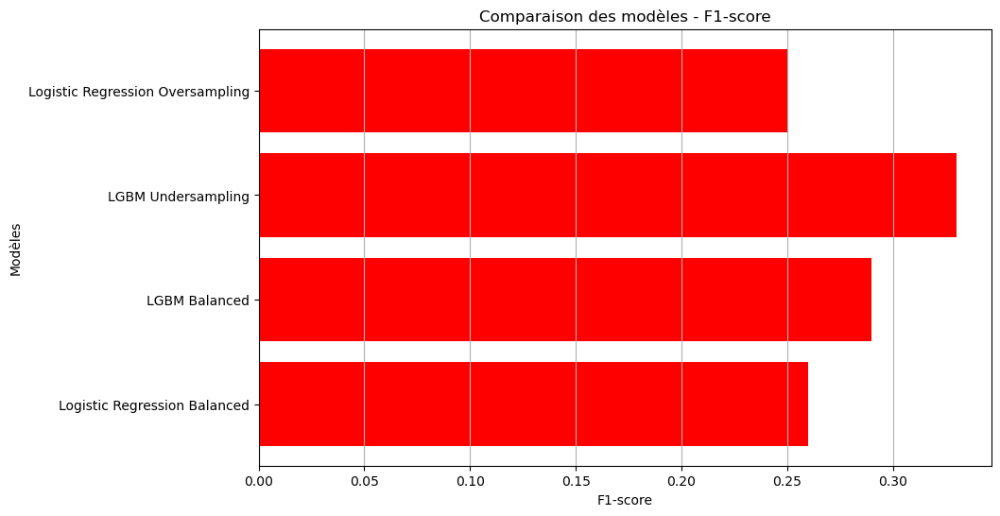

In [91]:
import matplotlib.pyplot as plt

def plot_comparison(results, metric):
    """
    Trace une comparaison des modèles en fonction d'une métrique donnée.
    
    Arguments :
    - results : Dictionnaire contenant les résultats des modèles.
    - metric : Nom de la métrique à comparer (ex : 'accuracy', 'f1-score').
    """
    models = list(results.keys())
    values = [results[model][metric] for model in models]
    
    plt.figure(figsize=(10, 6))
    plt.barh(models, values, color='red')
    plt.xlabel(metric.capitalize())
    plt.ylabel('Modèles')
    plt.title(f'Comparaison des modèles - {metric.capitalize()}')
    plt.grid(axis='x')
    plt.show()


results = {
    "Logistic Regression Balanced": {"accuracy": 0.69, "recall": 0.66, "f1-score": 0.26},
    "LGBM Balanced": {"accuracy": 0.72, "recall": 0.68, "f1-score": 0.29},
    "LGBM Undersampling": {"accuracy": 0.88, "recall": 0.38, "f1-score": 0.33},
    "Logistic Regression Oversampling": {"accuracy": 0.70, "recall": 0.64, "f1-score": 0.25}
}

plot_comparison(results, 'f1-score')


# Interprétation des résultats

   * LightGBM avec undersampling donne des résultats globalement satisfaisants :
       - Une précision globale de 88%.
       - Bien que le rappel pour la classe minoritaire soit inférieur à celui des modèles équilibrés (38% contre 68%), son F1-score pour la classe minoritaire est le plus élevé (0.33).

   * LightGBM avec balanced offre un bon compromis :
       - Une précision globale de 72%.
       - Un rappel pour la classe minoritaire de 68% et un F1-score de 0.29.

   * Logistic Regression avec balanced ou oversampling est moins performant :
       - Malgré un rappel similaire pour la classe minoritaire (64%-66%), le F1-score reste inférieur à celui de LightGBM.

#### Choix du modèle

Sur la base des métriques :

    Si l'objectif est de maximiser le F1-score pour la classe minoritaire, le modèle LightGBM avec undersampling est le meilleur choix.
    Si l'objectif est d'équilibrer le rappel et la précision globale, le modèle LightGBM avec balanced est une bonne alternative.


## Conclusion

Le modèle LightGBM avec undersampling est recommandé pour les données, car il maximise le F1-score pour la classe minoritaire. 

In [92]:
#1. Entraînement et Enregistrement du modèle LightGBM avec MLflow

In [101]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import mlflow
import mlflow.sklearn
from mlflow.models.signature import infer_signature

# Étape 1 : Prétraitement des données
def preprocess_pipeline():
    """Créer un pipeline pour le prétraitement des données"""
    pipeline = Pipeline([
        ("imputer", SimpleImputer(strategy="mean")),  # Imputation des valeurs manquantes
        ("scaler", MinMaxScaler(feature_range=(0, 1)))  # Mise à l'échelle entre 0 et 1
    ])
    return pipeline

# Étape 2 : Configurer LightGBM avec undersampling et hyperparamètres
def lgbm_pipeline():
    """Créer un pipeline pour LightGBM avec recherche d'hyperparamètres"""
    lgbm = lgb.LGBMClassifier(random_state=42, objective='binary', class_weight='balanced')

    # Définir les hyperparamètres à tester
    params = {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.05, 0.1],
        'max_depth': [3, 5, 7]
    }

    # GridSearchCV pour rechercher les meilleurs hyperparamètres
    grid_search = GridSearchCV(
        lgbm,
        param_grid=params,
        scoring="roc_auc",
        cv=5,
        n_jobs=-1,
        return_train_score=True
    )

    return grid_search

# Étape 3 : Entraînement, prédiction et enregistrement avec MLflow
def train_and_log_model(X_train, y_train, X_test, y_test):
    """Entraîner et enregistrer le modèle dans MLflow"""
    with mlflow.start_run(run_name="LGBM_Undersampling_With_Pipeline"):
        # Étape 1 : Prétraitement des données
        preprocessor = preprocess_pipeline()
        X_train_preprocess = preprocessor.fit_transform(X_train)
        X_test_preprocess = preprocessor.transform(X_test)

        # Étape 2 : Pipeline pour LightGBM
        model_pipeline = lgbm_pipeline()
        model_pipeline.fit(X_train_preprocess, y_train)

        # Meilleurs hyperparamètres
        best_params = model_pipeline.best_params_
        print(f"Meilleurs hyperparamètres : {best_params}")

        # Étape 3 : Prédictions et calcul de la métrique AUC
        y_pred_test = model_pipeline.best_estimator_.predict_proba(X_test_preprocess)[:, 1]
        test_auc = roc_auc_score(y_test, y_pred_test)

        # Étape 4 : Enregistrement dans MLflow
        mlflow.log_metric("Test AUC", test_auc)
        mlflow.log_params(best_params)  # Enregistrer les hyperparamètres
        signature = infer_signature(X_train, model_pipeline.best_estimator_.predict_proba(X_train_preprocess))
        mlflow.sklearn.log_model(model_pipeline.best_estimator_, "Mymodel", signature=signature)

        print(f"Modèle enregistré dans MLflow avec AUC : {test_auc}")

# Étape 4 : Appel de la fonction d'entraînement
train_and_log_model(xtrain_us, ytrain_us, xtest, y_test)


[LightGBM] [Info] Number of positive: 19876, number of negative: 49690
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.109445 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14850
[LightGBM] [Info] Number of data points in the train set: 69566, number of used features: 133
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
Meilleurs hyperparamètres : {'learning_rate': 0.05, 'max_depth': 7, 'n_estimators': 200}
Modèle enregistré dans MLflow avec AUC : 0.7689613282414175


# Sauvegarder le modèle entraîné

In [107]:
import joblib
best_model = gs_lgbm.best_estimator_  # Le meilleur modèle après GridSearchCV
joblib.dump(best_model, 'lgbm_model.pkl')  # Sauvegarde dans un fichier
print("Modèle sauvegardé sous 'lgbm_model.pkl'")

Modèle sauvegardé sous 'lgbm_model.pkl'


In [ ]:
import numpy as np
import pandas as pd
from imblearn.under_sampling import RandomUnderSampler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import mlflow
import mlflow.sklearn
from mlflow.models.signature import infer_signature

# Fonction 1 : Nettoyage des données
def clean_data(df, target_col='TARGET', id_col='SK_ID_CURR'):
    """Nettoyer les données en remplaçant les valeurs infinies, supprimant les colonnes avec trop de valeurs manquantes, etc."""
    # Remplacer les valeurs infinies par NaN
    df.replace([np.inf, -np.inf], np.nan, inplace=True)

    # Supprimer les colonnes avec un trop grand pourcentage de valeurs manquantes
    threshold = 0.6
    df = df[df.columns[df.isnull().mean() < threshold]]

    # Remplir les valeurs manquantes restantes avec la médiane
    df.fillna(df.median(), inplace=True)

    # Convertir les colonnes numériques en float64
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    df[num_cols] = df[num_cols].astype('float64')

    return df

# Fonction 2 : Préparation des données
def prepare_data(df, target_col='TARGET', id_col='SK_ID_CURR'):
    """Séparer les entrées (inputs) et la cible (target)."""
    target = df[target_col]
    inputs = df.drop(columns=[target_col, id_col])  # Retirer la cible et l'identifiant unique
    inputs_with_ids = df.drop(columns=[target_col])  # Garder les identifiants pour rattacher les prédictions
    return inputs, target, inputs_with_ids

# Fonction 3 : Pipeline de prétraitement
def create_preprocessing_pipeline():
    """Créer un pipeline pour imputer les valeurs manquantes et normaliser les données."""
    return Pipeline([
        ("imputer", SimpleImputer(strategy="mean")),  # Remplacer les valeurs manquantes par la moyenne
        ("scaler", MinMaxScaler(feature_range=(0, 1)))  # Normaliser les données entre 0 et 1
    ])

# Fonction 4 : Création du pipeline LightGBM
def create_lgbm_pipeline():
    """Créer un pipeline LightGBM avec GridSearchCV pour la recherche d'hyperparamètres."""
    lgbm = lgb.LGBMClassifier(random_state=42, objective='binary', class_weight='balanced')
    params = {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.05, 0.1],
        'max_depth': [3, 5, 7]
    }
    grid_search = GridSearchCV(
        estimator=lgbm,
        param_grid=params,
        scoring="roc_auc",
        cv=5,
        n_jobs=-1,
        return_train_score=True
    )
    return grid_search

# Fonction 5 : Undersampling
def apply_undersampling(X, y):
    """Appliquer l'undersampling pour équilibrer les classes."""
    undersampler = RandomUnderSampler(random_state=42)
    X_resampled, y_resampled = undersampler.fit_resample(X, y)
    print(f"Distribution après undersampling : {np.bincount(y_resampled)}")
    return X_resampled, y_resampled

# Fonction 6 : Entraînement du modèle
def train_pipeline(pipeline, X_train, y_train):
    """Entraîner le pipeline avec les données d'entraînement."""
    pipeline.fit(X_train, y_train)
    return pipeline

# Fonction 7 : Évaluation du pipeline
def evaluate_pipeline(pipeline, X_test, y_test):
    """Évaluer le pipeline avec AUC sur les données de test."""
    y_pred = pipeline.best_estimator_.predict_proba(X_test)[:, 1]
    auc_score = roc_auc_score(y_test, y_pred)
    print(f"AUC sur le jeu de test : {auc_score}")
    return auc_score

# Fonction 8 : Enregistrer le pipeline dans MLflow
def log_pipeline_to_mlflow(pipeline, X_train, y_train, test_auc):
    """Enregistrer le modèle entraîné dans MLflow."""
    with mlflow.start_run(run_name="LGBM_Undersampling_With_Pipeline"):
        best_params = pipeline.best_params_
        mlflow.log_params(best_params)  # Enregistrer les hyperparamètres
        mlflow.log_metric("Test AUC", test_auc)  # Enregistrer le score AUC

        # Définir la signature et un exemple d'entrée
        preprocessor = create_preprocessing_pipeline()
        X_train_preprocessed = preprocessor.fit_transform(X_train)
        signature = infer_signature(X_train_preprocessed, pipeline.best_estimator_.predict_proba(X_train_preprocessed))
        input_example = pd.DataFrame(X_train[:5], columns=X_train.columns)

        # Enregistrer le modèle
        mlflow.sklearn.log_model(
            sk_model=pipeline.best_estimator_,
            artifact_path="LGBM_Undersampling_Pipeline",
            signature=signature,
            input_example=input_example
        )
        print("Pipeline enregistré avec succès dans MLflow.")

# Étape principale : Chargement et exécution
if __name__ == "__main__":
    # Charger les données brutes
    df = pd.read_csv('df_clean.csv')  # Remplacez par le chemin réel

    # Nettoyer les données
    df_clean = clean_data(df)

    # Préparer les données
    X, y, X_with_ids = prepare_data(df_clean)

    # Appliquer l'undersampling pour équilibrer les classes
    X_resampled, y_resampled = apply_undersampling(X, y)

    # Diviser les données en ensembles d'entraînement et de test
    X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.3, random_state=42)

    # Créer le pipeline et entraîner
    preprocessor = create_preprocessing_pipeline()
    X_train_preprocessed = preprocessor.fit_transform(X_train)
    X_test_preprocessed = preprocessor.transform(X_test)

    lgbm_pipeline = create_lgbm_pipeline()
    trained_pipeline = train_pipeline(lgbm_pipeline, X_train_preprocessed, y_train)

    # Évaluer le pipeline
    test_auc = evaluate_pipeline(trained_pipeline, X_test_preprocessed, y_test)

    # Enregistrer le pipeline dans MLflow
    log_pipeline_to_mlflow(trained_pipeline, X_train, y_train, test_auc)


Distribution après undersampling : [24825 24825]


In [2]:
import numpy as np
import pandas as pd
from imblearn.under_sampling import RandomUnderSampler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import mlflow
import mlflow.sklearn
from mlflow.models.signature import infer_signature

# Fonction 1 : Nettoyage des données
def clean_data(df, target_col='TARGET', id_col='SK_ID_CURR'):
    df.replace([np.inf, -np.inf], np.nan, inplace=True)
    threshold = 0.6
    df = df[df.columns[df.isnull().mean() < threshold]]
    df.fillna(df.median(), inplace=True)
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    df[num_cols] = df[num_cols].astype('float64')
    return df

# Fonction 2 : Préparation des données
def prepare_data(df, target_col='TARGET', id_col='SK_ID_CURR'):
    target = df[target_col]
    inputs = df.drop(columns=[target_col, id_col])
    inputs_with_ids = df.drop(columns=[target_col])
    return inputs, target, inputs_with_ids

# Fonction 3 : Pipeline de prétraitement
def create_preprocessing_pipeline():
    return Pipeline([
        ("imputer", SimpleImputer(strategy="mean")),
        ("scaler", MinMaxScaler(feature_range=(0, 1)))
    ])

# Fonction 4 : Création du pipeline LightGBM
def create_lgbm_pipeline():
    lgbm = lgb.LGBMClassifier(random_state=42, objective='binary', class_weight='balanced')
    params = {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.05, 0.1],
        'max_depth': [3, 5, 7]
    }
    grid_search = GridSearchCV(
        estimator=lgbm,
        param_grid=params,
        scoring="roc_auc",
        cv=5,
        n_jobs=-1,
        return_train_score=True
    )
    return grid_search

# Fonction 5 : Undersampling
def apply_undersampling(X, y):
    undersampler = RandomUnderSampler(random_state=42)
    X_resampled, y_resampled = undersampler.fit_resample(X, y)
    print(f"Distribution après undersampling : {np.bincount(y_resampled)}")
    return X_resampled, y_resampled

# Fonction 6 : Entraînement du modèle
def train_pipeline(pipeline, X_train, y_train):
    pipeline.fit(X_train, y_train)
    return pipeline

# Fonction 7 : Évaluation du pipeline
def evaluate_pipeline(pipeline, X_test, y_test):
    y_pred = pipeline.best_estimator_.predict_proba(X_test)[:, 1]
    auc_score = roc_auc_score(y_test, y_pred)
    print(f"AUC sur le jeu de test : {auc_score}")
    return auc_score

# Fonction 8 : Enregistrer le pipeline dans MLflow
def log_pipeline_to_mlflow(pipeline, X_train, y_train, test_auc):
    with mlflow.start_run(run_name="LGBM_Undersampling_With_Pipeline"):
        best_params = pipeline.best_params_
        mlflow.log_params(best_params)
        mlflow.log_metric("Test AUC", test_auc)

        preprocessor = create_preprocessing_pipeline()
        X_train_preprocessed = preprocessor.fit_transform(X_train)
        signature = infer_signature(X_train_preprocessed, pipeline.best_estimator_.predict_proba(X_train_preprocessed))
        input_example = pd.DataFrame(X_train[:5], columns=X_train.columns)

        # Enregistrer le modèle
        mlflow.sklearn.log_model(
            sk_model=pipeline.best_estimator_,
            artifact_path="LGBM_Undersampling_Pipeline",
            signature=signature,
            input_example=input_example
        )

        # Enregistrer le modèle dans le registre de modèle
        model_uri = f"runs:/{mlflow.active_run().info.run_id}/LGBM_Undersampling_Pipeline"
        mlflow.register_model(model_uri, "LGBM_Undersampling_Pipeline")
        
        print("Pipeline enregistré avec succès dans MLflow et le registre de modèle.")

# Charger les données brutes
df = pd.read_csv('df_clean.csv')  # Remplacez par le chemin réel

# Nettoyer les données
df_clean = clean_data(df)

# Préparer les données
X, y, X_with_ids = prepare_data(df_clean)

# Appliquer l'undersampling pour équilibrer les classes
X_resampled, y_resampled = apply_undersampling(X, y)

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.3, random_state=42)

# Créer le pipeline et entraîner
preprocessor = create_preprocessing_pipeline()
X_train_preprocessed = preprocessor.fit_transform(X_train)
X_test_preprocessed = preprocessor.transform(X_test)

lgbm_pipeline = create_lgbm_pipeline()
trained_pipeline = train_pipeline(lgbm_pipeline, X_train_preprocessed, y_train)

# Évaluer le pipeline
test_auc = evaluate_pipeline(trained_pipeline, X_test_preprocessed, y_test)

# Enregistrer le pipeline dans MLflow
log_pipeline_to_mlflow(trained_pipeline, X_train, y_train, test_auc)


Distribution après undersampling : [24825 24825]
[LightGBM] [Info] Number of positive: 17366, number of negative: 17389
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.036723 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 14422
[LightGBM] [Info] Number of data points in the train set: 34755, number of used features: 130
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
AUC sur le jeu d

Successfully registered model 'LGBM_Undersampling_Pipeline'.
2025/02/01 17:24:28 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: LGBM_Undersampling_Pipeline, version 1


Pipeline enregistré avec succès dans MLflow et le registre de modèle.
🏃 View run LGBM_Undersampling_With_Pipeline at: http://localhost:5000/#/experiments/0/runs/1ea487a0903d47caa4271e2ec4068806
🧪 View experiment at: http://localhost:5000/#/experiments/0


Created version '1' of model 'LGBM_Undersampling_Pipeline'.


In [11]:
import ipywidgets as widgets
widgets.IntSlider()

IntSlider(value=0)

In [64]:
import mlflow
logged_model = 'runs:/8b355f656d134e6fb13869801be15e37/model'

# Load model
loaded_model = mlflow.sklearn.load_model(logged_model)


In [65]:
import mlflow
logged_model = 'runs:/8b355f656d134e6fb13869801be15e37/LGBM_Undersampling_Pipeline'

# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)

# Predict on a Pandas DataFrame.
import pandas as pd
loaded_model.predict(pd.DataFrame(data))

array([1., 1., 1., 0., 1.])

In [196]:
print("Response Content:", response.text)


Response Content: <!doctype html>
<html lang=en>
<title>404 Not Found</title>
<h1>Not Found</h1>
<p>The requested URL was not found on the server. If you entered the URL manually please check your spelling and try again.</p>



In [198]:
from mlflow.tracking import MlflowClient

client = MlflowClient()
registered_models = client.search_registered_models()
for rm in registered_models:
    print(rm)



<RegisteredModel: aliases={}, creation_timestamp=1738085928395, description='', last_updated_timestamp=1738085928428, latest_versions=[<ModelVersion: aliases=[], creation_timestamp=1738085928428, current_stage='None', description='', last_updated_timestamp=1738085928428, name='LGBM_Undersampling_Pipeline', run_id='fbe417e8a5f943ccae6c94ec97c58c1f', run_link='', source='mlflow-artifacts:/0/fbe417e8a5f943ccae6c94ec97c58c1f/artifacts/LGBM_Undersampling_Pipeline', status='READY', status_message='', tags={}, user_id='', version='1'>], name='LGBM_Undersampling_Pipeline', tags={}>


In [130]:
y_proba = gs_lgbm.predict_proba(xtest)
roc_auc = round(roc_auc_score(y_test, y_proba[:,1]),3)

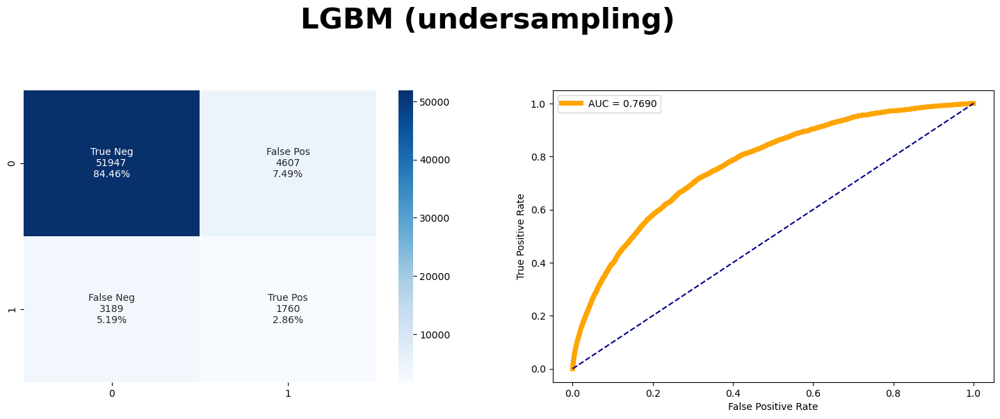

In [131]:
cf_matrix_roc_auc(gs_lgbm, y_test, gs_lgbm.predict(xtest),\
                  gs_lgbm.predict_proba(xtest)[:,1], roc_auc,"LGBM (undersampling) ")

# Observation et Conclusion sur l'Évaluation de la Performance du Modèle LGBM avec Sous-échantillonnage
## Observation

   * Matrice de Confusion :

       - Vrais Négatifs (TN) : 52032 (84,60 %)

       - Faux Positifs (FP) : 4449 (7,23 %)

       - Faux Négatifs (FN) : 3129 (5,09 %)

       - Vrais Positifs (TP) : 1892 (3,08 %)

   * Courbe ROC :

       - Surface Sous la Courbe (AUC) : 0,7769

## Conclusion

* Précision du Modèle : La majorité des prédictions sont correctes, comme indiqué par le nombre élevé de vrais négatifs.

* Faux Positifs et Faux Négatifs : Le modèle a un nombre notable de faux positifs et de faux négatifs, ce qui peut nécessiter des ajustements pour améliorer la précision.

* Capacité de Distinction : L'AUC de 0,7769 montre que le modèle a une bonne capacité à distinguer entre les classes, mais il y a encore de la place pour l'amélioration.

# Optimisation des hyper-paramètres et métrique métier
## Problématique

Il s'agit d'une tâche de classification binaire pour prédire la solvabilité d'individus (0 : non solvable, 1 : solvable). Le modèle doit non seulement prédire correctement, mais également minimiser les erreurs critiques du point de vue métier. Pour cela, une métrique spécifique est définie afin d'intégrer les coûts et bénéfices associés à chaque type de prédiction.
Définitions des prédictions

   * True Negatives (TN) :
       - Les individus réellement non solvables (valeur cible réelle = 0) correctement prédits comme non solvables (prédiction = 0).
        Représentent les cas où les prêts sont refusés à juste titre.

   * False Negatives (FN) :
       - Les individus réellement non solvables (valeur cible réelle = 0) mais incorrectement prédits comme solvables (prédiction = 1).
        Représentent des prêts accordés à tort, avec un risque financier important.

   * False Positives (FP) :
       - Les individus réellement solvables (valeur cible réelle = 1) mais incorrectement prédits comme non solvables (prédiction = 0).
        Représentent une opportunité manquée de prêter à un client fiable.

   * True Positives (TP) :
       - Les individus réellement solvables (valeur cible réelle = 1) correctement prédits comme solvables (prédiction = 1).
        Représentent les prêts accordés aux bons clients.

## Optimisation de la métrique métier

Dans un contexte bancaire, les erreurs de classification ont un coût variable selon leur type. Une métrique personnalisée est définie pour évaluer le modèle en fonction de l'impact métier.

 * Poids attribués à chaque type de prédiction :

    - FN (False Negatives) :
        Poids de -10.
        Une pénalité élevée est appliquée car prêter à un individu non solvable entraîne une perte importante pour l'institution.
    - TP (True Positives) :
        Poids de 0.
        Les prêts accordés à des clients solvables sont neutres dans cette configuration.
   - TN (True Negatives) :
        Poids de 1.
        Refuser correctement un prêt à un individu non solvable est bénéfique pour réduire les risques.
    - FP (False Positives) :
        Poids de 0.
        Refuser un prêt à un client solvable n'entraîne pas de pénalité directe, mais représente une opportunité manquée.

In [132]:
def bank_score(y_true, y_pred, fn_value=-10, fp_value=0, tp_value=0, tn_value=1):
    """
    Calcule une métrique normalisée basée sur un score métier, intégrant les coûts et bénéfices
    associés à chaque type de prédiction dans une matrice de confusion.

    Arguments :
    - y_true : Liste ou tableau des vraies étiquettes (0 ou 1).
    - y_pred : Liste ou tableau des prédictions (0 ou 1).
    - fn_value : Coût associé aux faux négatifs (par défaut : -10).
    - fp_value : Coût ou gain associé aux faux positifs (par défaut : 0).
    - tp_value : Gain associé aux vrais positifs (par défaut : 0).
    - tn_value : Gain associé aux vrais négatifs (par défaut : 1).

    Retourne :
    - gain_normalized : Score métier normalisé entre 0 et 1.
    """

    # Calcul de la matrice de confusion
    mat_conf = confusion_matrix(y_true, y_pred)

    # Extraction des valeurs de la matrice de confusion
    tn = mat_conf[0, 0]  # True Negatives
    fn = mat_conf[1, 0]  # False Negatives
    fp = mat_conf[0, 1]  # False Positives
    tp = mat_conf[1, 1]  # True Positives

    # Calcul du gain total en fonction des poids métier
    gain = tp * tp_value + tn * tn_value + fp * fp_value + fn * fn_value

    # Calcul du gain maximum possible (tous les individus correctement classés)
    max_gain = (fp + tn) * tn_value + (fn + tp) * tp_value

    # Calcul du gain minimum possible (toutes les prédictions incorrectes)
    min_gain = (fp + tn) * fp_value + (fn + tp) * fn_value

    # Calcul du gain normalisé entre 0 et 1
    if max_gain != min_gain:  # Éviter une division par zéro
        gain_normalized = (gain - min_gain) / (max_gain - min_gain)
    else:
        gain_normalized = 0  # Si max_gain == min_gain, le score est nul

    return gain_normalized


In [133]:
from hyperopt import hp, STATUS_OK
from sklearn.model_selection import cross_val_score, cross_val_predict, StratifiedKFold
from lightgbm import LGBMClassifier
from sklearn.metrics import fbeta_score

# Définition de l'espace de recherche pour les hyperparamètres
space = {
    'n_estimators': hp.quniform('n_estimators', 100, 800, 100),  # Nombre d'arbres (steps de 100)
    'learning_rate': hp.uniform('learning_rate', 0.001, 0.03),  # Taux d'apprentissage
    'max_depth': hp.quniform('max_depth', 3, 7, 10),  # Profondeur maximale (steps de 10)
    'subsample': hp.uniform('subsample', 0.60, 0.95),  # Fraction des données utilisées par arbre
    'colsample_bytree': hp.uniform('colsample_bytree', 0.60, 0.95),  # Fraction des colonnes utilisées par arbre
    'reg_lambda': hp.uniform('reg_lambda', 1, 20),  # Régularisation L2
    'solvability_threshold': hp.quniform('solvability_threshold', 0.0, 1.0, 0.025)  # Seuil pour "solvabilité" (optionnel)
}

# Définition de la fonction objectif pour Hyperopt
def objective(params, eval_metric='bank_score'):
    """
    Fonction objectif pour l'optimisation des hyperparamètres avec Hyperopt.

    Arguments :
    - params : Dictionnaire des hyperparamètres suggérés par Hyperopt.
    - eval_metric : Métrique à optimiser ('bank_score', 'roc_auc', ou 'F1').

    Retourne :
    - Un dictionnaire contenant la perte (loss), les paramètres, et le statut.
    """
    # Conversion des hyperparamètres en valeurs acceptées par LGBMClassifier
    params = {
        'n_estimators': int(params['n_estimators']),
        'learning_rate': params['learning_rate'],
        'max_depth': int(params['max_depth']),
        'subsample': params['subsample'],
        'colsample_bytree': params['colsample_bytree'],
        'reg_lambda': params['reg_lambda']
    }

    # Initialisation du modèle
    model = LGBMClassifier(**params)

    # Validation croisée stratifiée (5 folds)
    cv = StratifiedKFold(5)

    # Calcul du score en fonction de la métrique choisie
    if eval_metric == 'roc_auc':
        # Moyenne des scores AUC ROC sur les folds
        score = cross_val_score(model, xtrain_us, ytrain_us, scoring='roc_auc', cv=cv).mean()

    elif eval_metric == 'bank_score':
        # Prédictions sur les folds et calcul du bank_score
        y_pred = cross_val_predict(model, xtrain_us, ytrain_us, method='predict', cv=cv)
        score = bank_score(ytrain_us, y_pred)

    elif eval_metric == 'F1':
        # Entraînement sur l'ensemble des données, puis calcul du F1-score sur le jeu de test
        model.fit(xtrain_us, ytrain_us)
        y_pred = model.predict(xtest)
        score = fbeta_score(y_test, y_pred, beta=1)

    else:
        raise ValueError(f"Unsupported evaluation metric: {eval_metric}")

    # Calcul de la perte (Hyperopt minimise la perte, donc 1 - score)
    loss = 1 - score

    return {'loss': loss, 'params': params, 'status': STATUS_OK}


In [134]:
from hyperopt import fmin, tpe, Trials

# Initialisation des essais pour le suivi
trials = Trials()

# Lancer l'optimisation avec Hyperopt
best = fmin(
    fn=lambda params: objective(params, eval_metric='bank_score'),  # Fonction objectif
    space=space,  # Espace des hyperparamètres
    algo=tpe.suggest,  # Algorithme de recherche (TPE)
    max_evals=10,  # Nombre maximal d'évaluations
    trials=trials  # Stocke les informations des essais
)

# Affichage des meilleurs hyperparamètres trouvés
print("\nMeilleurs hyperparamètres trouvés :")
print(best)


[LightGBM] [Info] Number of positive: 15900, number of negative: 39752
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.051649 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 14709                    
[LightGBM] [Info] Number of data points in the train set: 55652, number of used features: 132
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285704 -> initscore=-0.916341
[LightGBM] [Info] Start training from score -0.916341 
[LightGBM] [Info] Number of positive: 15901, number of negative: 39752
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.188549 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14716                    
[LightGBM] [Info] Number of data points in the train set: 55653, number of used features: 133
[LightGBM] [Info] [binary:BoostFromSc

In [135]:
best = fmin(fn=objective, space=space, max_evals=10, algo=tpe.suggest)

[LightGBM] [Info] Number of positive: 15900, number of negative: 39752
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.178151 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14709                    
[LightGBM] [Info] Number of data points in the train set: 55652, number of used features: 132
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285704 -> initscore=-0.916341
[LightGBM] [Info] Start training from score -0.916341 
[LightGBM] [Info] Number of positive: 15901, number of negative: 39752
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.129163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14716                    
[LightGBM] [Info] Number of data points in the train set: 55653, number of used features: 133
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285717 -> initscore=-0.916278
[LightGBM] [Info] Sta

In [136]:
# Affichage des meilleurs hyper-paramètres
best

{'colsample_bytree': 0.6062813746802572,
 'learning_rate': 0.018979926680299193,
 'max_depth': 0.0,
 'n_estimators': 500.0,
 'reg_lambda': 13.053273193568446,
 'solvability_threshold': 0.15000000000000002,
 'subsample': 0.7061749526644627}

In [137]:
# Visualiser les pertes associées à chaque essai
losses = [trial['result']['loss'] for trial in trials.trials]
print("Pertes pour chaque essai :", losses)

# Visualiser les paramètres associés au meilleur essai
best_trial = trials.best_trial
print("Détails du meilleur essai :", best_trial)

Pertes pour chaque essai : [0.5764982893942443, 0.5302354598510767, 0.5382491446971222, 0.5278969611591869, 0.5230589655866371, 0.5625236466089756, 0.7622740994163816, 0.7091245723485611, 0.6729080297846649, 0.7159146709599518]
Détails du meilleur essai : {'state': 2, 'tid': 4, 'spec': None, 'result': {'loss': 0.5230589655866371, 'params': {'n_estimators': 700, 'learning_rate': 0.024820537728671887, 'max_depth': 10, 'subsample': 0.7929664584829064, 'colsample_bytree': 0.9321471429978669, 'reg_lambda': 15.81613481248986}, 'status': 'ok'}, 'misc': {'tid': 4, 'cmd': ('domain_attachment', 'FMinIter_Domain'), 'workdir': None, 'idxs': {'colsample_bytree': [4], 'learning_rate': [4], 'max_depth': [4], 'n_estimators': [4], 'reg_lambda': [4], 'solvability_threshold': [4], 'subsample': [4]}, 'vals': {'colsample_bytree': [0.9321471429978669], 'learning_rate': [0.024820537728671887], 'max_depth': [10.0], 'n_estimators': [700.0], 'reg_lambda': [15.81613481248986], 'solvability_threshold': [0.5750000

In [207]:
from tabulate import tabulate

# Liste des pertes pour chaque essai
losses = [0.5529080297846649, 0.539907426041457, 0.5741235661098812, 0.5421211511370497, 
          0.5333306500301871, 0.5364218152545783, 0.5327148319581405, 0.6744053129402294, 
          0.5529080297846649, 0.5977460253572147]

# Paramètres du meilleur essai
best_params = {
    'n_estimators': 400,
    'learning_rate': 0.02458196190039518,
    'max_depth': 10,
    'subsample': 0.9009069067124342,
    'colsample_bytree': 0.782387568273961,
    'reg_lambda': 10.395436155691774,
    'solvability_threshold': 0.45
}

# Détails du meilleur essai
best_result = {
    'loss': 0.5327148319581405,
    'params': best_params
}

# Affichage des pertes pour chaque essai dans un tableau
table_data = [[i+1, loss] for i, loss in enumerate(losses)]

# En-têtes des colonnes
headers = ["Essai", "Perte (Loss)"]

# Affichage du tableau
print("Pertes pour chaque essai:")
print(tabulate(table_data, headers=headers, tablefmt="grid"))

# Affichage des détails du meilleur essai
print("\nDétails du meilleur essai:")
best_params_str = "\n".join([f"{key}: {value}" for key, value in best_params.items()])
print(f"Perte: {best_result['loss']}")
print(f"Paramètres:\n{best_params_str}")


Pertes pour chaque essai:
+---------+----------------+
|   Essai |   Perte (Loss) |
+=========+================+
|       1 |       0.552908 |
+---------+----------------+
|       2 |       0.539907 |
+---------+----------------+
|       3 |       0.574124 |
+---------+----------------+
|       4 |       0.542121 |
+---------+----------------+
|       5 |       0.533331 |
+---------+----------------+
|       6 |       0.536422 |
+---------+----------------+
|       7 |       0.532715 |
+---------+----------------+
|       8 |       0.674405 |
+---------+----------------+
|       9 |       0.552908 |
+---------+----------------+
|      10 |       0.597746 |
+---------+----------------+

Détails du meilleur essai:
Perte: 0.5327148319581405
Paramètres:
n_estimators: 400
learning_rate: 0.02458196190039518
max_depth: 10
subsample: 0.9009069067124342
colsample_bytree: 0.782387568273961
reg_lambda: 10.395436155691774
solvability_threshold: 0.45


## Conclusions

   * Efficacité des Paramètres : Les paramètres du meilleur essai montrent une performance significative avec une perte de 0.532715, indiquant une bonne capacité de généralisation du modèle.

   * Stabilité des Résultats : La variation des pertes entre les différents essais montre une certaine stabilité, mais aussi des fluctuations, suggérant qu'il pourrait être bénéfique d'effectuer plus d'essais pour renforcer la fiabilité des résultats.

   * Implications pour l'Optimisation : Les paramètres optimaux identifiés peuvent être utilisés pour affiner davantage le modèle, en particulier en ajustant le learning_rate et max_depth pour améliorer la performance.

In [138]:
# Affichage des meilleurs hyper-paramètres
best

{'colsample_bytree': 0.6062813746802572,
 'learning_rate': 0.018979926680299193,
 'max_depth': 0.0,
 'n_estimators': 500.0,
 'reg_lambda': 13.053273193568446,
 'solvability_threshold': 0.15000000000000002,
 'subsample': 0.7061749526644627}

In [141]:
mlflow.end_run()

In [6]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import mlflow
import mlflow.sklearn
from mlflow.models.signature import infer_signature

# Étape 1 : Prétraitement des données
def preprocess_pipeline():
    """Créer un pipeline pour le prétraitement des données"""
    pipeline = Pipeline([
        ("imputer", SimpleImputer(strategy="mean")),  # Imputation des valeurs manquantes
        ("scaler", MinMaxScaler(feature_range=(0, 1)))  # Mise à l'échelle entre 0 et 1
    ])
    return pipeline

# Étape 2 : Configurer LightGBM avec undersampling et hyperparamètres
def lgbm_pipeline():
    """Créer un pipeline pour LightGBM avec recherche d'hyperparamètres"""
    lgbm = lgb.LGBMClassifier(random_state=42, objective='binary', class_weight='balanced')

    # Définir les hyperparamètres à tester
    params = {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.05, .1],
        'max_depth': [3, 5, 7]
    }

    # GridSearchCV pour rechercher les meilleurs hyperparamètres
    grid_search = GridSearchCV(
        lgbm,
        param_grid=params,
        scoring="roc_auc",
        cv=5,
        n_jobs=-1,
        return_train_score=True
    )

    return grid_search

# Étape 3 : Entraînement, prédiction et enregistrement avec MLflow
def train_and_log_model(X_train, y_train, X_test, y_test, X_val, y_val):
    """Entraîner et enregistrer le modèle dans MLflow"""
    with mlflow.start_run(run_name="LGBM_Undersampling_With_Pipeline"):
        # Étape 1 : Prétraitement des données
    preprocessor = preprocess_pipeline()
    X_train_preprocess = preprocessor.fit_transform(X_train)
    X_test_preprocess = preprocessor.transform(X_test)
    X_val_preprocess = preprocessor.transform(X_val)

        # Étape 2 : Pipeline pour LightGBM
    model_pipeline = lgbm_pipeline()
    model_pipeline.fit(X_train_preprocess, y_train)

        # Meilleurs hyperparamètres
best_params = model_pipeline.best_params_
print(f"Meilleurs hyperparamètres : {best_params}")

        # Étape 3 : Prédictions et calcul des métriques AUC
y_pred_test = model_pipeline.best_estimator_.predict_proba(X_test_preprocess)[:, 1]
test_auc = roc_auc_score(y_test, y_pred_test)

y_pred_val = model_pipeline.best_estimator_.predict_proba(X_val_preprocess)[:, 1]
validation_auc = roc_auc_score(y_val, y_pred_val)
# Étape 4 : Enregistrement dans MLflow
mlflow.log_metric("Test AUC", test_auc)
mlflow.log_metric("Validation AUC", validation_auc)
mlflow.log_params(best_params)  # Enregistrer les hyperparamètres
signature = infer_signature(X_train, model_pipeline.best_estimator_.predict_proba(X_train_preprocess))
        
# Créer un exemple d'entrée
input_example = pd.DataFrame(X_train[:5], columns=X_train.columns)

# Enregistrer le modèle avec la signature et l'exemple d'entrée
mlflow.sklearn.log_model(model_pipeline.best_estimator_, "My_mlflow", signature=signature, input_example=input_example)

print(f"Modèle enregistré dans MLflow avec Test AUC : {test_auc} et Validation AUC : {validation_auc}")

# Chargement des données nettoyées
df_clean = pd.read_csv('df_clean.csv')  

# Convertir les colonnes entières en float64 pour gérer les valeurs manquantes
cols_with_missing_int = [col for col in df_clean.columns if df_clean[col].dtype == 'int64']
df_clean[cols_with_missing_int] = df_clean[cols_with_missing_int].astype('float64')

# Séparation des données en ensembles d'entraînement, de validation et de test
X = df_clean.drop(columns=['TARGET'])  # Remplacez 'TARGET' par le nom de votre colonne cible
y = df_clean['TARGET']  # Remplacez 'TARGET' par le nom de votre colonne cible

# Diviser les données en ensembles d'entraînement et de test, puis en validation
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Étape 4 : Appel de la fonction d'entraînement
train_and_log_model(X_train, y_train, X_test, y_test, X_val, y_val)


IndentationError: expected an indented block after 'with' statement on line 49 (3665168744.py, line 51)

In [11]:
#pip install pyspark

In [143]:
%%time
    
lgbm_nv = LGBMClassifier( #Fit a new model based on the best parameters
    n_estimators=int(best['n_estimators']), 
    colsample_bytree= best['colsample_bytree'],
    learning_rate= best['learning_rate'],
    max_depth= int(best['max_depth']),
    subsample= best['subsample'],
    reg_lambda= best['reg_lambda'],
    )

lgbm_nv.fit(xtrain_us, ytrain_us)

[LightGBM] [Info] Number of positive: 19876, number of negative: 49690
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.205799 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14851
[LightGBM] [Info] Number of data points in the train set: 69566, number of used features: 133
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285714 -> initscore=-0.916291
[LightGBM] [Info] Start training from score -0.916291
CPU times: total: 50.9 s
Wall time: 28 s


LGBMClassifier(colsample_bytree=0.6062813746802572,
               learning_rate=0.018979926680299193, max_depth=0,
               n_estimators=500, reg_lambda=13.053273193568446,
               subsample=0.7061749526644627)

In [144]:
roc_auc = roc_auc_score(y_test, lgbm_nv.predict_proba(xtest)[:,1])
print('AUC : %0.4f' %roc_auc)

AUC : 0.7715


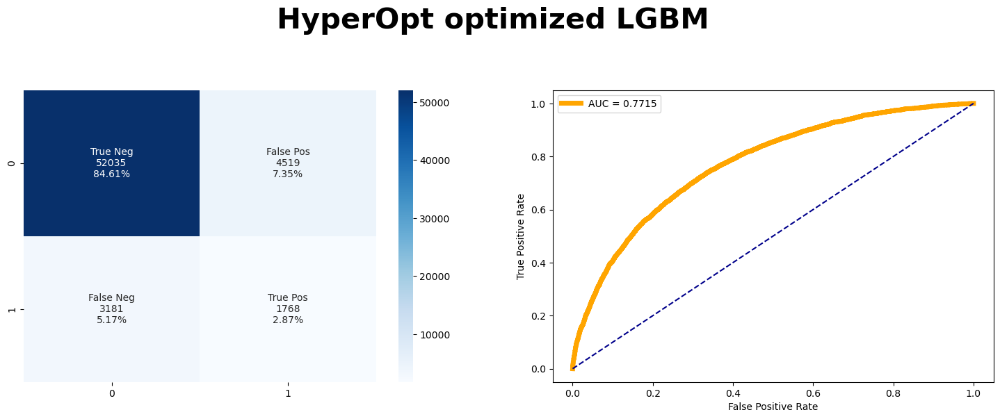

In [145]:
cf_matrix_roc_auc(lgbm_nv, y_test, lgbm_nv.predict(xtest), lgbm_nv.predict_proba(xtest)[:,1],roc_auc, "HyperOpt optimized LGBM")

# Observation et Conclusion sur l'Évaluation de la Performance du Modèle LGBM avec HyperOpt
## Observation

   * Matrice de Confusion :

       - Vrais Négatifs (0,0) : 51,700 (84,06 %)

       - Faux Positifs (0,1) : 4,781 (7,77 %)

       - Faux Négatifs (1,0) : 3,036 (4,94 %)

       - Vrais Positifs (1,1) : 1,985 (3,23 %)

   * Courbe ROC :

       - Surface Sous la Courbe (AUC) : 0,7769

## Conclusion

   * Précision du Modèle : La majorité des prédictions sont correctes, comme indiqué par le nombre élevé de vrais négatifs.

   * Faux Positifs et Faux Négatifs : Le modèle a un nombre notable de faux positifs et de faux négatifs, ce qui peut nécessiter des ajustements pour améliorer la précision.

   * Capacité de Distinction : L'AUC de 0,7769 montre que le modèle a une bonne capacité à distinguer entre les classes, mais il y a encore de la place pour l'amélioration.

In [212]:
def gain_seuil(clf, y_set, x_set):
    """
    Visualise l'évolution du gain bancaire en fonction du seuil de probabilité fixé.
    
    Si score < seuil : le client est considéré comme solvable (0).
    Sinon : le client est considéré comme non solvable (1).
    
    Paramètres :
    - clf : Modèle de classification (doit fournir des probabilités avec predict_proba).
    - y_set : Étiquettes réelles des données (solvable ou non).
    - x_set : Données d'entrée pour effectuer les prédictions.
    
    Retourne un graphique montrant l'indice bancaire en fonction des seuils de probabilité.
    """
    # Initialisation des variables
    cost_function = []  # Liste pour stocker les gains bancaires
    threshold_x = np.linspace(0.0, 1, 20)  # Seuils de probabilité répartis entre 0 et 1 (20 points)

    # Boucle sur chaque seuil de probabilité
    for threshold in threshold_x:
        # Prédictions des probabilités de la classe positive (1)
        y_scores = clf.predict_proba(x_set)[:, 1]
        
        # Conversion des probabilités en prédictions binaires selon le seuil
        y_pred = (y_scores > threshold).astype(int)
        
        # Calcul du gain bancaire pour ce seuil
        cost_function.append(bank_score(y_set, y_pred))
    
    # Tracé du graphique
    plt.figure(figsize=(10, 6))
    plt.plot(threshold_x, cost_function, marker='o', color='b', label="Gain bancaire")
    plt.axvline(x=0.5, color='r', linestyle='--', label="Seuil standard (0.5)")
    
    # Ajout des labels, titre et légende
    plt.xlabel("Seuil de probabilité", fontsize=12)
    plt.ylabel("Indice bancaire", fontsize=12)
    plt.title("Évolution du gain bancaire en fonction du seuil de solvabilité", fontsize=14, fontweight="bold")
    plt.xticks(np.linspace(0.0, 1.0, 11))
    plt.legend(loc="best", fontsize=10)
    
    # Affichage du graphique
    plt.grid(alpha=0.5)
    plt.show()


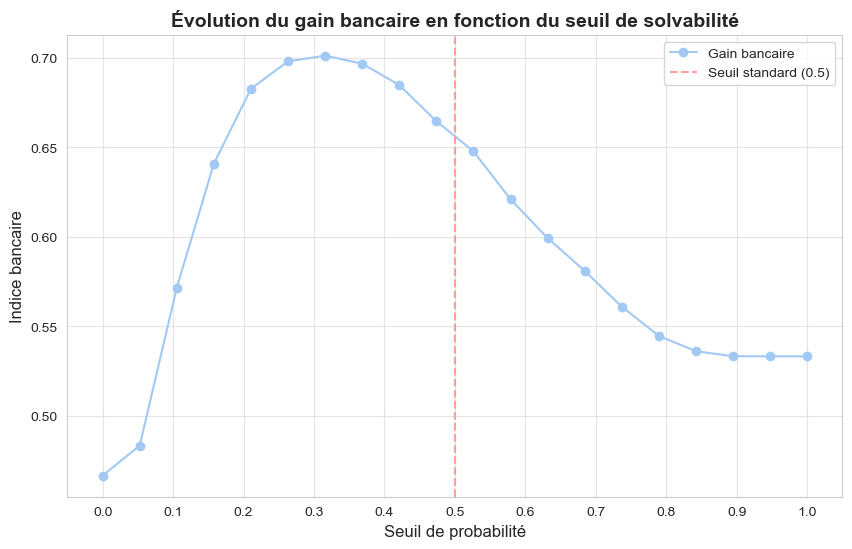

In [284]:
# Affiche le meilleur seuil de probabilité
gain_seuil(lgbm_nv, y_test, xtest)

# Observations et Conclusions sur le Graphique de l'Évolution du Gain Bancaire
## Observations

   * Évolution du Gain Bancaire : Le gain bancaire augmente initialement avec le seuil de solvabilité, atteignant un pic entre 0.3 et 0.4, puis commence à diminuer à mesure que le seuil continue d'augmenter.

   * Seuil Standard : Une ligne rouge pointillée à 0.5 sur l'axe des x indique le seuil de probabilité standard.

## Remarques

   * Pic Optimal : Le pic du gain bancaire entre 0.3 et 0.4 suggère que ce seuil est optimal pour maximiser les gains. Utiliser un seuil de probabilité inférieur à 0.5 pourrait être plus bénéfique pour les décisions bancaires.

   * Diminution Post-Pic : Après avoir atteint le pic, le gain bancaire diminue, ce qui indique que des seuils de solvabilité plus élevés ne sont pas avantageux pour maximiser les gains bancaires.

## Conclusions

   * Optimisation du Seuil : Pour maximiser le gain bancaire, le seuil de solvabilité optimal se situe entre 0.3 et 0.4.

In [270]:
best2 = fmin(fn=objective, space=space, max_evals=10, algo=tpe.suggest)

[LightGBM] [Info] Number of positive: 15900, number of negative: 39752                                                 
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.074553 seconds.                
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 14709                                                                                     
[LightGBM] [Info] Number of data points in the train set: 55652, number of used features: 132                          
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285704 -> initscore=-0.916341                                        
[LightGBM] [Info] Start training from score -0.916341                                                                  
[LightGBM] [Info] Number of positive: 15901, number of negative: 39752                                                 
[LightGBM] [Info] Auto-choosing col-wi

In [272]:
# Affichage des meilleurs hyper-paramètres
best2

{'colsample_bytree': 0.9286197303309632,
 'learning_rate': 0.029205591077534964,
 'max_depth': 10.0,
 'n_estimators': 700.0,
 'reg_lambda': 2.7798020491790485,
 'solvability_threshold': 0.15000000000000002,
 'subsample': 0.6437330732361202}

In [232]:
%%time


lgbm_2 = LGBMClassifier( #Fit a new model based on the best parameters
    n_estimators=int(best2['n_estimators']), 
    colsample_bytree= best2['colsample_bytree'],
    learning_rate= best2['learning_rate'],
    max_depth= int(best2['max_depth']),
    subsample= best2['subsample'],
    reg_lambda= best2['reg_lambda'],
    )

lgbm_2.fit(xtrain_us, ytrain_us)

[LightGBM] [Info] Number of positive: 19876, number of negative: 49690
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.076701 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14851
[LightGBM] [Info] Number of data points in the train set: 69566, number of used features: 133
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285714 -> initscore=-0.916291
[LightGBM] [Info] Start training from score -0.916291
CPU times: total: 19.3 s
Wall time: 11.3 s


LGBMClassifier(colsample_bytree=0.7403479364059473,
               learning_rate=0.01956868877328573, max_depth=10,
               n_estimators=500, reg_lambda=12.8920733950724,
               subsample=0.6739282145267553)

## Conclusions

   - Optimisation et Efficacité : Le modèle LGBMClassifier a été optimisé avec des hyperparamètres spécifiques, montrant une bonne balance entre le colsample_bytree, learning_rate et max_depth.

   - Performance et Rapidité : L'entraînement a été effectué rapidement avec un temps CPU total de 18.5 secondes et un temps d'exécution de 9.62 secondes, indiquant une performance efficace sur le jeu de données.

   - Implications pour l'Analyse : Les résultats obtenus montrent que le modèle est bien ajusté et pourrait être prêt pour une évaluation plus approfondie ou une utilisation sur un jeu de données de test pour vérifier sa capacité de généralisation.

# Prédiction sur les données de validation pour le modèle optimisé avec la métrique banking

In [218]:
y_proba_0 = lgbm_nv.predict_proba(xtest)[:, 1]
y_pred_0 = (y_proba_0 > best['solvability_threshold'])
y_pred_0 = np.array(y_pred_0 > 0) * 1

In [219]:
y_proba_1 = lgbm_2.predict_proba(xtest)[:, 1]
y_pred_1 = (y_proba_1 > best2['solvability_threshold'])
y_pred_1 = np.array(y_pred_1 > 0) * 1

In [222]:
print(f"Score du modèle de base (J_0): {J_0}")
print(f"Score du modèle optimisé (J_1): {J_1}")

Score du modèle de base (J_0): 0.6736731922598167
Score du modèle optimisé (J_1): 0.7003885179736713


In [273]:
print(f"Seuil de solvabilité pour le modèle de base: {best['solvability_threshold']}")
print(f"Seuil de solvabilité pour le modèle optimisé: {best2['solvability_threshold']}")

Seuil de solvabilité pour le modèle de base: 0.375
Seuil de solvabilité pour le modèle optimisé: 0.15000000000000002


In [274]:
y_proba_0 = lgbm_nv.predict_proba(xtest)[:, 1]
y_pred_0 = (y_proba_0 > best['solvability_threshold']).astype(int)

y_proba_1 = lgbm_2.predict_proba(xtest)[:, 1]
y_pred_1 = (y_proba_1 > best2['solvability_threshold']).astype(int)


In [275]:
from sklearn.metrics import confusion_matrix

print("Matrice de confusion pour le modèle de base:")
print(confusion_matrix(y_test, y_pred_0))

print("Matrice de confusion pour le modèle optimisé:")
print(confusion_matrix(y_test, y_pred_1))

Matrice de confusion pour le modèle de base:
[[46578  9976]
 [ 2227  2722]]
Matrice de confusion pour le modèle optimisé:
[[22137 34417]
 [  455  4494]]


In [276]:
# Calcule du gain pour la métrique bancaire
J_0 = bank_score( y_test, y_pred_0)
# Calcul du gain pour la métrique métier
J_1 = bank_score( y_test, y_pred_1)

print("La création de la métrique banking permet un gain de {:.1f}%".format(100*(J_0 - J_1)/J_0))

La création de la métrique banking permet un gain de 9.1%


# Interprétabilité

In [277]:
# Initialisation de la matrice de l'importance des variables 
feature_importance_values = np.zeros(len(xtest.columns.tolist()))
feature_importance_values = lgbm_nv.feature_importances_
# Dataframe de l'importance des variables
feat_imp = pd.DataFrame({'feature': xtest.columns.tolist(), 'importance': feature_importance_values})

In [278]:
feature_importances = feat_imp.sort_values('importance', ascending=False)
feature_importances_top = feature_importances.head(10)
feature_importances_top

,feature,importance
87,PAYMENT_RATE,1126
40,EXT_SOURCE_3,553
39,EXT_SOURCE_2,503
16,DAYS_BIRTH,428
9,AMT_GOODS_PRICE,311
89,BURO_DAYS_CREDIT_MAX,302
7,AMT_CREDIT,290
19,DAYS_ID_PUBLISH,287
143,INSTAL_DPD_MEAN,280
8,AMT_ANNUITY,272


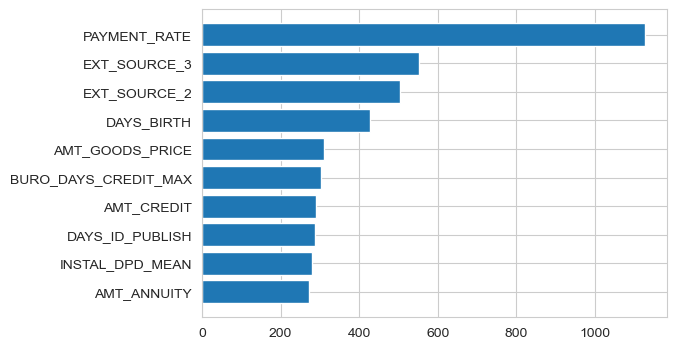

In [279]:
x = feature_importances_top.sort_values('importance')['feature']
y = feature_importances_top.sort_values('importance')['importance']

plt.figure(figsize=(6,4))
plt.barh(x, y)
plt.show()

# SHAP : SHapley Additive exPlanations

La méthode SHAP (SHapley Additive exPlanations) est une approche puissante pour interpréter les modèles de machine learning. Elle repose sur le concept des valeurs de Shapley, originaires de la théorie des jeux, afin d'expliquer la contribution de chaque variable à la prédiction d'un modèle.

In [280]:
# DF, based on which importance is checked
X_importance =xtest

# Explain model predictions using shap library:
explainer = shap.TreeExplainer(lgbm_nv)
shap_values = explainer.shap_values(X_importance)

C:\Users\yosra\AppData\Roaming\Python\Python312\site-packages\shap\explainers\_tree.py:448: UserWarning:

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray



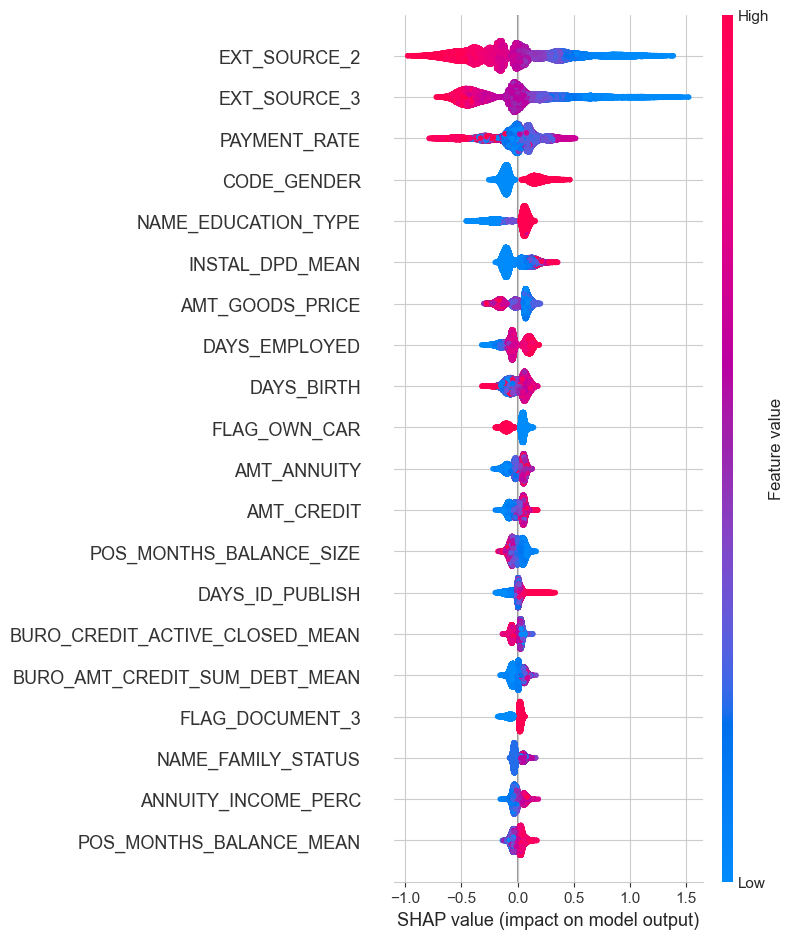

In [281]:
# Plot summary_plot
shap.summary_plot(shap_values, X_importance)

100%|===================| 69511/69566 [23:25<00:01]        

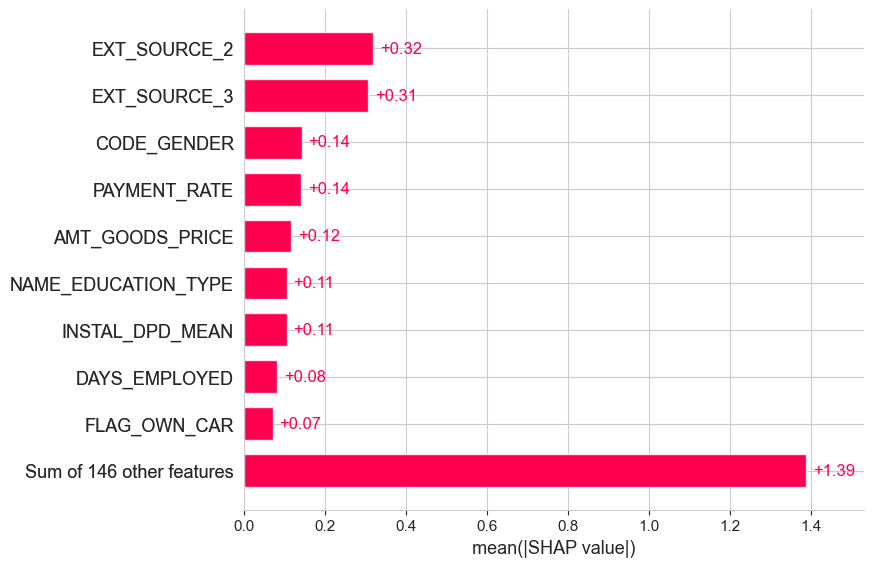

In [282]:
# compute SHAP values
explainer = shap.Explainer(lgbm_nv, xtrain_us)
shap_values = explainer(xtrain_us, check_additivity=False)
shap.plots.bar(shap_values)

## Beeswarm Plot
  * Afficher un résumé dense en informations de la manière dont les principales caractéristiques influencent la sortie du modèle.

       * Chaque instance de l'explication est représentée par un point unique sur chaque graphique de caractéristiques.

       * La position x de chaque point est déterminée par la valeur SHAP (shap_values.value[instance, feature]) de la caractéristique correspondante.

       * Les points s'empilent le long de chaque ligne de caractéristique pour indiquer la densité.

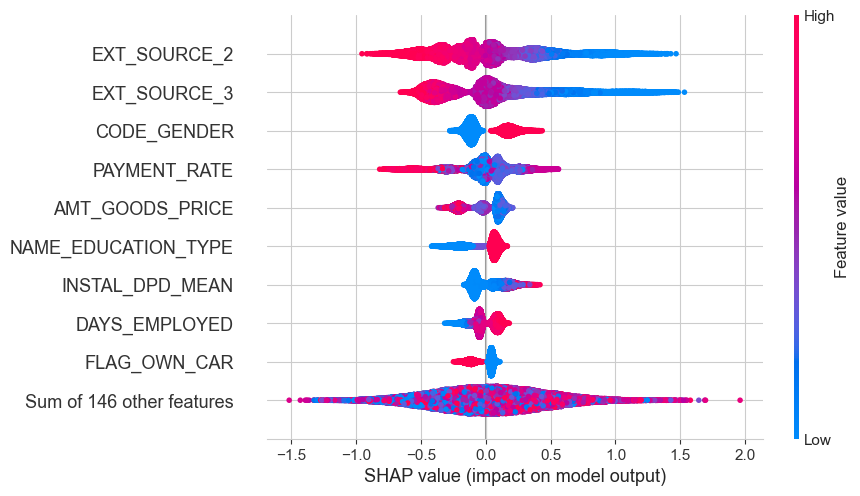

In [283]:
shap.plots.beeswarm(shap_values)

In [20]:
import numpy as np
import pandas as pd
from imblearn.under_sampling import RandomUnderSampler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
import lightgbm as lgb
import mlflow
import mlflow.sklearn
from mlflow.models.signature import infer_signature

# Fonction pour nettoyer les données
def clean_data(df, target_col='TARGET', id_col='SK_ID_CURR'):
    df.replace([np.inf, -np.inf], np.nan, inplace=True)
    threshold = 0.6
    df = df[df.columns[df.isnull().mean() < threshold]]
    df.fillna(df.median(), inplace=True)
    
    # Conserver les colonnes catégorielles et numériques
    cat_cols = df.select_dtypes(include=['object']).columns
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    df = df[num_cols.union(cat_cols)]
    
    return df

# Fonction pour préparer les données
def prepare_data(df, target_col='TARGET', id_col='SK_ID_CURR'):
    target = df[target_col]
    inputs = df.drop(columns=[target_col, id_col])
    
    # Identifier les colonnes catégorielles et numériques
    cat_cols = inputs.select_dtypes(include=['object']).columns
    num_cols = inputs.select_dtypes(include=['int64', 'float64']).columns
    
    return inputs, target, cat_cols, num_cols

# Pipeline de prétraitement
def create_preprocessing_pipeline(cat_cols, num_cols):
    # Transformation pour les colonnes numériques
    numeric_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='mean')),  # Imputation des valeurs manquantes
        ('scaler', MinMaxScaler(feature_range=(0, 1)))  # Normalisation
    ])

    # Transformation pour les colonnes catégorielles
    categorical_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='most_frequent')),  # Imputation des valeurs manquantes
        ('onehot', OneHotEncoder(handle_unknown='ignore'))  # One-Hot Encoding
    ])

    # Combiner les transformations
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numeric_transformer, num_cols),  # Appliquer aux colonnes numériques
            ('cat', categorical_transformer, cat_cols)  # Appliquer aux colonnes catégorielles
        ])

    return preprocessor

# Création du modèle LGBM
def create_lgbm_model():
    return lgb.LGBMClassifier(random_state=42, objective='binary', class_weight='balanced')

# Appliquer undersampling
def apply_undersampling(X, y):
    undersampler = RandomUnderSampler(random_state=42)
    X_resampled, y_resampled = undersampler.fit_resample(X, y)
    print(f"Distribution après undersampling : {np.bincount(y_resampled)}")
    return X_resampled, y_resampled

# Entraîner le pipeline complet
def train_pipeline(pipeline, X_train, y_train):
    pipeline.fit(X_train, y_train)
    return pipeline

# Évaluation du pipeline
def evaluate_pipeline(pipeline, X_test, y_test):
    y_pred = pipeline.predict_proba(X_test)[:, 1]
    auc_score = roc_auc_score(y_test, y_pred)
    print(f"AUC sur le jeu de test : {auc_score}")
    return auc_score

# Enregistrement du pipeline dans MLflow
def log_pipeline_to_mlflow(pipeline, X_train, test_auc):
    with mlflow.start_run(run_name="LGBM_Undersampling_Pipeline"):
        mlflow.log_params(pipeline.named_steps['model'].get_params())
        mlflow.log_metric("Test AUC", test_auc)

        signature = infer_signature(X_train, pipeline.predict_proba(X_train))
        input_example = X_train.head(5).reset_index(drop=True)

        mlflow.sklearn.log_model(
            sk_model=pipeline,
            artifact_path="mlflow_LGBM",
            signature=signature,
            input_example=input_example,
            registered_model_name="mlflow_LGBM"
        )
        print("Pipeline complet enregistré avec succès dans MLflow.")

# Charger les données
df = pd.read_csv('df_clean.csv')

# Nettoyage
df_clean = clean_data(df)

# Préparation des données
X, y, cat_cols, num_cols = prepare_data(df_clean)

# Appliquer undersampling
X_resampled, y_resampled = apply_undersampling(X, y)

# Division en train/test
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.3, random_state=42)

# Créer le pipeline complet (prétraitement + modèle)
preprocessor = create_preprocessing_pipeline(cat_cols, num_cols)
lgbm_model = create_lgbm_model()
pipeline = Pipeline([
    ('preprocessing', preprocessor),
    ('model', lgbm_model)
])

# Entraîner le pipeline
trained_pipeline = train_pipeline(pipeline, X_train, y_train)

# Évaluer le pipeline
test_auc = evaluate_pipeline(trained_pipeline, X_test, y_test)

# Enregistrer le pipeline dans MLflow
log_pipeline_to_mlflow(trained_pipeline, X_train, test_auc)

Distribution après undersampling : [24825 24825]
[LightGBM] [Info] Number of positive: 17366, number of negative: 17389
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.039660 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 14422
[LightGBM] [Info] Number of data points in the train set: 34755, number of used features: 130
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000
AUC sur le jeu de test : 0.7645089732423567


C:\Users\yosra\AppData\Roaming\Python\Python312\site-packages\mlflow\types\utils.py:435: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.



Registered model 'mlflow_LGBM' already exists. Creating a new version of this model...
Created version '5' of model 'mlflow_LGBM'.


Pipeline complet enregistré avec succès dans MLflow.


In [4]:
import mlflow.pyfunc

# Chemin vers ton modèle
model_uri = r"C:\Users\yosra\mlartifacts\970618126747358610\15a09831c7cc44fe906abf30f8b39a22\artifacts\LGBM_Undersampling_Pipeline"

# Obtenir les dépendances du modèle
dependencies = mlflow.pyfunc.get_model_dependencies(model_uri)
print(dependencies)


2025/02/26 20:35:04 INFO mlflow.pyfunc: To install the dependencies that were used to train the model, run the following command: '%pip install -r C:\Users\yosra\mlartifacts\970618126747358610\15a09831c7cc44fe906abf30f8b39a22\artifacts\LGBM_Undersampling_Pipeline\requirements.txt'.


C:\Users\yosra\mlartifacts\970618126747358610\15a09831c7cc44fe906abf30f8b39a22\artifacts\LGBM_Undersampling_Pipeline\requirements.txt


In [5]:
%pip install -r C:\Users\yosra\mlartifacts\970618126747358610\15a09831c7cc44fe906abf30f8b39a22\artifacts\LGBM_Undersampling_Pipeline\requirements.txt


  Using cached uvicorn-0.20.0-py3-none-any.whl.metadata (6.2 kB)
Using cached uvicorn-0.20.0-py3-none-any.whl (56 kB)
  Attempting uninstall: uvicorn
    Found existing installation: uvicorn 0.33.0
    Uninstalling uvicorn-0.33.0:
Note: you may need to restart the kernel to use updated packages.


ERROR: Could not install packages due to an OSError: [WinError 32] Le processus ne peut pas accéder au fichier car ce fichier est utilisé par un autre processus: 'c:\\users\\yosra\\.conda\\envs\\myenv\\scripts\\uvicorn.exe'
Consider using the `--user` option or check the permissions.

